<a href="https://colab.research.google.com/github/dannynacker/strobe_depression/blob/main/WP2_strat_and_monitor_FINAL_current.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# WP2 EM-DRATS (Environment for the Monitoring of Demographics, Retention, Affect, Tolerability, and Stratification)

requires:
Drop out questions_XXX.csv
wp2_post_session_4_XXX.csv
wp2_post_sessions_1-3_XXX.csv
wp2_pre_screen_XXX.csv
wp2_pre_session_1_XXX.csv
wp2_pre_sessions_2-4_XXX.csv
wp2_sms_day1,3,5_XXX.csv
wp2_sms_post_XXX.csv

creates:
wp2_assignments.csv
stratified & blinded sequence name per new participant ID
monitoring of wellbeing & tolerability
monitoring of demographic data, exclusion & retention rate

script 1: sign-up, demographic, retention (not for researcher use -- PI use only)
- run after running script 2 as it requires wp2_assignments

script 2: main blind stratification script (for researcher use)
- requires pre-screen CSV and creates list of blinded sequence names per new successful bookings (calendly_event_booked)
- below it is a stratification balance check, though it exposes number of strata per condition, so may unblind (not for researcher use -- PI use only)
- below the stratification balance check is the fixed seed (=42) through which our 5 control and 5 intervention sequences were renamed -- no need to ever run this again

script 3: main longitudinal wellbeing monitoring per condition/measure (not for researcher use -- PI use only)
- requires all 7 wellbeing CSVs
- plots per measure per condition with "worsening" part_ids outlined in summary tables below each measure plot
- used to see when clinicians should reach out to specific participants (touch base with researcher to link part_id to email)

script 4: main tolerability monitoring per condition (for any use)
- requires all post-session CSVs to make sure that session tolerability never exceeds our specified threshold
- future updates will incorporate FIBSER ratings? unsure

# WP2 Sign-Up & Retention Data Monitoring
*   requires wp2_pre_screen_XXX.CSV
*   requires drop out questions_XXX.CSV
*   requires wp2_assignments.CSV from stratification script
*   monitors passed/excluded as well as retention rate








In [13]:
import pandas as pd
from pathlib import Path
from IPython.display import display

#####
# Setup
#####
DATA_DIR = Path('/content')

def find_csv(substring: str) -> Path:
    """Find exactly one CSV in DATA_DIR whose filename contains substring."""
    matches = list(DATA_DIR.glob(f'*{substring}*.csv'))
    if not matches:
        raise FileNotFoundError(f"No file matching '{substring}' in {DATA_DIR}")
    if len(matches) > 1:
        raise ValueError(f"Multiple files match '{substring}': {matches}")
    return matches[0]

#####
# 0) Load assignments
#####
assign = pd.read_csv(find_csv('wp2_assignments'), dtype=str)

# Pools of sequence codes for inferring arm later
INTERVENTION_SEQS = assign.loc[assign['condition']=='intervention', 'sequence_name'].unique().tolist()
CONTROL_SEQS      = assign.loc[assign['condition']=='control',      'sequence_name'].unique().tolist()

#####
# 0.1) Define participant ID categories with comments
#####
# IDs who never attended Session 1 (booked but no-shows or withdrawn before arrival):
NEVER_ATTENDED_IDS = {
    "11274", # unable to make first session; excluding preliminarily
    "11380", # successful reschedule, ignore first iteration in pre-screening file
    "11266", # cancelled without rescheduling
    "11198", # reserved for manual scheduling (no-show)
    "11382", # withdrew before Session 1, data deletion requested
    "11290", # missed Session 1 and never rescheduled
    "11302", # missed Session 1; pending reschedule
    "11357", # no-show for Session 1
    "11379", # no-show for Session 1
    "11254", # manual scheduling issue; effectively no-show
    "11298", # did not show up for Session 1
    "11187", # no-show for Session 1
    "11296",  # ineligible: not depressed
    "11316", # Session 1 no-show
    "11388", # Session 1 no-show
    "11286", # not in calendar; manual scheduling?
    "11182", # Session 1 no-show
    "11226", # not in calendar, assuming manual scheduling
    "11341", # cancelled before Session 1
    "11121", # Session 1 no-show
    "11245", # Session 1 no-show
    "11215", # Session 1 no-show
  # "11134" # alleged rescheduling ???
    "11180", # no-show
    "11160", # Session 1 no-show, reach out to reschedule ???
    "11206", # Session 1 no-show
    "11199", # Session 1 no-show
    "11323", # Session 1 cancellation, reach out to shift +1 week (start 24/10/2025 ???)
    "11160", # Session 1 no-show
    "11184" # Session 1 no-show
}

# IDs who attended Session 1 but later dropped out (post-S1 drop-outs):
DROPOUT_AFTER_S1_IDS = {
    "11309", # dropout due to life events after Session 1
    "11162", # dropped out due to life events after Session 2
    "11152",  # too sick to make Session 2; will need to re-signup once feeling better
    "11213", # dropped out halfway through Session 1, said it was scary
    "11186", # dropped out after Session 1, did not like the experiment
    "11195", # drop-out
    "11383", # dropped after Session 3 due to moving, etc.
    "11215" # dropped out after Session 1
}

# IDs who dropped out after the taster session (not counted as post-S1 drop-outs):
TASTER_DROPOUT_IDS = {
    "11153"  # dropped out after taster session, exclude from S1 retention
}

# Derive true no-shows by removing any overlap
NOT_ATTENDED_IDS = NEVER_ATTENDED_IDS - DROPOUT_AFTER_S1_IDS - TASTER_DROPOUT_IDS
assert NOT_ATTENDED_IDS.isdisjoint(DROPOUT_AFTER_S1_IDS.union(TASTER_DROPOUT_IDS)), "ID sets overlap!"

# Sequence mappings for post-S1 drop-outs to infer condition
DROP_SEQ = {
    "11309": "WP2-6E363F", #
    "11162": "WP2-6E363F", #
    "11152": "WP2-3EB089",  #
    "11213": "WP2-7F6D87",
    "11186": "WP2-641C50",
    "11195": "WP2-C4546D",
    "11383": "WP2-641C50",
    "11180": "WP2-6E363F",
    "11215": "WP2-C4546D"
}

#####
# 1) Load & summarize pre-screening
#####
df_pre = pd.read_csv(find_csv('wp2_pre_screen_'), dtype=str)
df_pre.columns = df_pre.columns.str.strip()

if 'part_id' not in df_pre.columns:
    df_pre.rename(columns={df_pre.columns[0]: 'part_id'}, inplace=True)
df_pre['part_id'] = df_pre['part_id'].fillna('').astype(str)
# Remove phantom import rows
df_pre = df_pre[~df_pre['part_id'].str.contains('ImportId', na=False)].copy()

# Keep only completed screeners or safety-outs
safety_cols = [f'safety_{i}' for i in range(1, 8)]
df_pre = df_pre[
    df_pre['incl_dem_light'].notna() |
    df_pre[safety_cols].notna().any(axis=1)
].copy()

# Exclusion summary
exc_counts = df_pre['excluded'].value_counts()
summary_excl = pd.DataFrame({
    'Category': [
        '# Passed pre-screen',
        '# Excluded for safety',
        '# Excluded for demographics',
        '# Excluded for PHQ-9'
    ],
    'Count': [
        exc_counts.get('FALSE', 0),
        exc_counts.get('safety_screening', 0),
        exc_counts.get('demographics', 0),
        exc_counts.get('phq_9', 0)
    ]
})
print("=== Pre-screen Exclusion Summary ===")
display(summary_excl)

# Demographics for passed pre-screen
passed_df = df_pre[df_pre['excluded'] == 'FALSE'].copy()
ages = pd.to_numeric(passed_df['incl_dem_age'], errors='coerce')
print(f"\n=== Passed Participants Demographics (n={len(passed_df)}) ===")
print(f"Age    Mean±SD: {ages.mean():.1f}±{ages.std():.1f}")
sex_counts = passed_df['incl_dem_sex'].fillna('Missing').str.capitalize().value_counts().rename_axis('Sex').reset_index(name='Count')
print("\nSex distribution:")
display(sex_counts)
if 'incl_dem_gender' in passed_df.columns:
    gender_counts = passed_df['incl_dem_gender'].fillna('Missing').str.capitalize().value_counts().rename_axis('Gender').reset_index(name='Count')
    print("\nGender distribution:")
    display(gender_counts)

#####
# 2) Load & clean Session 1 sign-ups
#####
df_s1 = pd.read_csv(find_csv('wp2_pre_session_1'), dtype=str, skiprows=1)
df_s1.columns = df_s1.columns.str.strip()
if 'part_id' not in df_s1.columns:
    df_s1.rename(columns={df_s1.columns[0]: 'part_id'}, inplace=True)
df_s1['part_id'] = df_s1['part_id'].fillna('').astype(str)
# Remove phantom rows
df_s1 = df_s1[~df_s1['part_id'].str.startswith('{"ImportId', na=False)].copy()

#####
# 3) Summarize Qualtrics drop-out reasons (filtered to true post-S1 drop-outs)
#####
df_drop = pd.read_csv(find_csv('Drop out questions_'), dtype=str)
df_drop.columns = df_drop.columns.str.strip()
if 'part_id' not in df_drop.columns:
    df_drop.rename(columns={df_drop.columns[0]: 'part_id'}, inplace=True)

# Merge assignment condition
df_drop = df_drop.merge(assign[['part_id','condition']], on='part_id', how='left')

# Map free-text reasons to categories
def map_reason(text):
    if pd.isna(text): return 'unknown'
    t = text.lower()
    if 'uncomfortable' in t: return 'tolerability'
    if 'too difficult' in t: return 'scheduling'
    if text.startswith('I did not enjoy'): return 'other'
    return 'unknown'

df_drop['reason_cat'] = df_drop['drop_out_why'].apply(map_reason)
# Filter to only post-S1 drop-out IDs
df_drop = df_drop[df_drop['part_id'].isin(DROPOUT_AFTER_S1_IDS)]

# Unique post-S1 dropouts
post1_drop_unique = df_drop[['part_id','condition','reason_cat']].drop_duplicates('part_id')
n_dropped_overall = len(DROPOUT_AFTER_S1_IDS)
print(f"\n=== Drop-out Reasons (Overall: {n_dropped_overall} dropped post- Session 1) ===")
display(pd.DataFrame({
    'Reason': ['Tolerability','Scheduling','Other'],
    'Count': [
        sum(post1_drop_unique['reason_cat']=='tolerability'),
        sum(post1_drop_unique['reason_cat']=='scheduling'),
        sum(post1_drop_unique['reason_cat']=='other')
    ]
}))

#####
# 4) Narrative & retention summary
#####
# 4.1) Sign-ups among passed
signed_ids = set(passed_df.loc[
    passed_df['calendly_event_booked'].fillna('').str.strip().str.lower().isin(['true','none_available']),
    'part_id'
])

# 4.2) Attended Session 1 (minus true no-shows)
attended_ids = (signed_ids & set(df_s1['part_id'])) - NOT_ATTENDED_IDS
attended_df = passed_df[passed_df['part_id'].isin(attended_ids)]
print(f"\n=== Attended Participants Demographics (n={len(attended_df)}) ===")
ages_att = pd.to_numeric(attended_df['incl_dem_age'], errors='coerce')
print(f"Age    Mean±SD: {ages_att.mean():.1f}±{ages_att.std():.1f}")
sex_att = attended_df['incl_dem_sex'].fillna('Missing').str.capitalize().value_counts().rename_axis('Sex').reset_index(name='Count')
print("\nSex distribution:")
display(sex_att)
if 'incl_dem_gender' in attended_df.columns:
    gender_att = attended_df['incl_dem_gender'].fillna('Missing').str.capitalize().value_counts().rename_axis('Gender').reset_index(name='Count')
    print("\nGender distribution:")
    display(gender_att)

# 4.3) Manual post-S1 dropouts
md_ids = DROPOUT_AFTER_S1_IDS & attended_ids
manual_drop_n = len(md_ids)

# 4.4) Retention
attended_n = len(attended_ids)
retained_n = attended_n - manual_drop_n
post_ret   = retained_n / attended_n if attended_n else 0

# 4.5) Summary
passed_n    = len(passed_df)
int_passed  = assign[(assign['condition']=='intervention') & (assign['part_id'].isin(passed_df['part_id']))]['part_id'].nunique()
ctrl_passed = assign[(assign['condition']=='control')      & (assign['part_id'].isin(passed_df['part_id']))]['part_id'].nunique()
int_signed  = sum((assign['part_id'].isin(signed_ids))   & (assign['condition']=='intervention'))
ctrl_signed = sum((assign['part_id'].isin(signed_ids))   & (assign['condition']=='control'))
int_att     = sum((assign['part_id'].isin(attended_ids)) & (assign['condition']=='intervention'))
ctrl_att    = sum((assign['part_id'].isin(attended_ids)) & (assign['condition']=='control'))

print(f"""
1) Of the {passed_n} who passed the pre-screen, {len(signed_ids)} signed up for Session 1.
2) Of those {len(signed_ids)}, {len(attended_ids)} attended Session 1.
3) Of those {len(attended_ids)}, {manual_drop_n} dropped out → retention {retained_n}/{len(attended_ids)} ({post_ret:.1%}).

Sign-ups by arm:
  • Intervention: {int_signed}/{int_passed} ({int_signed/int_passed:.1%})
  • Control:      {ctrl_signed}/{ctrl_passed} ({ctrl_signed/ctrl_passed:.1%})

Attendance by arm:
  • Intervention: {int_att}/{int_signed} ({int_att/int_signed:.1%})
  • Control:      {ctrl_att}/{ctrl_signed} ({ctrl_att/ctrl_signed:.1%})

Post-Session 1 drop-outs by arm:
  • Intervention: {sum(1 for pid in md_ids if DROP_SEQ.get(pid) in INTERVENTION_SEQS)}/{int_att} → retention {(int_att - sum(1 for pid in md_ids if DROP_SEQ.get(pid) in INTERVENTION_SEQS))/int_att:.1%}
  • Control:      {sum(1 for pid in md_ids if DROP_SEQ.get(pid) in CONTROL_SEQS)}/{ctrl_att} → retention {(ctrl_att - sum(1 for pid in md_ids if DROP_SEQ.get(pid) in CONTROL_SEQS))/ctrl_att:.1%}
"""
)

=== Pre-screen Exclusion Summary ===


,Category,Count
0,# Passed pre-screen,125
1,# Excluded for safety,44
2,# Excluded for demographics,47
3,# Excluded for PHQ-9,6



=== Passed Participants Demographics (n=125) ===
Age    Mean±SD: 29.0±10.5

Sex distribution:


,Sex,Count
0,Female,65
1,Male,52
2,Missing,8



Gender distribution:


,Gender,Count
0,Female,59
1,Male,53
2,Missing,8
3,Other,5



=== Drop-out Reasons (Overall: 8 dropped post- Session 1) ===


,Reason,Count
0,Tolerability,0
1,Scheduling,3
2,Other,0



=== Attended Participants Demographics (n=62) ===
Age    Mean±SD: 29.0±11.0

Sex distribution:


,Sex,Count
0,Female,31
1,Male,31



Gender distribution:


,Gender,Count
0,Male,31
1,Female,29
2,Other,2



1) Of the 125 who passed the pre-screen, 90 signed up for Session 1.
2) Of those 90, 59 attended Session 1.
3) Of those 59, 7 dropped out → retention 52/59 (88.1%).

Sign-ups by arm:
  • Intervention: 33/33 (100.0%)
  • Control:      23/23 (100.0%)

Attendance by arm:
  • Intervention: 31/33 (93.9%)
  • Control:      21/23 (91.3%)

Post-Session 1 drop-outs by arm:
  • Intervention: 4/31 → retention 87.1%
  • Control:      3/21 → retention 85.7%



# Participant Stratification

block size = 4 & strata = 4 (low/high PHQ-9 * yes/no pharmacological intervention)


*   requires wp2_pre_screen_XXX.CSV
*   requires wp2_assignments.CSV once script has been ran more than once to ensure participants are equally allocated and informed by previous randomizations -- MAKE SURE TO SAVE AND DATE THE LAST ITERATION!!! (then, when reuploading, remove data marker [just "wp2_assignments"])




In [12]:
import pandas as pd
import random
import hashlib
from pathlib import Path

#####
# Parameters
#####
DATA_DIR   = Path('/content')
OUTPUT_CSV = Path('wp2_assignments.csv')
BLOCK_SIZE = 4
SEED       = 42  # None for non-reproducible

#####
# 0) Define participant categories
#####
# IDs who never attended Session 1 (booked but no-shows or withdrew before arrival):
NEVER_ATTENDED_IDS = {
    "11274", # unable to make first session; excluding preliminarily
    "11380", # successful reschedule, ignore first iteration
    "11266", # cancelled without rescheduling
    "11198", # reserved for manual scheduling (no-show)
    "11382", # withdrew before S1, data deletion requested
    "11290", # missed S1 and never rescheduled
    "11302", # missed S1; pending reschedule
    "11357", # no-show S1
    "11379", # no-show S1
    "11393", # missed S1 after second reschedule
    "11316", # missed S1 and never rescheduled
    "11254", # manual scheduling issue; effectively no-show
    "11298", # did not show up for S1
    "11187", # no-show for S1
    "11296",  # ineligible: not depressed
    "11388", # no-show for Session 1
    "11286", # not in calendar; manual scheduling?
    "11182", # Session 1 no-show
    "11226", # not in calendar, assuming manual scheduling
    "11341", # cancelled before Session 1
    "11121", # Session 1 no-show
    "11245", # Session 1 no-show
    "11215", # Session 1 no-show
  # "11134" # alleged rescheduling ???
    "11180", # no-show
    "11160", # Session 1 no-show, reach out to reschedule ???
    "11206", # Session 1 no-show
    "11199", # Session 1 no-show
    "11323", # Session 1 cancellation, reach out to shift +1 week (start 24/10/2025 ???)
    "11160", # Session 1 no-show
    "11184" # Session 1 no-show
}

# IDs who dropped out after the taster session
TASTER_DROPOUT_IDS = {"11153"}
# IDs who attended S1 but later dropped out (true post-S1 drop-outs)
DROPOUT_AFTER_S1_IDS = {"11309","11162","11152", "11213", "11186", "11195", "11383", "11215"}

# Combine all exclusions before randomization
EXCLUDE_IDS = NEVER_ATTENDED_IDS.union(TASTER_DROPOUT_IDS).union(DROPOUT_AFTER_S1_IDS)

#####
# 1) Utility to find exactly one CSV
#####
def find_csv(sub: str) -> Path:
    matches = list(DATA_DIR.glob(f"*{sub}*.csv"))
    if not matches:
        raise FileNotFoundError(f"No file matching '{sub}' in {DATA_DIR}")
    if len(matches) > 1:
        raise ValueError(f"Multiple files match '{sub}': {matches}")
    return matches[0]

#####
# 2) Generate blinded sequence pools
#####
def gen_sequences(condition: str, count: int = 5) -> list[str]:
    return [
        f"WP2-{hashlib.sha256(f'{SEED}-{condition}-{i}'.encode()).hexdigest().upper()[:6]}"
        for i in range(count)
    ]
INTERVENTION_SEQS = gen_sequences('intervention')
CONTROL_SEQS      = gen_sequences('control')

#####
# 3) Load & filter pre-screen
#####
df = pd.read_csv(find_csv('wp2_pre_screen_'), dtype=str)
df.columns    = df.columns.str.strip()
df['part_id'] = df['part_id'].str.strip()

# (a) only those who passed pre-screen
df = df[df['excluded'].str.strip().str.lower() == 'false'].copy()
# (b) only those who booked or none_available
df['cal_book'] = df['calendly_event_booked'].fillna('').str.strip().str.lower()
df = df[df['cal_book'].isin(['true','none_available'])].copy()
df.drop(columns=['cal_book'], inplace=True)
# (c) remove all exclusion categories before randomization
df = df[~df['part_id'].isin(EXCLUDE_IDS)].copy()

# define strata
df['phq9_sum'] = pd.to_numeric(df['phq9_sum'], errors='coerce')
def phq9_bin(x):
    if 5 <= x <= 16: return 'low'
    if 17 <= x <= 27: return 'high'
    return None
df['stratum'] = df['phq9_sum'].apply(phq9_bin).fillna('') + '_' + df['incl_dem_med'].astype(str).str.strip().str.lower()
df = df[df['stratum'].str.contains('_')].copy()
# preserve arrival order
df['_order'] = range(len(df))

# ==== AUDIT: who got filtered out, and why? ====
raw = pd.read_csv(find_csv('wp2_pre_screen_'), dtype=str)
raw['part_id'] = raw['part_id'].astype(str).str.strip()

# Normalize the key flags just like Section 3
raw['excluded_norm'] = raw['excluded'].astype(str).str.strip().str.lower()
raw['cal_book_norm'] = raw['calendly_event_booked'].astype(str).str.strip().str.lower()
raw['phq9_sum_num']  = pd.to_numeric(raw['phq9_sum'], errors='coerce')
raw['incl_dem_med_norm'] = raw['incl_dem_med'].astype(str).str.strip().str.lower()

def phq_bin(x):
    if pd.isna(x): return None
    if 5 <= x <= 16: return 'low'
    if 17 <= x <= 27: return 'high'
    return None

raw['phq9_cat'] = raw['phq9_sum_num'].apply(phq_bin)

# Final eligibility rule mirrors your Section 3
elig = (
    (raw['excluded_norm'] == 'false') &
    (raw['cal_book_norm'].isin(['true','none_available'])) &
    (~raw['part_id'].isin(EXCLUDE_IDS)) &
    (raw['phq9_cat'].notna()) &
    (raw['incl_dem_med_norm'].isin(['yes','no','true','false']))  # accept yes/no variants
)

raw['eligible_now'] = elig

# Load existing assignment ids (post-EXCLUDE_IDS)
if OUTPUT_CSV.exists():
    ex = pd.read_csv(OUTPUT_CSV, dtype=str)
    ex['part_id'] = ex['part_id'].str.strip()
    ex = ex[~ex['part_id'].isin(EXCLUDE_IDS)]
    existing_ids = set(ex['part_id'])
else:
    existing_ids = set()

raw['already_assigned'] = raw['part_id'].isin(existing_ids)

# Classify reason for not appearing as "newly assigned"
def reason_row(r):
    if not r['eligible_now']:
        reasons = []
        if r['excluded_norm'] != 'false': reasons.append('excluded!=false')
        if r['cal_book_norm'] not in ['true','none_available']: reasons.append('not_booked')
        if r['part_id'] in EXCLUDE_IDS: reasons.append('in_EXCLUDE_IDS')
        if pd.isna(r['phq9_cat']): reasons.append('phq9_invalid')
        if r['incl_dem_med_norm'] not in ['yes','no','true','false']: reasons.append('incl_dem_med_invalid')
        return ';'.join(reasons) or 'ineligible'
    if r['already_assigned']:
        return 'already_in_assignments'
    return 'NEW'  # would be newly assigned

raw['status_reason'] = raw.apply(reason_row, axis=1)

# Summary
print("\n=== AUDIT SUMMARY ===")
print(raw['status_reason'].value_counts())

print("\nIDs that WOULD be new if eligible & not already assigned:")
print(raw.loc[(raw['eligible_now']) & (~raw['already_assigned']), 'part_id'].tolist()[:20])

print("\nSample of filtered-out with reasons:")
print(raw.loc[~raw['eligible_now'], ['part_id','excluded_norm','cal_book_norm','phq9_sum','incl_dem_med','status_reason']].head(20))

#####
# 4) Load existing assignments & free slots
#####
if OUTPUT_CSV.exists():
    existing = pd.read_csv(OUTPUT_CSV, dtype=str)
    existing.columns    = existing.columns.str.strip()
    existing['part_id'] = existing['part_id'].str.strip()
    # free up slots for excluded IDs
    existing = existing[~existing['part_id'].isin(EXCLUDE_IDS)].copy()
else:
    existing = pd.DataFrame(columns=['part_id','stratum','condition','sequence_name'])

# Keep all columns we’ll need from existing; DO NOT recompute these for existing rows
assigned = existing[['part_id','stratum','condition','sequence_name']].copy()

#####
# 5) Merge to find new participants (merge ONLY on part_id!)
#####
merged = df[['part_id','stratum','_order']].merge(
    assigned.rename(columns={'stratum':'existing_stratum'}),
    on='part_id', how='left'
).reset_index(drop=True)

# If the participant already exists, keep their original condition & sequence
merged['stratum_final'] = merged.apply(
    lambda r: r['existing_stratum'] if pd.notna(r['existing_stratum']) else r['stratum'], axis=1
)

# A participant is "new" iff they have no existing condition
merged['is_new'] = merged['condition'].isna()

#####
# 6) Block randomization per stratum (only for NEW rows)
#####
# Count how many participants already assigned per (their original) stratum.
# This preserves past assignments and avoids re-stratifying them.
existing_counts = assigned.groupby('stratum').size() if not assigned.empty else pd.Series(dtype=int)

# Compute an index within each stratum for new arrivals, offset by existing counts
mask_new = merged['is_new']
start_counts = merged.loc[mask_new, 'stratum'].map(existing_counts).fillna(0).astype(int)
new_cumcnt   = merged.loc[mask_new].groupby('stratum').cumcount()

merged.loc[mask_new, 'stratum_idx'] = start_counts.values + new_cumcnt.values
merged['stratum_idx'] = merged['stratum_idx'].fillna(0).astype(int)

def assign_block_stratum(stratum: str, idx: int) -> str:
    block_num = idx // BLOCK_SIZE
    seed_int  = None if SEED is None else int(hashlib.sha256(f"{SEED}-{stratum}-{block_num}".encode()).hexdigest(), 16)
    rng = random.Random(seed_int)
    block = ['intervention']*(BLOCK_SIZE//2) + ['control']*(BLOCK_SIZE//2)
    rng.shuffle(block)
    return block[idx % BLOCK_SIZE]

# Only assign conditions for new rows; keep existing conditions untouched
merged.loc[mask_new, 'condition'] = merged.loc[mask_new].apply(
    lambda r: assign_block_stratum(r['stratum'], int(r['stratum_idx'])), axis=1
)

#####
# 7) Assign sequence codes (ONLY for new rows; offset by existing counts per condition)
#####
merged = merged.sort_values('_order').reset_index(drop=True)

# How many sequences already used per condition?
existing_cond_counts = assigned.groupby('condition').size().to_dict() if not assigned.empty else {}
offset_I = int(existing_cond_counts.get('intervention', 0))
offset_C = int(existing_cond_counts.get('control', 0))

# Give each NEW row a per-condition sequence index starting after existing ones
mask_I_new = mask_new & (merged['condition'] == 'intervention')
mask_C_new = mask_new & (merged['condition'] == 'control')

merged.loc[mask_I_new, 'seq_idx'] = offset_I + merged.loc[mask_I_new].groupby('condition').cumcount()
merged.loc[mask_C_new, 'seq_idx'] = offset_C + merged.loc[mask_C_new].groupby('condition').cumcount()
merged['seq_idx'] = merged['seq_idx'].fillna(-1).astype(int)  # -1 means "existing row"

def seq_name_from_idx(cond: str, idx: int) -> str:
    if cond == 'intervention':
        return INTERVENTION_SEQS[idx % len(INTERVENTION_SEQS)]
    else:
        return CONTROL_SEQS[idx % len(CONTROL_SEQS)]

# Only set sequence_name for new rows; keep existing sequence_name as-is
merged.loc[mask_new, 'sequence_name'] = merged.loc[mask_new].apply(
    lambda r: seq_name_from_idx(r['condition'], r['seq_idx']), axis=1
)

#####
# 8) Save & report (preserve existing assignments exactly)
#####
full = merged[['part_id','stratum','condition','sequence_name']].copy()
full.to_csv(OUTPUT_CSV, index=False)

print("Newly assigned participants:")
print(merged.loc[merged['is_new'], ['part_id','sequence_name']])



=== AUDIT SUMMARY ===
status_reason
not_booked;phq9_invalid;incl_dem_med_invalid                                   109
already_in_assignments                                                          56
excluded!=false;not_booked;phq9_invalid;incl_dem_med_invalid                    51
excluded!=false;not_booked                                                      46
in_EXCLUDE_IDS                                                                  36
not_booked                                                                      22
not_booked;in_EXCLUDE_IDS                                                        3
excluded!=false;not_booked;in_EXCLUDE_IDS                                        1
excluded!=false;not_booked;in_EXCLUDE_IDS;phq9_invalid;incl_dem_med_invalid      1
not_booked;incl_dem_med_invalid                                                  1
Name: count, dtype: int64

IDs that WOULD be new if eligible & not already assigned:
[]

Sample of filtered-out with reasons:
       

Assess Stratification Balance
*   run the previous stratification script so that the df "full" exists in this environment
*   ONLY run every 4+ participants -- otherwise, you run the risk of unblinding

In [ ]:
#####
# 9) Blind stratification check
#####
# 'merged' is the DataFrame you built in Script B, with columns
# ['part_id','stratum','condition','sequence_name','is_new',…]
new_out   = merged[merged['is_new']]
new_count = len(new_out)

if new_count >= BLOCK_SIZE:
    if new_count == BLOCK_SIZE:
        prompt = "At least one full new block has been added. Proceed with stratification check? [y/n] "
    else:
        prompt = (
            "WARNING: A block is still in progress. "
            "Checking stratification now may unblind. "
            "Continue anyway? [y/n] "
        )
    ans = input(prompt)
    if ans.strip().lower() in ('y','yes'):
        summary = (
            new_out
            .groupby(['stratum','condition'])
            .size()
            .unstack(fill_value=0)
            .rename_axis(index='Stratum', columns='Condition')
        )
        print("Blind Stratification Check (new block):")
        print(summary)
        print("Assignment counts by arm:")
        print(full['condition'].value_counts(), "\n")
    else:
        print("Stratification check aborted by user.")
else:
    print(f"Only {new_count} new participants added (< {BLOCK_SIZE}); skipping stratification check.")

Only 0 new participants added (< 4); skipping stratification check.


Total Stratification Checker -- Condition & Strata

In [14]:
import pandas as pd
from pathlib import Path

#####
# Helper to find CSVs
#####
DATA_DIR = Path('/content')
def find_csv(substring: str) -> Path:
    matches = list(DATA_DIR.glob(f'*{substring}*.csv'))
    if not matches:
        raise FileNotFoundError(f"No file matching '{substring}' in {DATA_DIR}")
    if len(matches) > 1:
        raise ValueError(f"Multiple files match '{substring}': {matches}")
    return matches[0]

#####
# 0) Load "live" assignments (drop-outs removed)
#####
wp2_assignments = pd.read_csv(find_csv('wp2_assignments'), dtype=str)

#####
# 0.1) Define exclusion & dropout categories
#####
# Participants who never attended Session 1 (no-shows)
NEVER_ATTENDED_IDS = {
    '11274','11380','11266','11198','11382','11290','11302',
    '11357','11379','11393','11316','11254','11298','11187','11296',
    '11388', '11182', '11226', '11341', '11121', '11245', '11215', '11180', "11184", "11160"
}
# Participants who dropped out after the taster session (exclude)
TASTER_DROPOUT_IDS = {
    '11153'
}
# Participants who attended S1 but later dropped out (include in augment)
POST_S1_DROPOUT_IDS = {
    '11309','11162','11152', '11213', '11186', '11195', '11383', '11215'
}

#####
# 0.2) Sequence pools and mapping
#####
# Live assignment pools:
INTERVENTION_SEQS = wp2_assignments.loc[
    wp2_assignments['condition']=='intervention','sequence_name'
].unique().tolist()
CONTROL_SEQS = wp2_assignments.loc[
    wp2_assignments['condition']=='control','sequence_name'
].unique().tolist()
# Manual mapping for post-S1 dropouts:
MANUAL_DROPOUT_SEQ = {
    '11309': 'WP2-6E363F', #
    '11162': 'WP2-6E363F', #
    '11152': 'WP2-3EB089',  #
    '11213': 'WP2-7F6D87',
    '11186': 'WP2-641C50',
    '11195': 'WP2-C4546D',
    '11383': 'WP2-641C50',
    '11180': 'WP2-6E363F',
    '11215': 'WP2-C4546D'
}

#####
# 1) Recompute strata for post-S1 dropouts
#####
df_pre = pd.read_csv(find_csv('wp2_pre_screen_'), dtype=str)
df_pre.columns = df_pre.columns.str.strip()
df_pre['part_id'] = df_pre['part_id'].str.strip()
# Numeric PHQ-9
df_pre['phq9_sum'] = pd.to_numeric(df_pre['phq9_sum'],errors='coerce')
# Medication indicator
df_pre['incl_dem_med'] = df_pre['incl_dem_med'].fillna('').str.strip().str.lower()

def phq9_bin(x):
    if 5 <= x <= 16: return 'low'
    if 17 <= x <= 27: return 'high'
    return None

df_pre['stratum'] = df_pre['phq9_sum'].apply(phq9_bin) + '_' + df_pre['incl_dem_med']
# extract strata for post-S1 dropouts
strata_md = df_pre[df_pre['part_id'].isin(POST_S1_DROPOUT_IDS)][['part_id','stratum']].drop_duplicates()

#####
# 2) Build DataFrame for post-S1 dropouts
#####
df_md = pd.DataFrame({'part_id':list(POST_S1_DROPOUT_IDS)})
df_md['sequence_name'] = df_md['part_id'].map(MANUAL_DROPOUT_SEQ)
df_md['condition'] = df_md['sequence_name'].apply(
    lambda seq: 'intervention' if seq in INTERVENTION_SEQS else 'control'
)
df_md = df_md.merge(strata_md, on='part_id', how='left')

#####
# 3) Augment live assignments (exclude no-shows & taster dropouts)
#####
aug = pd.concat([
    wp2_assignments[['part_id','stratum','condition']],
    df_md[['part_id','stratum','condition']]
],ignore_index=True)
# exclude participants who never attended or dropped at taster
exclude_ids = NEVER_ATTENDED_IDS.union(TASTER_DROPOUT_IDS)
aug = aug[~aug['part_id'].isin(exclude_ids)]

#####
# 4) Balance checks
#####
print("Assignment counts by condition (excluding no-shows & taster dropouts):")
print(aug['condition'].value_counts().sort_index(),"\n")
print("Assignment counts by stratum (excluding no-shows & taster dropouts):")
print(aug['stratum'].value_counts().sort_index())

print(pd.crosstab(
    aug['stratum'],
    aug['condition'],
    margins=True,
    margins_name='Total'
))

Assignment counts by condition (excluding no-shows & taster dropouts):
condition
control         27
intervention    37
Name: count, dtype: int64 

Assignment counts by stratum (excluding no-shows & taster dropouts):
stratum
high_no      6
high_yes     7
low_no      24
low_yes     26
Name: count, dtype: int64
condition  control  intervention  Total
stratum                                
high_no          4             2      6
high_yes         2             5      7
low_no           8            16     24
low_yes         12            14     26
Total           26            37     63


Blinded Sequence Name Generator, 5/5 Intervention/Control with a Fixed Seed
*   the same seed is used for the stratification cells above for researchers to remain blinded

In [ ]:
#####
# 7) Duplicate template files for each sequence
#####
import shutil
# Define your template text files (adjust paths if needed)
CONTROL_TEMPLATE       = DATA_DIR / 'z_control_adj2.txt'
INTERVENTION_TEMPLATE = DATA_DIR / 'z_intervention_adj2.txt'

# Ensure templates exist
if not CONTROL_TEMPLATE.exists():
    raise FileNotFoundError(f"Control template not found at {CONTROL_TEMPLATE}")
if not INTERVENTION_TEMPLATE.exists():
    raise FileNotFoundError(f"Intervention template not found at {INTERVENTION_TEMPLATE}")

# Create copies named by sequence codes
for seq in CONTROL_SEQS:
    dest = DATA_DIR / f"{seq}.txt"
    shutil.copy(CONTROL_TEMPLATE, dest)

for seq in INTERVENTION_SEQS:
    dest = DATA_DIR / f"{seq}.txt"
    shutil.copy(INTERVENTION_TEMPLATE, dest)

print(f"Created {len(CONTROL_SEQS)} control and {len(INTERVENTION_SEQS)} intervention files.")

In [ ]:
from datetime import datetime

def generate_debrief(part_id: str, assignments_df: pd.DataFrame) -> str:
    """
    Given a part_id and the augmented assignments DataFrame,
    return your personalized debrief paragraph.
    """
    # look up the row
    row = assignments_df.loc[assignments_df['part_id'] == part_id]
    if row.empty:
        raise ValueError(f"No assignment found for part_id {part_id!r}")

    # pull & format condition and day
    condition = row['condition'].iloc[0].capitalize()
    day_of_week = datetime.now().strftime('%A')

    # fill the template
    return f"""Hello again and Happy {day_of_week}!

    Thank you for participating in our investigation into strobe light therapy as a treatment of depression.

    We wanted to let you know that you were in the {condition} condition.

    Attached (and printed below) is your debrief information. If you have any questions, please don't hesitate to get in touch.

    Depressive disorders are a leading contributor to the global health-related burden. There is
    great need for the development of cost-effective and sustainable therapeutic treatments
    that can complement existing treatment approaches for depression.

    One existing treatment, bright light therapy, has been shown to reduce symptoms of
    seasonal affective disorder (SAD) and non-seasonal depression. Stroboscopic light has
    been suggested to have enhanced therapeutic effects over bright light therapy. In a mouse
    model of depression, relatively short exposure to stroboscopic light stimulation was shown
    to reduce depression-like behaviours significantly better than the commonly used anti-depressant fluoxetine (Kim et al, 2016).
    In humans, stroboscopic light on closed eyes, at certain frequencies, typically gives rise to
    vivid visual experiences (e.g., colours, geometric patterns, movement, complex scenes), as
    well as, for some people, powerful emotional responses. Recently, we completed a large-scale public art-science experience, the Dreamachine, which enabled more than 40,000
    people to safely experience visual hallucinations induced by strobe light. Everyone
    participating in this event had a unique experience, despite being exposed to the same
    flickering white light. Almost all participants reported a new appreciation of the power of
    their own minds and brains to create their perceptual experiences. The vast majority also
    reported positive emotions, including many spontaneous reports of positive benefits for
    depression, anxiety, and related mental states.

    The goal of this study is to assess the feasibility and tolerability of a stroboscopic
    intervention for depressive symptoms, while controlling for the influence of expectation on
    the potential efficacy of the strobe sessions. To control for placebo effects - where people
    may report improvements simply because they believe they are receiving an effective
    treatment - this study included both an experimental and a control condition. Researchers
    were blinded to which condition participants were randomly assigned to. Participants in
    both groups completed the same questionnaires and four strobe light sessions. However,
    the control condition's strobe sessions were slightly altered so that they would cause
    minimal stroboscopic experiences.

    It is our hope that this study will deliver the critical data needed to enable further testing of
    stroboscopic light therapy for depression.

    Again, we stress that this study is not a clinical trial and is intended as an initial step in
    assessing the potential of stroboscopic therapy to reduce depressive symptoms.

    If you are concerned about your own emotional wellbeing or mental health, then here
    are some sources of support to consider:

    https://www.https://www.mind.org.uk/information-support/types-of-mental-health-problems/seasonal-affectivedisorder-sad/about-sad/

    If you are a student at the University of Sussex:

    Student Life Centre (University of Sussex)
    Website: https://www.sussex.ac.uk/studentlifecentre/
    Phone: 01273 876767 Email: studentlifecentre@sussex.ac.uk

    If you have any questions or concerns about this study, please get in touch with the lead
    researcher Dr. David Schwartzman (d.schwartzman@sussex.ac.uk).

    Thank you for your participation in this study.

    Dr. David Schwartzman - Postdoctoral Research Fellow
    The Sussex Centre for Consciousness Science
"""

# Enter part_id below to generate your email to copy and paste:
print(generate_debrief("11335", aug))

Hello again and Happy Friday!

    Thank you for participating in our investigation into strobe light therapy as a treatment of depression.

    We wanted to let you know that you were in the Control condition.

    Attached (and printed below) is your debrief information. If you have any questions, please don't hesitate to get in touch.

    Depressive disorders are a leading contributor to the global health-related burden. There is
    great need for the development of cost-effective and sustainable therapeutic treatments
    that can complement existing treatment approaches for depression.

    One existing treatment, bright light therapy, has been shown to reduce symptoms of
    seasonal affective disorder (SAD) and non-seasonal depression. Stroboscopic light has
    been suggested to have enhanced therapeutic effects over bright light therapy. In a mouse
    model of depression, relatively short exposure to stroboscopic light stimulation was shown
    to reduce depression-like beh

# Participant Wellbeing Live Monitoring

requires:
*   wp2_pre_session_1_XXX.CSV
*   wp2_sms_day1,3,5_XXX.CSV
*   wp2_pre_sessions_2-4_XXX.CSV
*   wp2_post_sessions_1-3_XXX.CSV
*   wp2_post_session_4_XXX.CSV
*   wp2_sms_post_XXX.CSV
*   wp2_assignments.CSV from the stratification script

This monitor will unblind researchers to part_id:condition allocation; please run the one below for a condition-blind part_id monitoring of wellbeing.






In [69]:
import re
import pandas as pd
import matplotlib.pyplot as plt
from pathlib import Path

#####
# 0) SETTINGS
#####
DATA_DIR = Path('/content')

#####
# 1) UTILITY TO FIND EXACTLY ONE CSV
#####
def find_csv(substring: str) -> Path:
    matches = list(DATA_DIR.glob(f'*{substring}*.csv'))
    if not matches:
        raise FileNotFoundError(f"No file matching '{substring}' in {DATA_DIR}")
    if len(matches) > 1:
        raise ValueError(f"Multiple files match '{substring}': {matches}")
    return matches[0]

#####
# 1b) TRY TO LOAD A CSV, BUT SKIP IF MISSING OR AMBIGUOUS
#####
def try_load(substring: str) -> pd.DataFrame | None:
    try:
        path = find_csv(substring)
    except (FileNotFoundError, ValueError) as e:
        print(f"Skipping '{substring}': {e}")
        return None
    print(f"Loaded '{substring}' from {path.name}")
    return pd.read_csv(path, dtype=str)

#####
# 2) LOAD ALL WELLBEING CSVS (skipping any that aren’t there yet)
#####
df_s1_pre     = try_load('pre_session_1')
df_s2to4_pre  = try_load('pre_sessions_2-4')
df_s2to4_post = try_load('post_sessions_1-3')
df_s4_post    = try_load('post_session_4')
df_sms        = try_load('sms_day1,3,5')

#  — new step: trim SMS part_ids —
if df_sms is not None:
    df_sms['part_id'] = (
        df_sms['part_id']
              .astype(str)
              .str.strip()
              .str[:5]
    )
    print("Trimmed df_sms.part_id to first 5 characters")

df_final      = try_load('sms_post')

# Collect only the ones that actually loaded
all_dfs = [df for df in (
    df_s1_pre,
    df_s2to4_pre,
    df_s2to4_post,
    df_s4_post,
    df_sms,
    df_final
) if df is not None]

if not all_dfs:
    raise RuntimeError("No data files found to process!")

#####
# 3) CLEAN BDI ITEMS (extract leading number)
#####
for df in all_dfs:
    bdi_raw = [c for c in df.columns if re.fullmatch(r"bdi_\d+(?:_1)?", c)]
    for col in bdi_raw:
        df[col] = (
            df[col].astype(str)
                  .str.extract(r'^(\d+)')[0]
                  .astype(float)
        )

#####
# 4) SUM SCALES
#####
def sum_scale(df, cols, new_col):
    df[cols] = df[cols].apply(pd.to_numeric, errors='coerce')
    df[new_col] = df[cols].sum(axis=1)

def get_scale_cols(df, prefix, count, allow_suffix=False):
    cols = []
    for i in range(1, count+1):
        main = f"{prefix}_{i}"
        alt  = f"{prefix}_{i}_1"
        if main in df.columns:
            cols.append(main)
        elif allow_suffix and alt in df.columns:
            cols.append(alt)
    return cols

for df in all_dfs:
    # BAI
    bai_cols = get_scale_cols(df, 'bai', 21)
    if bai_cols:
        sum_scale(df, bai_cols, 'bai_sum')
    # BDI
    bdi_cols = get_scale_cols(df, 'bdi', 21)
    if bdi_cols:
        sum_scale(df, bdi_cols, 'bdi_sum')
    # MADRS
    madrs_cols = get_scale_cols(df, 'madrs', 9, allow_suffix=True)
    if madrs_cols:
        sum_scale(df, madrs_cols, 'MADRS_S_sum')

#####
# 5) STANDARDIZE M3VAS
#####
def standardize_m3vas(df):
    for var in ('mood','pleasure','suicidal'):
        ch_cols  = [c for c in df.columns if re.fullmatch(f"m3vas_ch_{var}(?:_1)?", c)]
        raw_cols = [c for c in df.columns if re.fullmatch(f"m3vas_{var}(?:_1)?",    c)]
        if ch_cols:
            df[f"m3vas_{var}"] = pd.to_numeric(df[ch_cols[0]], errors='coerce') + 50
        elif raw_cols:
            df[f"m3vas_{var}"] = pd.to_numeric(df[raw_cols[0]], errors='coerce')
    # invert pleasure
    if 'm3vas_pleasure' in df.columns:
        df['m3vas_pleasure'] = 100 - df['m3vas_pleasure']
    # drop raw/input cols
    drop_pattern = re.compile(
        r"^(?:m3vas_ch_(?:mood|pleasure|suicidal)(?:_1)?|m3vas_(?:mood|pleasure|suicidal)_1)$"
    )
    to_drop = [c for c in df.columns if drop_pattern.match(c)]
    if to_drop:
        df.drop(columns=to_drop, inplace=True)

for df in all_dfs:
    standardize_m3vas(df)

#####
# 6) CLEAN FISBER
#####
for df in all_dfs:
    for col in ('fisber_1','fisber_2','fisber_3'):
        if col in df.columns:
            df[col] = (
                df[col].astype(str)
                       .str.extract(r'(\d+)$')[0]
                       .astype(float)
            )

#####
# 7) COERCE TYPES
#####
# session_n for sessions
for df in (df_s1_pre, df_s2to4_pre, df_s2to4_post, df_s4_post):
    if df is not None and 'session_n' in df.columns:
        df['session_n'] = pd.to_numeric(df['session_n'], errors='coerce').astype('Int64')

# session_n & sms_n for SMS
if df_sms is not None:
    for col in ('session_n','sms_n'):
        if col in df_sms.columns:
            df_sms[col] = pd.to_numeric(df_sms[col], errors='coerce').astype('Int64')

# numeric scales
numeric_cols = [
    'phq9_sum','spane_p','spane_n',
    'm3vas_mood','m3vas_pleasure','m3vas_suicidal',
    'fisber_1','fisber_2','fisber_3',
    'bai_sum','bdi_sum','MADRS_S_sum'
]
for df in all_dfs:
    for col in numeric_cols:
        if col in df.columns:
            df[col] = pd.to_numeric(df[col], errors='coerce')

#####
# 8) ENSURE EVERY DF HAS part_id
#####
for df in all_dfs:
    if 'part_id' not in df.columns:
        if 'ProlificID' in df.columns:
            df.rename(columns={'ProlificID':'part_id'}, inplace=True)
        else:
            df['part_id'] = df.index.astype(str)
    df['part_id'] = df['part_id'].astype(str).str.strip()

#####
# 9) TAG TIMEPOINTS
#####
if df_s1_pre    is not None: df_s1_pre    ['timepoint'] = 'session1_pre'
if df_s2to4_pre is not None: df_s2to4_pre ['timepoint'] = df_s2to4_pre.apply(lambda r: f"session{r.session_n}_pre",  axis=1)
if df_s2to4_post is not None: df_s2to4_post['timepoint'] = df_s2to4_post.apply(lambda r: f"session{r.session_n}_post", axis=1)
if df_s4_post   is not None: df_s4_post   ['timepoint'] = 'session4_post'
if df_sms       is not None: df_sms       ['timepoint'] = df_sms.apply(lambda r: f"SMS_{r.session_n}_{r.sms_n}", axis=1)
if df_final     is not None: df_final     ['timepoint'] = 'final_post'

#####
# 10) CONCATENATE
#####
df_long = pd.concat(all_dfs, ignore_index=True)

#####
# 11) DROP NON-NUMERIC part_id
#####
df_long = df_long[df_long['part_id'].str.match(r'^\d+$', na=False)]

#####
# 12) MERGE IN CONDITION (if assignments file was found)
#####
df_assign = try_load('wp2_assignments')
if df_assign is not None:
    df_long = df_long.merge(
        df_assign[['part_id','condition']],
        on='part_id',
        how='inner'
    )
else:
    print("No assignments file: skipping merge with 'condition' column")

#####
# 13) DEFINE & APPLY ORDERED CATEGORICAL FOR timepoint
#####
ordered_timepoints = [
    'session1_pre','session1_post',
    'SMS_1_1','SMS_1_2','SMS_1_3',
    'session2_pre','session2_post',
    'SMS_2_1','SMS_2_2','SMS_2_3',
    'session3_pre','session3_post',
    'SMS_3_1','SMS_3_2','SMS_3_3',
    'session4_pre','session4_post',
    'final_post'
]
df_long['timepoint'] = pd.Categorical(
    df_long['timepoint'],
    categories=ordered_timepoints,
    ordered=True
)

#####
# 14) PLOTTING + FLAGGING BY CONDITION
#####
bad_if_higher = {
    'phq9_sum',
    'spane_n',
    'fisber_1','fisber_2','fisber_3',
    'bai_sum','bdi_sum','MADRS_S_sum',
    'm3vas_suicidal'   # higher = more suicidal = worse
}

bad_if_lower = {
    'spane_p',
    'm3vas_mood',      # higher = better mood, so a drop is worsening
    'm3vas_pleasure'   # higher = better pleasure, so a drop is worsening
}

mcid_thresholds = {
    'phq9_sum': 5,
    'spane_p': 2,
    'spane_n': 2,
    'm3vas_mood': 12,
    'm3vas_pleasure': 12,
    'm3vas_suicidal': 12
}

#####
# ADJUST M3VAS SO 50 → 0 (“no change”), 0 → –50 (worse), 100 → +50 (better)
#####
def standardize_m3vas(df):
    to_drop = []
    for var in ('suicidal','mood','pleasure'):
        # find change‐score first, then raw‐score
        ch_col  = next((c for c in df.columns
                        if re.fullmatch(rf"m3vas_ch_{var}(?:_1)?", c)), None)
        raw_col = next((c for c in df.columns
                        if re.fullmatch(rf"m3vas_{var}(?:_1)?",    c)), None)

        if ch_col:
            vals = pd.to_numeric(df[ch_col], errors='coerce') - 50
            to_drop.append(ch_col)
        elif raw_col:
            vals = pd.to_numeric(df[raw_col], errors='coerce') - 50
            to_drop.append(raw_col)
        else:
            continue

        if var == 'suicidal':
            # leave as-is: + means more suicidal (worse), so improvement → down
            df[f"m3vas_{var}"] = vals
        else:
            # mood & pleasure: + means improvement, so flip sign
            df[f"m3vas_{var}"] = -vals

    # drop only the original raw/change columns
    df.drop(columns=to_drop, inplace=True, errors='ignore')

# apply to each dataframe
for df in all_dfs:
    standardize_m3vas(df)

def plot_and_flag_by_condition(measure):
    if measure not in df_long.columns:
        print(f"→ skipping '{measure}': not in df_long")
        return

    # For these measures, remove any session*_post timepoints
    df_plot = df_long.copy()
    if measure in ('phq9_sum','spane_p','spane_n'):
        df_plot = df_plot[~df_plot['timepoint'].str.match(r'^session\d+_post$')]

    for cond, dfc in df_plot.groupby('condition', dropna=False):
        print(f"\n── {measure}  |  Condition: {cond} ──")
        fig, ax = plt.subplots(figsize=(12,6))
        x_final = len(ordered_timepoints) - 1

        # Plot trajectories
        for pid, grp in dfc.groupby('part_id'):
            s = grp.dropna(subset=['timepoint', measure]).sort_values('timepoint')
            if s.empty:
                continue
            x = s['timepoint'].cat.codes
            y = s[measure].astype(float)
            ax.plot(x, y, linewidth=1, alpha=0.6)
            ax.text(x_final+0.2, y.iloc[-1], pid, fontsize=6, va='center')

        ax.set_xlim(-0.5, x_final+1.5)
        ax.set_xticks(range(len(ordered_timepoints)))
        ax.set_xticklabels(ordered_timepoints, rotation=45, ha='right')
        ax.set_ylabel(measure)
        ax.set_title(f"{measure} — {cond}")
        plt.tight_layout(); plt.show()

        # Flag first MCID‐level worsening events
        if measure in mcid_thresholds:
            th = mcid_thresholds[measure]
            breach_events = []
            for pid, grp_pid in dfc.groupby('part_id'):
                seq = (
                    grp_pid
                    .dropna(subset=['timepoint', measure])
                    .sort_values('timepoint')
                    .loc[:, ['part_id','timepoint', measure]]
                    .assign(change=lambda d: d[measure] - d[measure].iloc[0])
                )
                mask = seq['change'] >= th if measure in bad_if_higher else seq['change'] <= -th
                if mask.any():
                    breach_events.append(seq[mask].iloc[0])
            if breach_events:
                print(f"First MCID‐level worsening events (threshold ≥ {th}):")
                display(pd.DataFrame(breach_events))
            else:
                print(f"No participants worsened by at least the MCID of {th} for {measure}.")
        else:
            # fallback: ever‐worsened
            worsened = []
            for pid, grp_pid in dfc.groupby('part_id'):
                seq = grp_pid.dropna(subset=['timepoint', measure])\
                            .sort_values('timepoint')[measure].astype(float)
                if len(seq)<2: continue
                if ((measure in bad_if_higher and seq.iloc[-1]>seq.iloc[0]) or
                    (measure in bad_if_lower  and seq.iloc[-1]<seq.iloc[0])):
                    worsened.append(pid)
            if worsened:
                print("Worsened trajectories:")
                display(
                    dfc[dfc['part_id'].isin(worsened)]
                       [['part_id','timepoint',measure]]
                       .dropna(subset=[measure])
                       .sort_values(['part_id','timepoint'])
                       .reset_index(drop=True)
                )
            else:
                print("No worsening in this condition.")

# RUN PLOTS FOR ALL MEASURES
measures = [
    'phq9_sum','spane_p','spane_n',
    'm3vas_mood','m3vas_pleasure','m3vas_suicidal',
    'fisber_1','fisber_2','fisber_3',
    'bai_sum','bdi_sum','MADRS_S_sum'
]
#for m in measures:
#    plot_and_flag_by_condition(m)

Loaded 'pre_session_1' from wp2_pre_session_1_October 17, 2025_09.03.csv
Loaded 'pre_sessions_2-4' from wp2_pre_sessions_2-4_October 17, 2025_09.42.csv
Loaded 'post_sessions_1-3' from wp2_post_sessions_1-3_October 17, 2025_09.42.csv
Loaded 'post_session_4' from wp2_post_session_4_October 17, 2025_09.43.csv
Loaded 'sms_day1,3,5' from wp2_sms_day1,3,5_October 17, 2025_09.42.csv
Trimmed df_sms.part_id to first 5 characters
Loaded 'sms_post' from wp2_sms_post_October 17, 2025_09.42.csv
Loaded 'wp2_assignments' from wp2_assignments.csv


CONDITION-BLIND WELLBEING MONITORING

Loaded 'pre_session_1' from wp2_pre_session_1_October 17, 2025_09.03.csv
Loaded 'pre_sessions_2-4' from wp2_pre_sessions_2-4_October 17, 2025_09.42.csv
Loaded 'post_sessions_1-3' from wp2_post_sessions_1-3_October 17, 2025_09.42.csv
Loaded 'post_session_4' from wp2_post_session_4_October 17, 2025_09.43.csv
Loaded 'sms_day1,3,5' from wp2_sms_day1,3,5_October 17, 2025_09.42.csv
Trimmed df_sms.part_id to first 5 characters
Loaded 'sms_post' from wp2_sms_post_October 17, 2025_09.42.csv
Loaded 'wp2_assignments' from wp2_assignments.csv


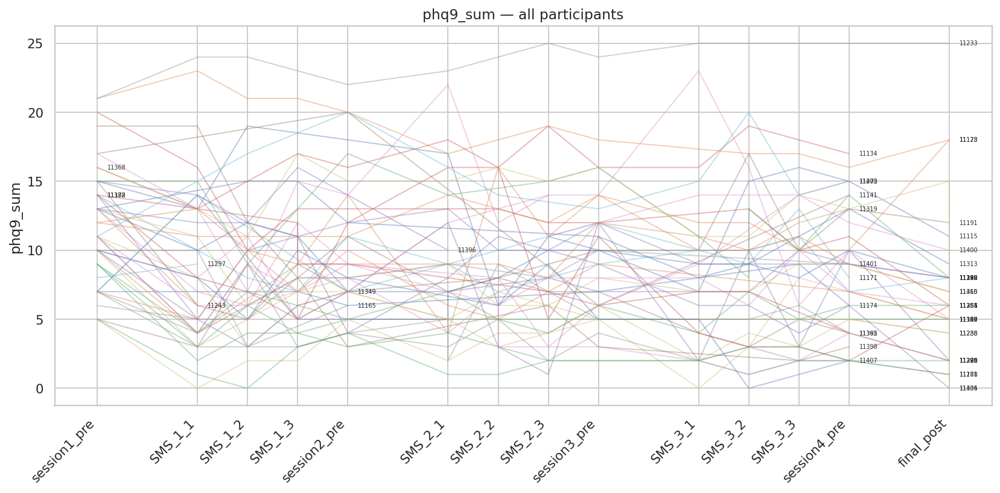

First MCID‐level worsening events (threshold ≥ 5):


,part_id,timepoint,phq9_sum,change
458,11139,SMS_1_1,14.0,7.0
517,11145,SMS_2_1,22.0,5.0
395,11171,SMS_1_1,14.0,7.0
495,11178,SMS_2_2,16.0,6.0
185,11272,session4_pre,15.0,5.0
381,11405,SMS_1_2,17.0,6.0


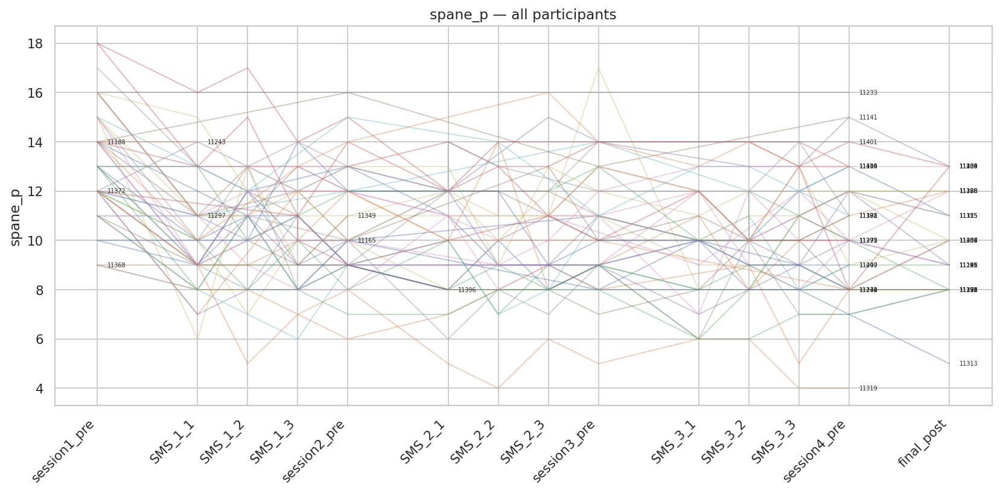

First MCID‐level worsening events (threshold ≥ 2):


,part_id,timepoint,spane_p,change
377,11115,SMS_1_1,9.0,-3.0
543,11123,SMS_1_1,9.0,-3.0
595,11130,SMS_1_1,8.0,-5.0
464,11145,SMS_1_1,11.0,-5.0
698,11165,SMS_1_1,8.0,-3.0
523,11166,SMS_1_1,6.0,-9.0
94,11174,session4_pre,8.0,-2.0
423,11178,SMS_1_1,7.0,-5.0
579,11181,SMS_1_1,9.0,-4.0
587,11190,SMS_1_3,9.0,-4.0


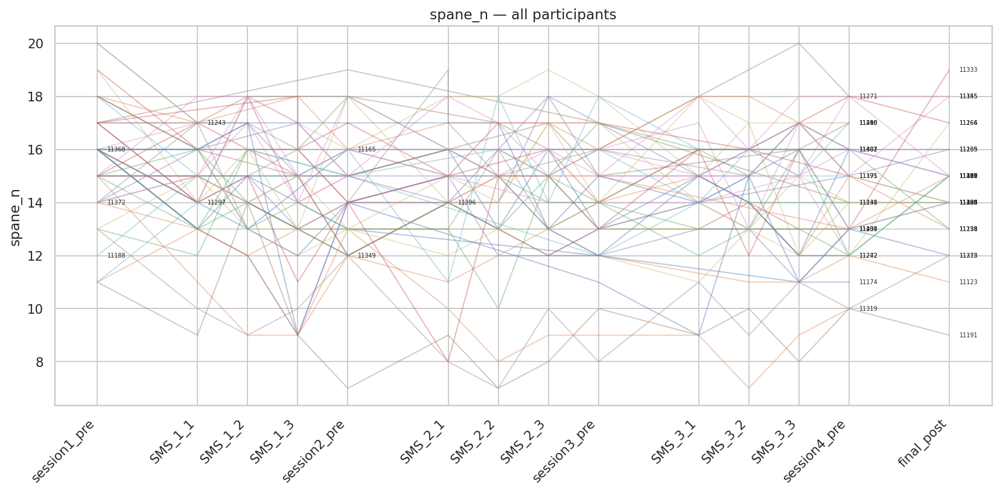

First MCID‐level worsening events (threshold ≥ 2):


,part_id,timepoint,spane_n,change
689,11134,SMS_1_1,17.0,2.0
458,11139,SMS_1_1,16.0,2.0
120,11141,session2_pre,19.0,2.0
484,11145,SMS_1_2,18.0,2.0
395,11171,SMS_1_1,15.0,3.0
584,11181,SMS_1_2,16.0,3.0
629,11191,SMS_1_2,14.0,3.0
412,11220,SMS_1_1,18.0,3.0
435,11233,SMS_1_1,17.0,3.0
614,11271,SMS_1_2,18.0,2.0


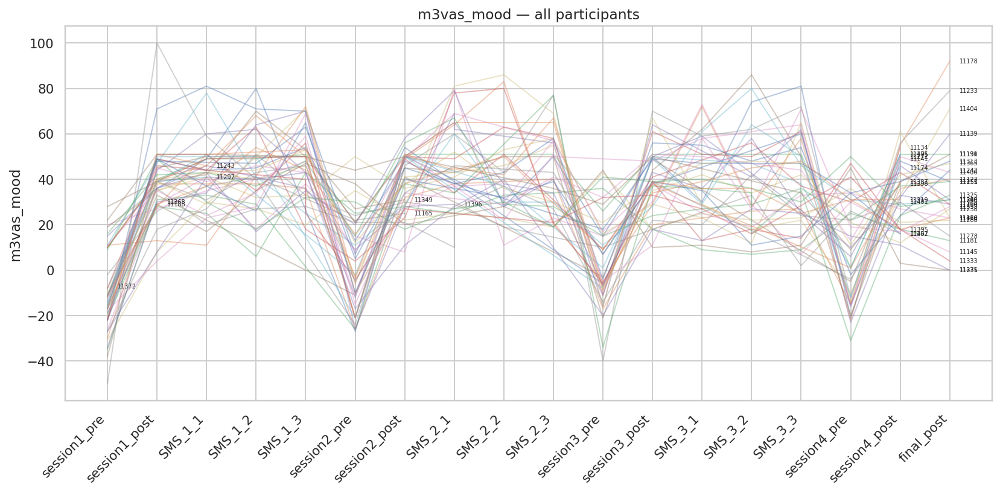

First MCID‐level worsening events (threshold ≥ 12):


,part_id,timepoint,m3vas_mood,change
56,11115,session2_pre,-27.0,-16.0
181,11134,session3_pre,-11.0,-21.0
145,11166,session4_pre,-14.0,-33.0
82,11178,session2_pre,-6.0,-17.0
73,11220,session2_pre,-11.0,-31.0
173,11265,session3_pre,-7.0,-22.0
489,11362,SMS_3_3,2.0,-17.0
149,11398,session4_pre,9.0,-13.0
111,11400,session2_pre,-15.0,-26.0


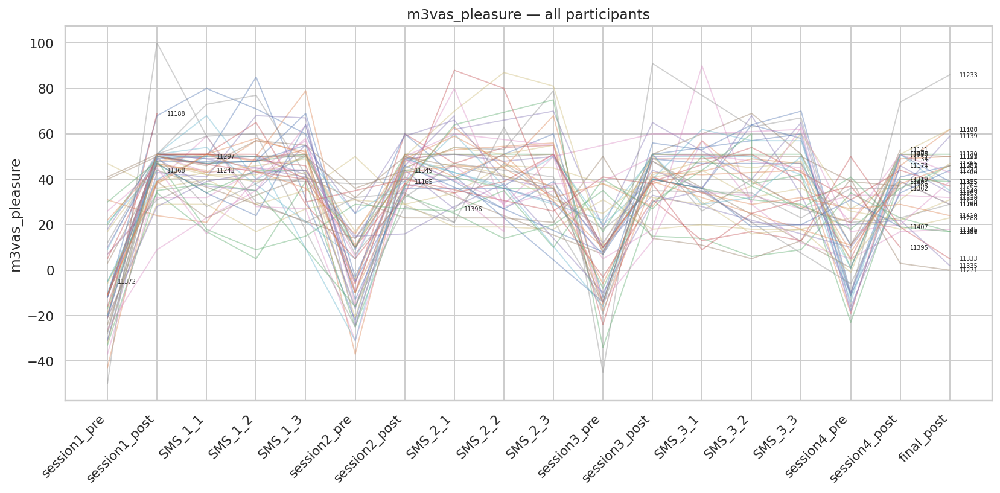

First MCID‐level worsening events (threshold ≥ 12):


,part_id,timepoint,m3vas_pleasure,change
163,11130,session4_pre,1.0,-19.0
181,11134,session3_pre,-24.0,-13.0
130,11139,session4_pre,-16.0,-34.0
533,11166,SMS_1_2,29.0,-18.0
82,11178,session2_pre,-10.0,-41.0
142,11181,session2_pre,-25.0,-20.0
73,11220,session2_pre,-5.0,-12.0
67,11238,session2_pre,-4.0,-21.0
175,11265,session4_pre,-10.0,-20.0
537,11390,SMS_1_1,18.0,-12.0


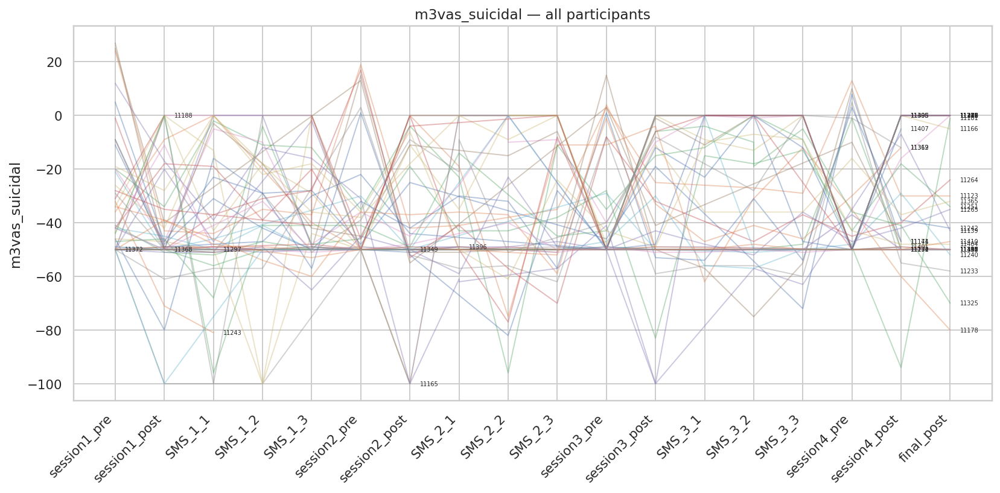

First MCID‐level worsening events (threshold ≥ 12):


,part_id,timepoint,m3vas_suicidal,change
163,11130,session4_pre,-1.0,40.0
232,11139,session1_post,-20.0,30.0
236,11145,session1_post,0.0,50.0
317,11165,session1_post,0.0,50.0
255,11166,session1_post,0.0,34.0
379,11174,SMS_1_1,-16.0,30.0
216,11178,session1_post,-9.0,27.0
579,11181,SMS_1_1,-2.0,18.0
323,11188,session1_post,0.0,31.0
412,11220,SMS_1_1,-5.0,15.0


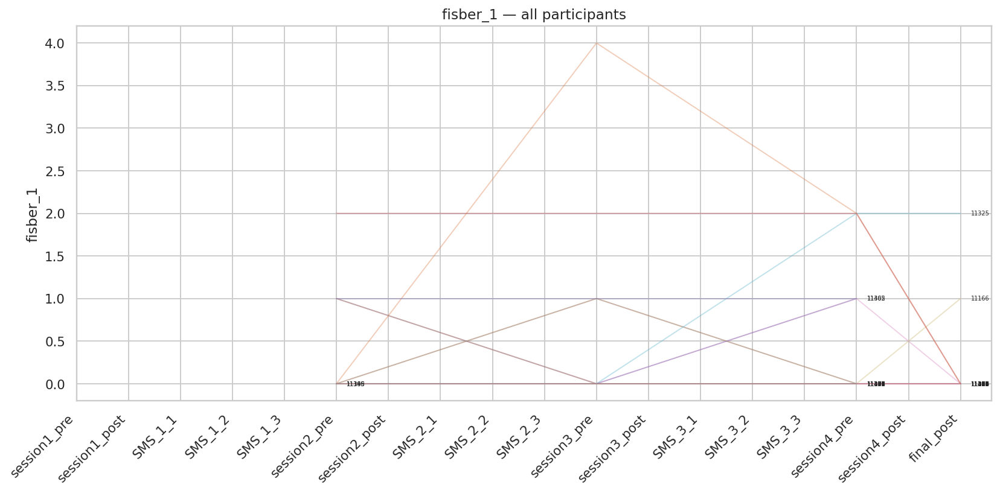

Worsened trajectories (blinded):


,part_id,timepoint,fisber_1
0,11166,session2_pre,0.0
1,11166,session3_pre,0.0
2,11166,session4_pre,0.0
3,11166,final_post,1.0
4,11325,session2_pre,0.0
5,11325,session3_pre,0.0
6,11325,session4_pre,2.0
7,11325,final_post,2.0
8,11362,session2_pre,0.0
9,11362,session3_pre,0.0


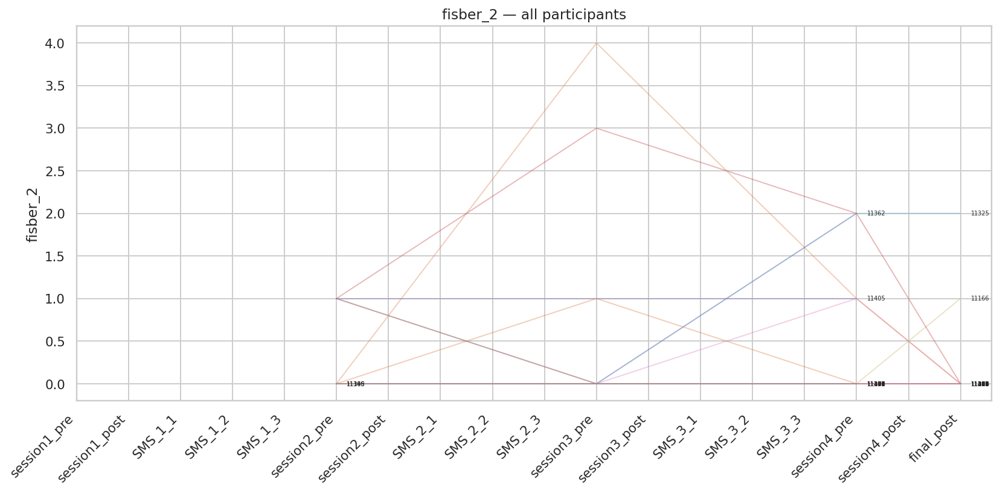

Worsened trajectories (blinded):


,part_id,timepoint,fisber_2
0,11166,session2_pre,0.0
1,11166,session3_pre,0.0
2,11166,session4_pre,0.0
3,11166,final_post,1.0
4,11325,session2_pre,0.0
5,11325,session3_pre,0.0
6,11325,session4_pre,2.0
7,11325,final_post,2.0
8,11362,session2_pre,0.0
9,11362,session3_pre,0.0


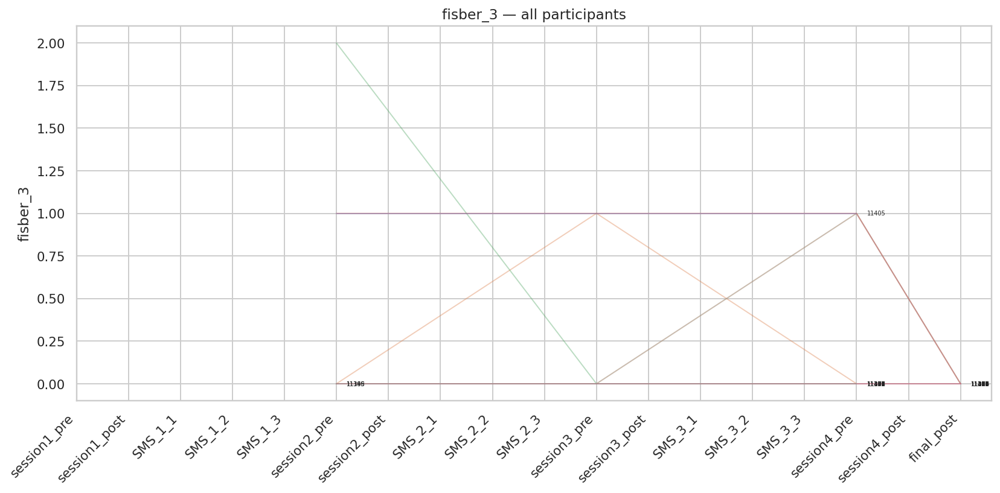

No worsening detected across the sample.


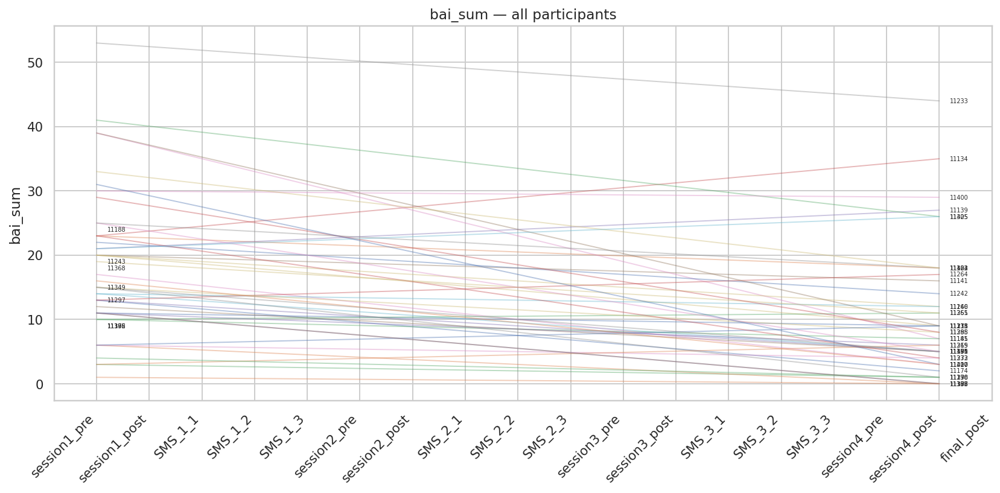

Worsened trajectories (blinded):


,part_id,timepoint,bai_sum
0,11134,session1_pre,23.0
1,11134,session4_post,35.0
2,11139,session1_pre,21.0
3,11139,session4_post,27.0
4,11251,session1_pre,10.0
5,11251,session4_post,11.0
6,11264,session1_pre,13.0
7,11264,session4_post,17.0
8,11313,session1_pre,6.0
9,11313,session4_post,9.0


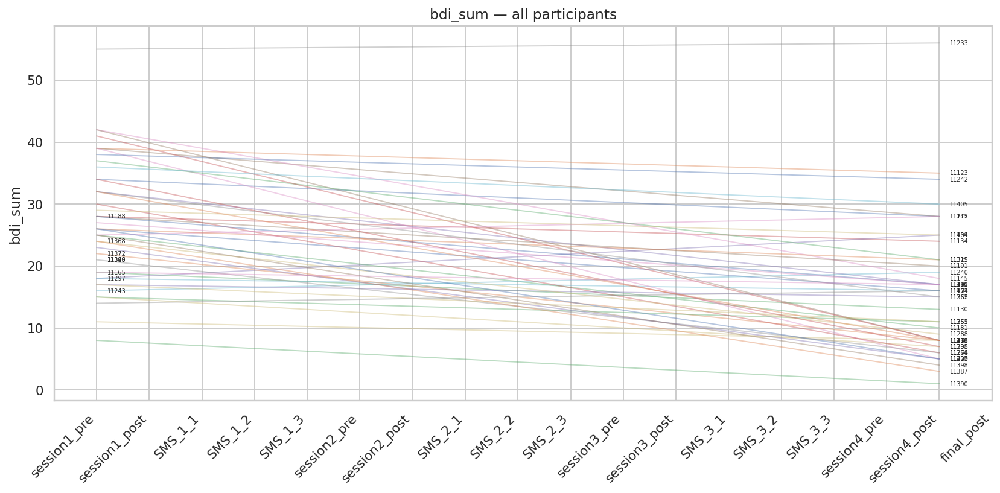

Worsened trajectories (blinded):


,part_id,timepoint,bdi_sum
0,11139,session1_pre,18.0
1,11139,session4_post,25.0
2,11233,session1_pre,55.0
3,11233,session4_post,56.0
4,11240,session1_pre,16.0
5,11240,session4_post,19.0
6,11272,session1_pre,25.0
7,11272,session4_post,28.0
8,11401,session1_pre,14.0
9,11401,session4_post,16.0


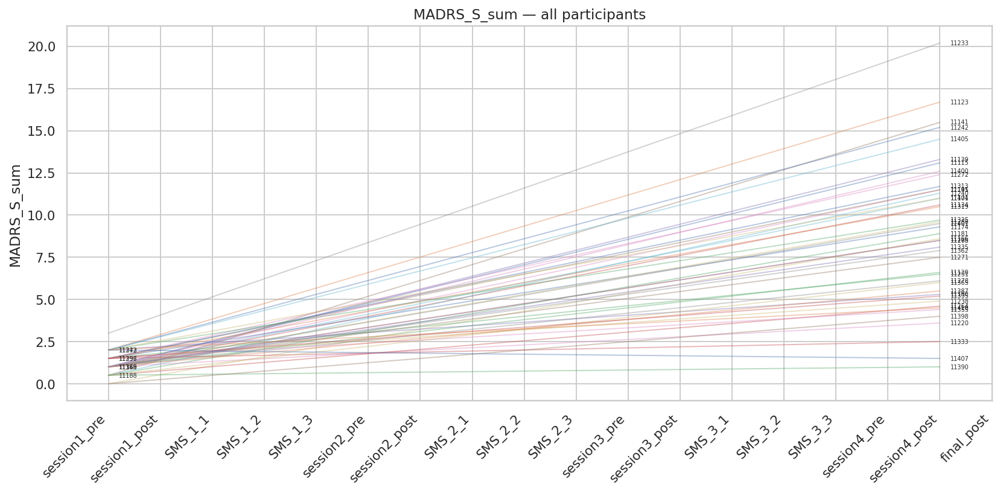

Worsened trajectories (blinded):


,part_id,timepoint,MADRS_S_sum
0,11115,session1_pre,1.0
1,11115,session4_post,13.1
2,11123,session1_pre,2.0
3,11123,session4_post,16.7
4,11130,session1_pre,1.0
5,11130,session4_post,6.6
6,11134,session1_pre,1.0
7,11134,session4_post,10.6
8,11139,session1_pre,1.0
9,11139,session4_post,13.3


In [70]:
import re
import pandas as pd
import matplotlib.pyplot as plt
from pathlib import Path

#####
# 0) SETTINGS
#####
DATA_DIR = Path('/content')

#####
# 1) UTILITY TO FIND EXACTLY ONE CSV
#####
def find_csv(substring: str) -> Path:
    matches = list(DATA_DIR.glob(f'*{substring}*.csv'))
    if not matches:
        raise FileNotFoundError(f"No file matching '{substring}' in {DATA_DIR}")
    if len(matches) > 1:
        raise ValueError(f"Multiple files match '{substring}': {matches}")
    return matches[0]

#####
# 1b) TRY TO LOAD A CSV, BUT SKIP IF MISSING OR AMBIGUOUS
#####
def try_load(substring: str) -> pd.DataFrame | None:
    try:
        path = find_csv(substring)
    except (FileNotFoundError, ValueError) as e:
        print(f"Skipping '{substring}': {e}")
        return None
    print(f"Loaded '{substring}' from {path.name}")
    return pd.read_csv(path, dtype=str)

#####
# 2) LOAD ALL WELLBEING CSVS (skipping any that aren’t there yet)
#####
df_s1_pre     = try_load('pre_session_1')
df_s2to4_pre  = try_load('pre_sessions_2-4')
df_s2to4_post = try_load('post_sessions_1-3')
df_s4_post    = try_load('post_session_4')
df_sms        = try_load('sms_day1,3,5')

#  — new step: trim SMS part_ids —
if df_sms is not None:
    df_sms['part_id'] = (
        df_sms['part_id']
              .astype(str)
              .str.strip()
              .str[:5]
    )
    print("Trimmed df_sms.part_id to first 5 characters")

df_final      = try_load('sms_post')

# Collect only the ones that actually loaded
all_dfs = [df for df in (
    df_s1_pre,
    df_s2to4_pre,
    df_s2to4_post,
    df_s4_post,
    df_sms,
    df_final
) if df is not None]

if not all_dfs:
    raise RuntimeError("No data files found to process!")

#####
# 3) CLEAN BDI ITEMS (extract leading number)
#####
for df in all_dfs:
    bdi_raw = [c for c in df.columns if re.fullmatch(r"bdi_\d+(?:_1)?", c)]
    for col in bdi_raw:
        df[col] = (
            df[col].astype(str)
                  .str.extract(r'^(\d+)')[0]
                  .astype(float)
        )

#####
# 4) SUM SCALES
#####
def sum_scale(df, cols, new_col):
    df[cols] = df[cols].apply(pd.to_numeric, errors='coerce')
    df[new_col] = df[cols].sum(axis=1)

def get_scale_cols(df, prefix, count, allow_suffix=False):
    cols = []
    for i in range(1, count+1):
        main = f"{prefix}_{i}"
        alt  = f"{prefix}_{i}_1"
        if main in df.columns:
            cols.append(main)
        elif allow_suffix and alt in df.columns:
            cols.append(alt)
    return cols

for df in all_dfs:
    # BAI
    bai_cols = get_scale_cols(df, 'bai', 21)
    if bai_cols:
        sum_scale(df, bai_cols, 'bai_sum')
    # BDI
    bdi_cols = get_scale_cols(df, 'bdi', 21)
    if bdi_cols:
        sum_scale(df, bdi_cols, 'bdi_sum')
    # MADRS
    madrs_cols = get_scale_cols(df, 'madrs', 9, allow_suffix=True)
    if madrs_cols:
        sum_scale(df, madrs_cols, 'MADRS_S_sum')

#####
# 5) STANDARDIZE M3VAS
#####
def standardize_m3vas(df):
    to_drop = []
    for var in ('suicidal','mood','pleasure'):
        # find change‐score first, then raw‐score
        ch_col  = next((c for c in df.columns
                        if re.fullmatch(rf"m3vas_ch_{var}(?:_1)?", c)), None)
        raw_col = next((c for c in df.columns
                        if re.fullmatch(rf"m3vas_{var}(?:_1)?",    c)), None)

        if ch_col:
            vals = pd.to_numeric(df[ch_col], errors='coerce') - 50
            to_drop.append(ch_col)
        elif raw_col:
            vals = pd.to_numeric(df[raw_col], errors='coerce') - 50
            to_drop.append(raw_col)
        else:
            continue

        if var == 'suicidal':
            # leave as-is: + means more suicidal (worse), so improvement → down
            df[f"m3vas_{var}"] = vals
        else:
            # mood & pleasure: + means improvement, so flip sign
            df[f"m3vas_{var}"] = -vals

    # drop only the original raw/change columns
    df.drop(columns=to_drop, inplace=True, errors='ignore')

# apply to each dataframe
for df in all_dfs:
    standardize_m3vas(df)

#####
# 6) CLEAN FISBER
#####
for df in all_dfs:
    for col in ('fisber_1','fisber_2','fisber_3'):
        if col in df.columns:
            df[col] = (
                df[col].astype(str)
                       .str.extract(r'(\d+)$')[0]
                       .astype(float)
            )

#####
# 7) COERCE TYPES
#####
# session_n for sessions
for df in (df_s1_pre, df_s2to4_pre, df_s2to4_post, df_s4_post):
    if df is not None and 'session_n' in df.columns:
        df['session_n'] = pd.to_numeric(df['session_n'], errors='coerce').astype('Int64')

# session_n & sms_n for SMS
if df_sms is not None:
    for col in ('session_n','sms_n'):
        if col in df_sms.columns:
            df_sms[col] = pd.to_numeric(df_sms[col], errors='coerce').astype('Int64')

# numeric scales
numeric_cols = [
    'phq9_sum','spane_p','spane_n',
    'm3vas_mood','m3vas_pleasure','m3vas_suicidal',
    'fisber_1','fisber_2','fisber_3',
    'bai_sum','bdi_sum','MADRS_S_sum'
]
for df in all_dfs:
    for col in numeric_cols:
        if col in df.columns:
            df[col] = pd.to_numeric(df[col], errors='coerce')

#####
# 8) ENSURE EVERY DF HAS part_id
#####
for df in all_dfs:
    if 'part_id' not in df.columns:
        if 'ProlificID' in df.columns:
            df.rename(columns={'ProlificID':'part_id'}, inplace=True)
        else:
            df['part_id'] = df.index.astype(str)
    df['part_id'] = df['part_id'].astype(str).str.strip()

#####
# 9) TAG TIMEPOINTS
#####
if df_s1_pre    is not None: df_s1_pre    ['timepoint'] = 'session1_pre'
if df_s2to4_pre is not None: df_s2to4_pre ['timepoint'] = df_s2to4_pre.apply(lambda r: f"session{r.session_n}_pre",  axis=1)
if df_s2to4_post is not None: df_s2to4_post['timepoint'] = df_s2to4_post.apply(lambda r: f"session{r.session_n}_post", axis=1)
if df_s4_post   is not None: df_s4_post   ['timepoint'] = 'session4_post'
if df_sms       is not None: df_sms       ['timepoint'] = df_sms.apply(lambda r: f"SMS_{r.session_n}_{r.sms_n}", axis=1)
if df_final     is not None: df_final     ['timepoint'] = 'final_post'

#####
# 10) CONCATENATE
#####
df_long = pd.concat(all_dfs, ignore_index=True)

#####
# 11) DROP NON-NUMERIC part_id
#####
df_long = df_long[df_long['part_id'].str.match(r'^\d+$', na=False)]

#####
# 12) MERGE IN CONDITION (if assignments file was found)
#####
df_assign = try_load('wp2_assignments')
if df_assign is not None:
    df_long = df_long.merge(
        df_assign[['part_id','condition']],
        on='part_id',
        how='inner'
    )
else:
    print("No assignments file: skipping merge with 'condition' column")

#####
# 13) DEFINE & APPLY ORDERED CATEGORICAL FOR timepoint
#####
ordered_timepoints = [
    'session1_pre','session1_post',
    'SMS_1_1','SMS_1_2','SMS_1_3',
    'session2_pre','session2_post',
    'SMS_2_1','SMS_2_2','SMS_2_3',
    'session3_pre','session3_post',
    'SMS_3_1','SMS_3_2','SMS_3_3',
    'session4_pre','session4_post',
    'final_post'
]
df_long['timepoint'] = pd.Categorical(
    df_long['timepoint'],
    categories=ordered_timepoints,
    ordered=True
)

#####
# 14) PLOTTING + FLAGGING ACROSS ALL PARTICIPANTS (BLINDED)
#####
bad_if_higher = {
    'phq9_sum',
    'spane_n',
    'fisber_1','fisber_2','fisber_3',
    'bai_sum','bdi_sum','MADRS_S_sum',
    'm3vas_suicidal'   # higher = more suicidal = worse
}

bad_if_lower = {
    'spane_p',
    'm3vas_mood',      # higher = better mood, so a drop is worsening
    'm3vas_pleasure'   # higher = better pleasure, so a drop is worsening
}

mcid_thresholds = {
    'phq9_sum': 5,
    'spane_p': 2,
    'spane_n': 2,
    'm3vas_mood': 12,
    'm3vas_pleasure': 12,
    'm3vas_suicidal': 12
}

#####
# ADJUST M3VAS SO 50 → 0 (“no change”), 0 → –50 (worse), 100 → +50 (better)
#####
def standardize_m3vas(df):
    for var in ('suicidal','mood','pleasure'):
        # detect the two possible inputs
        raw_col = next((c for c in df.columns
                        if re.fullmatch(f"m3vas_{var}(?:_1)?", c)), None)
        ch_col  = next((c for c in df.columns
                        if re.fullmatch(f"m3vas_ch_{var}(?:_1)?", c)),  None)

        if raw_col is not None:
            # pre‐session raw VAS: 0 (best) → 100 (worst)
            vals = pd.to_numeric(df[raw_col], errors='coerce') - 50
        elif ch_col is not None:
            # post‐session change VAS: already –50 (better) → +50 (worse)
            vals = pd.to_numeric(df[ch_col], errors='coerce')
        else:
            continue

        # for mood & pleasure, invert so higher = more distress
        if var in ('mood','pleasure'):
            vals = -vals

        df[f"m3vas_{var}"] = vals

    # drop all the old raw / ch columns
    drop_re = re.compile(
        r"^(?:m3vas_ch_(?:mood|pleasure|suicidal)(?:_1)?"
        r"|m3vas_(?:mood|pleasure|suicidal)_1)$"
    )
    to_drop = [c for c in df.columns if drop_re.match(c)]
    df.drop(columns=to_drop, errors='ignore', inplace=True)

# Apply to each dataframe
for df in all_dfs:
    standardize_m3vas(df)

#####
# PLOTTING & FLAGGING FUNCTION
#####
def plot_trajectories_and_flag(measure):
    if measure not in df_long.columns:
        print(f"→ skipping '{measure}': not in df_long")
        return

    # 1) Copy & drop session*_post for PHQ-9 and SPANE scales
    df_plot = df_long.copy()
    if measure in ('phq9_sum','spane_p','spane_n'):
        mask = df_plot['timepoint'].astype(str).str.match(r'^session\d+_post$')
        df_plot = df_plot[~mask]

    # 2) Determine which timepoints remain, preserving order
    timepoints_present = [tp for tp in ordered_timepoints if tp in df_plot['timepoint'].values]
    code_map = {tp: i for i, tp in enumerate(ordered_timepoints)}

    # 3) Plot trajectories
    fig, ax = plt.subplots(figsize=(12,6))
    for pid, grp in df_plot.groupby('part_id'):
        s = grp.dropna(subset=['timepoint', measure]).sort_values('timepoint')
        if s.empty:
            continue
        x = s['timepoint'].cat.codes
        y = s[measure].astype(float)
        ax.plot(x, y, linewidth=1, alpha=0.4)
        ax.text(x.iloc[-1] + 0.2, y.iloc[-1], pid, fontsize=5, va='center')

    # 4) Set ticks only for the retained timepoints
    tick_locs   = [code_map[tp] for tp in timepoints_present]
    tick_labels = timepoints_present
    ax.set_xticks(tick_locs)
    ax.set_xticklabels(tick_labels, rotation=45, ha='right')

    ax.set_ylabel(measure)
    ax.set_title(f"{measure} — all participants")
    plt.tight_layout()
    plt.show()

    # 5) Flag first MCID‐level worsening events
    if measure in mcid_thresholds:
        th = mcid_thresholds[measure]
        breach_events = []

        for pid, grp_pid in df_plot.groupby('part_id'):
            seq = (
                grp_pid
                .dropna(subset=['timepoint', measure])
                .sort_values('timepoint')
                .loc[:, ['part_id','timepoint', measure]]
                .assign(change=lambda d: d[measure] - d[measure].iloc[0])
            )
            if measure in bad_if_higher:
                mask = seq['change'] >= th
            else:
                mask = seq['change'] <= -th

            if mask.any():
                breach_events.append(seq[mask].iloc[0])

        if breach_events:
            df_breaches = pd.DataFrame(breach_events)
            print(f"First MCID‐level worsening events (threshold ≥ {th}):")
            display(df_breaches)
        else:
            print(f"No participants worsened by at least the MCID of {th} for {measure}.")

    else:
        # 6) Fallback: any participant whose final point is worse than their first
        worsened = []
        for pid, grp_pid in df_plot.groupby('part_id'):
            seq = grp_pid.dropna(subset=['timepoint', measure]) \
                         .sort_values('timepoint')[measure] \
                         .astype(float)
            if len(seq) < 2:
                continue
            if ((measure in bad_if_higher and seq.iloc[-1] > seq.iloc[0]) or
                (measure in bad_if_lower  and seq.iloc[-1] < seq.iloc[0])):
                worsened.append(pid)

        if worsened:
            print("Worsened trajectories (blinded):")
            display(
                df_plot[df_plot['part_id'].isin(worsened)]
                       [['part_id','timepoint',measure]]
                       .dropna(subset=[measure])
                       .sort_values(['part_id','timepoint'])
                       .reset_index(drop=True)
            )
        else:
            print("No worsening detected across the sample.")

#####
# RUN FOR ALL MEASURES
#####
for m in measures:
    plot_trajectories_and_flag(m)

new

Loaded 'pre_session_1' from wp2_pre_session_1_October 17, 2025_09.03.csv
Loaded 'pre_sessions_2-4' from wp2_pre_sessions_2-4_October 17, 2025_09.42.csv
Loaded 'post_sessions_1-3' from wp2_post_sessions_1-3_October 17, 2025_09.42.csv
Loaded 'post_session_4' from wp2_post_session_4_October 17, 2025_09.43.csv
Loaded 'sms_day1,3,5' from wp2_sms_day1,3,5_October 17, 2025_09.42.csv
Trimmed df_sms.part_id to first 5 characters
Loaded 'sms_post' from wp2_sms_post_October 17, 2025_09.42.csv
Loaded 'wp2_assignments' from wp2_assignments.csv


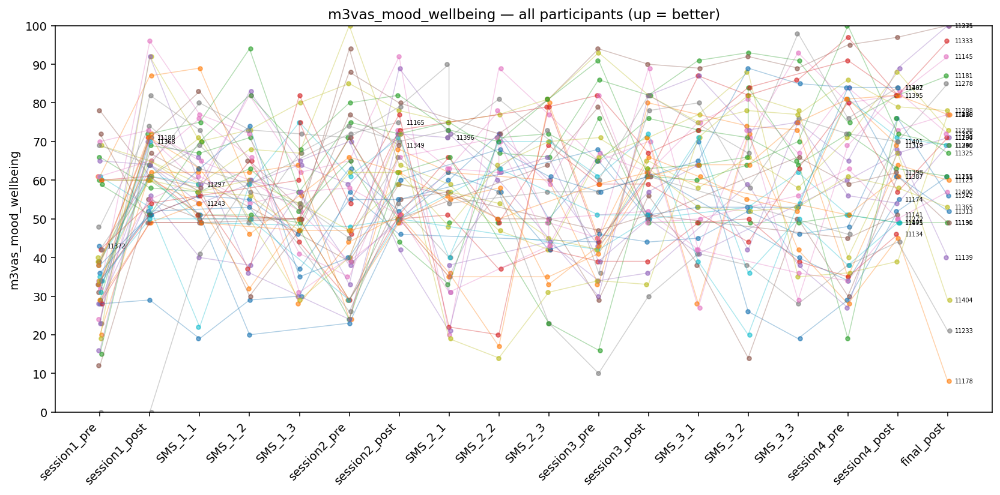

,part_id,timepoint,m3vas_mood_wellbeing,change
385,11115,SMS_1_2,20.0,-19.0
695,11134,SMS_2_2,37.0,-23.0
565,11166,SMS_2_2,47.0,-22.0
446,11178,SMS_1_3,28.0,-33.0
436,11220,SMS_1_3,52.0,-18.0
389,11240,SMS_1_1,22.0,-39.0
387,11251,SMS_1_3,52.0,-14.0
308,11265,session2_post,42.0,-23.0
631,11333,SMS_2_1,22.0,-12.0
321,11349,session1_post,61.0,-17.0


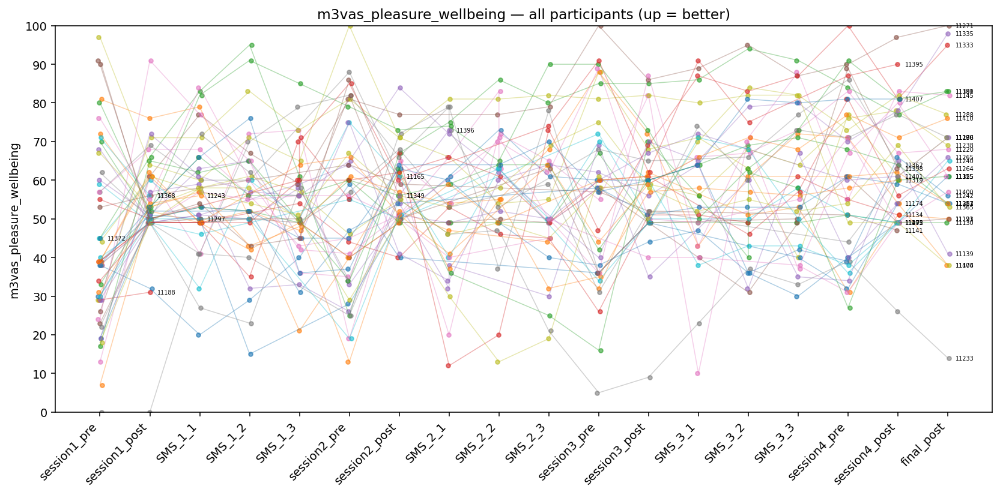

,part_id,timepoint,m3vas_pleasure_wellbeing,change
385,11115,SMS_1_2,15.0,-24.0
280,11130,session1_post,50.0,-20.0
181,11134,session3_pre,26.0,-13.0
232,11139,session1_post,49.0,-19.0
255,11166,session1_post,64.0,-33.0
395,11171,SMS_1_1,46.0,-13.0
379,11174,SMS_1_1,20.0,-18.0
446,11178,SMS_1_3,21.0,-60.0
142,11181,session2_pre,25.0,-20.0
436,11220,SMS_1_3,43.0,-14.0


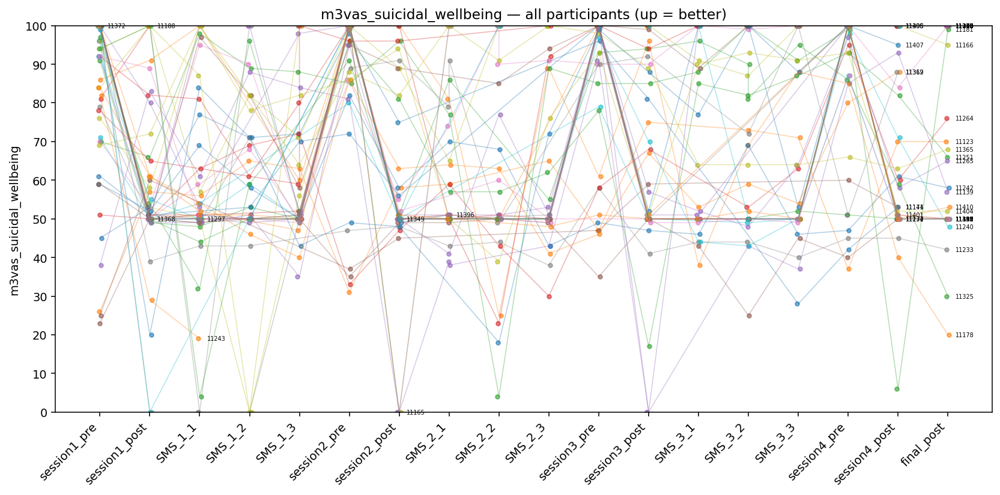

,part_id,timepoint,m3vas_suicidal_wellbeing,change
191,11115,session1_post,50.0,-50.0
280,11130,session1_post,49.0,-42.0
313,11134,session1_post,51.0,-49.0
232,11139,session1_post,80.0,-20.0
698,11165,SMS_1_1,0.0,-100.0
523,11166,SMS_1_1,57.0,-27.0
198,11171,session1_post,50.0,-21.0
195,11174,session1_post,20.0,-76.0
446,11178,SMS_1_3,60.0,-26.0
612,11181,SMS_2_2,4.0,-66.0


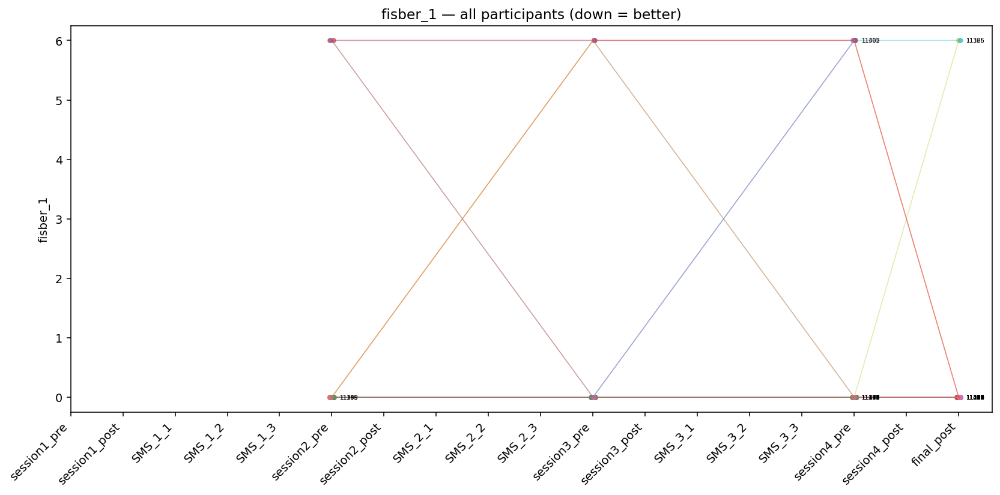

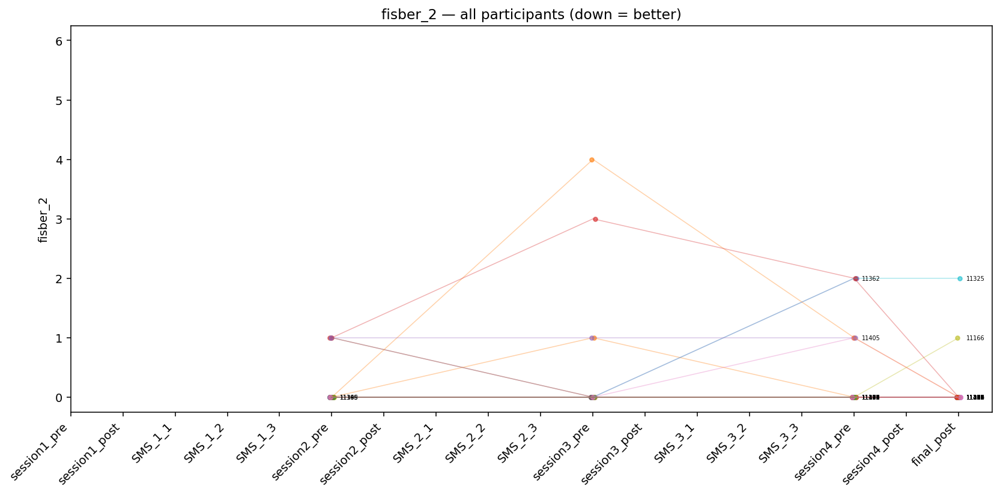

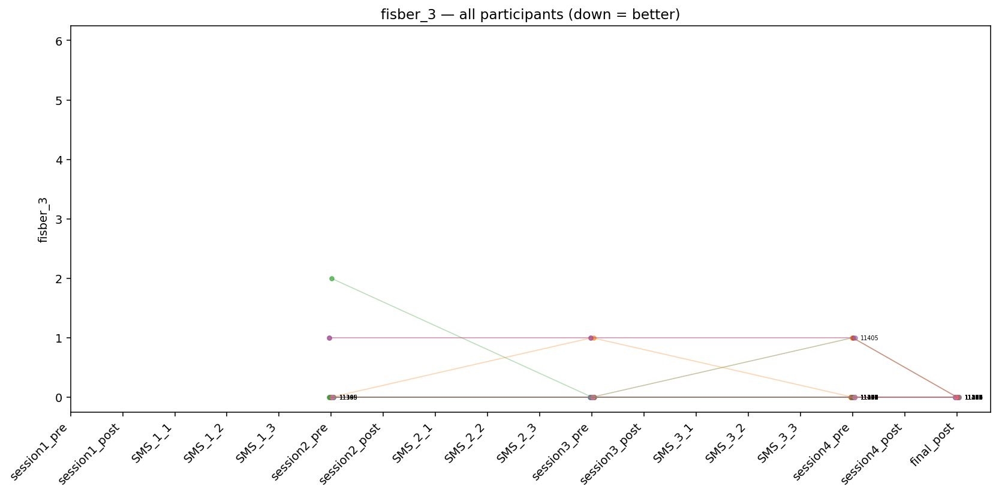

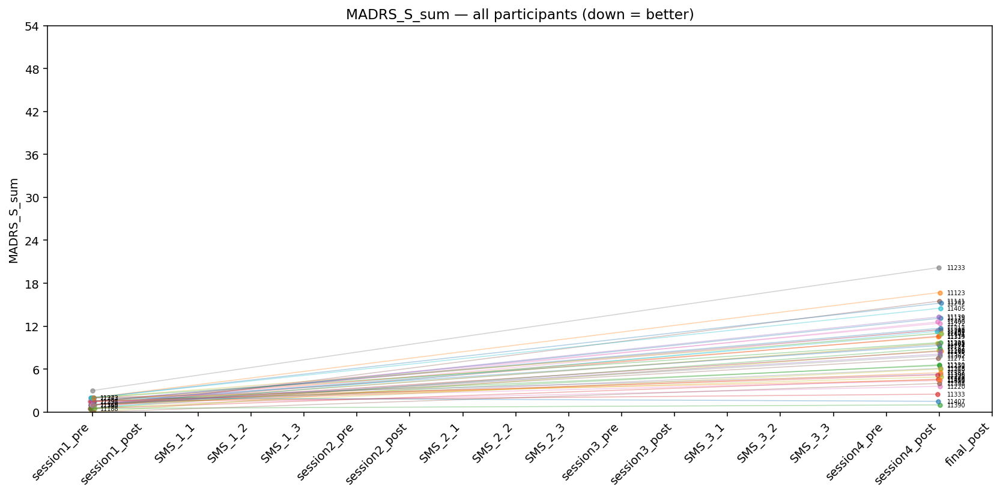

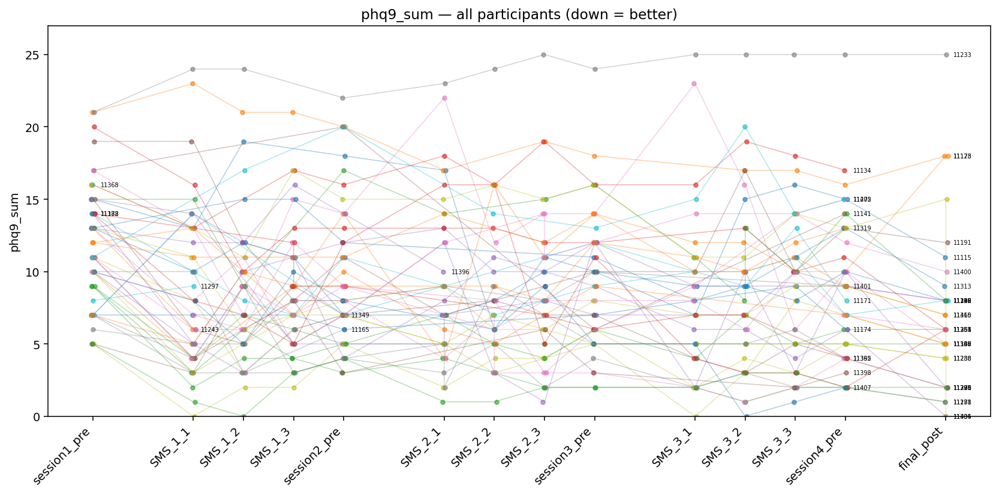

,part_id,timepoint,phq9_sum,change
458,11139,SMS_1_1,14,7
517,11145,SMS_2_1,22,5
395,11171,SMS_1_1,14,7
495,11178,SMS_2_2,16,6
185,11272,session4_pre,15,5
381,11405,SMS_1_2,17,6


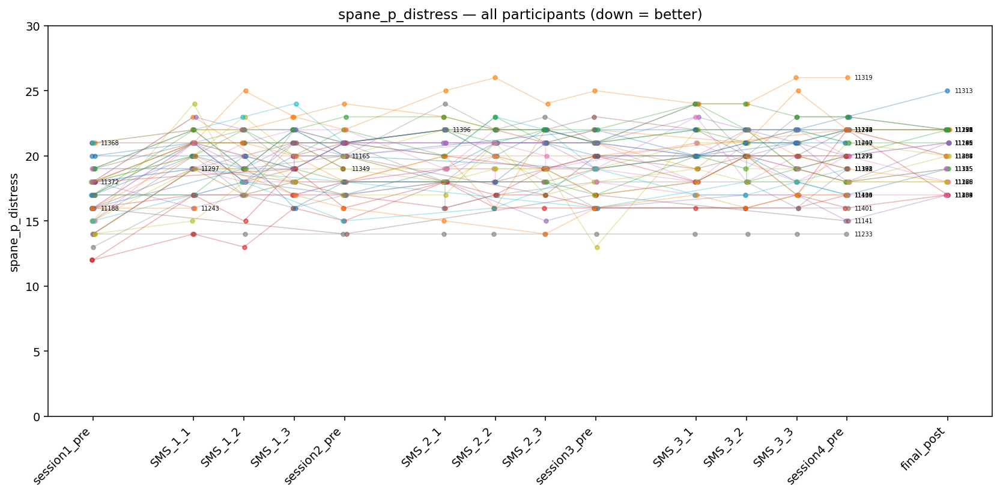

,part_id,timepoint,spane_p_distress,change
377,11115,SMS_1_1,21.0,3.0
543,11123,SMS_1_1,21.0,3.0
595,11130,SMS_1_1,22.0,5.0
464,11145,SMS_1_1,19.0,5.0
698,11165,SMS_1_1,22.0,3.0
523,11166,SMS_1_1,24.0,9.0
94,11174,session4_pre,22.0,2.0
423,11178,SMS_1_1,23.0,5.0
579,11181,SMS_1_1,21.0,4.0
587,11190,SMS_1_3,21.0,4.0


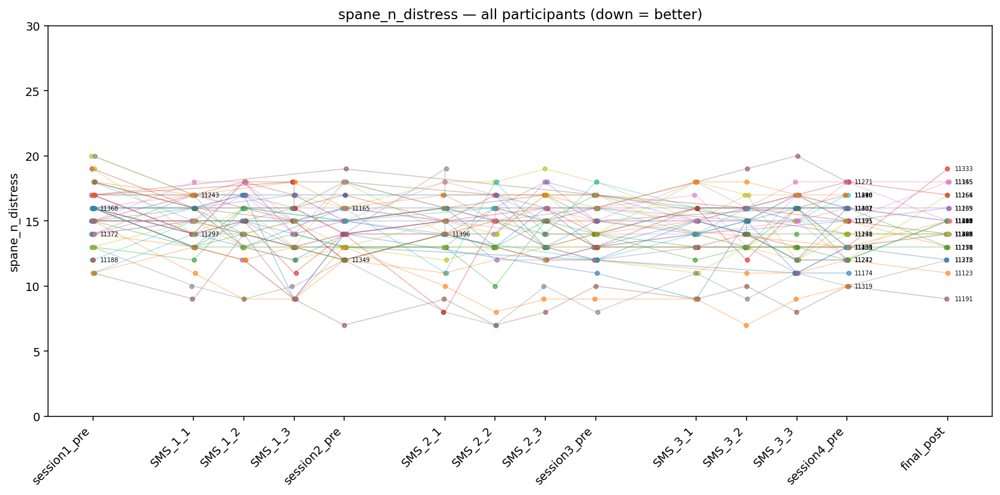

,part_id,timepoint,spane_n_distress,change
689,11134,SMS_1_1,17.0,2.0
458,11139,SMS_1_1,16.0,2.0
120,11141,session2_pre,19.0,2.0
484,11145,SMS_1_2,18.0,2.0
395,11171,SMS_1_1,15.0,3.0
584,11181,SMS_1_2,16.0,3.0
629,11191,SMS_1_2,14.0,3.0
412,11220,SMS_1_1,18.0,3.0
435,11233,SMS_1_1,17.0,3.0
614,11271,SMS_1_2,18.0,2.0


In [17]:
# --- WP2 trajectories (robust parsing; M3VAS up=better; MADRS complete-case) ---

import re, numpy as np, pandas as pd, matplotlib.pyplot as plt
from pathlib import Path

plt.rcParams.update({"figure.dpi": 140})

# ========= 0) SETTINGS =========
DATA_DIR = Path('/content')  # adjust if needed

# ========= 1) FILE HELPERS =========
def find_csv(substring: str) -> Path:
    matches = list(DATA_DIR.glob(f'*{substring}*.csv'))
    if not matches:
        raise FileNotFoundError(f"No file matching '{substring}' in {DATA_DIR}")
    if len(matches) > 1:
        raise ValueError(f"Multiple files match '{substring}': {matches}")
    return matches[0]

def try_load(substring: str) -> pd.DataFrame | None:
    try:
        path = find_csv(substring)
    except (FileNotFoundError, ValueError) as e:
        print(f"Skipping '{substring}': {e}")
        return None
    print(f"Loaded '{substring}' from {path.name}")
    return pd.read_csv(path, dtype=str)

# ========= 2) LOAD =========
df_s1_pre     = try_load('pre_session_1')
df_s2to4_pre  = try_load('pre_sessions_2-4')
df_s2to4_post = try_load('post_sessions_1-3')
df_s4_post    = try_load('post_session_4')
df_sms        = try_load('sms_day1,3,5')
if df_sms is not None and 'part_id' in df_sms.columns:
    df_sms['part_id'] = df_sms['part_id'].astype(str).str.strip().str[:5]
    print("Trimmed df_sms.part_id to first 5 characters")
df_final      = try_load('sms_post')

all_dfs = [df for df in (df_s1_pre, df_s2to4_pre, df_s2to4_post, df_s4_post, df_sms, df_final) if df is not None]
if not all_dfs:
    raise RuntimeError("No data files found to process!")

# ========= 3) IDs & session coercion =========
for df in all_dfs:
    if 'part_id' not in df.columns:
        if 'ProlificID' in df.columns: df.rename(columns={'ProlificID':'part_id'}, inplace=True)
        else: df['part_id'] = df.index.astype(str)
    df['part_id'] = df['part_id'].astype(str).str.strip()

for df in (df_s1_pre, df_s2to4_pre, df_s2to4_post, df_s4_post):
    if df is not None and 'session_n' in df.columns:
        df['session_n'] = pd.to_numeric(df['session_n'], errors='coerce').astype('Int64')
if df_sms is not None:
    for col in ('session_n','sms_n'):
        if col in df_sms.columns:
            df_sms[col] = pd.to_numeric(df_sms[col], errors='coerce').astype('Int64')

# ========= 4) TEXT → SCORE HELPERS =========
def extract_leading_int(x) -> float:
    """Return first integer found; works for 2, '2: text', or full labels. NaN if none."""
    if pd.isna(x): return np.nan
    s = str(x).strip()
    try:
        f = float(s)
        if f.is_integer(): return int(f)
        return f
    except Exception:
        pass
    m = re.search(r'(\d+)', s)
    return float(m.group(1)) if m else np.nan

def parse_likert_0to6(series: pd.Series) -> pd.Series:
    """Robustly parse 0..6 from numbers or labels; blanks stay NaN."""
    return series.apply(extract_leading_int).clip(lower=0, upper=6)

# ========= 5) CLEAN BDI / MADRS ITEMS THEN SUM =========
def sum_scale_complete(df, cols, new_col):
    """Sum only when ALL items are present; else NaN to avoid spurious drift."""
    if not cols: return
    block = df[cols].apply(pd.to_numeric, errors='coerce')
    count_valid = block.notna().sum(axis=1)
    s = block.sum(axis=1)
    s[count_valid < len(cols)] = np.nan
    df[new_col] = s

def get_cols(df, prefix, count, allow_suffix=False):
    cols = []
    for i in range(1, count+1):
        m = f"{prefix}_{i}"; a = f"{prefix}_{i}_1"
        if m in df.columns: cols.append(m)
        elif allow_suffix and a in df.columns: cols.append(a)
    return cols

for df in all_dfs:
    # BDI items: '3: ...' → 3
    for col in [c for c in df.columns if re.fullmatch(r"bdi_\d+(?:_1)?", c)]:
        df[col] = df[col].apply(extract_leading_int)

    # MADRS items: '2: ...' OR 0..3 radio indices
    madrs_item_cols = [c for c in df.columns if re.fullmatch(r"madrs_\d+(?:_1)?", c)]
    for col in madrs_item_cols:
        v = df[col].apply(extract_leading_int)
        mx = v.dropna().max() if v.notna().any() else np.nan
        if pd.notna(mx) and mx <= 3:
            v = v * 2.0  # scale 0..3 → 0..6 (0,2,4,6)
        df[col] = v

    # FISBER: tolerant parse (0..6)
    for col in ('fisber_1','fisber_2','fisber_3'):
        if col in df.columns:
            df[col] = parse_likert_0to6(df[col])

# sums
for df in all_dfs:
    sum_scale_complete(df, get_cols(df, 'bai',   21), 'bai_sum')
    sum_scale_complete(df, get_cols(df, 'bdi',   21), 'bdi_sum')
    sum_scale_complete(df, get_cols(df, 'madrs',  9, allow_suffix=True), 'MADRS_S_sum')  # 0..54 (down=better)

# ========= 6) M3VAS → distress (down=better) & wellbeing (up=better) =========
def build_m3vas_views(df):
    # Raw: 0 best .. 100 worst
    # Change: -50 (better) .. +50 (worse) → distress = 50 - change
    for var in ('mood','pleasure','suicidal'):
        raw_col = next((c for c in df.columns if re.fullmatch(rf"m3vas_{var}(?:_1)?", c)), None)
        ch_col  = next((c for c in df.columns if re.fullmatch(rf"m3vas_ch_{var}(?:_1)?", c)), None)

        raw = pd.to_numeric(df[raw_col], errors='coerce') if raw_col else pd.Series(np.nan, index=df.index)
        ch  = pd.to_numeric(df[ch_col],  errors='coerce') if ch_col  else pd.Series(np.nan, index=df.index)
        distress = raw.where(~raw.isna(), 50 - ch).clip(lower=0, upper=100)

        df[f"m3vas_{var}_distress"]  = distress
        df[f"m3vas_{var}_wellbeing"] = 100 - distress  # UP = BETTER

for df in all_dfs:
    build_m3vas_views(df)

# ========= 7) SPANE → distress versions (down=better) =========
for df in all_dfs:
    if 'spane_p' in df.columns:
        df['spane_p'] = pd.to_numeric(df['spane_p'], errors='coerce')
        df['spane_p_distress'] = (30 - df['spane_p']).clip(lower=0, upper=30)
    if 'spane_n' in df.columns:
        df['spane_n'] = pd.to_numeric(df['spane_n'], errors='coerce')
        df['spane_n_distress'] = df['spane_n'].clip(lower=0, upper=30)

# ========= 8) TIMEPOINT TAGS =========
if df_s1_pre    is not None: df_s1_pre    ['timepoint'] = 'session1_pre'
if df_s2to4_pre is not None: df_s2to4_pre ['timepoint'] = df_s2to4_pre.apply(lambda r: f"session{r.session_n}_pre",  axis=1)
if df_s2to4_post is not None: df_s2to4_post['timepoint'] = df_s2to4_post.apply(lambda r: f"session{r.session_n}_post", axis=1)
if df_s4_post   is not None: df_s4_post   ['timepoint'] = 'session4_post'
if df_sms       is not None: df_sms       ['timepoint'] = df_sms.apply(lambda r: f"SMS_{r.session_n}_{r.sms_n}", axis=1)
if df_final     is not None: df_final     ['timepoint'] = 'final_post'

# ========= 9) CONCAT + CONDITION =========
df_long = pd.concat(all_dfs, ignore_index=True)
df_long = df_long[df_long['part_id'].str.match(r'^\d+$', na=False)]

df_assign = try_load('wp2_assignments')
if df_assign is not None:
    df_long = df_long.merge(df_assign[['part_id','condition']], on='part_id', how='inner')
else:
    print("No assignments file: skipping merge with 'condition' column")

ordered_timepoints = [
    'session1_pre','session1_post',
    'SMS_1_1','SMS_1_2','SMS_1_3',
    'session2_pre','session2_post',
    'SMS_2_1','SMS_2_2','SMS_2_3',
    'session3_pre','session3_post',
    'SMS_3_1','SMS_3_2','SMS_3_3',
    'session4_pre','session4_post',
    'final_post'
]
df_long['timepoint'] = pd.Categorical(df_long['timepoint'], categories=ordered_timepoints, ordered=True)

# ========= 10) Worsening rules for flagging =========
# Distress measures & sums: higher = worse
bad_if_higher = {
    'm3vas_mood_distress','m3vas_pleasure_distress','m3vas_suicidal_distress',
    'spane_p_distress','spane_n_distress',
    'fisber_1','fisber_2','fisber_3',
    'MADRS_S_sum','phq9_sum'
}
# Wellbeing measures: lower = worse
bad_if_lower = {
    'm3vas_mood_wellbeing','m3vas_pleasure_wellbeing','m3vas_suicidal_wellbeing'
}

mcid_thresholds = {
    'phq9_sum': 5,
    'spane_p_distress': 2,
    'spane_n_distress': 2,
    'm3vas_mood_distress': 12,
    'm3vas_pleasure_distress': 12,
    'm3vas_suicidal_distress': 12,
    # MCID for wellbeing uses same magnitude but inverted direction in flagging
    'm3vas_mood_wellbeing': 12,
    'm3vas_pleasure_wellbeing': 12,
    'm3vas_suicidal_wellbeing': 12,
}

# ========= 11) Plotting =========
def plot_trajectories_and_flag(measure):
    if measure not in df_long.columns:
        print(f"→ skipping '{measure}': not in df_long"); return

    # For PHQ-9 & SPANE (either version), drop session*_post per schedule
    df_plot = df_long.copy()
    if any(tag in measure for tag in ('spane',)) or measure == 'phq9_sum':
        df_plot = df_plot[~df_plot['timepoint'].astype(str).str.match(r'^session\d+_post$')]

    timepoints_present = [tp for tp in ordered_timepoints if tp in df_plot['timepoint'].values]
    code_map = {tp: i for i, tp in enumerate(ordered_timepoints)}

    fig, ax = plt.subplots(figsize=(12,6))
    for pid, grp in df_plot.groupby('part_id'):
        s = grp.dropna(subset=['timepoint', measure]).sort_values('timepoint')
        if s.empty: continue
        x = s['timepoint'].cat.codes
        y = pd.to_numeric(s[measure], errors='coerce')
        xj = x + (np.random.rand(len(x)) - 0.5) * 0.08
        ax.plot(x, y, linewidth=0.8, alpha=0.35)
        ax.scatter(xj, y, s=12, alpha=0.6)
        ax.text(x.iloc[-1] + 0.15, y.iloc[-1], pid, fontsize=5, va='center')

    tick_locs = [code_map[tp] for tp in timepoints_present]
    ax.set_xticks(tick_locs)
    ax.set_xticklabels(timepoints_present, rotation=45, ha='right')

    # y-limits and titles
    if measure.endswith('_wellbeing'):
        ax.set_ylim(0, 100); ax.set_yticks(range(0,101,10))
        ax.set_title(f"{measure} — all participants (up = better)")
    elif measure in ('fisber_1','fisber_2','fisber_3'):
        ax.set_ylim(-0.25, 6.25); ax.set_yticks(range(0,7))
        ax.set_title(f"{measure} — all participants (down = better)")
    elif measure == 'MADRS_S_sum':
        ax.set_ylim(0, 54); ax.set_yticks(range(0,55,6))
        ax.set_title(f"{measure} — all participants (down = better)")
    elif measure in ('spane_p_distress','spane_n_distress'):
        ax.set_ylim(0, 30); ax.set_yticks(range(0,31,5))
        ax.set_title(f"{measure} — all participants (down = better)")
    elif measure == 'phq9_sum':
        ax.set_ylim(0, 27)
        ax.set_title(f"{measure} — all participants (down = better)")
    else:
        ax.set_title(f"{measure} — all participants")

    ax.set_ylabel(measure)
    plt.tight_layout(); plt.show()

    # ---- flag first MCID-level worsening ----
    if measure in mcid_thresholds:
        th = mcid_thresholds[measure]
        breach_events = []
        for pid, grp_pid in df_plot.groupby('part_id'):
            seq = (grp_pid.dropna(subset=['timepoint', measure])
                         .sort_values('timepoint')
                         .loc[:, ['part_id','timepoint', measure]])
            if seq.empty: continue
            vals = pd.to_numeric(seq[measure], errors='coerce')
            change = vals - vals.iloc[0]
            if measure in bad_if_higher:
                mask = change >= th
            elif measure in bad_if_lower:
                mask = change <= -th
            else:
                mask = pd.Series(False, index=seq.index)
            if mask.any():
                first = seq.loc[mask].iloc[0].copy()
                first['change'] = change[mask].iloc[0]
                breach_events.append(first)
        if breach_events:
            display(pd.DataFrame(breach_events))
        else:
            print(f"No participants worsened by at least the MCID of {th} for {measure}.")

# ========= 12) RUN =========
measures = [
    # M3VAS wellbeing (0..100; UP = better)
    'm3vas_mood_wellbeing', 'm3vas_pleasure_wellbeing', 'm3vas_suicidal_wellbeing',
    # tolerability (0..6; DOWN = better)
    'fisber_1','fisber_2','fisber_3',
    # depression (0..54; DOWN = better) and PHQ-9 (0..27)
    'MADRS_S_sum','phq9_sum',
    # SPANE as distress (0..30; DOWN = better)
    'spane_p_distress','spane_n_distress'
]
for m in measures:
    plot_trajectories_and_flag(m)




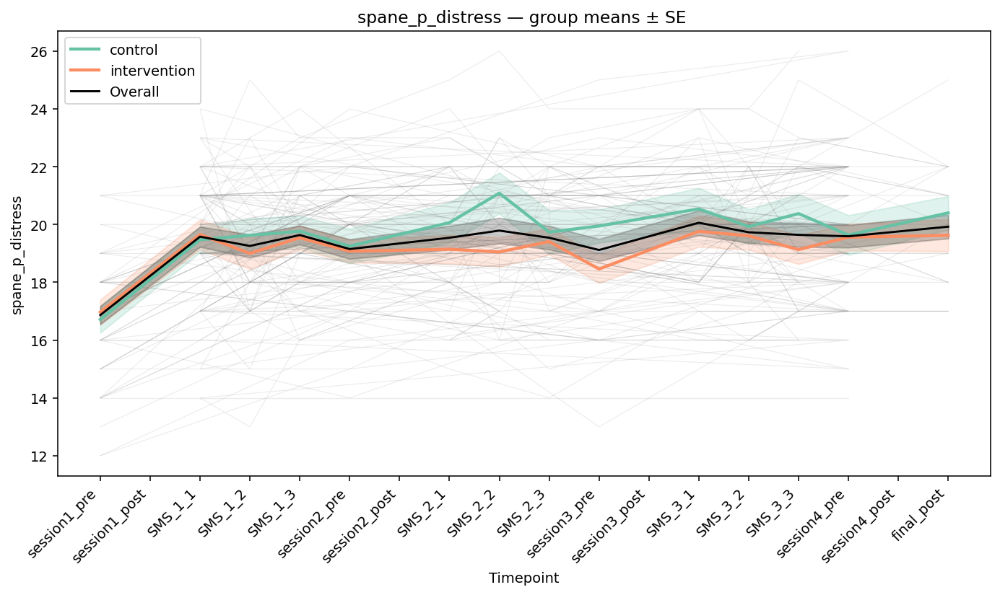


📊 Regression Summary: spane_p_distress
  control      slope=   0.126 p= 0.0002
  intervention slope=   0.078 p= 0.0027
  Overall      slope=   0.097 p= 0.0000
  Δ (pre→final): t=-8.05, p=0.0000, n=52
------------------------------------------------------------


/tmp/ipython-input-2462095855.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  .groupby(['part_id','timepoint'],as_index=False)[measure]


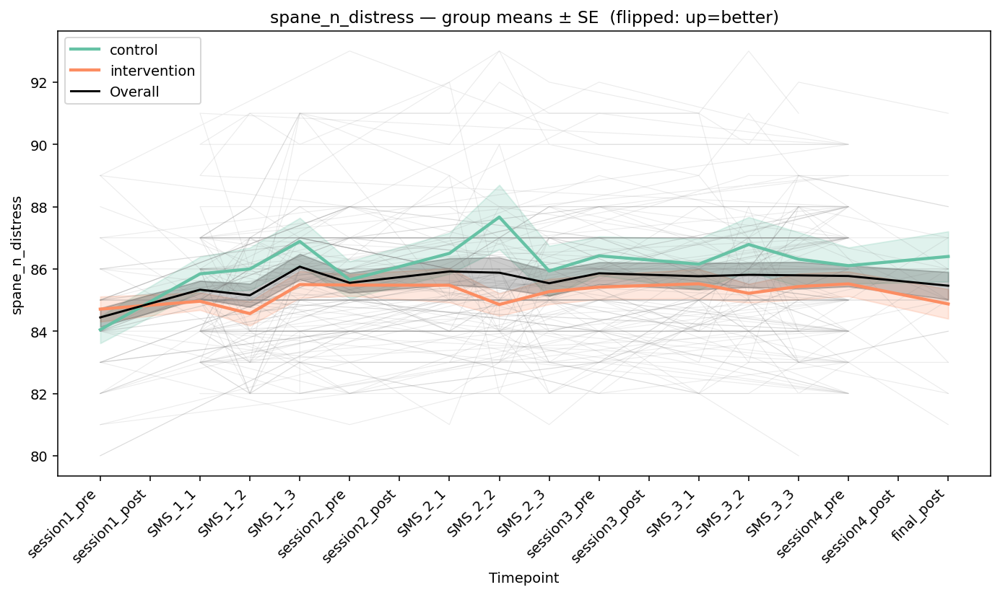


📊 Regression Summary: spane_n_distress (flipped)
  control      slope=   0.078 p= 0.0358
  intervention slope=   0.030 p= 0.1494
  Overall      slope=   0.049 p= 0.0138
  Δ (pre→final): t=-1.97, p=0.0601, n=52
------------------------------------------------------------


/tmp/ipython-input-2462095855.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  .groupby(['part_id','timepoint'],as_index=False)[measure]


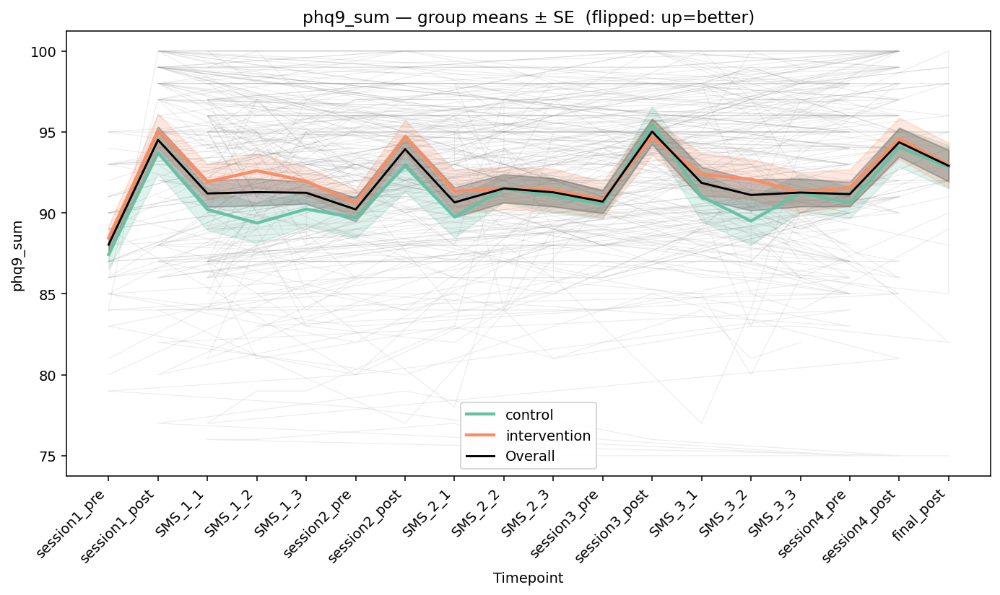


📊 Regression Summary: phq9_sum (flipped)
  control      slope=   0.148 p= 0.0092
  intervention slope=   0.068 p= 0.1849
  Overall      slope=   0.101 p= 0.0083
  Δ (pre→final): t=-6.28, p=0.0000, n=52
------------------------------------------------------------


/tmp/ipython-input-2462095855.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  .groupby(['part_id','timepoint'],as_index=False)[measure]


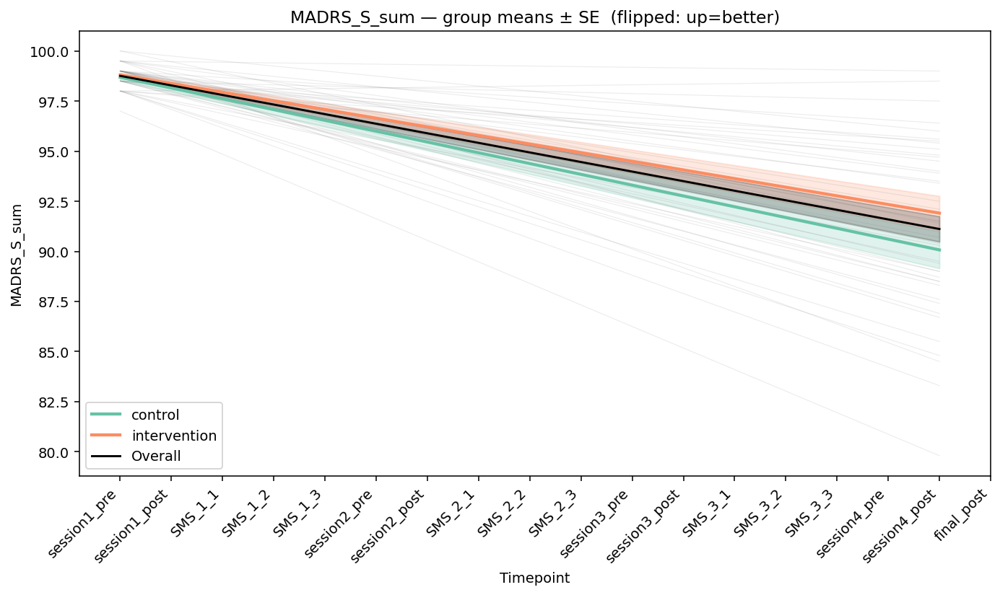


📊 Regression Summary: MADRS_S_sum (flipped)
  Overall      slope=  -0.478 p= 0.0000
  Δ (pre→final): t=nan, p=nan, n=52
------------------------------------------------------------


/tmp/ipython-input-2462095855.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  .groupby(['part_id','timepoint'],as_index=False)[measure]
/tmp/ipython-input-2462095855.py:26: SmallSampleWarning: After omitting NaNs, one or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  return {'n':len(common), **dict(zip(['t','p'], ttest_rel(a,b,nan_policy='omit')[:2]))}


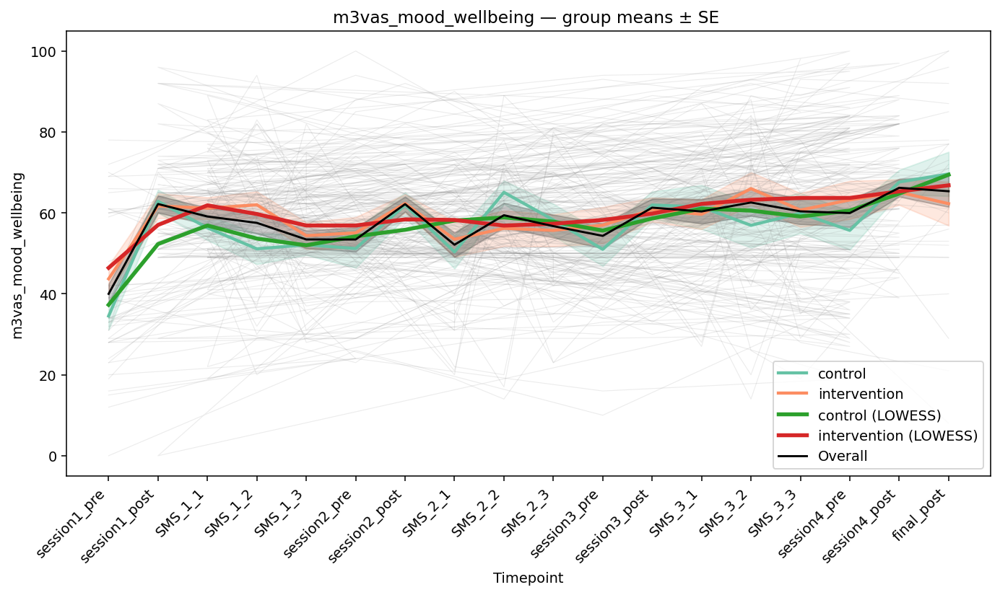


📊 Regression Summary: m3vas_mood_wellbeing
  control      slope=   0.880 p= 0.0000
  intervention slope=   0.562 p= 0.0009
  Overall      slope=   0.694 p= 0.0000
  Δ (pre→final): t=-5.23, p=0.0000, n=52
------------------------------------------------------------


/tmp/ipython-input-2462095855.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  .groupby(['part_id','timepoint'],as_index=False)[measure]


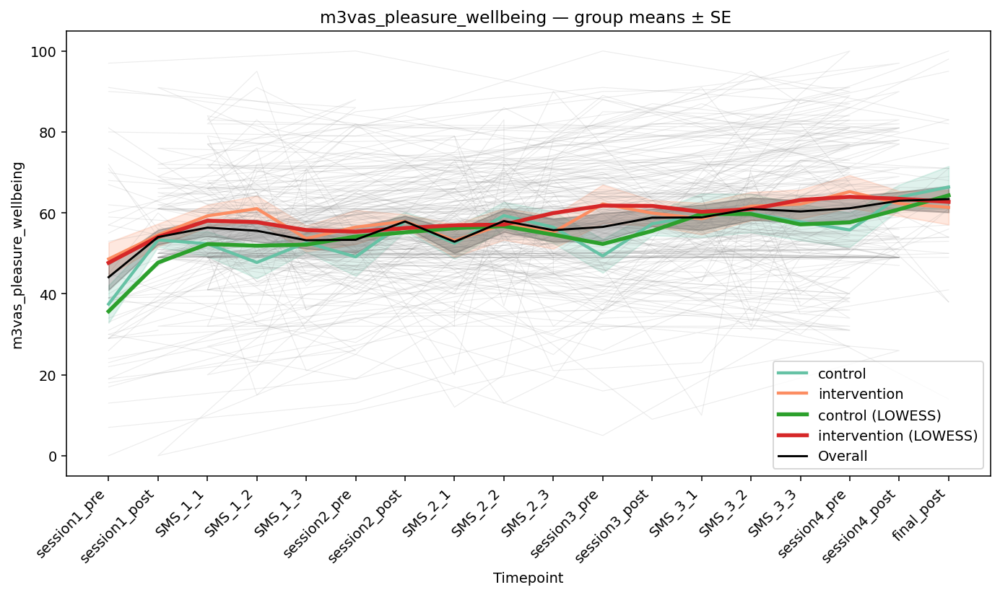


📊 Regression Summary: m3vas_pleasure_wellbeing
  control      slope=   0.942 p= 0.0000
  intervention slope=   0.591 p= 0.0003
  Overall      slope=   0.736 p= 0.0000
  Δ (pre→final): t=-4.47, p=0.0001, n=52
------------------------------------------------------------


/tmp/ipython-input-2462095855.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  .groupby(['part_id','timepoint'],as_index=False)[measure]


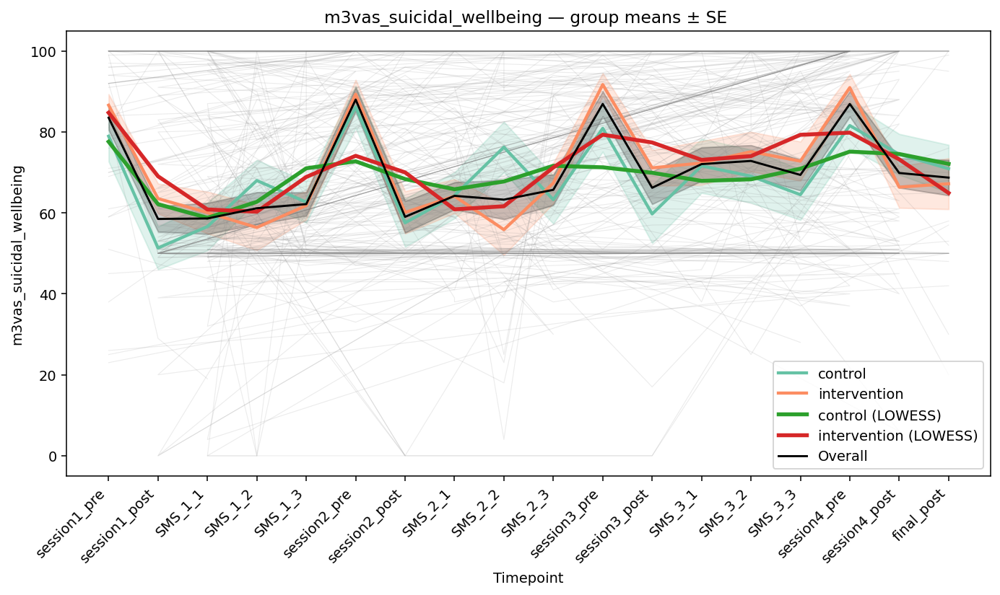


📊 Regression Summary: m3vas_suicidal_wellbeing
  control      slope=   0.539 p= 0.0527
  intervention slope=   0.401 p= 0.0753
  Overall      slope=   0.458 p= 0.0090
  Δ (pre→final): t=1.96, p=0.0588, n=52
------------------------------------------------------------


/tmp/ipython-input-2462095855.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  .groupby(['part_id','timepoint'],as_index=False)[measure]


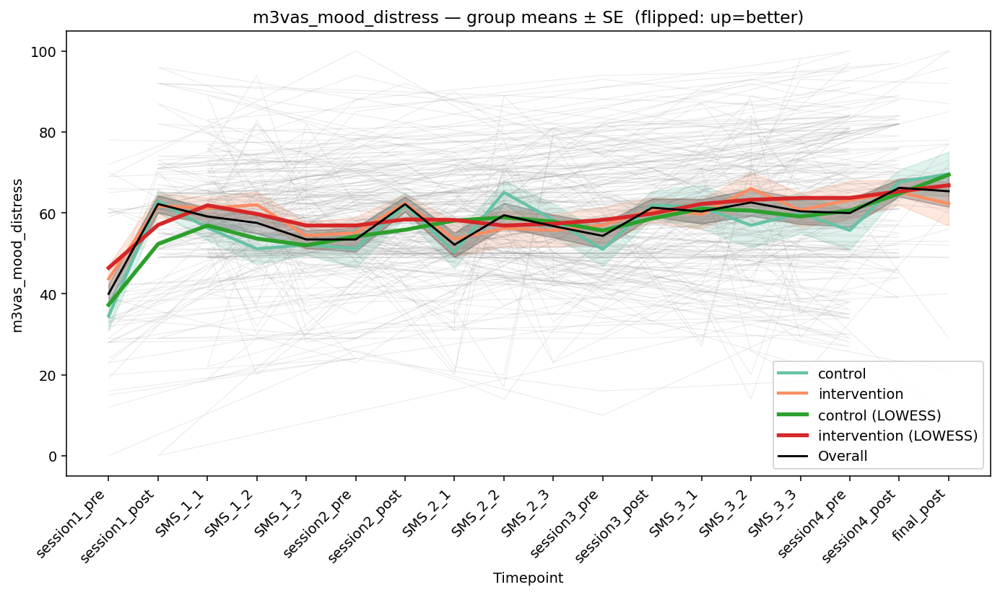


📊 Regression Summary: m3vas_mood_distress (flipped)
  control      slope=   0.880 p= 0.0000
  intervention slope=   0.562 p= 0.0009
  Overall      slope=   0.694 p= 0.0000
  Δ (pre→final): t=-5.23, p=0.0000, n=52
------------------------------------------------------------


/tmp/ipython-input-2462095855.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  .groupby(['part_id','timepoint'],as_index=False)[measure]


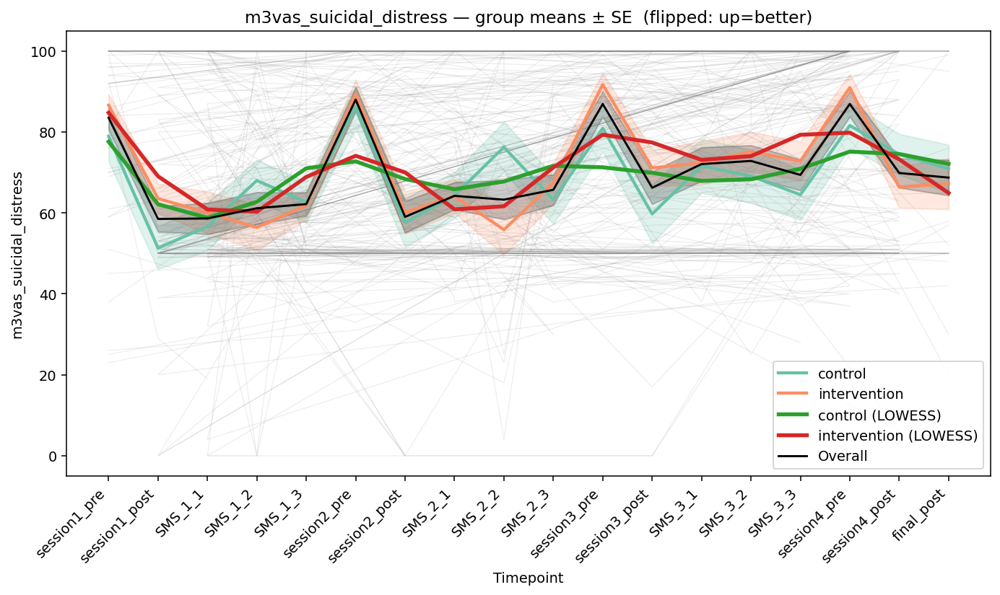


📊 Regression Summary: m3vas_suicidal_distress (flipped)
  control      slope=   0.539 p= 0.0527
  intervention slope=   0.401 p= 0.0753
  Overall      slope=   0.458 p= 0.0090
  Δ (pre→final): t=1.96, p=0.0588, n=52
------------------------------------------------------------


/tmp/ipython-input-2462095855.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  .groupby(['part_id','timepoint'],as_index=False)[measure]


In [18]:
import seaborn as sns
import statsmodels.api as sm
from scipy.stats import ttest_rel
from statsmodels.nonparametric.smoothers_lowess import lowess

# Define measures where higher = worse → flip them
FLIP_MEASURES = [
    'phq9_sum', 'MADRS_S_sum',
    'm3vas_mood_distress', 'm3vas_suicidal_distress',
    'spane_n_distress'
]

def _per_participant_timepoint_mean(df, measure):
    return (df
            .dropna(subset=['timepoint', 'part_id', measure])
            .groupby(['part_id','timepoint'],as_index=False)[measure]
            .mean())

def _paired_pre_final(df, measure, pre_label='session1_pre', post_label='final_post', min_n=5):
    df_pp = _per_participant_timepoint_mean(df, measure)
    pre  = df_pp[df_pp['timepoint']==pre_label].set_index('part_id')[measure]
    post = df_pp[df_pp['timepoint']==post_label].set_index('part_id')[measure]
    common = pre.index.intersection(post.index)
    if len(common)<min_n: return None
    a,b = pre.loc[common].values, post.loc[common].values
    return {'n':len(common), **dict(zip(['t','p'], ttest_rel(a,b,nan_policy='omit')[:2]))}

def summarize_and_plot(measure, smooth=False, drop_session_posts=False, title_suffix=""):
    if measure not in df_long.columns:
        print(f"Skipping {measure}"); return
    df_plot = df_long.copy()
    df_plot = df_plot[~df_plot['timepoint'].isna()]
    df_plot[measure] = pd.to_numeric(df_plot[measure], errors='coerce')
    df_plot = df_plot.dropna(subset=[measure])
    if df_plot.empty:
        print(f"No data for {measure}"); return

    # Flip direction if higher = worse
    flip = measure in FLIP_MEASURES
    if flip:
        df_plot[measure] = 100 - df_plot[measure] if df_plot[measure].max()>10 else -df_plot[measure]
        title_suffix += " (flipped: up=better)"

    if drop_session_posts:
        df_plot = df_plot[~df_plot['timepoint'].astype(str).str.match(r'^session\d+_post$')]
    df_plot['tp_num'] = df_plot['timepoint'].cat.codes

    fig, ax = plt.subplots(figsize=(10,6))
    for pid,g in df_plot.groupby('part_id'):
        ax.plot(g['tp_num'], g[measure], color='gray', alpha=0.15, lw=0.6)

    sns.lineplot(data=df_plot,x='tp_num',y=measure,hue='condition',
                 estimator='mean',errorbar='se',lw=2.2,palette='Set2',ax=ax)
    if smooth:
        for cond,g in df_plot.groupby('condition'):
            g=g.sort_values('tp_num')
            smoothed=lowess(g[measure],g['tp_num'],frac=0.25,return_sorted=True)
            ax.plot(smoothed[:,0],smoothed[:,1],lw=2.8,label=f"{cond} (LOWESS)")
    sns.lineplot(data=df_plot,x='tp_num',y=measure,estimator='mean',
                 errorbar='se',color='black',lw=1.5,label='Overall',ax=ax)

    ax.set_xticks(range(len(df_plot['timepoint'].cat.categories)))
    ax.set_xticklabels(df_plot['timepoint'].cat.categories,rotation=45,ha='right')
    ax.set_title(f"{measure} — group means ± SE {title_suffix}")
    ax.set_xlabel("Timepoint"); ax.set_ylabel(measure)
    ax.legend(); plt.tight_layout(); plt.show()

    # ---------- STATS ----------
    print(f"\n📊 Regression Summary: {measure}{' (flipped)' if flip else ''}")
    for cond,g in df_plot.groupby('condition'):
        if len(g['tp_num'].unique())<3: continue
        X=sm.add_constant(g['tp_num'])
        m=sm.OLS(g[measure],X,missing='drop').fit()
        print(f"  {cond:<12} slope={m.params['tp_num']:>8.3f} p={m.pvalues['tp_num']:>7.4f}")
    X=sm.add_constant(df_plot['tp_num'])
    m=sm.OLS(df_plot[measure],X,missing='drop').fit()
    print(f"  {'Overall':<12} slope={m.params['tp_num']:>8.3f} p={m.pvalues['tp_num']:>7.4f}")
    res=_paired_pre_final(df_plot,measure)
    if res: print(f"  Δ (pre→final): t={res['t']:.2f}, p={res['p']:.4f}, n={res['n']}")
    print("-"*60)


# ===== Run with fixed directionality =====
for measure in ['spane_p_distress','spane_n_distress']:
    summarize_and_plot(measure, drop_session_posts=True)

for measure in ['phq9_sum','MADRS_S_sum']:
    summarize_and_plot(measure)

for measure in ['m3vas_mood_wellbeing','m3vas_pleasure_wellbeing',
                'm3vas_suicidal_wellbeing','m3vas_mood_distress','m3vas_suicidal_distress']:
    summarize_and_plot(measure, smooth=True)



adjusted scaling (hopefully!!!)

In [73]:
# run this before the next cell to fix m3vas and madrs

# ---- Repair & enrich df_long in-place: M3VAS, SPANE distress, MADRS complete-case, BDI/BAI sums ----
import re, numpy as np, pandas as pd

assert 'df_long' in globals(), "df_long not found—run the preprocessing cell first."

# 0) Ensure ordered timepoints
ordered_timepoints = [
    'session1_pre','session1_post',
    'SMS_1_1','SMS_1_2','SMS_1_3',
    'session2_pre','session2_post',
    'SMS_2_1','SMS_2_2','SMS_2_3',
    'session3_pre','session3_post',
    'SMS_3_1','SMS_3_2','SMS_3_3',
    'session4_pre','session4_post',
    'final_post'
]
if 'timepoint' not in df_long.columns:
    raise RuntimeError("df_long.timepoint is missing—rerun the data-build cell.")
df_long['timepoint'] = pd.Categorical(df_long['timepoint'], categories=ordered_timepoints, ordered=True)

# 1) Helpers
def _first_col(df, patterns):
    """Return the first column in df that matches any regex pattern (exact, case-sensitive)."""
    for pat in patterns:
        for c in df.columns:
            if re.fullmatch(pat, str(c)):
                return c
    return None

def _madrs_item_cols(df):
    return [c for c in df.columns if re.fullmatch(r"madrs_\d+(?:_1)?", c)]

def _bdi_item_cols(df):
    return [c for c in df.columns if re.fullmatch(r"bdi_\d+(?:_1)?", c)]

def _bai_item_cols(df):
    return [c for c in df.columns if re.fullmatch(r"bai_\d+(?:_1)?", c)]

# 2) SPANE distress (0..30)
if 'spane_p_distress' not in df_long.columns and 'spane_p' in df_long.columns:
    df_long['spane_p'] = pd.to_numeric(df_long['spane_p'], errors='coerce')
    df_long['spane_p_distress'] = (30 - df_long['spane_p']).clip(0, 30)

if 'spane_n_distress' not in df_long.columns and 'spane_n' in df_long.columns:
    df_long['spane_n'] = pd.to_numeric(df_long['spane_n'], errors='coerce')
    df_long['spane_n_distress'] = df_long['spane_n'].clip(0, 30)

# 3) M3VAS → make *_distress (0..100; higher=worse) and *_wellbeing (0..100; higher=better)
for var in ('mood','pleasure','suicidal'):
    dist_col = f"m3vas_{var}_distress"
    well_col = f"m3vas_{var}_wellbeing"
    if dist_col in df_long.columns and well_col in df_long.columns:
        continue

    raw_col = _first_col(df_long, [rf"m3vas_{var}(?:_1)?"])
    chg_col = _first_col(df_long, [rf"m3vas_ch_{var}(?:_1)?"])

    if raw_col is None and chg_col is None:
        # nothing to build from
        continue

    raw = pd.to_numeric(df_long[raw_col], errors='coerce') if raw_col else pd.Series(np.nan, index=df_long.index)
    chg = pd.to_numeric(df_long[chg_col], errors='coerce') if chg_col else pd.Series(np.nan, index=df_long.index)

    # Map change −50..+50 to distress 0..100 via (50 - change) → more positive change = less distress
    chg_as_0_100 = 50 - chg

    # Prefer raw when present; otherwise use mapped change
    distress = raw.where(~raw.isna(), chg_as_0_100).clip(0, 100)
    wellbeing = 100 - distress

    df_long[dist_col] = distress
    df_long[well_col] = wellbeing

# 4) MADRS-S complete-case sum on 0..6 items (handles 0..3 exports by ×2)
madrs_cols = _madrs_item_cols(df_long)
if madrs_cols:
    # parse numeric & harmonize scale per item
    madrs_block = pd.DataFrame(index=df_long.index)
    for c in madrs_cols:
        v = pd.to_numeric(df_long[c].astype(str).str.extract(r'(\d+)')[0], errors='coerce')
        mx = v.dropna().max() if v.notna().any() else np.nan
        if pd.notna(mx) and mx <= 3:
            v = v * 2.0  # 0..3 → 0..6
        madrs_block[c] = v
    # sum only when all 9 items present
    cc_mask = madrs_block.notna().sum(axis=1) == 9
    madrs_sum_cc = madrs_block.sum(axis=1)
    madrs_sum_cc.loc[~cc_mask] = np.nan
    df_long['MADRS_S_sum'] = madrs_sum_cc.clip(0, 54)

# 5) BDI-II / BAI sums (0..63) if items exist
bdi_cols = _bdi_item_cols(df_long)
if bdi_cols:
    bdi_block = pd.DataFrame({c: pd.to_numeric(df_long[c].astype(str).str.extract(r'(\d+)')[0], errors='coerce')
                              for c in bdi_cols})
    cc = bdi_block.notna().sum(axis=1) == len(bdi_cols)
    s = bdi_block.sum(axis=1); s.loc[~cc] = np.nan
    df_long['bdi_sum'] = s.clip(0, 63)

bai_cols = _bai_item_cols(df_long)
if bai_cols:
    bai_block = pd.DataFrame({c: pd.to_numeric(df_long[c].astype(str).str.extract(r'(\d+)')[0], errors='coerce')
                              for c in bai_cols})
    cc = bai_block.notna().sum(axis=1) == len(bai_cols)
    s = bai_block.sum(axis=1); s.loc[~cc] = np.nan
    df_long['bai_sum'] = s.clip(0, 63)

# 6) Quick sanity prints
print("Built columns now present:")
for c in ['spane_p_distress','spane_n_distress',
          'm3vas_mood_distress','m3vas_mood_wellbeing',
          'm3vas_pleasure_distress','m3vas_pleasure_wellbeing',
          'm3vas_suicidal_distress','m3vas_suicidal_wellbeing',
          'MADRS_S_sum','bdi_sum','bai_sum']:
    if c in df_long.columns:
        col = pd.to_numeric(df_long[c], errors='coerce')
        print(f"  {c:28s} range = [{np.nanmin(col):.1f}, {np.nanmax(col):.1f}]  n={col.notna().sum()}")


Built columns now present:
  spane_p_distress             range = [12.0, 26.0]  n=740
  spane_n_distress             range = [5.0, 20.0]  n=740
  m3vas_mood_distress          range = [0.0, 100.0]  n=745
  m3vas_mood_wellbeing         range = [0.0, 100.0]  n=745
  m3vas_pleasure_distress      range = [0.0, 100.0]  n=746
  m3vas_pleasure_wellbeing     range = [0.0, 100.0]  n=746
  m3vas_suicidal_distress      range = [0.0, 27.0]  n=746
  m3vas_suicidal_wellbeing     range = [73.0, 100.0]  n=746
  MADRS_S_sum                  range = [0.0, 38.0]  n=44
  bdi_sum                      range = [1.0, 56.0]  n=96
  bai_sum                      range = [0.0, 53.0]  n=96


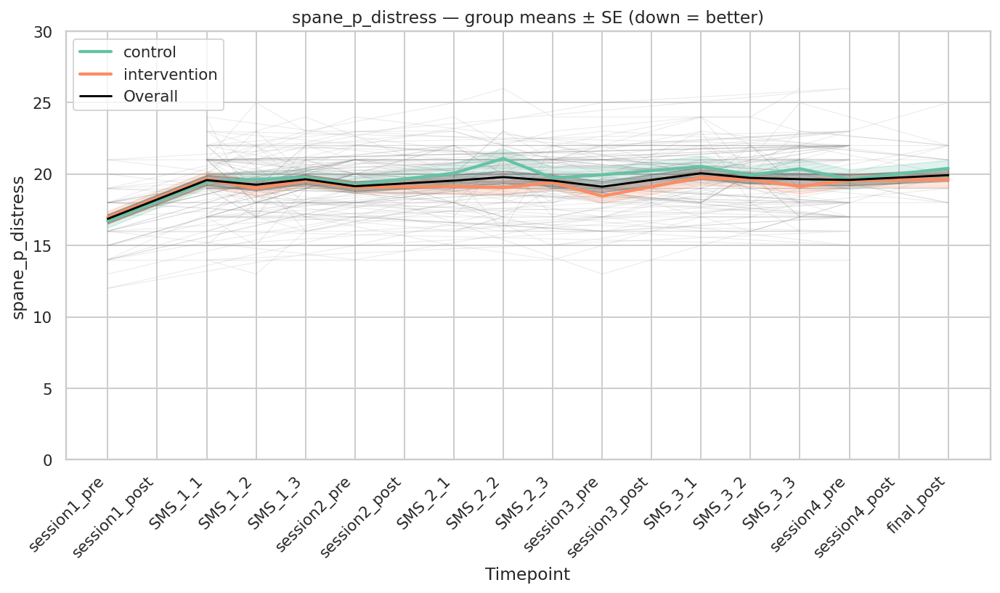


📊 Regression Summary: spane_p_distress (down = better)
  control      slope =    0.126   p = 0.0002
  intervention slope =    0.078   p = 0.0027
  Overall      slope =    0.097   p = 0.0000
  Δ (pre→final): t=-8.05, p=0.0000, n=52
------------------------------------------------------------


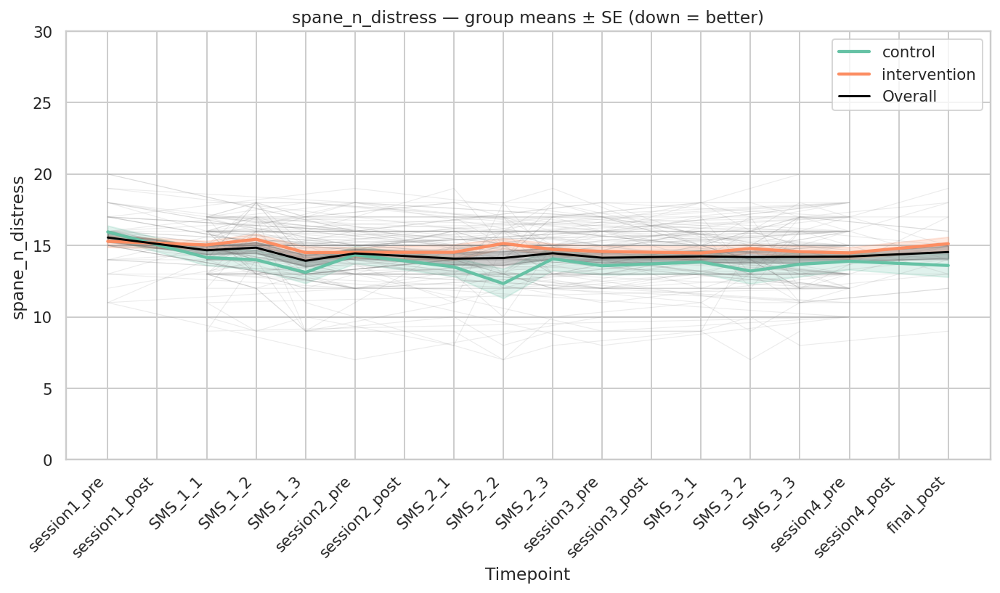


📊 Regression Summary: spane_n_distress (down = better)
  control      slope =   -0.078   p = 0.0358
  intervention slope =   -0.030   p = 0.1494
  Overall      slope =   -0.049   p = 0.0138
  Δ (pre→final): t=1.97, p=0.0601, n=52
------------------------------------------------------------


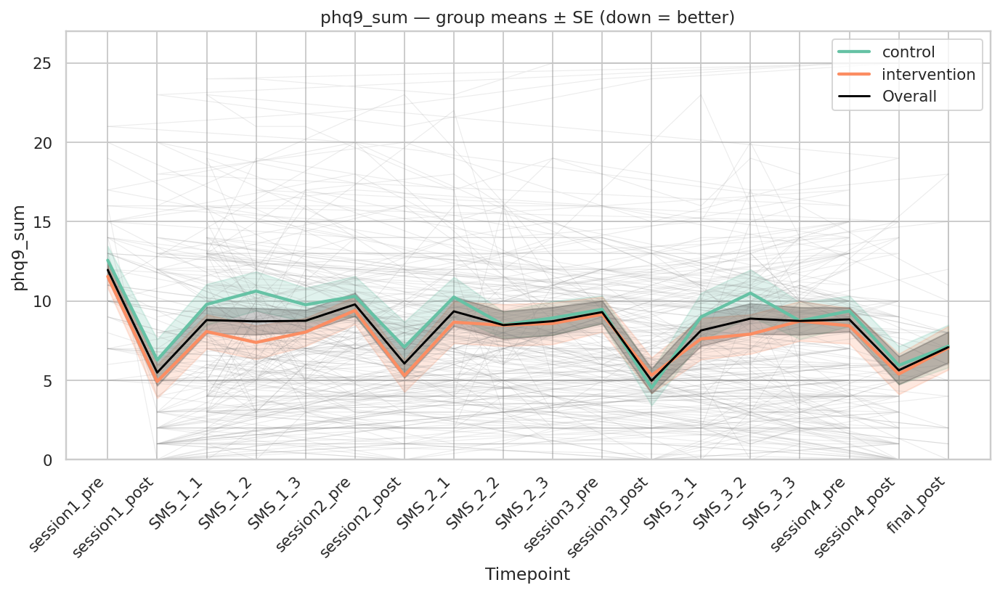


📊 Regression Summary: phq9_sum (down = better)
  control      slope =   -0.148   p = 0.0092
  intervention slope =   -0.068   p = 0.1849
  Overall      slope =   -0.101   p = 0.0083
  Δ (pre→final): t=6.28, p=0.0000, n=52
------------------------------------------------------------


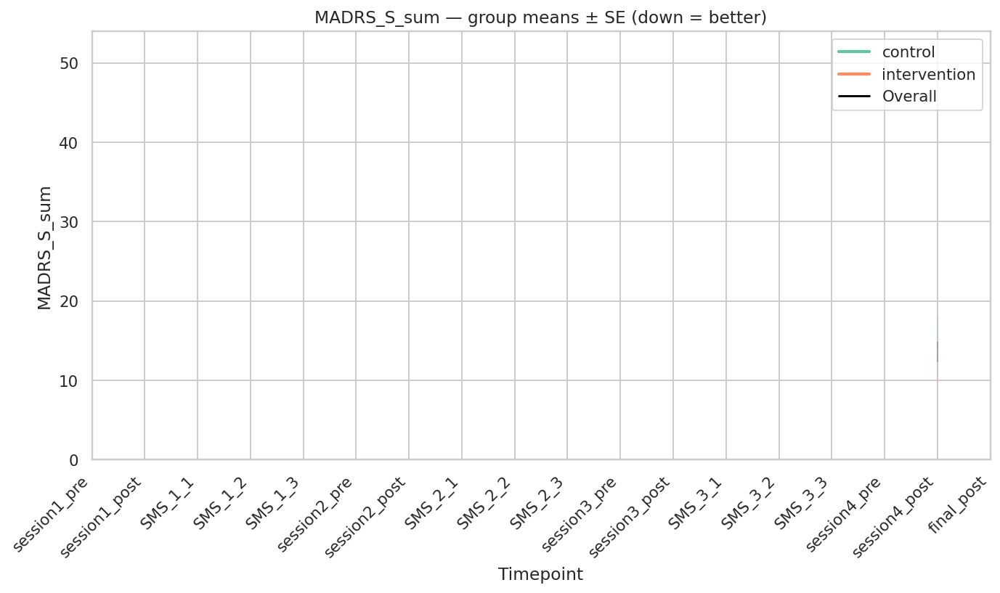


📊 Regression Summary: MADRS_S_sum (down = better)
  Overall      slope =    0.847   p = 0.0000
  Δ (pre→final): t=nan, p=nan, n=44
------------------------------------------------------------


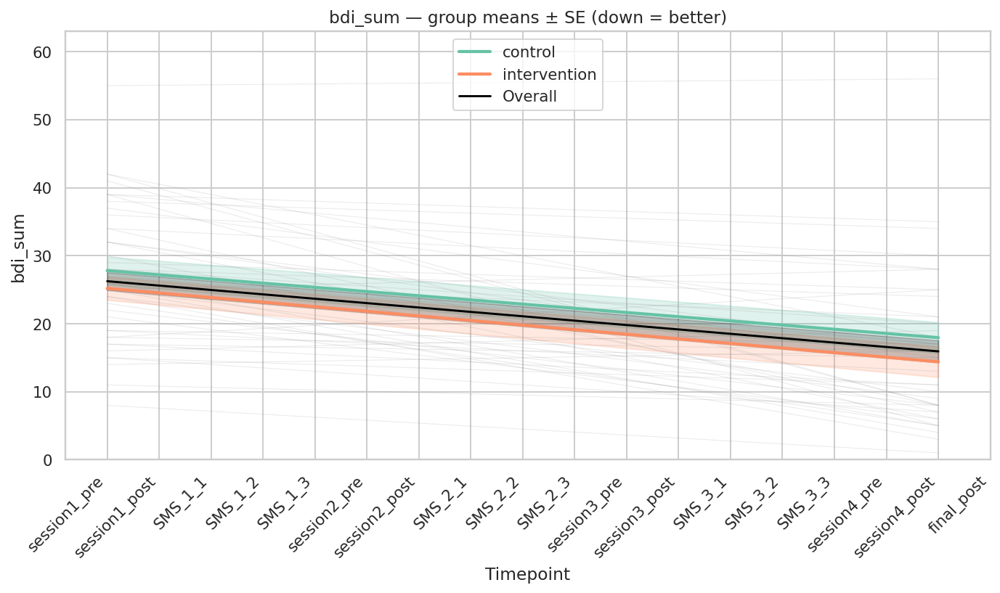


📊 Regression Summary: bdi_sum (down = better)
  Overall      slope =   -0.645   p = 0.0000
  Δ (pre→final): t=nan, p=nan, n=52
------------------------------------------------------------


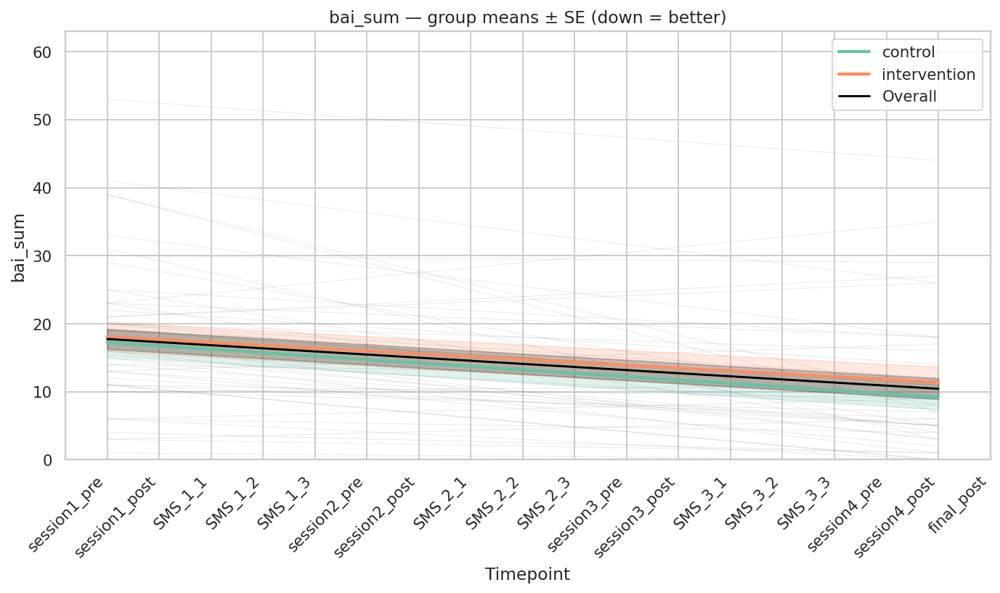


📊 Regression Summary: bai_sum (down = better)
  Overall      slope =   -0.457   p = 0.0008
  Δ (pre→final): t=nan, p=nan, n=52
------------------------------------------------------------


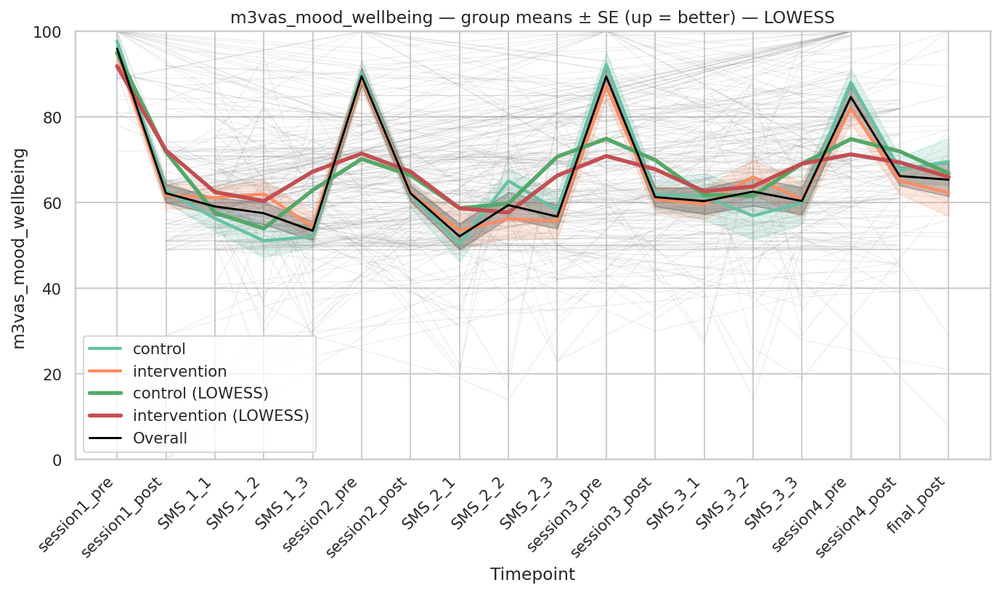


📊 Regression Summary: m3vas_mood_wellbeing (up = better)
  control      slope =    0.007   p = 0.9755
  intervention slope =   -0.346   p = 0.0649
  Overall      slope =   -0.199   p = 0.1659
  Δ (pre→final): t=7.76, p=0.0000, n=52
------------------------------------------------------------


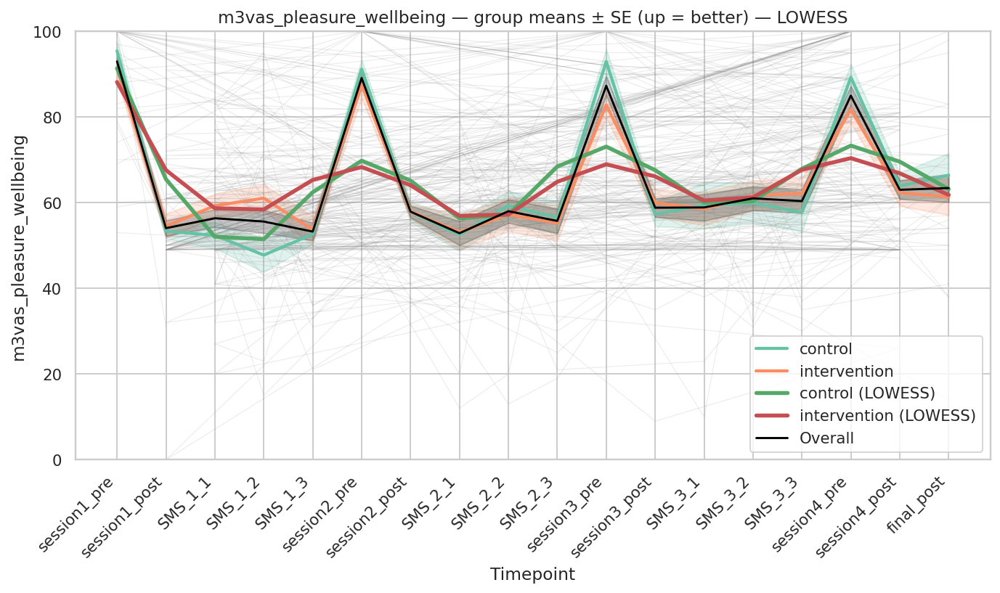


📊 Regression Summary: m3vas_pleasure_wellbeing (up = better)
  control      slope =    0.177   p = 0.4315
  intervention slope =   -0.195   p = 0.2800
  Overall      slope =   -0.041   p = 0.7718
  Δ (pre→final): t=8.03, p=0.0000, n=52
------------------------------------------------------------


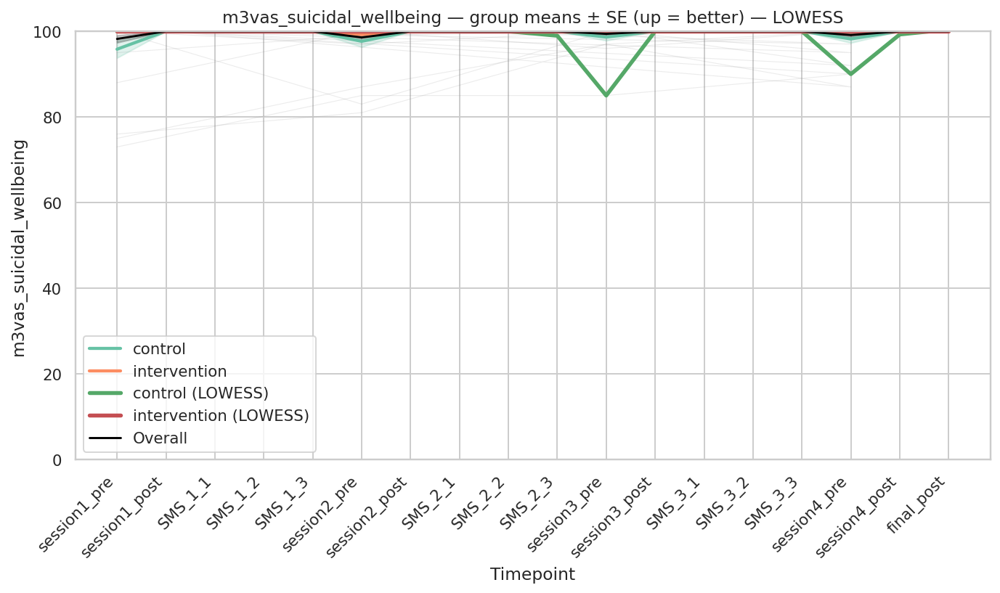


📊 Regression Summary: m3vas_suicidal_wellbeing (up = better)
  control      slope =    0.067   p = 0.0569
  intervention slope =    0.006   p = 0.4689
  Overall      slope =    0.031   p = 0.0437
  Δ (pre→final): t=-1.70, p=0.0985, n=52
------------------------------------------------------------


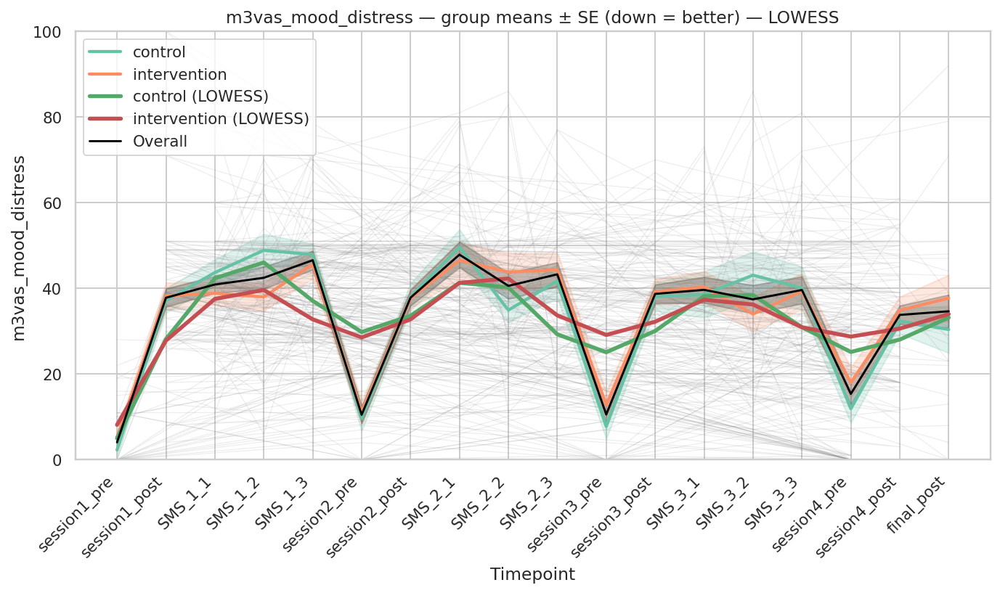


📊 Regression Summary: m3vas_mood_distress (down = better)
  control      slope =   -0.007   p = 0.9755
  intervention slope =    0.346   p = 0.0649
  Overall      slope =    0.199   p = 0.1659
  Δ (pre→final): t=-7.76, p=0.0000, n=52
------------------------------------------------------------


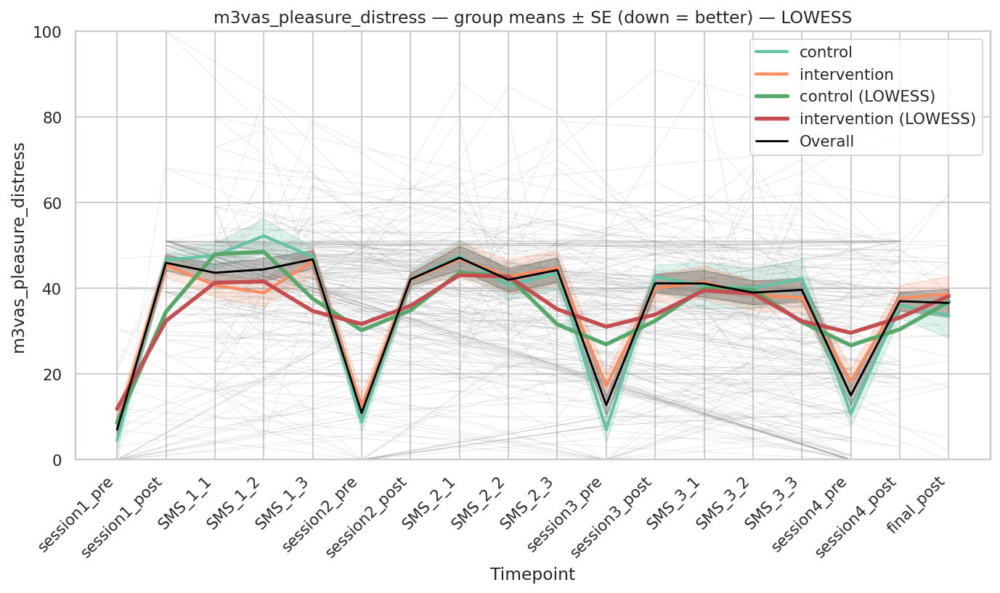


📊 Regression Summary: m3vas_pleasure_distress (down = better)
  control      slope =   -0.177   p = 0.4315
  intervention slope =    0.195   p = 0.2800
  Overall      slope =    0.041   p = 0.7718
  Δ (pre→final): t=-8.03, p=0.0000, n=52
------------------------------------------------------------


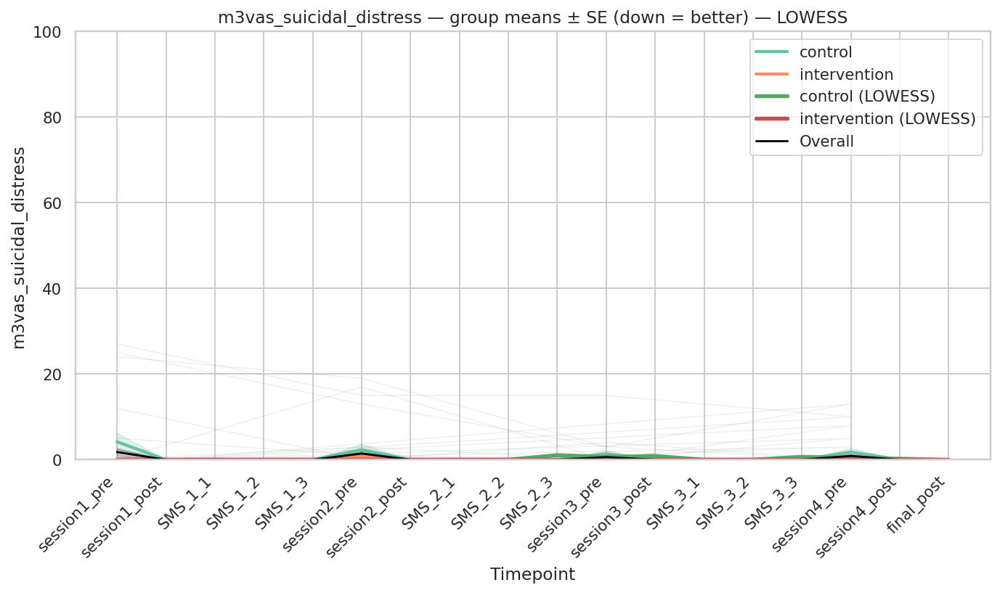


📊 Regression Summary: m3vas_suicidal_distress (down = better)
  control      slope =   -0.067   p = 0.0569
  intervention slope =   -0.006   p = 0.4689
  Overall      slope =   -0.031   p = 0.0437
  Δ (pre→final): t=1.70, p=0.0985, n=52
------------------------------------------------------------


In [74]:
# ===== Summary overlays with correct scales + robustness checks =====
import numpy as np, pandas as pd, matplotlib.pyplot as plt, seaborn as sns
import statsmodels.api as sm
from scipy.stats import ttest_rel
from statsmodels.nonparametric.smoothers_lowess import lowess

# ---------- 0) Guards & repairs ----------
if 'df_long' not in globals():
    raise RuntimeError("df_long is not defined. Re-run the preprocessing cell that builds df_long first.")

# ensure required columns exist
if 'timepoint' not in df_long.columns:
    raise RuntimeError("df_long.timepoint is missing. Re-run the preprocessing cell that tags timepoints.")

# make sure timepoint is ordered categorical with the expected sequence
ordered_timepoints = [
    'session1_pre','session1_post',
    'SMS_1_1','SMS_1_2','SMS_1_3',
    'session2_pre','session2_post',
    'SMS_2_1','SMS_2_2','SMS_2_3',
    'session3_pre','session3_post',
    'SMS_3_1','SMS_3_2','SMS_3_3',
    'session4_pre','session4_post',
    'final_post'
]
df_long['timepoint'] = pd.Categorical(df_long['timepoint'], categories=ordered_timepoints, ordered=True)

# create SPANE distress on the fly if missing
if 'spane_p_distress' not in df_long.columns and 'spane_p' in df_long.columns:
    df_long['spane_p'] = pd.to_numeric(df_long['spane_p'], errors='coerce')
    df_long['spane_p_distress'] = (30 - df_long['spane_p']).clip(lower=0, upper=30)

if 'spane_n_distress' not in df_long.columns and 'spane_n' in df_long.columns:
    df_long['spane_n'] = pd.to_numeric(df_long['spane_n'], errors='coerce')
    df_long['spane_n_distress'] = df_long['spane_n'].clip(lower=0, upper=30)

# ---------- 1) Per-measure display metadata ----------
MEASURE_META = {
    # SPANE (distress; down=better). We drop session*_post to match schedule.
    'spane_p_distress':  {'ylim': (0, 30), 'drop_posts': True,  'smooth': False, 'orientation': 'down'},
    'spane_n_distress':  {'ylim': (0, 30), 'drop_posts': True,  'smooth': False, 'orientation': 'down'},

    # Sums (down=better)
    'phq9_sum':          {'ylim': (0, 27), 'drop_posts': False, 'smooth': False, 'orientation': 'down'},
    'MADRS_S_sum':       {'ylim': (0, 54), 'drop_posts': False, 'smooth': False, 'orientation': 'down'},
    'bdi_sum':           {'ylim': (0, 63), 'drop_posts': False, 'smooth': False, 'orientation': 'down'},
    'bai_sum':           {'ylim': (0, 63), 'drop_posts': False, 'smooth': False, 'orientation': 'down'},

    # M3VAS (two views)
    'm3vas_mood_wellbeing':      {'ylim': (0,100), 'drop_posts': False, 'smooth': True,  'orientation': 'up'},
    'm3vas_pleasure_wellbeing':  {'ylim': (0,100), 'drop_posts': False, 'smooth': True,  'orientation': 'up'},
    'm3vas_suicidal_wellbeing':  {'ylim': (0,100), 'drop_posts': False, 'smooth': True,  'orientation': 'up'},
    'm3vas_mood_distress':       {'ylim': (0,100), 'drop_posts': False, 'smooth': True,  'orientation': 'down'},
    'm3vas_pleasure_distress':   {'ylim': (0,100), 'drop_posts': False, 'smooth': True,  'orientation': 'down'},
    'm3vas_suicidal_distress':   {'ylim': (0,100), 'drop_posts': False, 'smooth': True,  'orientation': 'down'},
}

# ---------- 2) helpers ----------
def _per_participant_timepoint_mean(df, measure):
    """One value per participant per timepoint before stats."""
    return (df.dropna(subset=['timepoint', 'part_id', measure])
              .groupby(['part_id', 'timepoint'], as_index=False)[measure]
              .mean())

def _paired_pre_final(df, measure, pre_label='session1_pre', post_label='final_post', min_n=5):
    """Robust paired t-test using per-participant means at pre vs final."""
    df_pp = _per_participant_timepoint_mean(df, measure)
    pre  = df_pp[df_pp['timepoint'] == pre_label].set_index('part_id')[measure]
    post = df_pp[df_pp['timepoint'] == post_label].set_index('part_id')[measure]
    ids = pre.index.intersection(post.index)
    if len(ids) < min_n:
        return None
    a = pre.loc[ids].astype(float).to_numpy().reshape(-1)
    b = post.loc[ids].astype(float).to_numpy().reshape(-1)
    t, p = ttest_rel(a, b, nan_policy='omit')
    return {'n': len(ids), 't': float(t), 'p': float(p)}

def summarize_and_plot(measure):
    if measure not in df_long.columns:
        print(f"Skipping {measure} (not found in df_long)")
        return

    meta = MEASURE_META.get(measure, {'ylim': None, 'drop_posts': False, 'smooth': False, 'orientation': 'down'})
    df_plot = df_long[['part_id','condition','timepoint',measure]].copy()
    df_plot[measure] = pd.to_numeric(df_plot[measure], errors='coerce')
    df_plot = df_plot.dropna(subset=[measure, 'timepoint'])

    if meta['drop_posts']:
        df_plot = df_plot[~df_plot['timepoint'].astype(str).str.match(r'^session\d+_post$')]

    if df_plot.empty:
        print(f"No data to plot for {measure}")
        return

    # numeric x for trend fitting
    df_plot['tp_num'] = df_plot['timepoint'].cat.codes

    # ----- FIGURE -----
    fig, ax = plt.subplots(figsize=(10,6))

    # light individual trajectories
    for pid, grp in df_plot.groupby('part_id'):
        ax.plot(grp['tp_num'], grp[measure], color='gray', alpha=0.15, linewidth=0.6)

    # condition means ± SE
    sns.lineplot(
        data=df_plot, x='tp_num', y=measure,
        hue='condition', estimator='mean', errorbar='se',
        lw=2.2, ax=ax, palette='Set2'
    )

    # optional LOWESS smooth for M3VAS
    if meta['smooth']:
        for cond, grp in df_plot.groupby('condition'):
            grp = grp.sort_values('tp_num')
            smoothed = lowess(grp[measure], grp['tp_num'], frac=0.25, return_sorted=True)
            ax.plot(smoothed[:,0], smoothed[:,1], lw=2.8, label=f"{cond} (LOWESS)")

    # overall mean ± SE
    sns.lineplot(
        data=df_plot, x='tp_num', y=measure,
        estimator='mean', errorbar='se',
        color='black', lw=1.5, label='Overall', ax=ax
    )

    # x tick labels
    ax.set_xticks(range(len(ordered_timepoints)))
    ax.set_xticklabels(ordered_timepoints, rotation=45, ha='right')

    # y limits per measure
    if meta['ylim']:
        ax.set_ylim(*meta['ylim'])

    orient_note = "(up = better)" if meta['orientation'] == 'up' else "(down = better)"
    ax.set_title(f"{measure} — group means ± SE {orient_note}{' — LOWESS' if meta['smooth'] else ''}")
    ax.set_xlabel("Timepoint")
    ax.set_ylabel(measure)
    ax.legend()
    plt.tight_layout()
    plt.show()

    # ----- STATS -----
    print(f"\n📊 Regression Summary: {measure} {orient_note}")
    # condition-level linear trends
    for cond, sub in df_plot.groupby('condition'):
        if len(sub['tp_num'].unique()) < 3:
            continue
        X = sm.add_constant(sub['tp_num'])
        model = sm.OLS(sub[measure], X, missing='drop').fit()
        slope = model.params.get('tp_num', np.nan)
        pval  = model.pvalues.get('tp_num', np.nan)
        print(f"  {cond:<12} slope = {slope:>8.3f}   p = {pval:>6.4f}")

    # overall
    X_all = sm.add_constant(df_plot['tp_num'])
    model_all = sm.OLS(df_plot[measure], X_all, missing='drop').fit()
    print(f"  {'Overall':<12} slope = {model_all.params['tp_num']:>8.3f}   p = {model_all.pvalues['tp_num']:>6.4f}")

    # paired pre→final
    res = _paired_pre_final(df_plot, measure, pre_label='session1_pre', post_label='final_post', min_n=5)
    if res is not None:
        print(f"  Δ (pre→final): t={res['t']:.2f}, p={res['p']:.4f}, n={res['n']}")
    print("-" * 60)

# ---------- 3) Run ----------
to_plot = [
    # SPANE distress (0–30)
    'spane_p_distress','spane_n_distress',
    # PHQ-9 / MADRS-S / BDI-II / BAI (native scales)
    'phq9_sum','MADRS_S_sum','bdi_sum','bai_sum',
    # M3VAS (both views; 0–100)
    'm3vas_mood_wellbeing','m3vas_pleasure_wellbeing','m3vas_suicidal_wellbeing',
    'm3vas_mood_distress','m3vas_pleasure_distress','m3vas_suicidal_distress'
]
for m in to_plot:
    summarize_and_plot(m)


In [79]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

def summarize_and_plot(measure, smooth=False):
    """Plots group means ± SE for a given measure with auto direction handling."""

    if measure not in df_long.columns:
        print(f"Skipping {measure} (not found in df_long)")
        return

    df = df_long.copy()

    # drop missing
    df = df[df[measure].notna()]
    if df.empty:
        print(f"{measure} has no non-NaN data.")
        return

    # Determine visual direction
    up_is_better = any(k in measure for k in ['_wellbeing', 'spane_p'])
    down_is_better = any(k in measure for k in ['_distress', 'MADRS', 'spane_n'])
    label = f"{measure} — group means ± SE ({'up' if up_is_better else 'down'} = better)"

    # Aggregate per participant/timepoint/condition
    if not all(c in df.columns for c in ['part_id', 'condition', 'timepoint']):
        print("Missing core columns ('part_id','condition','timepoint') for", measure)
        return

    df_summary = (
        df.groupby(['condition', 'timepoint'])[measure]
        .agg(['mean', 'sem'])
        .reset_index()
        .dropna(subset=['mean'])
    )

    # ensure ordered timepoints
    df_summary['timepoint'] = pd.Categorical(df_summary['timepoint'],
        categories=ordered_timepoints, ordered=True)
    df_summary = df_summary.sort_values('timepoint')

    plt.figure(figsize=(9,5))
    sns.lineplot(
        data=df_summary,
        x='timepoint', y='mean', hue='condition',
        palette={'control': '#5BA178', 'intervention': '#E56A54'},
        errorbar=('se'),
    )

    # Add overall mean line
    overall_means = (
        df.groupby('timepoint')[measure].mean()
        .reindex(ordered_timepoints)
    )
    plt.plot(overall_means.index, overall_means.values, color='k', linewidth=2, label='Overall')

    plt.xticks(rotation=45)
    plt.title(label)
    plt.ylabel(measure)
    plt.xlabel("Timepoint")
    plt.legend()
    plt.tight_layout()
    plt.show()

    # Summary table
    print(df_summary.pivot(index='timepoint', columns='condition', values='mean').round(2))

In [81]:
# --- 1. Fix M3VAS inversion (swap wellbeing/distress directions if needed) ---
for var in ['mood','pleasure','suicidal']:
    dcol = f"m3vas_{var}_distress"
    wcol = f"m3vas_{var}_wellbeing"
    if dcol in df_long.columns and wcol in df_long.columns:
        # check pattern: if wellbeing mean < distress mean, they're inverted
        if df_long[wcol].mean(skipna=True) < df_long[dcol].mean(skipna=True):
            tmp = df_long[wcol].copy()
            df_long[wcol] = 100 - df_long[dcol]
            df_long[dcol] = 100 - tmp
            print(f"✅ Fixed inversion for {var} (wellbeing ↔ distress)")

# --- 2. Fix MADRS reconstruction to allow partial completeness ---
madrs_cols = [c for c in df_long.columns if re.fullmatch(r"madrs_\d+(?:_1)?", c)]
if madrs_cols:
    madrs_block = pd.DataFrame({c: pd.to_numeric(df_long[c], errors='coerce') for c in madrs_cols})
    for c in madrs_block.columns:
        if madrs_block[c].max() <= 3:
            madrs_block[c] *= 2.0  # rescale if 0–3 format
    n_items = madrs_block.notna().sum(axis=1)
    mean_score = madrs_block.mean(axis=1, skipna=True)
    df_long['MADRS_S_sum'] = np.where(n_items >= 7, mean_score * 9, np.nan).clip(0, 54)
    print(f"✅ Rebuilt MADRS_S_sum with partial-case rule (>=7 items present)")

# Quick sanity checks
for c in ['MADRS_S_sum','m3vas_mood_wellbeing','m3vas_pleasure_wellbeing','m3vas_suicidal_wellbeing']:
    if c in df_long.columns:
        print(f"{c:28s}: {df_long[c].min(skipna=True):.1f}–{df_long[c].max(skipna=True):.1f} (n={df_long[c].notna().sum()})")


✅ Rebuilt MADRS_S_sum with partial-case rule (>=7 items present)
MADRS_S_sum                 : 2.0–40.4 (n=44)
m3vas_mood_wellbeing        : 0.0–100.0 (n=745)
m3vas_pleasure_wellbeing    : 0.0–100.0 (n=746)
m3vas_suicidal_wellbeing    : 73.0–100.0 (n=746)


In [83]:
# --- Robust MADRS rebuild handling "madrs" vs "mards" (and optional _1) ---
import re
import numpy as np
import pandas as pd

assert 'df_long' in globals(), "df_long is missing. Run the preprocessing cell first."

# 1) Find ALL candidate MADRS/MARDS item columns
pattern = re.compile(r'^(madrs|mards)_(\d+)(?:_1)?$')
madrs_like_cols = [c for c in df_long.columns if pattern.match(str(c))]

if not madrs_like_cols:
    print("No MADRS/MARDS item columns found.")
else:
    # 2) For each item 1..9, coalesce any variants into a single clean column
    clean_items = {}
    for i in range(1, 10):
        variants = [c for c in madrs_like_cols if pattern.match(str(c)) and pattern.match(str(c)).group(2) == str(i)]
        if not variants:
            continue
        # row-wise coalesce: take the first non-null among variants
        vals = (df_long[variants]
                .apply(pd.to_numeric, errors='coerce')
                .bfill(axis=1)
                .iloc[:, 0])
        clean_items[f"madrs_{i}"] = vals

    if not clean_items:
        print("No usable MADRS/MARDS items after coalescing.")
    else:
        madrs_block = pd.DataFrame(clean_items, index=df_long.index)

        # 3) Harmonize scale: if an item is 0–3, multiply by 2 → 0–6
        for c in madrs_block.columns:
            vmax = madrs_block[c].dropna().max()
            if pd.notna(vmax) and vmax <= 3:
                madrs_block[c] = madrs_block[c] * 2.0

        # 4) Build sum with partial-case rule (>=7 items available)
        n_items = madrs_block.notna().sum(axis=1)
        mean_score = madrs_block.mean(axis=1, skipna=True)
        madrs_sum = np.where(n_items >= 7, mean_score * 9, np.nan)  # preserve 9-item scale
        madrs_sum = pd.to_numeric(madrs_sum, errors='coerce').clip(0, 54)

        df_long['MADRS_S_sum'] = madrs_sum

        # 5) Sanity print
        available = int(np.sum(n_items >= 7))
        rng = (float(np.nanmin(madrs_sum)), float(np.nanmax(madrs_sum)))
        print(f"✅ Rebuilt MADRS_S_sum from madrs/mards items (>=7 present): n={available}, range={rng}")

# Optional: quick peek of means by timepoint (comment out if noisy)
if 'MADRS_S_sum' in df_long.columns:
    preview = (df_long
               .dropna(subset=['MADRS_S_sum','timepoint'])
               .groupby('timepoint')['MADRS_S_sum']
               .mean()
               .reindex(getattr(df_long['timepoint'], 'cat', df_long['timepoint']).categories, fill_value=np.nan))
    print("\nMADRS_S_sum mean by timepoint (NaNs = no data):")
    print(preview.round(2))


✅ Rebuilt MADRS_S_sum from madrs/mards items (>=7 present): n=96, range=(2.0, 44.0)

MADRS_S_sum mean by timepoint (NaNs = no data):
session1_pre     24.46
session1_post      NaN
SMS_1_1            NaN
SMS_1_2            NaN
SMS_1_3            NaN
session2_pre       NaN
session2_post      NaN
SMS_2_1            NaN
SMS_2_2            NaN
SMS_2_3            NaN
session3_pre       NaN
session3_post      NaN
SMS_3_1            NaN
SMS_3_2            NaN
SMS_3_3            NaN
session4_pre       NaN
session4_post    17.77
final_post         NaN
Name: MADRS_S_sum, dtype: float64


In [85]:
import numpy as np
import pandas as pd
import re

# --- Detect and harmonize m3VAS scales ---
m3_cols = [c for c in df_long.columns if c.startswith("m3vas_")]

def normalize_m3vas(series, varname):
    """Normalize m3VAS scales so all run 0–100 (up=better)."""
    if series.isna().all():
        return series

    # Identify raw range
    s_min, s_max = series.min(skipna=True), series.max(skipna=True)

    # Case 1: -50→50 scale → shift + rescale to 0–100
    if s_min < 0 and s_max <= 50:
        fixed = (series + 50) * 1.0
        print(f"🔧 {varname}: converted −50→+50 scale → 0–100")
        return fixed

    # Case 2: 0→10 or 0→7 numeric entry (rare)
    if s_max <= 10:
        fixed = series * 10
        print(f"🔧 {varname}: converted 0–10 → 0–100")
        return fixed

    # Case 3: already 0–100, leave as is
    return series

# Apply to all m3VAS columns except suicidality (already consistent)
for col in m3_cols:
    if "suicidal" not in col:
        df_long[col] = normalize_m3vas(pd.to_numeric(df_long[col], errors='coerce'), col)

# --- Re-check directionality (up = better) ---
for domain in ['mood', 'pleasure', 'suicidal']:
    w = f"m3vas_{domain}_wellbeing"
    d = f"m3vas_{domain}_distress"
    if w in df_long.columns and d in df_long.columns:
        # Invert if wellbeing < distress on average
        if df_long[w].mean(skipna=True) < df_long[d].mean(skipna=True):
            df_long[w], df_long[d] = 100 - df_long[d], 100 - df_long[w]
            print(f"✅ Re-aligned direction for m3vas_{domain}")

# --- Quick range check ---
print("\nNormalized m3VAS column ranges:")
for c in m3_cols:
    if c in df_long:
        print(f"{c:30s}: {df_long[c].min(skipna=True):6.1f} – {df_long[c].max(skipna=True):6.1f}")



Normalized m3VAS column ranges:
m3vas_suicidal                : -100.0 –   27.0
m3vas_mood                    :  -50.0 –  100.0
m3vas_pleasure                :  -50.0 –  100.0
m3vas_mood_distress           :   -0.0 –  100.0
m3vas_mood_wellbeing          :    0.0 –  100.0
m3vas_pleasure_distress       :   -0.0 –  100.0
m3vas_pleasure_wellbeing      :    0.0 –  100.0
m3vas_suicidal_distress       :    0.0 –   27.0
m3vas_suicidal_wellbeing      :   73.0 –  100.0


In [87]:
import re
import numpy as np
import pandas as pd

def _first_match(df, pats):
    for pat in pats:
        for c in df.columns:
            if re.fullmatch(pat, str(c)):
                return c
    return None

def rebuild_m3vas(df):
    """Recreate clean m3VAS distress (0–100, higher=worse) and wellbeing (0–100, higher=better)."""
    out_cols = []
    for var in ('mood','pleasure','suicidal'):
        raw_col = _first_match(df, [rf"m3vas_{var}", rf"m3vas_{var}_1"])
        chg_col = _first_match(df, [rf"m3vas_ch_{var}", rf"m3vas_ch_{var}_1"])

        raw = pd.to_numeric(df[raw_col], errors='coerce') if raw_col else pd.Series(np.nan, index=df.index)
        chg = pd.to_numeric(df[chg_col], errors='coerce') if chg_col else pd.Series(np.nan, index=df.index)

        # change −50..+50 (positive=better) → distress 0..100 (higher=worse)
        chg_as_distress = 50 - chg  # +50 → 0 (best), −50 → 100 (worst)

        # Prefer raw when available; otherwise use converted change
        distress = raw.where(~raw.isna(), chg_as_distress).clip(0, 100)
        wellbeing = (100 - distress).clip(0, 100)

        df[f"m3vas_{var}_distress"]  = distress
        df[f"m3vas_{var}_wellbeing"] = wellbeing
        out_cols += [f"m3vas_{var}_distress", f"m3vas_{var}_wellbeing"]

    # Optional: drop any legacy m3vas columns that aren’t the rebuilt set
    legacy = [c for c in df.columns if c.startswith("m3vas_") and c not in out_cols and not re.fullmatch(r"m3vas_(ch_)?(mood|pleasure|suicidal)(_1)?", c)]
    if legacy:
        df.drop(columns=legacy, inplace=True, errors='ignore')

    # Sanity print
    print("m3VAS rebuilt. Ranges (0–100 expected):")
    for c in out_cols:
        s = pd.to_numeric(df[c], errors='coerce')
        print(f"  {c:28s} [{np.nanmin(s):.1f}, {np.nanmax(s):.1f}] n={s.notna().sum()}")

# ---- RUN IT ----
rebuild_m3vas(df_long)


m3VAS rebuilt. Ranges (0–100 expected):
  m3vas_mood_distress          [0.0, 100.0] n=745
  m3vas_mood_wellbeing         [0.0, 100.0] n=745
  m3vas_pleasure_distress      [0.0, 100.0] n=746
  m3vas_pleasure_wellbeing     [0.0, 100.0] n=746
  m3vas_suicidal_distress      [0.0, 27.0] n=746
  m3vas_suicidal_wellbeing     [73.0, 100.0] n=746


In [89]:
import pandas as pd
import numpy as np
import re

def rebuild_m3vas_continuous(df):
    """
    Rebuilds m3VAS mood / pleasure / suicidal into single continuous 0–100 trajectories,
    combining raw state (0–100) and change (−50→+50) forms.
    """
    df = df.copy()

    domains = ['mood', 'pleasure', 'suicidal']
    subj_col = 'part_id' if 'part_id' in df.columns else None
    time_col = 'timepoint'

    if subj_col is None or time_col not in df.columns:
        raise ValueError("df must contain 'part_id' and 'timepoint' columns")

    for dom in domains:
        raw_col = next((c for c in df.columns if re.fullmatch(fr"m3vas_{dom}(_1)?", c)), None)
        chg_col = next((c for c in df.columns if re.fullmatch(fr"m3vas_ch_{dom}(_1)?", c)), None)

        if not raw_col and not chg_col:
            print(f"⚠️ Skipping {dom} — no columns found.")
            continue

        df[f"{dom}_merged"] = np.nan

        for pid, sub in df.groupby(subj_col):
            sub = sub.sort_values(time_col)
            prev_pre_val = np.nan

            for i, row in sub.iterrows():
                tp = row[time_col]
                raw_val = pd.to_numeric(row.get(raw_col, np.nan), errors='coerce')
                chg_val = pd.to_numeric(row.get(chg_col, np.nan), errors='coerce')

                val = np.nan
                if pd.notna(raw_val):
                    val = raw_val
                    if "_pre" in str(tp):  # store baseline for change conversion
                        prev_pre_val = raw_val
                elif pd.notna(chg_val) and "_post" in str(tp) and pd.notna(prev_pre_val):
                    # Convert −50→+50 change into absolute post value
                    val = np.clip(prev_pre_val + chg_val, 0, 100)
                elif pd.notna(chg_val):
                    # change value but not tied to pre; approximate mid-point baseline 50
                    val = np.clip(50 + chg_val, 0, 100)

                df.at[i, f"{dom}_merged"] = val

        # Create distress (higher=worse) and wellbeing (higher=better) forms
        df[f"m3vas_{dom}_distress"] = df[f"{dom}_merged"]
        df[f"m3vas_{dom}_wellbeing"] = 100 - df[f"{dom}_merged"]

        # Clip just to be safe
        df[f"m3vas_{dom}_distress"] = df[f"m3vas_{dom}_distress"].clip(0, 100)
        df[f"m3vas_{dom}_wellbeing"] = df[f"m3vas_{dom}_wellbeing"].clip(0, 100)

        print(f"✅ Built continuous m3VAS trajectory for {dom}: "
              f"range {df[f'{dom}_merged'].min(skipna=True):.1f}–{df[f'{dom}_merged'].max(skipna=True):.1f}")

    return df

# ---- Run the harmonizer ----
df_long = rebuild_m3vas_continuous(df_long)


✅ Built continuous m3VAS trajectory for mood: range -50.0–100.0
✅ Built continuous m3VAS trajectory for pleasure: range -50.0–100.0
✅ Built continuous m3VAS trajectory for suicidal: range -100.0–27.0


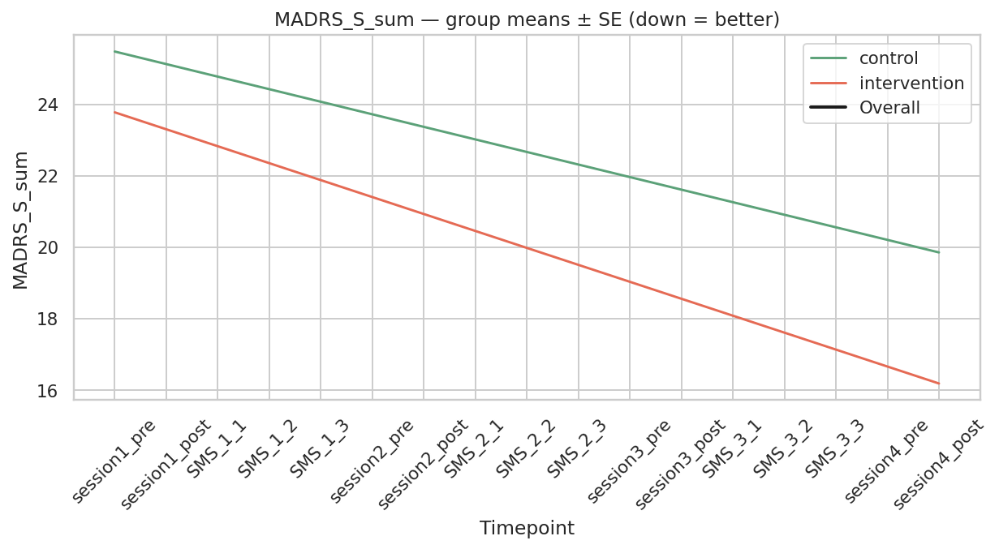

condition      control  intervention
timepoint                           
session1_pre     25.48         23.77
session4_post    19.85         16.18


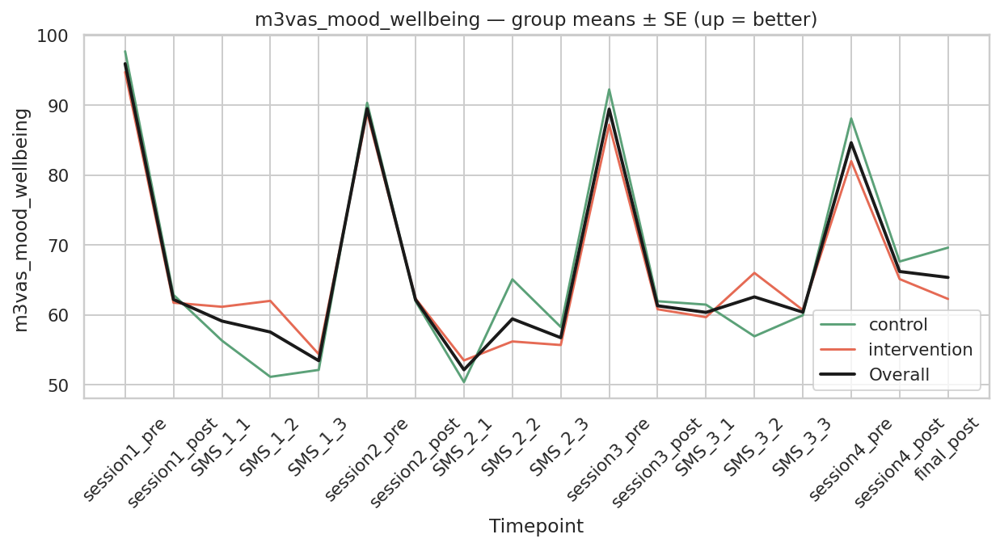

condition      control  intervention
timepoint                           
session1_pre     97.71         94.74
session1_post    62.86         61.73
SMS_1_1          56.32         61.15
SMS_1_2          51.12         62.00
SMS_1_3          52.12         54.38
session2_pre     90.35         88.89
session2_post    61.95         62.33
SMS_2_1          50.38         53.48
SMS_2_2          65.08         56.19
SMS_2_3          58.27         55.68
session3_pre     92.26         87.21
session3_post    61.95         60.80
SMS_3_1          61.46         59.67
SMS_3_2          56.93         66.00
SMS_3_3          59.94         60.70
session4_pre     88.11         82.00
session4_post    67.63         65.12
final_post       69.62         62.28


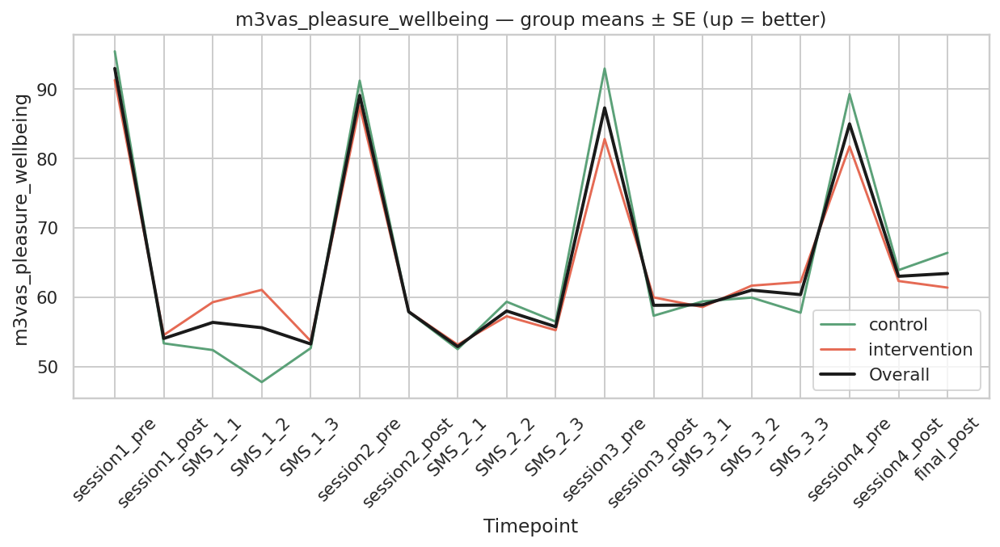

condition      control  intervention
timepoint                           
session1_pre     95.43         91.29
session1_post    53.33         54.53
SMS_1_1          52.37         59.27
SMS_1_2          47.75         61.04
SMS_1_3          52.65         53.67
session2_pre     91.20         87.52
session2_post    57.85         57.93
SMS_2_1          52.50         53.14
SMS_2_2          59.33         57.24
SMS_2_3          56.47         55.23
session3_pre     92.95         82.79
session3_post    57.32         59.96
SMS_3_1          59.38         58.57
SMS_3_2          59.93         61.65
SMS_3_3          57.75         62.17
session4_pre     89.26         81.72
session4_post    63.89         62.32
final_post       66.38         61.37


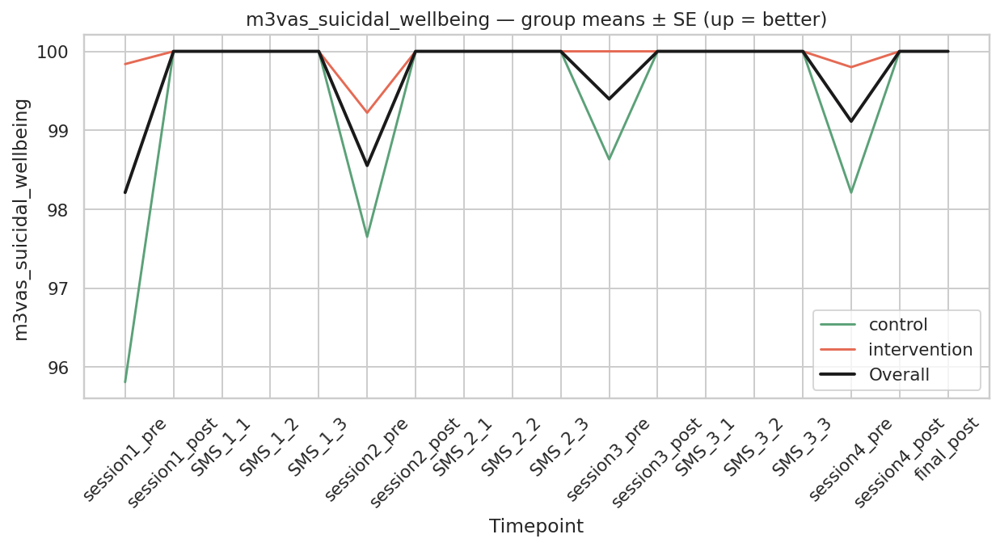

condition      control  intervention
timepoint                           
session1_pre     95.81         99.84
session1_post   100.00        100.00
SMS_1_1         100.00        100.00
SMS_1_2         100.00        100.00
SMS_1_3         100.00        100.00
session2_pre     97.65         99.22
session2_post   100.00        100.00
SMS_2_1         100.00        100.00
SMS_2_2         100.00        100.00
SMS_2_3         100.00        100.00
session3_pre     98.63        100.00
session3_post   100.00        100.00
SMS_3_1         100.00        100.00
SMS_3_2         100.00        100.00
SMS_3_3         100.00        100.00
session4_pre     98.21         99.80
session4_post   100.00        100.00
final_post      100.00        100.00


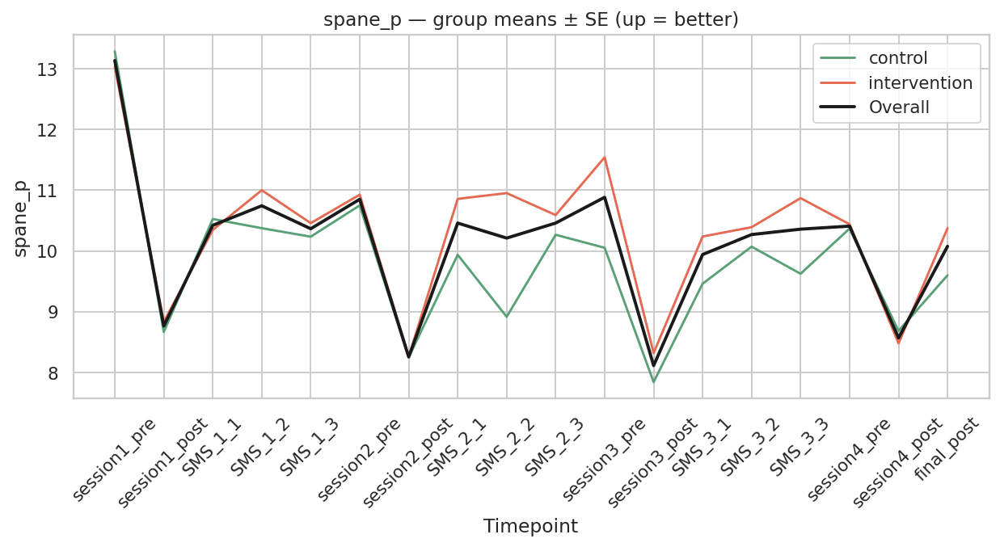

condition      control  intervention
timepoint                           
session1_pre     13.29         13.03
session1_post     8.67          8.83
SMS_1_1          10.53         10.35
SMS_1_2          10.38         11.00
SMS_1_3          10.24         10.46
session2_pre     10.75         10.93
session2_post     8.25          8.26
SMS_2_1           9.94         10.86
SMS_2_2           8.92         10.95
SMS_2_3          10.27         10.59
session3_pre     10.05         11.54
session3_post     7.84          8.32
SMS_3_1           9.46         10.24
SMS_3_2          10.07         10.39
SMS_3_3           9.62         10.87
session4_pre     10.37         10.44
session4_post     8.68          8.48
final_post        9.60         10.38


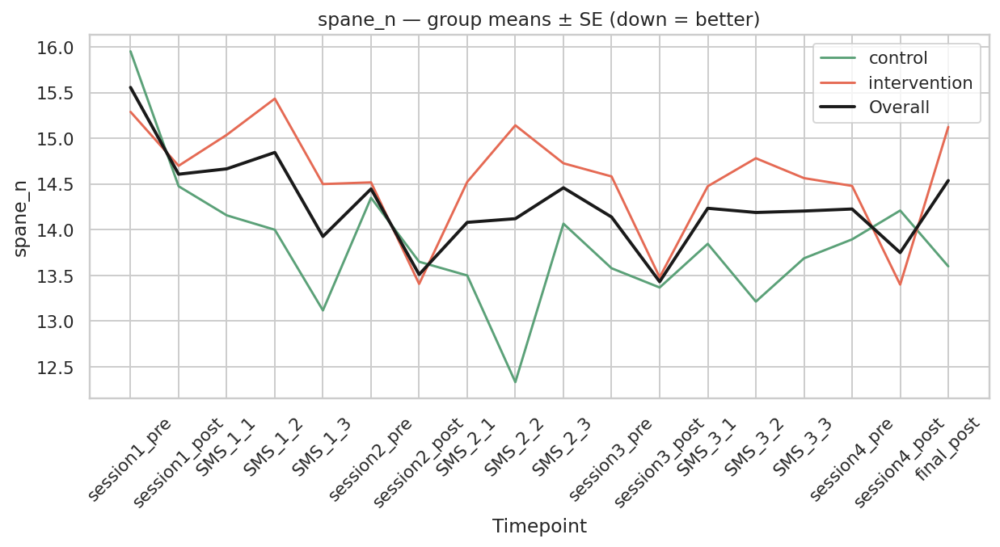

condition      control  intervention
timepoint                           
session1_pre     15.95         15.29
session1_post    14.48         14.70
SMS_1_1          14.16         15.04
SMS_1_2          14.00         15.43
SMS_1_3          13.12         14.50
session2_pre     14.35         14.52
session2_post    13.65         13.41
SMS_2_1          13.50         14.52
SMS_2_2          12.33         15.14
SMS_2_3          14.07         14.73
session3_pre     13.58         14.58
session3_post    13.37         13.48
SMS_3_1          13.85         14.48
SMS_3_2          13.21         14.78
SMS_3_3          13.69         14.57
session4_pre     13.89         14.48
session4_post    14.21         13.40
final_post       13.60         15.12


In [90]:
for m in [
    'MADRS_S_sum',
    'm3vas_mood_wellbeing',
    'm3vas_pleasure_wellbeing',
    'm3vas_suicidal_wellbeing',
    'spane_p',
    'spane_n'
]:
    summarize_and_plot(m)



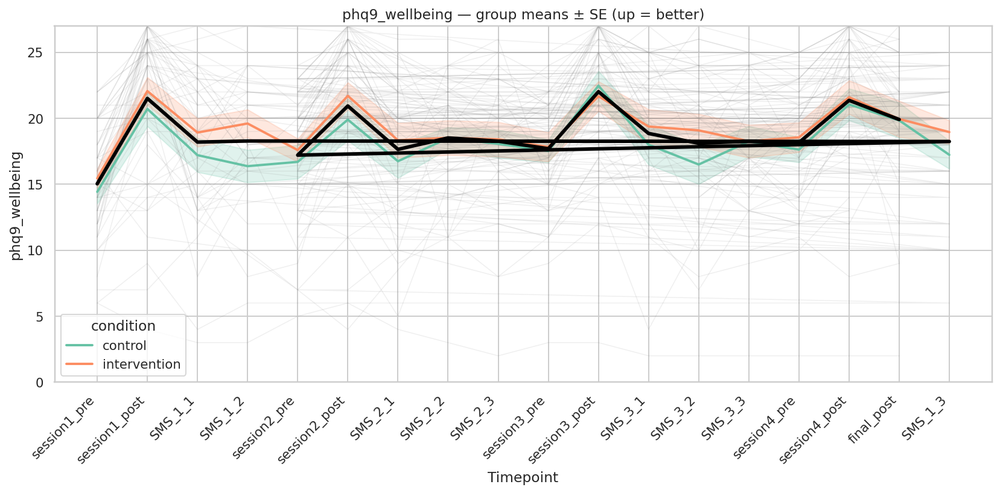

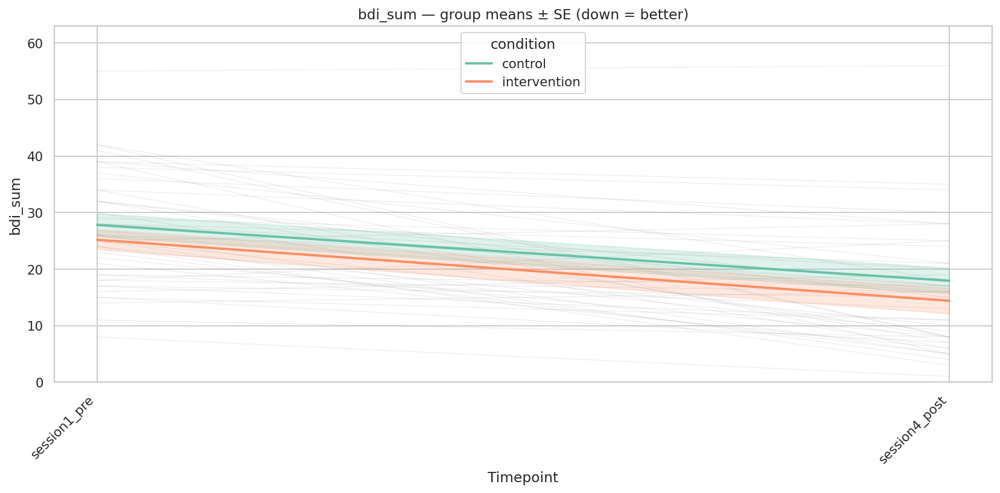

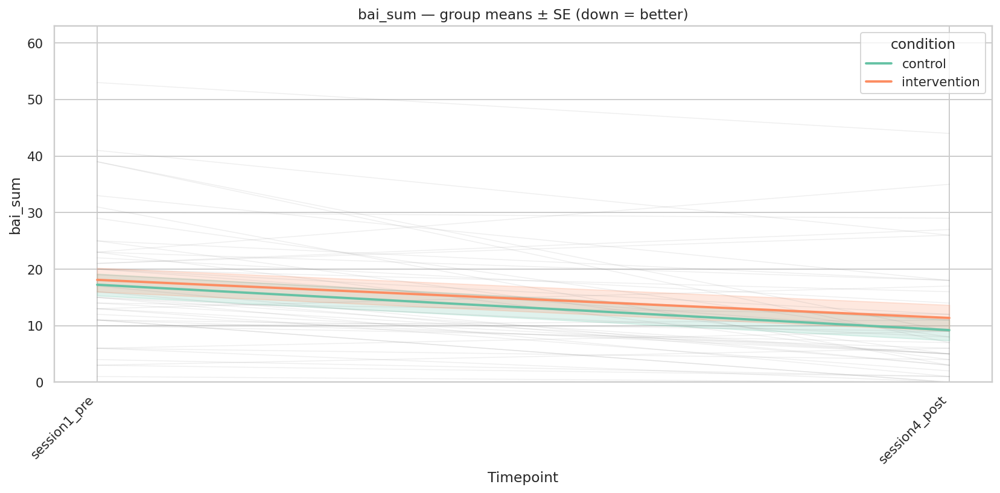

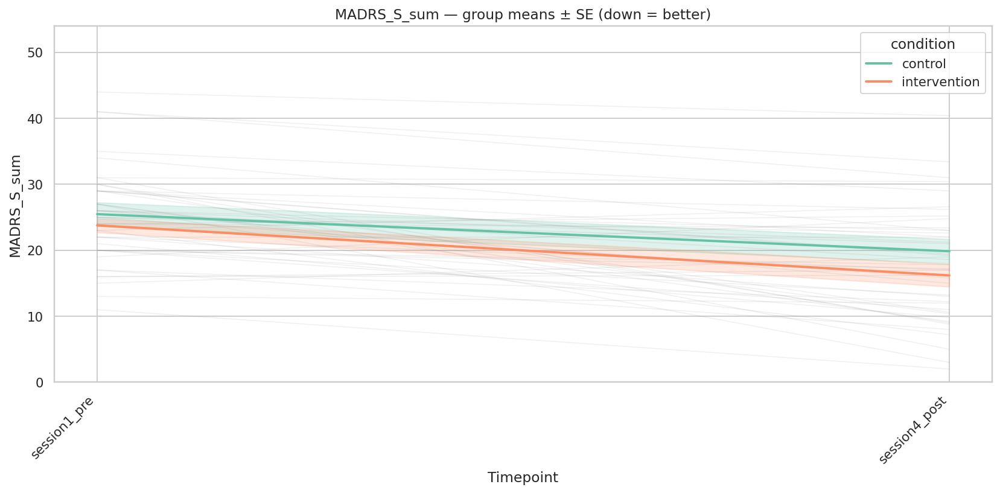

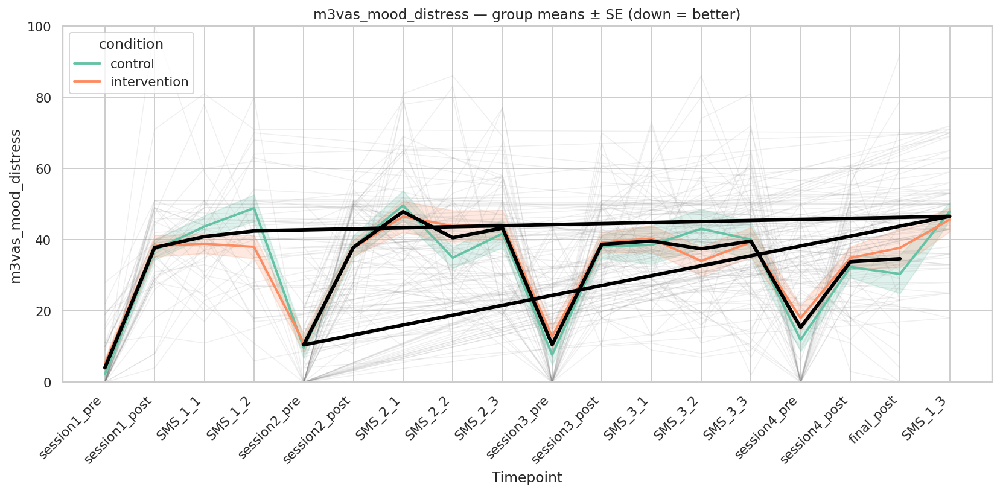

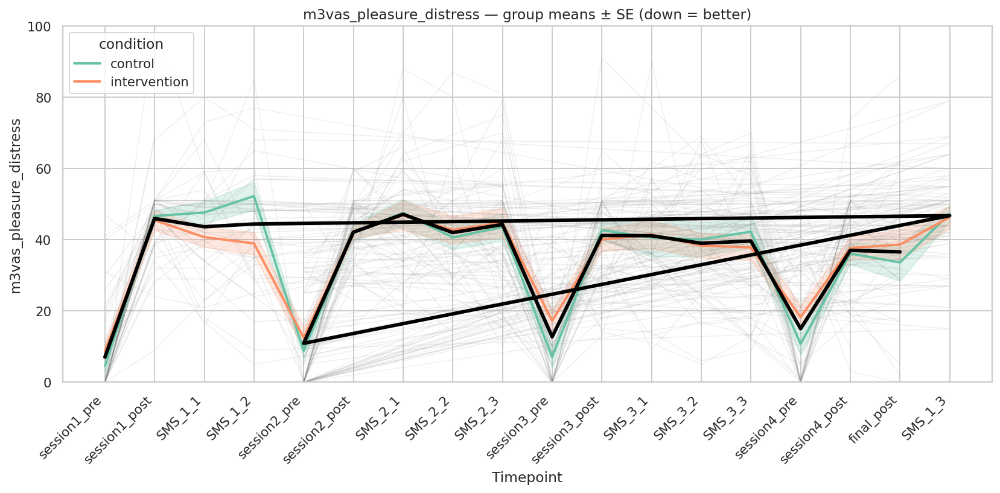

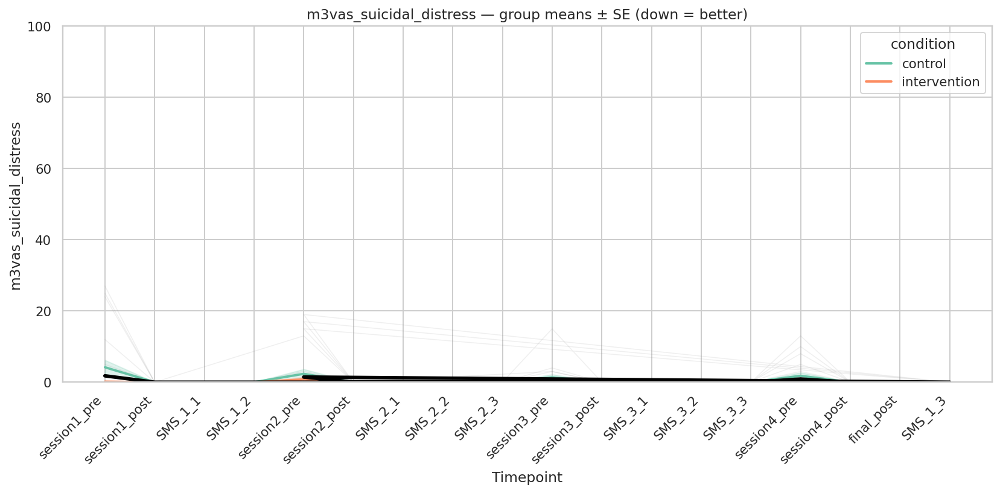

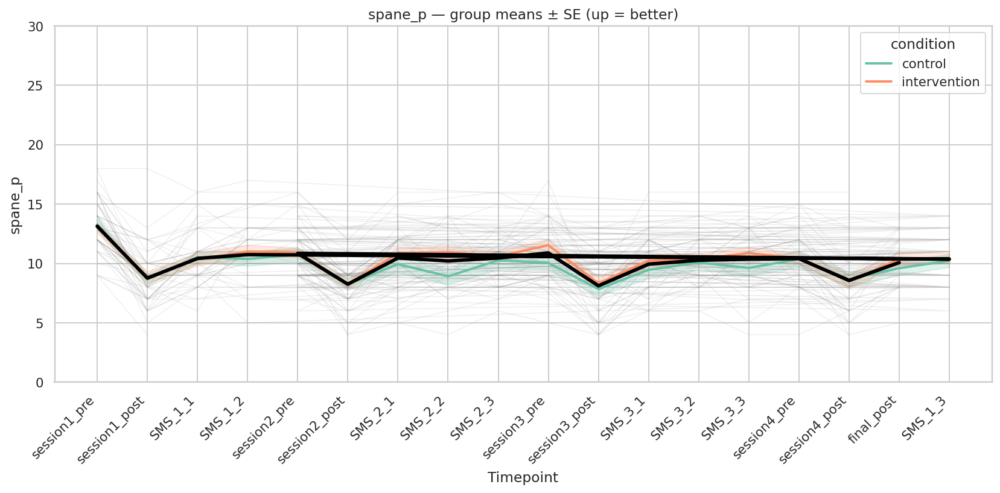

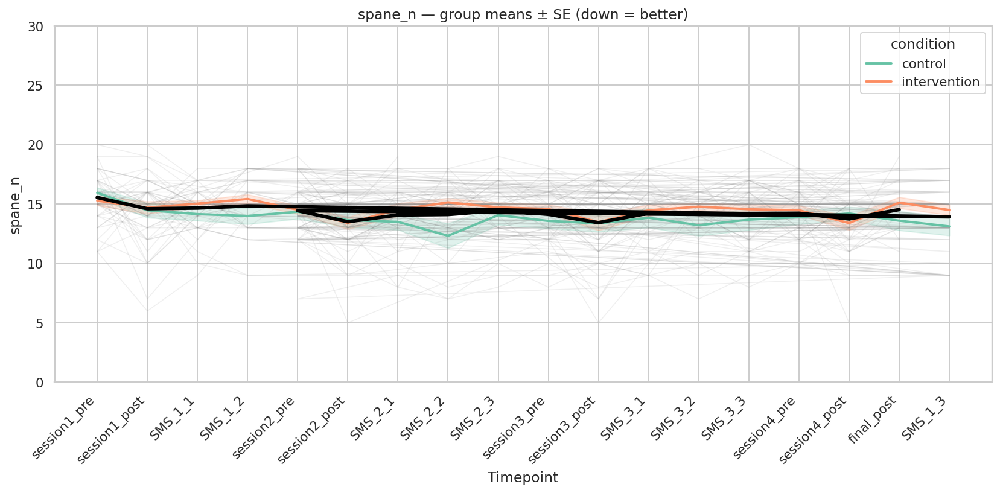

In [93]:
# =========================
# Fix directions + timepoint order + plotting (one cell)
# =========================

import re, numpy as np, pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

assert 'df_long' in globals(), "df_long missing."
assert 'ordered_timepoints' in globals(), "ordered_timepoints missing."

# ---------- 1) Normalize timepoints ----------
def normalize_tp(tp: str):
    if pd.isna(tp): return np.nan
    s = str(tp).strip()
    s = re.sub(r'\s+', '', s)                # remove whitespace
    s = re.sub(r'_+', '_', s)                # collapse multiple underscores
    # Canonicalize SMS_X_Y and sessionX_pre/post
    m = re.fullmatch(r'SMS_(\d+)_(\d+)', s)
    if m:
        x, y = int(m.group(1)), int(m.group(2))
        if x in (1,2,3,4) and y in (1,2,3):
            return f"SMS_{x}_{y}"
        return np.nan
    m = re.fullmatch(r'session(\d+)_(pre|post)', s)
    if m:
        x = int(m.group(1))
        if x in (1,2,3,4):
            return f"session{x}_{m.group(2)}"
        return np.nan
    if s == 'final_post':
        return s
    return np.nan

df_long['timepoint'] = df_long['timepoint'].map(normalize_tp)

# Enforce strict category order (anything not in list becomes NaN and is dropped by plots)
df_long['timepoint'] = pd.Categorical(df_long['timepoint'],
                                      categories=ordered_timepoints,
                                      ordered=True)

# ---------- 2) PHQ-9 wellbeing (invert so up = better) ----------
if 'phq9_sum' in df_long.columns:
    df_long['phq9_sum'] = pd.to_numeric(df_long['phq9_sum'], errors='coerce').clip(0, 27)
    df_long['phq9_wellbeing'] = (27 - df_long['phq9_sum']).clip(0, 27)

# ---------- 3) m3VAS: use DISTRESS for mood/pleasure (down = better) ----------
# (We assume you already ran the “build_m3vas_state” step I gave you, so these exist:)
m3_cols_needed = ['m3vas_mood_distress','m3vas_pleasure_distress','m3vas_suicidal_distress']
for c in m3_cols_needed:
    if c in df_long.columns:
        df_long[c] = pd.to_numeric(df_long[c], errors='coerce').clip(0, 100)

# ---------- 4) SPANE sanity (keep p: up = better, n: down = better) ----------
for c, cap in [('spane_p', 30), ('spane_n', 30)]:
    if c in df_long.columns:
        df_long[c] = pd.to_numeric(df_long[c], errors='coerce').clip(0, cap)

# ---------- 5) Plot helper ----------
YMAX = {
    'phq9_wellbeing': 27,
    'bdi_sum': 63, 'bai_sum': 63, 'MADRS_S_sum': 54,
    'spane_p': 30, 'spane_n': 30,
    'm3vas_mood_distress': 100, 'm3vas_pleasure_distress': 100, 'm3vas_suicidal_distress': 100,
}

UP_BETTER = {'phq9_wellbeing','spane_p'}
DOWN_BETTER = {'bdi_sum','bai_sum','MADRS_S_sum','spane_n',
               'm3vas_mood_distress','m3vas_pleasure_distress','m3vas_suicidal_distress'}

def plot_measure(measure, by_condition=True):
    if measure not in df_long.columns:
        print(f"Skip {measure} (missing)."); return

    d = df_long.dropna(subset=['timepoint', measure]).copy()
    if d.empty:
        print(f"No data for {measure}."); return

    plt.figure(figsize=(12,6))
    # faint spaghetti
    for pid, g in d.groupby('part_id'):
        g = g.sort_values('timepoint')
        plt.plot(g['timepoint'], g[measure], color='gray', alpha=0.12, lw=0.8)

    # condition means ± SE (honors our categorical order)
    if by_condition and 'condition' in d.columns:
        sns.lineplot(data=d, x='timepoint', y=measure, hue='condition',
                     estimator='mean', errorbar='se', lw=2, palette='Set2')

    # overall mean in correct order
    mean_tp = d.groupby('timepoint', observed=True)[measure].mean().reindex(ordered_timepoints)
    plt.plot(mean_tp.index, mean_tp.values, color='black', lw=3, label='Overall mean')

    # labels
    ymax = YMAX.get(measure, None)
    if ymax: plt.ylim(0, ymax)
    direction = "up = better" if measure in UP_BETTER else ("down = better" if measure in DOWN_BETTER else "")
    plt.title(f"{measure} — group means ± SE ({direction})")
    plt.xticks(rotation=45, ha='right')
    plt.xlabel("Timepoint"); plt.ylabel(measure)
    plt.tight_layout(); plt.show()

# ---------- 6) Plot with the requested directions ----------
# PHQ-9: inverted wellbeing (up = better)
plot_measure('phq9_wellbeing')

# BDI / BAI / MADRS (down = better) — you said these looked perfect
for m in ('bdi_sum','bai_sum','MADRS_S_sum'):
    if m in df_long.columns:
        plot_measure(m)

# m3VAS: use *distress* for mood & pleasure (down = better); suicidality distress (down = better)
for m in ('m3vas_mood_distress','m3vas_pleasure_distress','m3vas_suicidal_distress'):
    if m in df_long.columns:
        plot_measure(m)

# SPANE: p up=better, n down=better
for m in ('spane_p','spane_n'):
    if m in df_long.columns:
        plot_measure(m)



Mean Tolerability ± SD Assessment Across Sessions (Whole-Sample & Just-Adverse)
*   run previous monitoring and stratification scripts first to generate necessary dfs

In [19]:
import numpy as np
import pandas as pd
from pathlib import Path

#####
# 0) Load and clean all post-session data (sessions 1–4)
#####
from pathlib import Path
import glob

DATA_DIR = Path('/content')
# Glob all post-session CSVs (e.g. sessions 1-3 and session 4)
post_files = sorted(str(f) for f in DATA_DIR.glob('wp2_post_session*csv'))

# Read each file, skip metadata row, and assign timepoint
frames = []
for fpath in post_files:
    temp = pd.read_csv(fpath, header=0, skiprows=[1], dtype=str)
    temp.columns = temp.columns.str.strip()
    temp['part_id'] = temp['part_id'].astype(str).str.strip()
    # If session_n column present, map it
    if 'session_n' in temp.columns:
        temp['session_n'] = pd.to_numeric(temp['session_n'], errors='coerce')
        temp['timepoint'] = temp['session_n'].apply(lambda x: f'session{int(x)}_post' if pd.notna(x) else None)
    else:
        # infer session4_post from filename
        temp['timepoint'] = 'session4_post'
    frames.append(temp)

# Concatenate all sessions
df_raw = pd.concat(frames, ignore_index=True)

#####
# 1) Compute tol_score (max across all tol_follow items)
##### tol_score per row (max across all tol_follow items)
#####
tol_cols = [c for c in df_raw.columns if c.lower().startswith('tol_follow')]
for col in tol_cols:
    df_raw[col] = pd.to_numeric(df_raw[col], errors='coerce').fillna(0)

df_raw['tol_score'] = df_raw[tol_cols].max(axis=1)

#####
# 2) Merge in condition assignments
#####
assign = pd.read_csv('wp2_assignments.csv', dtype=str)[['part_id','condition']]
df = df_raw.merge(assign, on='part_id', how='left')

#####
# 3) Summarize per-participant-session
#####
tol_summary = (
    df
      .groupby(['part_id','condition','timepoint'], observed=False)
      .agg(tol_score=('tol_score', 'max'))
      .reset_index()
)

#####
# 4a) Mean ± SD including zeros, by arm and session
#####
tol_stats_all = (
    tol_summary
      .groupby(['condition','timepoint'], observed=False)
      .agg(
          tol_mean_all=('tol_score', 'mean'),
          tol_sd_all=('tol_score', 'std')
      )
      .round(2)
      .reset_index()
)

print("Tolerability score including zeros (mean ± SD), by condition and session:")
display(
    tol_stats_all.pivot(
        index='condition',
        columns='timepoint',
        values=['tol_mean_all','tol_sd_all']
    )
)

#####
# 4b) Mean ± SD & N among those with any side effect (tol_score > 0)
#####
tol_stats_nonzero = (
    tol_summary[tol_summary['tol_score'] > 0]
      .groupby(['condition','timepoint'], observed=False)
      .agg(
          tol_mean_nonzero=('tol_score', 'mean'),
          tol_sd_nonzero=('tol_score', lambda x: x.std(ddof=0)),
          n_side_effects=('tol_score', 'count')
      )
      .round(2)
      .reset_index()
)

print("Tolerability score among those with side effects (mean ± SD, N), by condition and session:")
display(
    tol_stats_nonzero.pivot(
        index='condition',
        columns='timepoint',
        values=['tol_mean_nonzero','tol_sd_nonzero','n_side_effects']
    )
)

Tolerability score including zeros (mean ± SD), by condition and session:


tol_mean_all                                            \
timepoint    session1_post session2_post session3_post session4_post   
condition                                                              
control                0.0          0.30          0.00          0.05   
intervention           0.3          0.15          0.08          0.00   

                tol_sd_all                                            
timepoint    session1_post session2_post session3_post session4_post  
condition                                                             
control               0.00           0.8           0.0          0.23  
intervention          0.84           0.6           0.4          0.00

Tolerability score among those with side effects (mean ± SD, N), by condition and session:


tol_mean_nonzero                                            \
timepoint       session1_post session2_post session3_post session4_post   
condition                                                                 
control                   NaN           2.0           NaN           1.0   
intervention             2.25           2.0           2.0           NaN   

             tol_sd_nonzero                                            \
timepoint     session1_post session2_post session3_post session4_post   
condition                                                               
control                 NaN          0.82           NaN           0.0   
intervention           0.83          1.00           0.0           NaN   

             n_side_effects                                            
timepoint     session1_post session2_post session3_post session4_post  
condition                                                              
control                 NaN           3.0           NaN           1.0  
intervention            4.0           2.0           1.0           NaN

## Modeling Junkyard

Trimmed df_sms.part_id to first 5 characters


/usr/local/lib/python3.12/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/tmp/ipython-input-3150894577.py:240: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  .groupby(['condition','time_num'])['phq9_sum']
/tmp/ipython-input-3150894577.py:257: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  for cond, grp in obs.groupby('condition'):


                    Mixed Linear Model Regression Results
Model:                    MixedLM        Dependent Variable:        phq9_sum  
No. Observations:         561            Method:                    REML      
No. Groups:               52             Scale:                     5.9598    
Min. group size:          1              Log-Likelihood:            -1509.6691
Max. group size:          15             Converged:                 Yes       
Mean group size:          10.8                                                
------------------------------------------------------------------------------
                                    Coef.  Std.Err.   z    P>|z| [0.025 0.975]
------------------------------------------------------------------------------
Intercept                           11.536    1.371  8.412 0.000  8.848 14.224
condition[T.intervention]           -1.709    1.778 -0.961 0.337 -5.194  1.776
time_num                            -0.242    0.281 -0.862 0.389 -0.792  

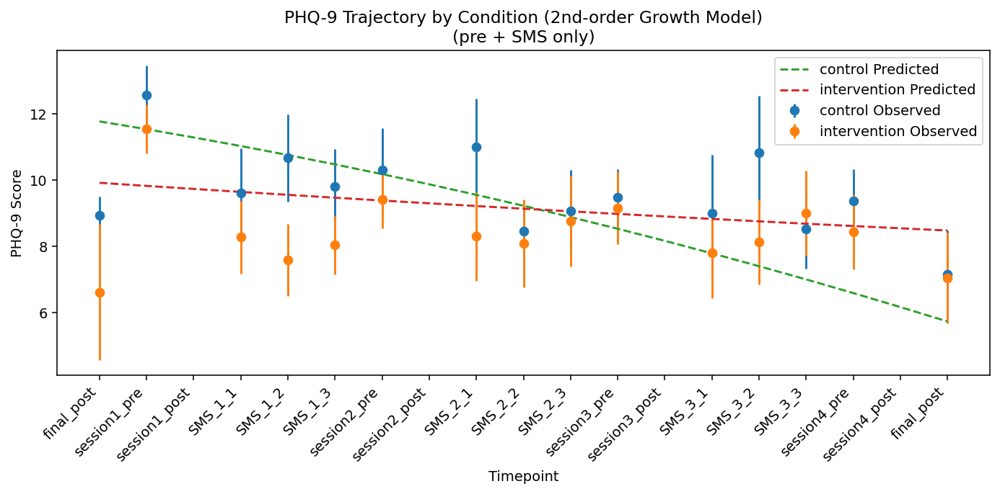

In [20]:
import re
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pathlib import Path
import statsmodels.formula.api as smf

#####
# 0) SETTINGS
#####
DATA_DIR = Path('/content')

#####
# 1) UTILITIES TO LOAD CSVs
#####
def find_csv(substring: str) -> Path:
    matches = list(DATA_DIR.glob(f'*{substring}*.csv'))
    if not matches:
        raise FileNotFoundError(f"No file matching '{substring}'")
    if len(matches) > 1:
        raise ValueError(f"Multiple files match '{substring}': {matches}")
    return matches[0]

def try_load(substring: str) -> pd.DataFrame | None:
    try:
        path = find_csv(substring)
    except (FileNotFoundError, ValueError):
        return None
    return pd.read_csv(path, dtype=str)

#####
# 2) LOAD ALL WELLBEING CSVS (skipping any that aren’t there yet)
#####
df_s1_pre     = try_load('pre_session_1')
df_s2to4_pre  = try_load('pre_sessions_2-4')
df_s2to4_post = try_load('post_sessions_1-3')
df_s4_post    = try_load('post_session_4')
df_sms        = try_load('sms_day1,3,5')

#  — new step: trim SMS part_ids —
if df_sms is not None:
    df_sms['part_id'] = (
        df_sms['part_id']
              .astype(str)
              .str.strip()
              .str[:5]
    )
    print("Trimmed df_sms.part_id to first 5 characters")

df_final      = try_load('sms_post')

# Collect only the ones that actually loaded
all_dfs = [df for df in (
    df_s1_pre,
    df_s2to4_pre,
    df_s2to4_post,
    df_s4_post,
    df_sms,
    df_final
) if df is not None]

if not all_dfs:
    raise RuntimeError("No data files found to process!")

#####
# 2) CLEAN & SUM SCALES (BDI, BAI, MADRS)
#####
def sum_scale(df, cols, out):
    df[cols] = df[cols].apply(pd.to_numeric, errors='coerce')
    df[out] = df[cols].sum(axis=1)

def get_scale_cols(df, prefix, count, allow_suffix=False):
    cols = []
    for i in range(1, count+1):
        main = f"{prefix}_{i}"
        alt  = f"{prefix}_{i}_1"
        if main in df.columns:
            cols.append(main)
        elif allow_suffix and alt in df.columns:
            cols.append(alt)
    return cols

for df in all_dfs:
    # extract numeric from BDI
    for col in [c for c in df.columns if re.fullmatch(r"bdi_\d+(?:_1)?", c)]:
        df[col] = df[col].astype(str).str.extract(r"^(\d+)")[0].astype(float)
    # BAI
    bai = get_scale_cols(df, 'bai', 21)
    if bai: sum_scale(df, bai, 'bai_sum')
    # BDI
    bdi = get_scale_cols(df, 'bdi', 21)
    if bdi: sum_scale(df, bdi, 'bdi_sum')
    # MADRS
    madrs = get_scale_cols(df, 'madrs', 9, allow_suffix=True)
    if madrs: sum_scale(df, madrs, 'MADRS_S_sum')

#####
# 3) STANDARDIZE M3VAS TO –50…+50
#####
def standardize_m3vas(df):
    for var in ('suicidal','mood','pleasure'):
        raw = next((c for c in df.columns if re.fullmatch(f"m3vas_{var}(?:_1)?", c)), None)
        ch  = next((c for c in df.columns if re.fullmatch(f"m3vas_ch_{var}(?:_1)?", c)),  None)
        if var == 'suicidal':
            if raw is not None:
                df['m3vas_suicidal'] = pd.to_numeric(df[raw], errors='coerce') - 50
            elif ch is not None:
                df['m3vas_suicidal'] = pd.to_numeric(df[ch],  errors='coerce') - 50
        else:
            if raw is not None:
                df[f"m3vas_{var}"] = 50 - pd.to_numeric(df[raw], errors='coerce')
            elif ch is not None:
                df[f"m3vas_{var}"] = pd.to_numeric(df[ch], errors='coerce') - 50
    # drop old raw / change columns
    drop_pattern = re.compile(
        r"^(?:m3vas_ch_(?:mood|pleasure|suicidal)(?:_1)?|m3vas_(?:mood|pleasure|suicidal)_1)$"
    )
    to_drop = [c for c in df.columns if drop_pattern.match(c)]
    df.drop(columns=to_drop, errors='ignore', inplace=True)

for df in all_dfs:
    standardize_m3vas(df)

#####
# 4) CLEAN FISBER & COERCE TYPES
#####
for df in all_dfs:
    for c in ('fisber_1','fisber_2','fisber_3'):
        if c in df.columns:
            df[c] = df[c].astype(str).str.extract(r"(\d+)$")[0].astype(float)
    # numeric scales
    for col in [
        'phq9_sum','spane_p','spane_n',
        'm3vas_suicidal','m3vas_mood','m3vas_pleasure',
        'fisber_1','fisber_2','fisber_3',
        'bai_sum','bdi_sum','MADRS_S_sum'
    ]:
        if col in df.columns:
            df[col] = pd.to_numeric(df[col], errors='coerce')

#####
# 5) ENSURE part_id & TAG TIMEPOINTS
#####
for df in all_dfs:
    if 'part_id' not in df.columns:
        if 'ProlificID' in df.columns:
            df.rename(columns={'ProlificID':'part_id'}, inplace=True)
        else:
            df['part_id'] = df.index.astype(str)
    df['part_id'] = df['part_id'].astype(str).str.strip()

if df_s1_pre is not None:
    df_s1_pre['timepoint'] = 'session1_pre'
if df_s2to4_pre is not None:
    df_s2to4_pre['timepoint'] = df_s2to4_pre.apply(
        lambda r: f"session{r.session_n}_pre", axis=1
    )
if df_s2to4_post is not None:
    df_s2to4_post['timepoint'] = df_s2to4_post.apply(
        lambda r: f"session{r.session_n}_post", axis=1
    )
if df_s4_post is not None:
    df_s4_post['timepoint'] = 'session4_post'
if df_sms is not None:
    df_sms['timepoint'] = df_sms.apply(
        lambda r: f"SMS_{r.session_n}_{r.sms_n}", axis=1
    )
if df_final is not None:
    df_final['timepoint'] = 'final_post'

# Concatenate
df_long = pd.concat(all_dfs, ignore_index=True)
df_long = df_long[df_long['part_id'].str.match(r'^\d+$', na=False)]

# Merge condition assignments if available
df_assign = try_load('wp2_assignments')
if df_assign is not None:
    df_long = df_long.merge(df_assign[['part_id','condition']],
                            on='part_id', how='inner')

#####
# 6) ORDER TIMEPOINTS & CREATE TIME VARIABLES
#####
ordered_timepoints = [
    'session1_pre','session1_post',
    'SMS_1_1','SMS_1_2','SMS_1_3',
    'session2_pre','session2_post',
    'SMS_2_1','SMS_2_2','SMS_2_3',
    'session3_pre','session3_post',
    'SMS_3_1','SMS_3_2','SMS_3_3',
    'session4_pre','session4_post',
    'final_post'
]
df_long['timepoint'] = pd.Categorical(
    df_long['timepoint'], categories=ordered_timepoints, ordered=True
)
df_long['time_num']  = df_long['timepoint'].cat.codes
df_long['time_num2'] = df_long['time_num']**2

# — after df_long['time_num2'] = df_long['time_num']**2 —

# 7a) EXCLUDE ALL sessionN_post TIMEPOINTS FOR THE PHQ-9 MODEL
mask_post = df_long['timepoint'].astype(str).str.match(r'^session\d+_post$')
df_model = df_long[~mask_post].copy()

#####
# 7b) FIT 2ND-ORDER MIXED-EFFECTS GROWTH MODEL FOR PHQ-9 (pre + SMS only)
#####
# — right after creating df_model —
# drop any rows missing the outcome or any of the predictors
df_model = df_model.dropna(
    subset=[
        'phq9_sum',    # outcome
        'time_num',
        'time_num2',   # quadratic term
        'condition'
    ]
)

# optionally ensure condition is treated as categorical
df_model['condition'] = df_model['condition'].astype('category')

# now fit
model = smf.mixedlm(
    "phq9_sum ~ time_num * condition + time_num2 * condition",
    data=df_model,
    groups="part_id",
    re_formula="~time_num"
)
res = model.fit(method='lbfgs')
print(res.summary())


#####
# 8) PLOT OBSERVED MEANS ± SEM AND MODEL PREDICTIONS (pre + SMS only)
#####
# Observed summary on df_model
obs = (
    df_model
    .groupby(['condition','time_num'])['phq9_sum']
    .agg(['mean','sem'])
    .reset_index()
)

# Prediction grid stays the same
time_vals = np.arange(df_model['time_num'].min(),
                      df_model['time_num'].max()+1)
conds     = df_model['condition'].dropna().unique()
pred = pd.DataFrame([
    {'time_num': t, 'time_num2': t**2, 'condition': c}
    for c in conds for t in time_vals
])
pred['predicted'] = res.predict(pred)

# Plot
plt.figure(figsize=(10,5))
for cond, grp in obs.groupby('condition'):
    plt.errorbar(grp['time_num'], grp['mean'], yerr=grp['sem'],
                 fmt='o', label=f"{cond} Observed")
for cond in conds:
    sub = pred[pred['condition']==cond]
    plt.plot(sub['time_num'], sub['predicted'], '--',
             label=f"{cond} Predicted")

# Only label the timepoints actually in df_model
labels = [ordered_timepoints[i] for i in time_vals]
plt.xticks(time_vals, labels, rotation=45, ha='right')

plt.xlabel("Timepoint")
plt.ylabel("PHQ-9 Score")
plt.title("PHQ-9 Trajectory by Condition (2nd-order Growth Model)\n(pre + SMS only)")
plt.legend()
plt.tight_layout()
plt.show()

                 Mixed Linear Model Regression Results
Model:                 MixedLM      Dependent Variable:      phq9_sum  
No. Observations:      561          Method:                  REML      
No. Groups:            52           Scale:                   7.9248    
Min. group size:       1            Log-Likelihood:          -1459.3190
Max. group size:       15           Converged:               Yes       
Mean group size:       10.8                                            
-----------------------------------------------------------------------
                             Coef.  Std.Err.   z    P>|z| [0.025 0.975]
-----------------------------------------------------------------------
Intercept                     9.849    0.960 10.261 0.000  7.968 11.730
condition[T.intervention]    -0.982    1.249 -0.787 0.431 -3.430  1.465
tc                           -0.159    0.036 -4.449 0.000 -0.230 -0.089
tc:condition[T.intervention]  0.031    0.047  0.666 0.505 -0.061  0.124
part_id V

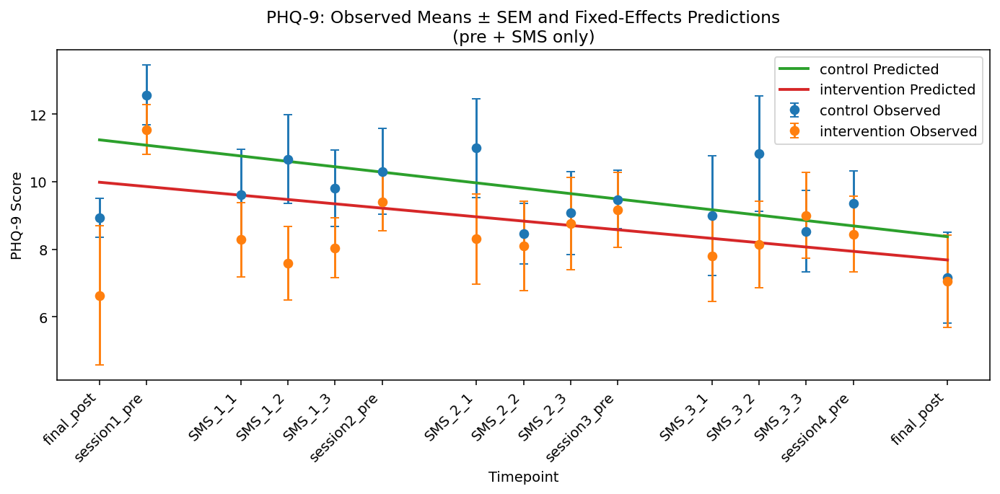

In [21]:
# 6) ORDER TIMEPOINTS & CREATE TIME VARIABLES
df_long['timepoint'] = pd.Categorical(
    df_long['timepoint'],
    categories=ordered_timepoints,
    ordered=True
)
df_long['time_num'] = df_long['timepoint'].cat.codes

# center time
df_long['tc'] = df_long['time_num'] - df_long['time_num'].mean()

# 7) EXCLUDE sessionN_post FOR THE PHQ-9 LINEAR MODEL
# (so you only model pre + SMS assessments)
mask_post = df_long['timepoint'].astype(str).str.match(r'^session\d+_post$')
df_model = df_long[~mask_post].copy()

import statsmodels.formula.api as smf

# Random‐intercepts‐only linear growth with centered time
# — right before you call smf.mixedlm —

# 1) drop any remaining rows missing your outcome / predictors
df_model = df_model.dropna(
    subset=[
        'phq9_sum',  # outcome
        'tc',        # centered time
        'condition'  # grouping / interaction
    ]
)

# 2) reset to a fresh 0..N-1 index so that row_indices line up
df_model = df_model.reset_index(drop=True)

# now fit your random-intercepts model
model0 = smf.mixedlm(
    "phq9_sum ~ tc * condition",
    data=df_model,
    groups="part_id",
    re_formula="~1"
)
res0 = model0.fit(method='lbfgs')
print(res0.summary())

import matplotlib.pyplot as plt

# 1) Observed means + SEM by condition & time_num (on df_model)
obs = (
    df_model
    .groupby(['condition','time_num'])['phq9_sum']
    .agg(['mean','sem'])
    .reset_index()
)

# 2) Fixed‐effects predictions from the random‐intercepts model
fe = res0.fe_params
mean_time = df_model['time_num'].mean()
preds = []
conds = df_model['condition'].dropna().unique()
time_vals = sorted(df_model['time_num'].unique())

for cond in conds:
    is_int = int(cond == 'intervention')
    for t in time_vals:
        tc = t - mean_time
        pred = (
            fe['Intercept']
            + fe.get('condition[T.intervention]', 0) * is_int
            + fe['tc'] * tc
            + fe.get('tc:condition[T.intervention]', 0) * tc * is_int
        )
        preds.append({'condition': cond, 'time_num': t, 'predicted': pred})

pred_df = pd.DataFrame(preds)

# 3) Plot
plt.figure(figsize=(10,5))
for cond, grp in obs.groupby('condition'):
    plt.errorbar(
        grp['time_num'], grp['mean'], yerr=grp['sem'],
        fmt='o', capsize=3, label=f"{cond} Observed"
    )
for cond in conds:
    sub = pred_df[pred_df['condition']==cond]
    plt.plot(
        sub['time_num'], sub['predicted'], '-',
        lw=2, label=f"{cond} Predicted"
    )

# xticks: only the timepoints in df_model
labels = [ordered_timepoints[i] for i in time_vals]
plt.xticks(time_vals, labels, rotation=45, ha='right')

plt.xlabel("Timepoint")
plt.ylabel("PHQ-9 Score")
plt.title("PHQ-9: Observed Means ± SEM and Fixed-Effects Predictions\n(pre + SMS only)")
plt.legend()
plt.tight_layout()
plt.show()

In [ ]:
model_lin = smf.mixedlm(
    "phq9_sum ~ tc * condition",
    data=df_model,
    groups="part_id",
    re_formula="~1"   # random intercept only
)
res_lin = model_lin.fit(method='lbfgs', reml=False)
print(res_lin.summary())

                 Mixed Linear Model Regression Results
Model:                 MixedLM      Dependent Variable:      phq9_sum  
No. Observations:      534          Method:                  ML        
No. Groups:            46           Scale:                   7.8890    
Min. group size:       1            Log-Likelihood:          -1383.9350
Max. group size:       15           Converged:               Yes       
Mean group size:       11.6                                            
-----------------------------------------------------------------------
                             Coef.  Std.Err.   z    P>|z| [0.025 0.975]
-----------------------------------------------------------------------
Intercept                     9.891    0.979 10.107 0.000  7.973 11.809
condition[T.intervention]    -1.355    1.298 -1.043 0.297 -3.899  1.190
tc                           -0.158    0.036 -4.400 0.000 -0.228 -0.088
tc:condition[T.intervention]  0.008    0.048  0.173 0.863 -0.085  0.102
part_id V

Model Comparisons (Simple Linear Model 2 wins -- see BIC/AIC below for model degradation via adding quadratic term)

In [22]:
import numpy as np
import pandas as pd
import statsmodels.formula.api as smf

# 1) Prepare time variables
ordered_timepoints = [
    'session1_pre','session1_post',
    'SMS_1_1','SMS_1_2','SMS_1_3',
    'session2_pre','session2_post',
    'SMS_2_1','SMS_2_2','SMS_2_3',
    'session3_pre','session3_post',
    'SMS_3_1','SMS_3_2','SMS_3_3',
    'session4_pre','session4_post',
    'final_post'
]

df_long['timepoint'] = pd.Categorical(
    df_long['timepoint'],
    categories=ordered_timepoints,
    ordered=True
)
df_long['time_num']  = df_long['timepoint'].cat.codes
df_long['time_num2'] = df_long['time_num']**2

# center time for models 2 & 3
df_long['tc'] = df_long['time_num'] - df_long['time_num'].mean()

# 2) Subset to “pre + SMS” only
mask_post = df_long['timepoint'].astype(str).str.match(r'^session\d+_post$')
df_model = (
    df_long[~mask_post]
    .dropna(subset=['phq9_sum','time_num','condition','tc'])  # remove any incomplete rows
    .reset_index(drop=True)
)
df_model['condition'] = df_model['condition'].astype('category')

# 3) Model 1: Quadratic growth with random intercepts & slopes (REML)
model1 = smf.mixedlm(
    "phq9_sum ~ time_num * condition + time_num2 * condition",
    data=df_model,
    groups="part_id",
    re_formula="~time_num"
)
res1 = model1.fit(method='lbfgs')  # default reml=True
print("\n=== Model 1: Quadratic + random slopes (REML) ===")
print(res1.summary())

# 4) Model 2: Linear growth with random intercept only (REML)
model2 = smf.mixedlm(
    "phq9_sum ~ tc * condition",
    data=df_model,
    groups="part_id",
    re_formula="~1"
)
res2 = model2.fit(method='lbfgs')  # default reml=True
print("\n=== Model 2: Linear + random intercept (REML) ===")
print(res2.summary())

# 5) Model 3: Linear growth with random intercept only (ML)
model3 = smf.mixedlm(
    "phq9_sum ~ tc * condition",
    data=df_model,
    groups="part_id",
    re_formula="~1"
)
res3 = model3.fit(method='lbfgs', reml=False)
print("\n=== Model 3: Linear + random intercept (ML) ===")
print(res3.summary())

# 6) Compare AICs (lower = better fit under ML/REML)
print(f"\nAICs:")
print(f"  Model 1 (quadratic, REML):   {res1.aic:.1f}")
print(f"  Model 2 (linear, REML):      {res2.aic:.1f}")
print(f"  Model 3 (linear, ML):        {res3.aic:.1f}")

/usr/local/lib/python3.12/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)



=== Model 1: Quadratic + random slopes (REML) ===
                    Mixed Linear Model Regression Results
Model:                    MixedLM        Dependent Variable:        phq9_sum  
No. Observations:         561            Method:                    REML      
No. Groups:               52             Scale:                     5.9598    
Min. group size:          1              Log-Likelihood:            -1509.6691
Max. group size:          15             Converged:                 Yes       
Mean group size:          10.8                                                
------------------------------------------------------------------------------
                                    Coef.  Std.Err.   z    P>|z| [0.025 0.975]
------------------------------------------------------------------------------
Intercept                           11.536    1.371  8.412 0.000  8.848 14.224
condition[T.intervention]           -1.709    1.778 -0.961 0.337 -5.194  1.776
time_num              

In [23]:
# ML‐based quadratic model
res_quad_ml = smf.mixedlm(
    "phq9_sum ~ time_num * condition + time_num2 * condition",
    data=df_model,
    groups="part_id",
    re_formula="~time_num"
).fit(method='lbfgs', reml=False)

# ML‐based linear model
res_lin_ml = smf.mixedlm(
    "phq9_sum ~ tc * condition",
    data=df_model,
    groups="part_id",
    re_formula="~1"
).fit(method='lbfgs', reml=False)

# Now you can pull out AIC & BIC
print("Quadratic (ML) AIC:", res_quad_ml.aic, "BIC:", res_quad_ml.bic)
print("Linear    (ML) AIC:", res_lin_ml.aic,   "BIC:", res_lin_ml.bic)

Quadratic (ML) AIC: 2901.153275832143 BIC: 2944.4504848873703
Linear    (ML) AIC: 2923.787999973207 BIC: 2949.766325406343


In [24]:
# --- Re-fit both models under ML (reml=False) and give them the names res_lin_ml / res_quad_ml ---

# linear model (ML):
res_lin_ml = smf.mixedlm(
    "phq9_sum ~ tc * condition",
    data=df_model,
    groups="part_id",
    re_formula="~1"
).fit(method='lbfgs', reml=False)

# quadratic model (ML):
res_quad_ml = smf.mixedlm(
    "phq9_sum ~ time_num * condition + time_num2 * condition",
    data=df_model,
    groups="part_id",
    re_formula="~time_num"
).fit(method='lbfgs', reml=False)

# now you can pull out log-likelihoods:
from scipy.stats import chi2

llf_lin  = res_lin_ml.llf
llf_quad = res_quad_ml.llf

# LRT statistic:
lr_stat = 2 * (llf_quad - llf_lin)

# df difference = # of extra fixed-effect parameters in quadratic:
df_diff = res_quad_ml.k_fe - res_lin_ml.k_fe

p_val = chi2.sf(lr_stat, df_diff)

print("Likelihood‐ratio test:")
print(f"  χ² = {lr_stat:.2f}")
print(f"  df = {df_diff}")
print(f"  p  = {p_val:.3f}")

# and for completeness, print AIC/BIC
print(f"\nAIC (linear):    {res_lin_ml.aic:.2f}")
print(f"AIC (quadratic): {res_quad_ml.aic:.2f}")
print(f"BIC (linear):    {res_lin_ml.bic:.2f}")
print(f"BIC (quadratic): {res_quad_ml.bic:.2f}")


Likelihood‐ratio test:
  χ² = 30.63
  df = 2
  p  = 0.000

AIC (linear):    2923.79
AIC (quadratic): 2901.15
BIC (linear):    2949.77
BIC (quadratic): 2944.45


In [25]:
import pandas as pd
import statsmodels.formula.api as smf
from scipy.stats import chi2

# 1) define your four models
model_specs = {
    'quad_REML': dict(
        formula    = "phq9_sum ~ time_num * condition + time_num2 * condition",
        re_formula = "~time_num",
        reml       = True
    ),
    'lin_REML': dict(
        formula    = "phq9_sum ~ tc * condition",
        re_formula = "~1",
        reml       = True
    ),
    'quad_ML': dict(
        formula    = "phq9_sum ~ time_num * condition + time_num2 * condition",
        re_formula = "~time_num",
        reml       = False
    ),
    'lin_ML': dict(
        formula    = "phq9_sum ~ tc * condition",
        re_formula = "~1",
        reml       = False
    ),
}

# 2) fit them all and store results
results = {}
for name, spec in model_specs.items():
    print(f"\n\n=== Fitting {name} (REML={spec['reml']}) ===")
    mod = smf.mixedlm(
        spec['formula'],
        data=df_model,
        groups="part_id",
        re_formula=spec['re_formula']
    )
    res = mod.fit(method='lbfgs', reml=spec['reml'])
    results[name] = res
    print(res.summary())

# 3) build a comparison table using the original spec to flag REML vs ML
cmp = pd.DataFrame({
    name: {
        'REML?':    spec['reml'],
        'LogLik':   results[name].llf,
        'AIC':      results[name].aic,
        'BIC':      results[name].bic,
        'n_params': len(results[name].params)
    }
    for name, spec in model_specs.items()
}).T

print("\n\n=== Model comparison ===")
print(cmp.sort_values(['REML?', 'AIC']))

# 4) ML‐based LRT: quad_ML vs lin_ML
llf_q = results['quad_ML'].llf
llf_l = results['lin_ML'].llf
lr_stat = 2 * (llf_q - llf_l)
df_diff = results['quad_ML'].k_fe - results['lin_ML'].k_fe
p_val   = chi2.sf(lr_stat, df_diff)

print(f"\nLRT (quad vs lin, ML): χ²({df_diff}) = {lr_stat:.2f}, p = {p_val:.3f}")



=== Fitting quad_REML (REML=True) ===


/usr/local/lib/python3.12/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


                    Mixed Linear Model Regression Results
Model:                    MixedLM        Dependent Variable:        phq9_sum  
No. Observations:         561            Method:                    REML      
No. Groups:               52             Scale:                     5.9598    
Min. group size:          1              Log-Likelihood:            -1509.6691
Max. group size:          15             Converged:                 Yes       
Mean group size:          10.8                                                
------------------------------------------------------------------------------
                                    Coef.  Std.Err.   z    P>|z| [0.025 0.975]
------------------------------------------------------------------------------
Intercept                           11.536    1.371  8.412 0.000  8.848 14.224
condition[T.intervention]           -1.709    1.778 -0.961 0.337 -5.194  1.776
time_num                            -0.242    0.281 -0.862 0.389 -0.792  

In [ ]:
# assume res_quad_ml is your ML‐fit of the quadratic model
from scipy import stats

# Wald test via statsmodels
hyp = "time_num:condition[T.intervention]=0, time_num2:condition[T.intervention]=0"
print(res_quad_ml.wald_test(hyp))

<Wald test (chi2): statistic=[[0.90563664]], p-value=0.6358336426585703, df_denom=2>


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:1912: FutureWarning: The behavior of wald_test will change after 0.14 to returning scalar test statistic values. To get the future behavior now, set scalar to True. To silence this message while retaining the legacy behavior, set scalar to False.
  warnings.warn(


In [ ]:
# “no interaction” nested model
mod_noint = smf.mixedlm(
    "phq9_sum ~ time_num + time_num2 + condition",
    data=df_model,
    groups="part_id",
    re_formula="~time_num"
).fit(method='lbfgs', reml=False)

# likelihood‐ratio test
llf_full  = res_quad_ml.llf
llf_noint = mod_noint.llf
lr_stat   = 2*(llf_full - llf_noint)
df_diff   = res_quad_ml.k_fe - mod_noint.k_fe
p_val     = stats.chi2.sf(lr_stat, df_diff)
print(f"Joint LRT for all cond×poly terms: χ²({df_diff})={lr_stat:.2f}, p={p_val:.3f}")

Joint LRT for all cond×poly terms: χ²(2)=-22.43, p=1.000


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2206: ConvergenceWarning: MixedLM optimization failed, trying a different optimizer may help.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2218: ConvergenceWarning: Gradient optimization failed, |grad| = 55.776305
  warnings.warn(msg, ConvergenceWarning)


In [26]:
import numpy as np

# pick a time—for example, t = max(time_num)
t0 = df_model['time_num'].max()

# linear coefficient
b1 = res_quad_ml.params['time_num:condition[T.intervention]']
# quad coefficient
b2 = res_quad_ml.params['time_num2:condition[T.intervention]']

# derivative difference
d = b1 + 2*t0*b2
print(f"Slope diff at t={t0}: {d:.3f}")
# …then get its SE via res_quad_ml.cov_params() and compute a z‐test…

Slope diff at t=17: 0.267


In [27]:
# ML‐fit partial polynomial model
res_partial = smf.mixedlm(
    "phq9_sum ~ time_num*condition + time_num2",
    data=df_model,
    groups="part_id",
    re_formula="~time_num"
).fit(method='lbfgs', reml=False)

print(res_partial.summary())

                    Mixed Linear Model Regression Results
Model:                   MixedLM        Dependent Variable:        phq9_sum  
No. Observations:        561            Method:                    ML        
No. Groups:              52             Scale:                     6.8445    
Min. group size:         1              Log-Likelihood:            -1441.6032
Max. group size:         15             Converged:                 Yes       
Mean group size:         10.8                                                
-----------------------------------------------------------------------------
                                   Coef.  Std.Err.   z    P>|z| [0.025 0.975]
-----------------------------------------------------------------------------
Intercept                          11.283    0.964 11.708 0.000  9.394 13.172
condition[T.intervention]          -1.401    1.251 -1.121 0.262 -3.853  1.050
time_num                           -0.169    0.057 -2.979 0.003 -0.280 -0.058
time_n

In [28]:
import pandas as pd
import statsmodels.formula.api as smf
from scipy.stats import chi2

# ─── Fit three ML models ────────────────────────────────────────────────────
# 1) Linear only
mod_lin = smf.mixedlm(
    "phq9_sum ~ time_num * condition",
    data=df_model,
    groups="part_id",
    re_formula="~1"
)
res_lin = mod_lin.fit(method='lbfgs', reml=False)

# 2) Partial quadratic (common curvature, slope×cond only)
mod_part = smf.mixedlm(
    "phq9_sum ~ time_num * condition + time_num2",
    data=df_model,
    groups="part_id",
    re_formula="~time_num"
)
res_part = mod_part.fit(method='lbfgs', reml=False)

# 3) Full quadratic (both linear & quadratic × condition)
mod_full = smf.mixedlm(
    "phq9_sum ~ time_num * condition + time_num2 * condition",
    data=df_model,
    groups="part_id",
    re_formula="~time_num"
)
res_full = mod_full.fit(method='lbfgs', reml=False)

# ─── Summaries ───────────────────────────────────────────────────────────────
print("\n=== Linear ML ==="); print(res_lin.summary())
print("\n=== Partial-quadratic ML ==="); print(res_part.summary())
print("\n=== Full-quadratic ML ==="); print(res_full.summary())

# ─── Comparison table ────────────────────────────────────────────────────────
cmp = pd.DataFrame({
    'linear':       {'llf': res_lin.llf,  'AIC': res_lin.aic,  'BIC': res_lin.bic},
    'partial_quad': {'llf': res_part.llf, 'AIC': res_part.aic, 'BIC': res_part.bic},
    'full_quad':    {'llf': res_full.llf, 'AIC': res_full.aic, 'BIC': res_full.bic},
}).T
print("\n=== model comparison ===")
print(cmp)

# ─── LRT for slope×condition within the partial-quadratic model ─────────────
#    (i.e. compare partial-quad vs same model without time:cond term)
mod_noint = smf.mixedlm(
    "phq9_sum ~ time_num + time_num2 + condition",
    data=df_model,
    groups="part_id",
    re_formula="~time_num"
).fit(method='lbfgs', reml=False)

lr = 2*(res_part.llf - mod_noint.llf)
df_diff = res_part.k_fe - mod_noint.k_fe
pval = chi2.sf(lr, df_diff)

print(f"\nSlope×condition LRT (partial): χ²({df_diff}) = {lr:.2f}, p = {pval:.3f}")


=== Linear ML ===
                    Mixed Linear Model Regression Results
Model:                   MixedLM        Dependent Variable:        phq9_sum  
No. Observations:        561            Method:                    ML        
No. Groups:              52             Scale:                     7.8936    
Min. group size:         1              Log-Likelihood:            -1455.8940
Max. group size:         15             Converged:                 Yes       
Mean group size:         10.8                                                
-----------------------------------------------------------------------------
                                   Coef.  Std.Err.   z    P>|z| [0.025 0.975]
-----------------------------------------------------------------------------
Intercept                          11.102    0.975 11.390 0.000  9.191 13.012
condition[T.intervention]          -1.232    1.269 -0.971 0.331 -3.718  1.254
time_num                           -0.159    0.036 -4.457 0.000 -

In [29]:
# from your partial-quadratic fit `res_part`
coef = res_part.params['time_num:condition[T.intervention]']
se   = res_part.bse['time_num:condition[T.intervention]']
ci_lower, ci_upper = coef - 1.96*se, coef + 1.96*se
print(f"Slope diff = {coef:.3f}, 95% CI = [{ci_lower:.3f}, {ci_upper:.3f}]")

Slope diff = 0.044, 95% CI = [-0.102, 0.190]


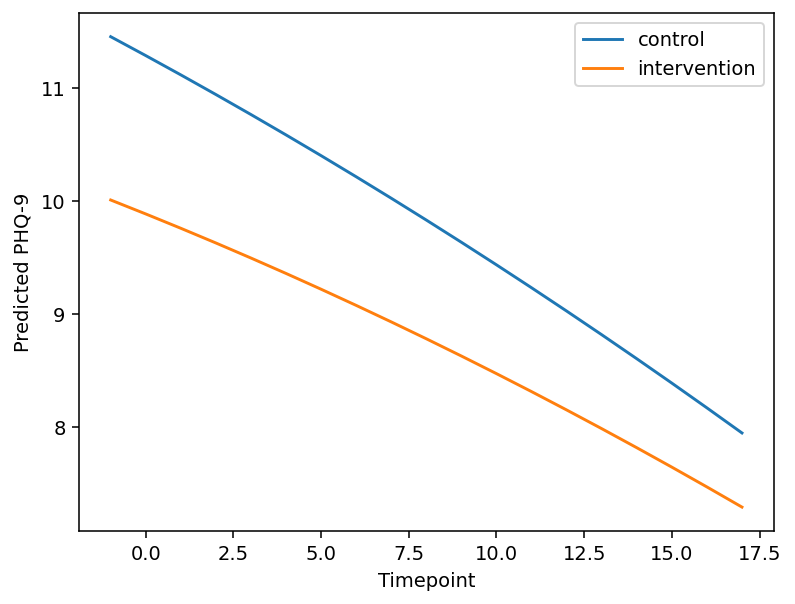

In [30]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# 1) Build prediction DataFrame
grid = np.arange(df_model['time_num'].min(), df_model['time_num'].max()+1)
pred = pd.DataFrame({
    'time_num':    np.tile(grid, 2),
    'time_num2':   np.tile(grid**2, 2),
    'condition':   ['control']*len(grid) + ['intervention']*len(grid),
    'part_id':     df_model['part_id'].iloc[0],  # dummy
})
pred['phq9'] = res_part.predict(pred)

# 2) Plot
plt.figure()
for grp, sub in pred.groupby('condition'):
    plt.plot(sub['time_num'], sub['phq9'], label=grp)
plt.xlabel('Timepoint')
plt.ylabel('Predicted PHQ-9')
plt.legend()
plt.show()

In [ ]:
import numpy as np
import pandas as pd
import statsmodels.formula.api as smf
from tqdm import trange

def fit_slope_diff(df):
    # fit the partial-quadratic ML model
    res = smf.mixedlm(
        "phq9_sum ~ time_num * condition + time_num2",
        data=df,
        groups="part_id",
        re_formula="~time_num"
    ).fit(method='lbfgs', reml=False)
    return res.params['time_num:condition[T.intervention]']

n_boot = 2000
boot_est = np.zeros(n_boot)
part_ids = df_model['part_id'].unique()

for i in trange(n_boot):
    # resample participants with replacement
    samp_ids = np.random.choice(part_ids, size=len(part_ids), replace=True)
    df_boot = pd.concat([df_model[df_model.part_id==pid] for pid in samp_ids], ignore_index=True)
    boot_est[i] = fit_slope_diff(df_boot)

# bootstrap percentile 95% CI
ci_lower, ci_upper = np.percentile(boot_est, [2.5, 97.5])
print(f"Bootstrap slope×cond diff 95% CI: [{ci_lower:.3f}, {ci_upper:.3f}]")

# density or histogram
import matplotlib.pyplot as plt
plt.hist(boot_est, bins=30, density=True)
plt.axvline(ci_lower, color='k', linestyle='--')
plt.axvline(ci_upper, color='k', linestyle='--')
plt.xlabel("Slope Diff"); plt.title("Bootstrap Distribution")
plt.show()

In [ ]:
# install Bayesian stuff

# the “%” magic ensures it installs into the current kernel
%pip install pymc3 arviz

# install the missing Debian packages
!apt-get update -qq
!apt-get install -y -qq python3-distutils libopenblas-dev liblapack-dev
# then install PyMC3/Aesara via pip
%pip install pymc3 arviz

In [ ]:
import numpy as np
import pandas as pd
import pymc as pm
import arviz as az

# --- prepare your data arrays ---
y        = df_model['phq9_sum'].values
time     = df_model['time_num'].values
time2    = df_model['time_num2'].values
cond     = (df_model['condition']=='intervention').astype(int).values
pid, pid_idx = np.unique(df_model['part_id'], return_inverse=True)
n_pat    = len(pid)

with pm.Model() as partial_quad:

    # Hyperpriors for random effects (independent)
    σ_a = pm.HalfNormal('σ_a', sigma=5)         # intercept SD
    σ_b = pm.HalfNormal('σ_b', sigma=1)         # slope SD

    # Subject-level effects
    a = pm.Normal('a', mu=0, sigma=σ_a, shape=n_pat)    # random intercept
    b = pm.Normal('b', mu=0, sigma=σ_b, shape=n_pat)    # random linear slope

    # Fixed effects
    intercept  = pm.Normal('Intercept',     mu=10, sigma=5)
    b_time     = pm.Normal('b_time',        mu=-0.1, sigma=0.1)
    b_time2    = pm.Normal('b_time2',       mu= 0.0, sigma=0.05)
    b_cond     = pm.Normal('b_cond',        mu= 0.0, sigma=5)
    b_time_c   = pm.Normal('b_time:cond',   mu= 0.0, sigma=0.1)
    # no quadratic×cond in partial-quadratic:
    b_time2_c  = pm.ConstantData('b_time2:cond', 0.0)

    # Linear predictor
    μ = (
        intercept
        + a[pid_idx]
        + (b_time + b[pid_idx])*time
        + b_time2*time2
        + b_cond*cond
        + b_time_c*time*cond
        + b_time2_c*time2*cond
    )

    # Residual SD
    σ_y = pm.HalfNormal('σ_y', sigma=5)

    # Likelihood
    y_obs = pm.Normal('y_obs', mu=μ, sigma=σ_y, observed=y)

    # Sample
    trace = pm.sample(2000, tune=2000, target_accept=0.9)

# --- Summarize slope×condition posterior ---
az.plot_posterior(trace, var_names=['b_time:cond'], hdi_prob=0.95)
print(az.summary(trace, var_names=['b_time:cond']))
print("P(b_time:cond < 0) =",
      np.mean(trace.posterior['b_time:cond'].values < 0))

In [ ]:
from scipy.stats import gaussian_kde
import numpy as np

post = trace.posterior['b_time:cond'].values.flatten()
# P(effect < –0.05)
print("P(b_time:cond < –0.05) =", np.mean(post < -0.05))
# P(effect within ±0.05)
print("P(|b_time:cond| < 0.05) =", np.mean(np.abs(post) < 0.05))

kde = gaussian_kde(post)
posterior_density_at_zero = kde(0)[0]
# prior for b_time:cond was Normal(0,0.1), so its density at zero is:
prior_density_at_zero = 1/(0.1 * np.sqrt(2*np.pi))
BF10 = prior_density_at_zero / posterior_density_at_zero
print("BF₁₀ (neg effect vs. null) ≈", BF10)

In [ ]:
import numpy as np
import pandas as pd
import pymc as pm
import arviz as az
import matplotlib.pyplot as plt

# ── 0) PREPARE YOUR DATA ────────────────────────────────────────────────
# (Assumes you already have df_model from the frequentist pipeline.)
y        = df_model['phq9_sum'].values
time     = df_model['time_num'].values
cond     = (df_model['condition'] == 'intervention').astype(int).values
pid_ids, pid_idx = np.unique(df_model['part_id'], return_inverse=True)
n_pat    = len(pid_ids)

# ── 1) BUILD & SAMPLE THE BAYESIAN LINEAR GROWTH MODEL ─────────────────
with pm.Model() as linear_growth:

    # Hyperprior for subject‐level intercept SD
    σ_a = pm.HalfNormal('σ_a', sigma=5)

    # Random intercepts for each participant
    a = pm.Normal('a', mu=0, sigma=σ_a, shape=n_pat)

    # Fixed effects
    intercept  = pm.Normal('Intercept', mu=10, sigma=5)
    b_time     = pm.Normal('b_time',      mu=-0.1,  sigma=0.1)
    b_cond     = pm.Normal('b_cond',      mu= 0.0,  sigma=5)
    b_time_c   = pm.Normal('b_time:cond', mu= 0.0,  sigma=0.1)

    # Residual error
    σ_y = pm.HalfNormal('σ_y', sigma=5)

    # Linear predictor
    μ = (
        intercept
        + a[pid_idx]
        + b_time * time
        + b_cond * cond
        + b_time_c * time * cond
    )

    # Likelihood
    y_obs = pm.Normal('y_obs', mu=μ, sigma=σ_y, observed=y)

    # Sample from the posterior
    trace = pm.sample(2000, tune=2000, target_accept=0.9, return_inferencedata=True)

# ── 2) POSTERIOR SUMMARY & PLOT INTERACTION ────────────────────────────
# Posterior summary for the time×condition effect:
print(az.summary(trace, var_names=['b_time:cond'], hdi_prob=0.95))

# Plot its full posterior density:
az.plot_posterior(trace, var_names=['b_time:cond'], hdi_prob=0.95,
                  ref_val=0, textsize=12)
plt.title("Posterior of time × condition interaction")
plt.show()

# ── 3) PLOT PREDICTED TRAJECTORIES WITH 95% CREDIBLE BANDS ────────────
# 3a) Construct a grid of times and both conditions
time_grid = np.unique(time)
cond_grid = [0, 1]
preds = []

# Extract posterior samples into arrays
post = trace.posterior
n_samps = post.sizes['chain'] * post.sizes['draw']

# Flatten chains & draws
b0_samps   = post['Intercept'].stack(samp=('chain','draw')).values
b_time_samps = post['b_time'].stack(samp=('chain','draw')).values
b_cond_samps = post['b_cond'].stack(samp=('chain','draw')).values
b_tc_samps   = post['b_time:cond'].stack(samp=('chain','draw')).values

for t in time_grid:
    for c in cond_grid:
        # compute μ for each posterior sample
        mu_samps = (
            b0_samps
            + b_time_samps * t
            + b_cond_samps * c
            + b_tc_samps * (t * c)
        )
        # summarize
        median = np.median(mu_samps)
        hdi    = az.hdi(mu_samps, hdi_prob=0.95)
        preds.append({'time_num': t,
                      'cond': 'intervention' if c==1 else 'control',
                      'median': median,
                      'hdi_lower': hdi[0],
                      'hdi_upper': hdi[1]})

pred_df = pd.DataFrame(preds)

# 3b) observed means + SEM
obs = (
    df_model
    .groupby(['condition','time_num'])['phq9_sum']
    .agg(['mean','sem'])
    .reset_index()
)

# 3c) plot
plt.figure(figsize=(10,6))

# observed
for cond, grp in obs.groupby('condition'):
    plt.errorbar(grp['time_num'], grp['mean'], yerr=grp['sem'],
                 fmt='o', capsize=3, label=f"{cond.capitalize()} Observed")

# predicted with credible bands
for cond in ['control','intervention']:
    sub = pred_df[pred_df['cond']==cond]
    x = sub['time_num']
    plt.plot(x, sub['median'], '-', lw=2, label=f"{cond.capitalize()} Predicted")
    plt.fill_between(x, sub['hdi_lower'], sub['hdi_upper'], alpha=0.2)

# xticks labels
labels = [ordered_timepoints[i] for i in time_grid]
plt.xticks(time_grid, labels, rotation=45, ha='right')

plt.xlabel("Timepoint")
plt.ylabel("PHQ-9 Score")
plt.title("Bayesian Linear Growth Model\nPHQ‑9 Trajectory by Condition (pre + SMS only)")
plt.legend()
plt.tight_layout()
plt.show()

Future P(< 0)           = 0.202
Future P(< –0.05)       = 0.0124
Future P(|effect|<0.05) = 0.6821


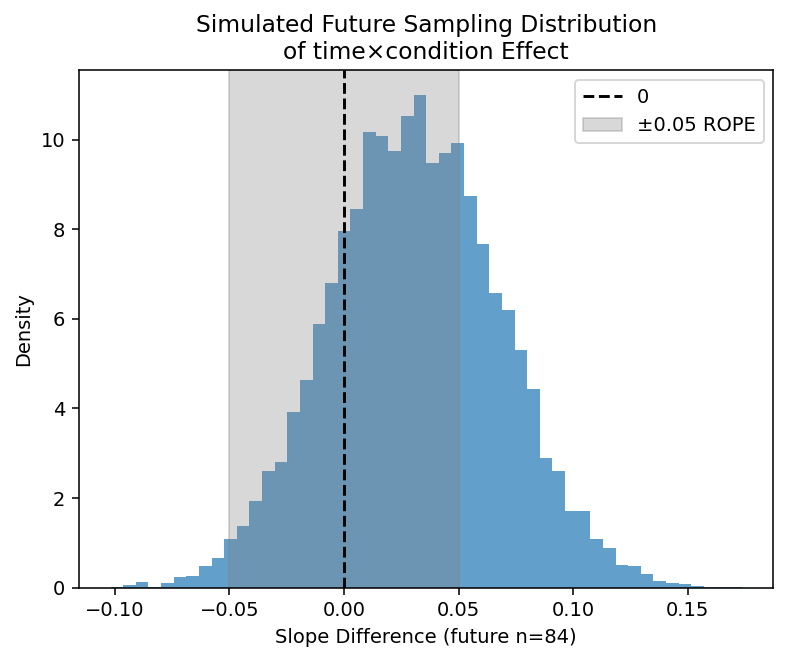

In [31]:
import numpy as np
import matplotlib.pyplot as plt

# 1) Pull out the estimate and its SE from your fitted model (res0)
beta_hat = res0.params['tc:condition[T.intervention]']
se_hat   = res0.bse['tc:condition[T.intervention]']

# current effective sample size: number of subjects
n_current = df_model['part_id'].nunique()

# choose the future N you care about
n_future = 84

# 2) Scale the SE to the future N
#    Var(β̂) ∝ 1/N, so SE_future = SE_current * sqrt(N_current/N_future)
sd_future = se_hat * np.sqrt(n_current / n_future)

# 3) simulate 10 000 “future” estimates
sim = np.random.normal(loc=beta_hat, scale=sd_future, size=10_000)

# 4) compute the quantities you care about
print("Future P(< 0)           =", np.mean(sim < 0))
print("Future P(< –0.05)       =", np.mean(sim < -0.05))
print("Future P(|effect|<0.05) =", np.mean(np.abs(sim) < 0.05))

# 5) visualize
plt.hist(sim, bins=50, density=True, alpha=0.7)
plt.axvline(0, color='k', linestyle='--', label="0")
plt.axvspan(-0.05, +0.05, color='gray', alpha=0.3, label="±0.05 ROPE")
plt.legend()
plt.xlabel("Slope Difference (future n=84)")
plt.ylabel("Density")
plt.title("Simulated Future Sampling Distribution\nof time×condition Effect")
plt.show()

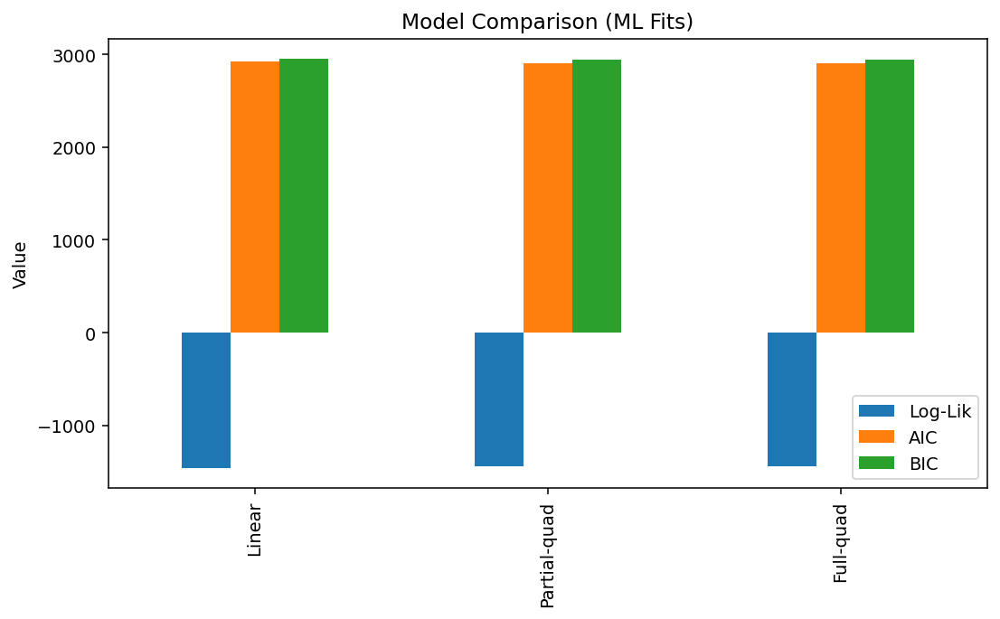

In [32]:
import pandas as pd
import matplotlib.pyplot as plt

# 1. Collect the metrics
model_names = ['Linear', 'Partial-quad', 'Full-quad']
llf  = [res_lin.llf,  res_part.llf,  res_full.llf]
aic  = [res_lin.aic,  res_part.aic,  res_full.aic]
bic  = [res_lin.bic,  res_part.bic,  res_full.bic]

df_metrics = pd.DataFrame({
    'Log-Lik': llf,
    'AIC':     aic,
    'BIC':     bic
}, index=model_names)

# 2. Plot grouped bar chart
ax = df_metrics.plot(kind='bar', figsize=(8,5))
ax.set_ylabel('Value')
ax.set_title('Model Comparison (ML Fits)')
ax.legend(loc='best')
plt.tight_layout()
plt.show()

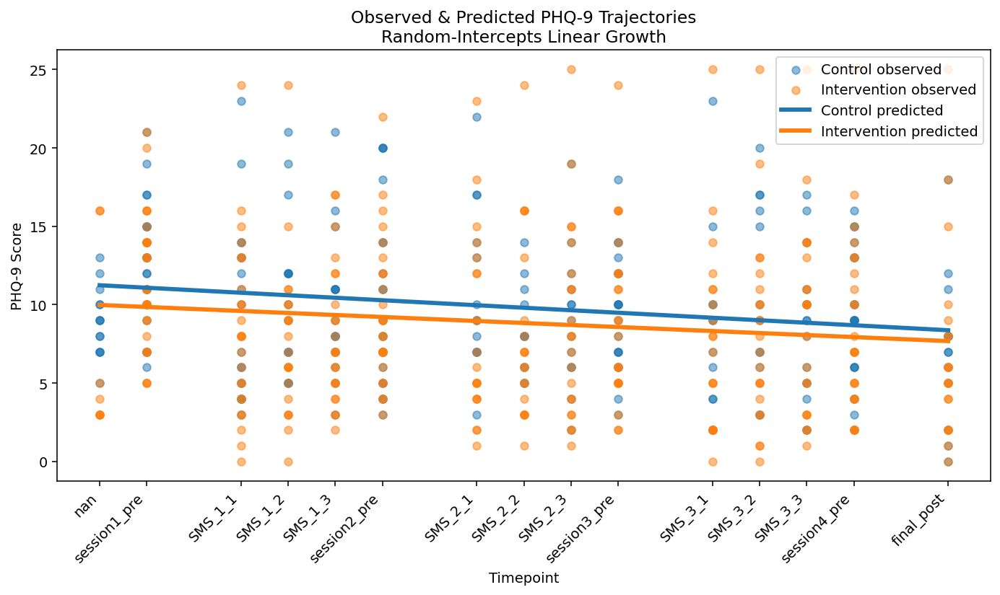

In [33]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# ── ASSUMPTION: you’ve already fit your linear mixedlm and named the result `res0`,
# and you have your analysis DataFrame `df_model` with columns ['time_num','phq9_sum','condition','part_id'].

# 1) Use only the time_nums actually in your analysis set
time_vals = sorted(df_model['time_num'].unique())

# 2) Build the prediction grid from those
pred_df = pd.DataFrame({
    'time_num':  np.tile(time_vals, 2),
    'condition': ['control']*len(time_vals) + ['intervention']*len(time_vals),
    'part_id':   df_model['part_id'].iloc[0]
})
# recompute tc
pred_df['tc'] = pred_df['time_num'] - df_model['time_num'].mean()
pred_df['phq9_pred'] = res0.predict(pred_df)

# 3) Plot
fig, ax = plt.subplots(figsize=(10,6))
colors = {'control':'tab:blue','intervention':'tab:orange'}

# (a) Observed scatter
for cond, grp in df_model.groupby('condition', observed=True):
    ax.scatter(grp['time_num'], grp['phq9_sum'],
               color=colors[cond], alpha=0.5, s=30,
               label=f"{cond.capitalize()} observed")

# (b) Fitted lines
for cond in ['control','intervention']:
    sub = pred_df[pred_df['condition']==cond]
    ax.plot(sub['time_num'], sub['phq9_pred'],
            color=colors[cond], lw=3,
            label=f"{cond.capitalize()} predicted")

# (c) X‐ticks from the *actual* time_vals and their labels
label_map = (
    df_model[['time_num','timepoint']]
    .drop_duplicates()
    .set_index('time_num')['timepoint']
    .to_dict()
)
ax.set_xticks(time_vals)
ax.set_xticklabels([label_map[t] for t in time_vals],
                   rotation=45, ha='right')

ax.set_xlabel("Timepoint")
ax.set_ylabel("PHQ‑9 Score")
ax.set_title("Observed & Predicted PHQ‑9 Trajectories\nRandom‑Intercepts Linear Growth")
ax.legend()
plt.tight_layout()
plt.show()

/tmp/ipython-input-2855758623.py:25: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  for cond, df_sub in df_model.groupby('condition'):


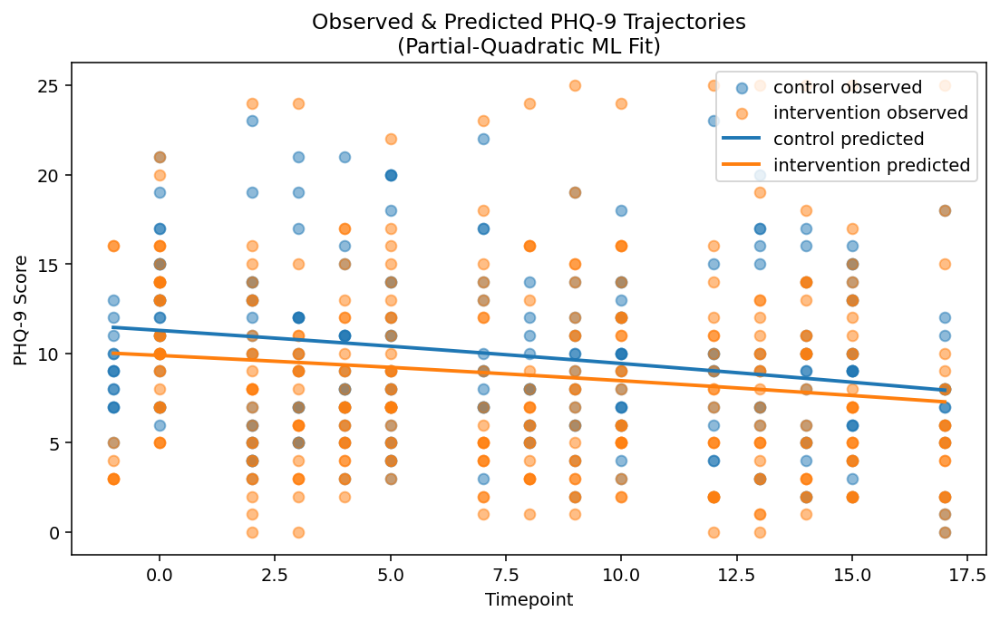

In [34]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

# 1. Build a prediction grid
time_grid = np.arange(df_model['time_num'].min(),
                      df_model['time_num'].max()+1)

pred_df = pd.DataFrame({
    'time_num':  np.tile(time_grid, 2),
    'time_num2': np.tile(time_grid**2, 2),
    'condition': ['control']*len(time_grid) + ['intervention']*len(time_grid),
    # part_id just needs to be present; we use the first ID as a placeholder
    'part_id':   df_model['part_id'].iloc[0]
})

# 2. Generate predictions
pred_df['phq9_pred'] = res_part.predict(pred_df)

# 3. Plot
fig, ax = plt.subplots(figsize=(8,5))
colors = {'control':'tab:blue', 'intervention':'tab:orange'}

# scatter raw observations
for cond, df_sub in df_model.groupby('condition'):
    ax.scatter(df_sub['time_num'], df_sub['phq9_sum'],
               color=colors[cond], alpha=0.5, label=f'{cond} observed')

# plot fitted curves
for cond in ['control','intervention']:
    df_sub = pred_df[pred_df['condition']==cond]
    ax.plot(df_sub['time_num'], df_sub['phq9_pred'],
            color=colors[cond], lw=2, label=f'{cond} predicted')

ax.set_xlabel('Timepoint')
ax.set_ylabel('PHQ-9 Score')
ax.set_title('Observed & Predicted PHQ-9 Trajectories\n(Partial-Quadratic ML Fit)')
ax.legend()
plt.tight_layout()
plt.show()

FINAL MODEL TWO (Linear REML)

In [35]:
import statsmodels.formula.api as smf

# (Re)fit the final linear REML model
final_model = smf.mixedlm(
    "phq9_sum ~ tc * condition",
    data=df_model,
    groups="part_id",
    re_formula="~1"
).fit(method='lbfgs')  # default reml=True

print(final_model.summary())

                 Mixed Linear Model Regression Results
Model:                 MixedLM      Dependent Variable:      phq9_sum  
No. Observations:      561          Method:                  REML      
No. Groups:            52           Scale:                   7.9248    
Min. group size:       1            Log-Likelihood:          -1459.3190
Max. group size:       15           Converged:               Yes       
Mean group size:       10.8                                            
-----------------------------------------------------------------------
                             Coef.  Std.Err.   z    P>|z| [0.025 0.975]
-----------------------------------------------------------------------
Intercept                     9.849    0.960 10.261 0.000  7.968 11.730
condition[T.intervention]    -0.982    1.249 -0.787 0.431 -3.430  1.465
tc                           -0.159    0.036 -4.449 0.000 -0.230 -0.089
tc:condition[T.intervention]  0.031    0.047  0.666 0.505 -0.061  0.124
part_id V

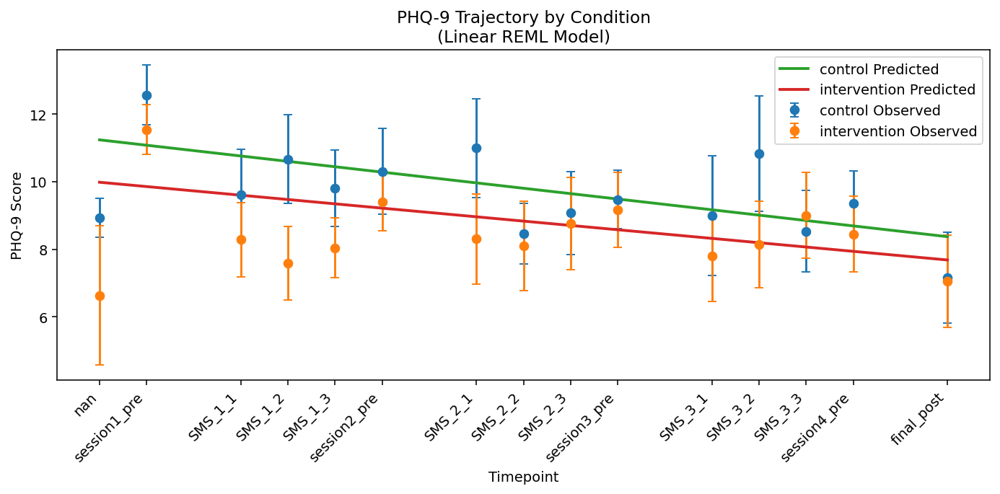

In [36]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# 1) Observed means ± SEM, silencing the warning
obs = (
    df_model
    .groupby(['condition','time_num'], observed=True)['phq9_sum']
    .agg(['mean','sem'])
    .reset_index()
)

# 2) Build fixed-effects predictions
fe        = final_model.fe_params
time_vals = sorted(df_model['time_num'].unique())
mean_t    = df_model['time_num'].mean()
conds     = df_model['condition'].cat.categories

preds = []
for cond in conds:
    is_int = int(cond == 'intervention')
    for t in time_vals:
        tc   = t - mean_t
        pred = (
            fe['Intercept']
            + fe.get(f'condition[T.{cond}]', 0) * is_int
            + fe['tc'] * tc
            + fe.get('tc:condition[T.intervention]', 0) * tc * is_int
        )
        preds.append({'condition': cond, 'time_num': t, 'predicted': pred})

pred_df = pd.DataFrame(preds)

# 3) Dynamically map time_num → label
label_map = (
    df_model[['time_num','timepoint']]
    .drop_duplicates()
    .set_index('time_num')['timepoint']
    .to_dict()
)
labels = [label_map[t] for t in time_vals]

# 4) Plot observed ± SEM and model fits
plt.figure(figsize=(10,5))

# Observed
for cond, grp in obs.groupby('condition', observed=True):
    plt.errorbar(
        grp['time_num'], grp['mean'], yerr=grp['sem'],
        fmt='o', capsize=3, label=f"{cond} Observed"
    )

# Predicted
for cond in conds:
    sub = pred_df[pred_df['condition']==cond]
    plt.plot(
        sub['time_num'], sub['predicted'], '-',
        lw=2, label=f"{cond} Predicted"
    )

plt.xticks(time_vals, labels, rotation=45, ha='right')
plt.xlabel("Timepoint")
plt.ylabel("PHQ-9 Score")
plt.title("PHQ-9 Trajectory by Condition\n(Linear REML Model)")
plt.legend()
plt.tight_layout()
plt.show()

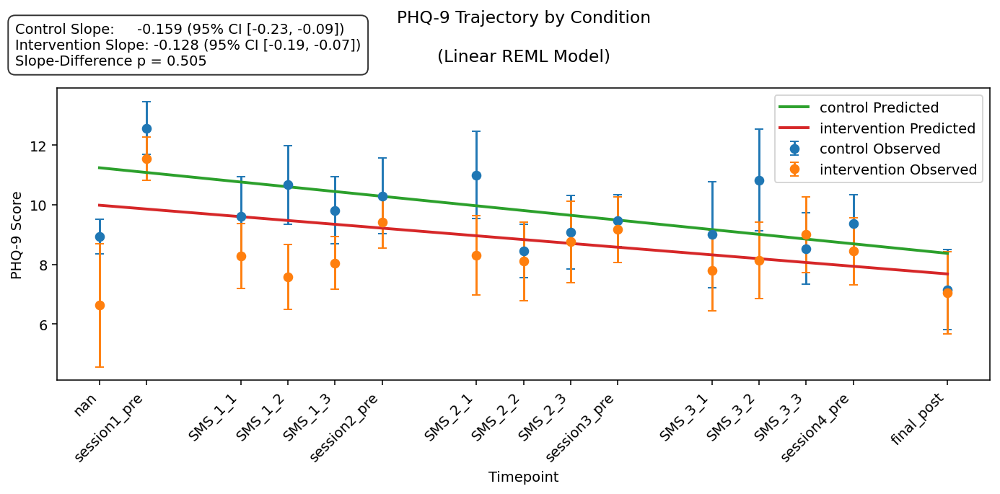

In [37]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import norm

# ─── 1) EXTRACT FIXED‐EFFECTS & COVARIANCE ─────────────────────────────
params = final_model.fe_params
vcov   = final_model.cov_params()

# control slope & SE
s_ctrl = params['tc']
se_ctrl = np.sqrt(vcov.loc['tc','tc'])

# intervention slope & SE (s_ctrl + delta)
delta = params['tc:condition[T.intervention]']
var_delta = vcov.loc['tc:condition[T.intervention]','tc:condition[T.intervention]']
covar = vcov.loc['tc','tc:condition[T.intervention]']
se_int = np.sqrt(se_ctrl**2 + var_delta + 2*covar)
s_int = s_ctrl + delta

# 95% CIs
z = norm.ppf(0.975)
ci_ctrl = (s_ctrl - z*se_ctrl, s_ctrl + z*se_ctrl)
ci_int  = (s_int  - z*se_int,  s_int  + z*se_int)

# p‐value for slope difference = p of the interaction
p_diff = final_model.pvalues['tc:condition[T.intervention]']

# ─── 2) COMPUTE PREDICTED OBS + FIT ────────────────────────────────────
# (this is your plotting data from before)
# obs  = ...   # dataframe with ['condition','time_num','mean','sem']
# pred_df = ... # dataframe with ['condition','time_num','predicted']
time_vals = sorted(df_model['time_num'].unique())

# ─── 3) COMPUTE TIMEPOINT‐WISE SIGNIFICANCE OF GAP ────────────────────
# for each t, gap = pred_int - pred_ctrl; its se via delta‐method
# pre‐compute var(beta_cond), var(delta), cov(beta_cond,delta)
vc_b  = vcov.loc['condition[T.intervention]','condition[T.intervention]']
cov_b_d = vcov.loc['condition[T.intervention]','tc:condition[T.intervention]']

gaps, ses, sig = [], [], []
for t in time_vals:
    tc = t - df_model['time_num'].mean()
    # gap = condition main effect + tc×condition effect
    gap = params['condition[T.intervention]'] + delta * tc
    var_gap = vc_b + (tc**2)*var_delta + 2*tc*cov_b_d
    se_gap = np.sqrt(var_gap)
    gaps.append(gap); ses.append(se_gap)
    sig.append(abs(gap) > z*se_gap)

# ─── 4) PLOTTING ───────────────────────────────────────────────────────
plt.figure(figsize=(10,5))

# observed
for cond, grp in obs.groupby('condition', observed=True):
    plt.errorbar(grp['time_num'], grp['mean'], yerr=grp['sem'],
                 fmt='o', capsize=3, label=f"{cond} Observed")

# predicted
for cond in pred_df['condition'].unique():
    sub = pred_df[pred_df['condition']==cond]
    plt.plot(sub['time_num'], sub['predicted'], '-', lw=2,
             label=f"{cond} Predicted")

# annotate significant gaps
ymax = max(pred_df['predicted']) + 0.5
for t, is_sig in zip(time_vals, sig):
    if is_sig:
        plt.text(t, ymax, '*', ha='center', va='bottom', fontsize=14)

# add slope‐text box
txt = (
    f"Control Slope:     {s_ctrl:.3f} "
    f"(95% CI [{ci_ctrl[0]:.2f}, {ci_ctrl[1]:.2f}])\n"
    f"Intervention Slope: {s_int:.3f} "
    f"(95% CI [{ci_int[0]:.2f}, {ci_int[1]:.2f}])\n"
    f"Slope‐Difference p = {p_diff:.3f}"
)
plt.gcf().text(0.02, 0.86, txt, fontsize=10,
               bbox=dict(boxstyle="round,pad=0.5", facecolor="white", alpha=0.8))

# finalize axes
label_map = (
    df_model[['time_num','timepoint']]
    .drop_duplicates()
    .set_index('time_num')['timepoint']
    .to_dict()
)
plt.xticks(time_vals, [label_map[t] for t in time_vals],
           rotation=45, ha='right')
plt.xlabel("Timepoint")
plt.ylabel("PHQ-9 Score")
plt.title("PHQ-9 Trajectory by Condition\n\n(Linear REML Model)\n")
plt.legend(loc='upper right')
plt.tight_layout()
plt.show()

LINEAR BAYESIAN | BOOTSTRAPPING

In [ ]:
# ─── DROP‑IN SCRIPT: BOOTSTRAP + BAYESIAN ANALYSIS ────────────────────

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde
import statsmodels.formula.api as smf
import pymc as pm
import arviz as az
import types

# 1) REBUILD & RESET df_model
# ----------------------------
# Assumes you already have `df_model` defined.
df_model = df_model.reset_index(drop=True).copy()
df_model['pid_code'] = pd.Categorical(df_model['part_id']).codes
df_model['tc'] = df_model['time_num'] - df_model['time_num'].mean()

# Patch arviz.stats so pymc import won’t break
if not hasattr(az, 'stats'):
    az.stats = types.ModuleType("arviz.stats")
    az.stats.__all__ = []

# 2) FREQUENTIST LME (REML)
# -------------------------
res0 = smf.mixedlm(
    "phq9_sum ~ tc * condition",
    data=df_model,
    groups=df_model['pid_code'],
    re_formula="~1"
).fit(method="lbfgs", reml=True)

beta_hat = res0.params["tc:condition[T.intervention]"]
se_hat   = res0.bse["tc:condition[T.intervention]"]
print(f"Freq LME slope diff: {beta_hat:.4f} ± {se_hat:.4f}")

# 3) CLUSTER‑BOOTSTRAP OF SLOPE DIFFERENCE
# ----------------------------------------
def cluster_bootstrap_slopes(data, formula, n_boot=2000):
    slopes = np.empty(n_boot)
    codes  = data['pid_code'].unique()
    for i in range(n_boot):
        draw = np.random.choice(codes, size=len(codes), replace=True)
        boot = pd.concat([data[data.pid_code==c] for c in draw], ignore_index=True)
        m = smf.mixedlm(formula, boot, groups=boot['pid_code'], re_formula="~1")\
              .fit(method="lbfgs", reml=True)
        slopes[i] = m.params["tc:condition[T.intervention]"]
    return slopes

boot_slopes = cluster_bootstrap_slopes(df_model, "phq9_sum ~ tc * condition", n_boot=2000)
ci_low, ci_high = np.percentile(boot_slopes, [2.5, 97.5])
print(f"Bootstrap 95% CI: [{ci_low:.3f}, {ci_high:.3f}]")
print(f"Bootstrap P(slope<0): {np.mean(boot_slopes < 0):.3f}")

plt.figure(figsize=(6,4))
plt.hist(boot_slopes, bins=30, density=True, alpha=0.7)
plt.axvline(0, color='k', linestyle='--', label="0")
plt.axvspan(ci_low, ci_high, color='gray', alpha=0.3, label="95% CI")
plt.xlabel("Time×Condition slope difference")
plt.ylabel("Density")
plt.title("Cluster‑bootstrap distribution")
plt.legend()
plt.tight_layout()
plt.show()

# 4) BAYESIAN LINEAR GROWTH MODEL
# --------------------------------
# Prepare arrays
y_vals  = df_model['phq9_sum'].values
t_vals  = df_model['tc'].values            # centered time
c_vals  = (df_model['condition']=="intervention").astype(int).values
pid_ids, pid_idx = np.unique(df_model['part_id'], return_inverse=True)
n_pat   = len(pid_ids)

with pm.Model() as bayes_mod:
    σ_a = pm.HalfNormal("σ_a", sigma=5)
    a   = pm.Normal("a", mu=0, sigma=σ_a, shape=n_pat)

    intercept   = pm.Normal("Intercept",  mu=10, sigma=5)
    b_time      = pm.Normal("b_time",     mu=-0.1, sigma=0.1)
    b_cond      = pm.Normal("b_cond",     mu=0.0,  sigma=5)
    b_time_cond = pm.Normal("b_time:cond",mu=0.0,  sigma=0.1)

    σ_y = pm.HalfNormal("σ_y", sigma=5)

    μ = (
        intercept
        + a[pid_idx]
        + b_time * t_vals
        + b_cond * c_vals
        + b_time_cond * t_vals * c_vals
    )

    pm.Normal("y_obs", mu=μ, sigma=σ_y, observed=y_vals)

    trace = pm.sample(2000, tune=2000, target_accept=0.9, return_inferencedata=True)

# Posterior summary & plot
az.plot_posterior(trace, var_names=["b_time:cond"], hdi_prob=0.95, ref_val=0)
plt.title("Posterior of time×condition interaction")
plt.show()

print(az.summary(trace, var_names=["b_time:cond"], hdi_prob=0.95))

# Savage–Dickey Bayes factor
post = trace.posterior["b_time:cond"].values.flatten()
kde  = gaussian_kde(post)
post_d0  = kde(0)[0]
prior_d0 = 1/(0.1 * np.sqrt(2*np.pi))
BF10 = prior_d0 / post_d0
print(f"Bayes Factor (effect vs. null) ≈ {BF10:.2f}")

# 5) PREDICTED TRAJECTORIES
# --------------------------
time_nums = np.sort(df_model["time_num"].unique())
t_mean    = df_model["time_num"].mean()

# Extract posterior draws
post_stack = trace.posterior.stack(sample=("chain","draw"))
b0   = post_stack["Intercept"].values
bt   = post_stack["b_time"].values
bc   = post_stack["b_cond"].values
btc  = post_stack["b_time:cond"].values

preds = []
for tnum in time_nums:
    tc_val = tnum - t_mean
    for cond_name, c in [("control",0),("intervention",1)]:
        mu_samps = b0 + bt*tc_val + bc*c + btc*(tc_val*c)
        hdi = az.hdi(mu_samps, hdi_prob=0.95)
        preds.append({
            "time_num": tnum,
            "condition": cond_name,
            "median": np.median(mu_samps),
            "hdi_lower": hdi[0],
            "hdi_upper": hdi[1]
        })
pred_df = pd.DataFrame(preds)

obs = df_model.groupby(["condition","time_num"])["phq9_sum"]\
               .agg(["mean","sem"]).reset_index()

plt.figure(figsize=(10,5))
for cond, grp in obs.groupby("condition"):
    plt.errorbar(grp["time_num"], grp["mean"], yerr=grp["sem"],
                 fmt="o", capsize=3, label=f"{cond.capitalize()} Obs")
for cond in ["control","intervention"]:
    sub = pred_df[pred_df["condition"]==cond]
    plt.plot(sub["time_num"], sub["median"], lw=2, label=f"{cond.capitalize()} Bayes")
    plt.fill_between(sub["time_num"], sub["hdi_lower"], sub["hdi_upper"], alpha=0.2)
plt.xlabel("Timepoint")
plt.ylabel("PHQ-9 Score")
plt.title("Observed & Bayesian Predicted Trajectories")
plt.legend()
plt.tight_layout()
plt.show()

Loaded 'pre_session_1' from wp2_pre_session_1_October 17, 2025_09.03.csv
Loaded 'pre_sessions_2-4' from wp2_pre_sessions_2-4_October 17, 2025_09.42.csv
Loaded 'post_sessions_1-3' from wp2_post_sessions_1-3_October 17, 2025_09.42.csv
Loaded 'post_session_4' from wp2_post_session_4_October 17, 2025_09.43.csv
Loaded 'sms_day1,3,5' from wp2_sms_day1,3,5_October 17, 2025_09.42.csv
Trimmed df_sms.part_id to first 5 characters
Loaded 'sms_post' from wp2_sms_post_October 17, 2025_09.42.csv
Loaded 'wp2_assignments' from wp2_assignments.csv
→ skipping 'm3vas_mood_wellbeing': not in df_long
→ skipping 'm3vas_pleasure_wellbeing': not in df_long
→ skipping 'm3vas_suicidal_wellbeing': not in df_long


/tmp/ipython-input-2377877828.py:333: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  .groupby(['timepoint','condition'])[measure]


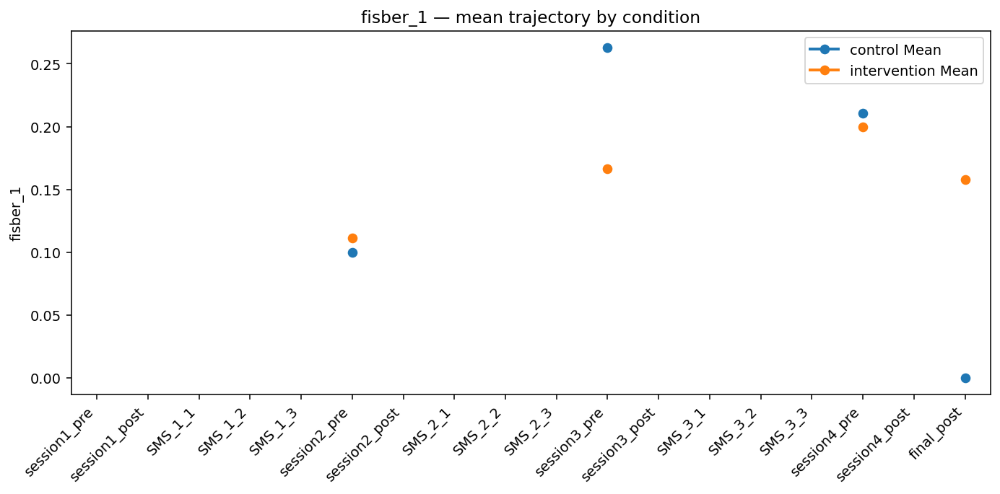

/tmp/ipython-input-2377877828.py:333: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  .groupby(['timepoint','condition'])[measure]


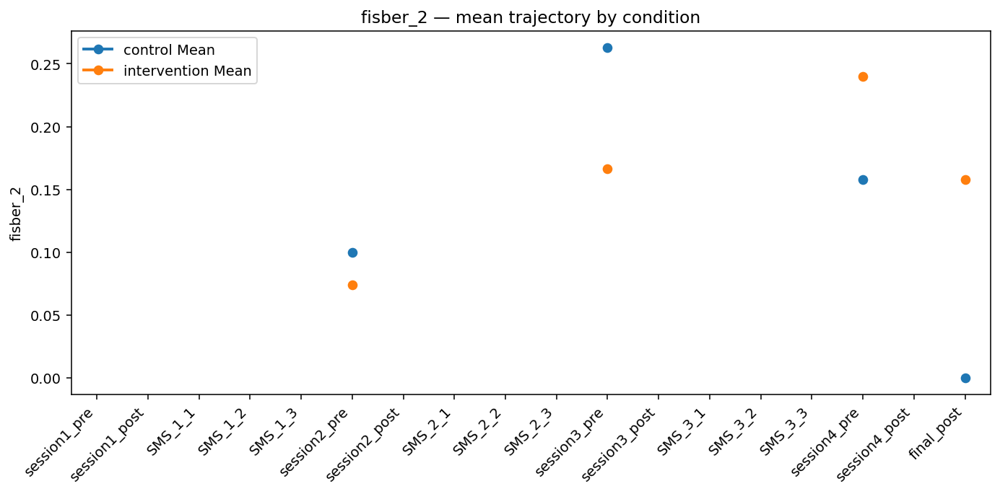

/tmp/ipython-input-2377877828.py:333: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  .groupby(['timepoint','condition'])[measure]


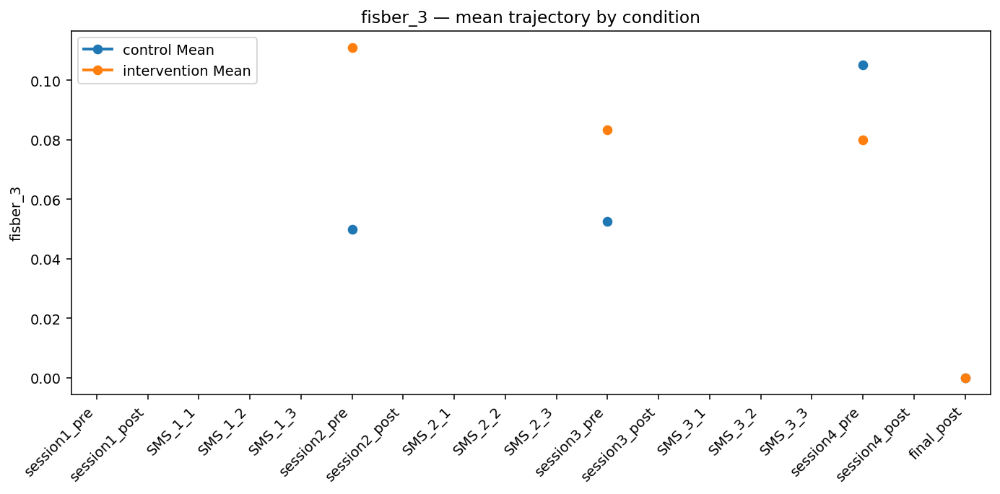

/tmp/ipython-input-2377877828.py:333: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  .groupby(['timepoint','condition'])[measure]


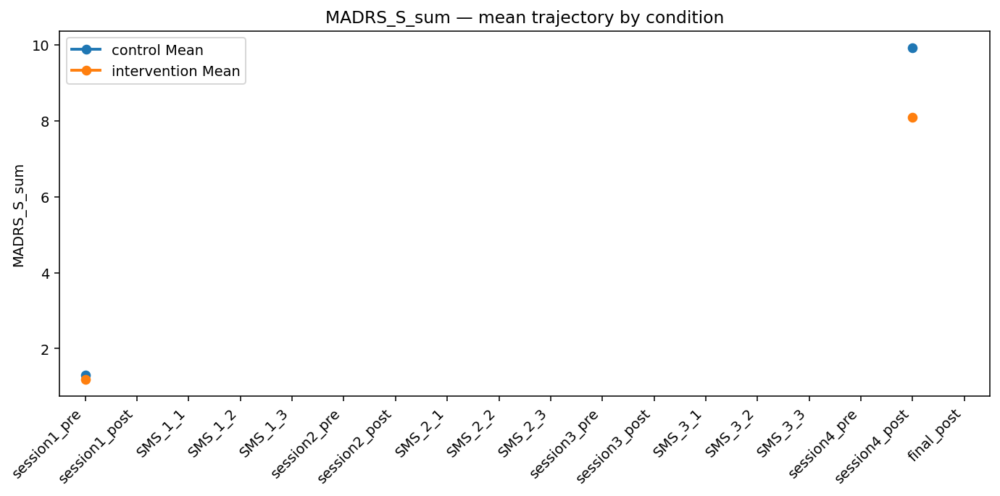

/tmp/ipython-input-2377877828.py:333: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  .groupby(['timepoint','condition'])[measure]


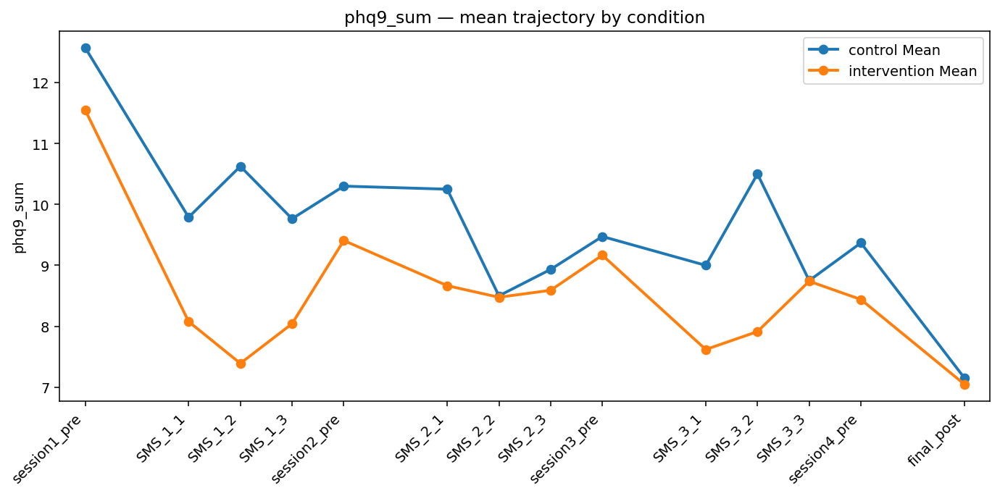

→ skipping 'spane_p_distress': not in df_long
→ skipping 'spane_n_distress': not in df_long


In [38]:
import re
import pandas as pd
import matplotlib.pyplot as plt
from pathlib import Path

#####
# 0) SETTINGS
#####
DATA_DIR = Path('/content')

#####
# 1) UTILITY TO FIND EXACTLY ONE CSV
#####
def find_csv(substring: str) -> Path:
    matches = list(DATA_DIR.glob(f'*{substring}*.csv'))
    if not matches:
        raise FileNotFoundError(f"No file matching '{substring}' in {DATA_DIR}")
    if len(matches) > 1:
        raise ValueError(f"Multiple files match '{substring}': {matches}")
    return matches[0]

#####
# 1b) TRY TO LOAD A CSV, BUT SKIP IF MISSING OR AMBIGUOUS
#####
def try_load(substring: str) -> pd.DataFrame | None:
    try:
        path = find_csv(substring)
    except (FileNotFoundError, ValueError) as e:
        print(f"Skipping '{substring}': {e}")
        return None
    print(f"Loaded '{substring}' from {path.name}")
    return pd.read_csv(path, dtype=str)

#####
# 2) LOAD ALL WELLBEING CSVS (skipping any that aren’t there yet)
#####
df_s1_pre     = try_load('pre_session_1')
df_s2to4_pre  = try_load('pre_sessions_2-4')
df_s2to4_post = try_load('post_sessions_1-3')
df_s4_post    = try_load('post_session_4')
df_sms        = try_load('sms_day1,3,5')

#  — new step: trim SMS part_ids —
if df_sms is not None:
    df_sms['part_id'] = (
        df_sms['part_id']
              .astype(str)
              .str.strip()
              .str[:5]
    )
    print("Trimmed df_sms.part_id to first 5 characters")

df_final      = try_load('sms_post')

# Collect only the ones that actually loaded
all_dfs = [df for df in (
    df_s1_pre,
    df_s2to4_pre,
    df_s2to4_post,
    df_s4_post,
    df_sms,
    df_final
) if df is not None]

if not all_dfs:
    raise RuntimeError("No data files found to process!")

#####
# 3) CLEAN BDI ITEMS (extract leading number)
#####
for df in all_dfs:
    bdi_raw = [c for c in df.columns if re.fullmatch(r"bdi_\d+(?:_1)?", c)]
    for col in bdi_raw:
        df[col] = (
            df[col].astype(str)
                  .str.extract(r'^(\d+)')[0]
                  .astype(float)
        )

#####
# 4) SUM SCALES
#####
def sum_scale(df, cols, new_col):
    df[cols] = df[cols].apply(pd.to_numeric, errors='coerce')
    df[new_col] = df[cols].sum(axis=1)

def get_scale_cols(df, prefix, count, allow_suffix=False):
    cols = []
    for i in range(1, count+1):
        main = f"{prefix}_{i}"
        alt  = f"{prefix}_{i}_1"
        if main in df.columns:
            cols.append(main)
        elif allow_suffix and alt in df.columns:
            cols.append(alt)
    return cols

for df in all_dfs:
    # BAI
    bai_cols = get_scale_cols(df, 'bai', 21)
    if bai_cols:
        sum_scale(df, bai_cols, 'bai_sum')
    # BDI
    bdi_cols = get_scale_cols(df, 'bdi', 21)
    if bdi_cols:
        sum_scale(df, bdi_cols, 'bdi_sum')
    # MADRS
    madrs_cols = get_scale_cols(df, 'madrs', 9, allow_suffix=True)
    if madrs_cols:
        sum_scale(df, madrs_cols, 'MADRS_S_sum')

#####
# 5) STANDARDIZE M3VAS
#####
def standardize_m3vas(df):
    to_drop = []
    for var in ('suicidal','mood','pleasure'):
        # find change‐score first, then raw‐score
        ch_col  = next((c for c in df.columns
                        if re.fullmatch(rf"m3vas_ch_{var}(?:_1)?", c)), None)
        raw_col = next((c for c in df.columns
                        if re.fullmatch(rf"m3vas_{var}(?:_1)?",    c)), None)

        if ch_col:
            vals = pd.to_numeric(df[ch_col], errors='coerce') - 50
            to_drop.append(ch_col)
        elif raw_col:
            vals = pd.to_numeric(df[raw_col], errors='coerce') - 50
            to_drop.append(raw_col)
        else:
            continue

        if var == 'suicidal':
            # leave as-is: + means more suicidal (worse), so improvement → down
            df[f"m3vas_{var}"] = vals
        else:
            # mood & pleasure: + means improvement, so flip sign
            df[f"m3vas_{var}"] = -vals

    # drop only the original raw/change columns
    df.drop(columns=to_drop, inplace=True, errors='ignore')

# apply to each dataframe
for df in all_dfs:
    standardize_m3vas(df)

#####
# 6) CLEAN FISBER
#####
for df in all_dfs:
    for col in ('fisber_1','fisber_2','fisber_3'):
        if col in df.columns:
            df[col] = (
                df[col].astype(str)
                       .str.extract(r'(\d+)$')[0]
                       .astype(float)
            )

#####
# 7) COERCE TYPES
#####
# session_n for sessions
for df in (df_s1_pre, df_s2to4_pre, df_s2to4_post, df_s4_post):
    if df is not None and 'session_n' in df.columns:
        df['session_n'] = pd.to_numeric(df['session_n'], errors='coerce').astype('Int64')

# session_n & sms_n for SMS
if df_sms is not None:
    for col in ('session_n','sms_n'):
        if col in df_sms.columns:
            df_sms[col] = pd.to_numeric(df_sms[col], errors='coerce').astype('Int64')

# numeric scales
numeric_cols = [
    'phq9_sum','spane_p','spane_n',
    'm3vas_mood','m3vas_pleasure','m3vas_suicidal',
    'fisber_1','fisber_2','fisber_3',
    'bai_sum','bdi_sum','MADRS_S_sum'
]
for df in all_dfs:
    for col in numeric_cols:
        if col in df.columns:
            df[col] = pd.to_numeric(df[col], errors='coerce')

#####
# 8) ENSURE EVERY DF HAS part_id
#####
for df in all_dfs:
    if 'part_id' not in df.columns:
        if 'ProlificID' in df.columns:
            df.rename(columns={'ProlificID':'part_id'}, inplace=True)
        else:
            df['part_id'] = df.index.astype(str)
    df['part_id'] = df['part_id'].astype(str).str.strip()

#####
# 9) TAG TIMEPOINTS
#####
if df_s1_pre    is not None: df_s1_pre    ['timepoint'] = 'session1_pre'
if df_s2to4_pre is not None: df_s2to4_pre ['timepoint'] = df_s2to4_pre.apply(lambda r: f"session{r.session_n}_pre",  axis=1)
if df_s2to4_post is not None: df_s2to4_post['timepoint'] = df_s2to4_post.apply(lambda r: f"session{r.session_n}_post", axis=1)
if df_s4_post   is not None: df_s4_post   ['timepoint'] = 'session4_post'
if df_sms       is not None: df_sms       ['timepoint'] = df_sms.apply(lambda r: f"SMS_{r.session_n}_{r.sms_n}", axis=1)
if df_final     is not None: df_final     ['timepoint'] = 'final_post'

#####
# 10) CONCATENATE
#####
df_long = pd.concat(all_dfs, ignore_index=True)

#####
# 11) DROP NON-NUMERIC part_id
#####
df_long = df_long[df_long['part_id'].str.match(r'^\d+$', na=False)]

#####
# 12) MERGE IN CONDITION (if assignments file was found)
#####
df_assign = try_load('wp2_assignments')
if df_assign is not None:
    df_long = df_long.merge(
        df_assign[['part_id','condition']],
        on='part_id',
        how='inner'
    )
else:
    print("No assignments file: skipping merge with 'condition' column")

#####
# 13) DEFINE & APPLY ORDERED CATEGORICAL FOR timepoint
#####
ordered_timepoints = [
    'session1_pre','session1_post',
    'SMS_1_1','SMS_1_2','SMS_1_3',
    'session2_pre','session2_post',
    'SMS_2_1','SMS_2_2','SMS_2_3',
    'session3_pre','session3_post',
    'SMS_3_1','SMS_3_2','SMS_3_3',
    'session4_pre','session4_post',
    'final_post'
]
df_long['timepoint'] = pd.Categorical(
    df_long['timepoint'],
    categories=ordered_timepoints,
    ordered=True
)

#####
# 14) PLOTTING + FLAGGING ACROSS ALL PARTICIPANTS (BLINDED)
#####
bad_if_higher = {
    'phq9_sum',
    'spane_n',
    'fisber_1','fisber_2','fisber_3',
    'bai_sum','bdi_sum','MADRS_S_sum',
    'm3vas_suicidal'   # higher = more suicidal = worse
}

bad_if_lower = {
    'spane_p',
    'm3vas_mood',      # higher = better mood, so a drop is worsening
    'm3vas_pleasure'   # higher = better pleasure, so a drop is worsening
}

mcid_thresholds = {
    'phq9_sum': 5,
    'spane_p': 2,
    'spane_n': 2,
    'm3vas_mood': 12,
    'm3vas_pleasure': 12,
    'm3vas_suicidal': 12
}

#####
# ADJUST M3VAS SO 50 → 0 (“no change”), 0 → –50 (worse), 100 → +50 (better)
#####
def standardize_m3vas(df):
    for var in ('suicidal','mood','pleasure'):
        # detect the two possible inputs
        raw_col = next((c for c in df.columns
                        if re.fullmatch(f"m3vas_{var}(?:_1)?", c)), None)
        ch_col  = next((c for c in df.columns
                        if re.fullmatch(f"m3vas_ch_{var}(?:_1)?", c)),  None)

        if raw_col is not None:
            # pre‐session raw VAS: 0 (best) → 100 (worst)
            vals = pd.to_numeric(df[raw_col], errors='coerce') - 50
        elif ch_col is not None:
            # post‐session change VAS: already –50 (better) → +50 (worse)
            vals = pd.to_numeric(df[ch_col], errors='coerce')
        else:
            continue

        # for mood & pleasure, invert so higher = more distress
        if var in ('mood','pleasure'):
            vals = -vals

        df[f"m3vas_{var}"] = vals

    # drop all the old raw / ch columns
    drop_re = re.compile(
        r"^(?:m3vas_ch_(?:mood|pleasure|suicidal)(?:_1)?"
        r"|m3vas_(?:mood|pleasure|suicidal)_1)$"
    )
    to_drop = [c for c in df.columns if drop_re.match(c)]
    df.drop(columns=to_drop, errors='ignore', inplace=True)

# Apply to each dataframe
for df in all_dfs:
    standardize_m3vas(df)

#####
# PLOTTING & FLAGGING FUNCTION
#####
def plot_mean_by_condition(measure):
    if measure not in df_long.columns:
        print(f"→ skipping '{measure}': not in df_long")
        return

    # 1) Filter out session*_post for PHQ-9 & SPANE
    df_plot = df_long.copy()
    if measure in ('phq9_sum','spane_p','spane_n'):
        mask = df_plot['timepoint'].astype(str).str.match(r'^session\d+_post$')
        df_plot = df_plot[~mask]

    # 2) Determine which timepoints remain, in order
    timepoints_present = [tp for tp in ordered_timepoints if tp in df_plot['timepoint'].values]
    code_map = {tp:i for i,tp in enumerate(ordered_timepoints)}

    # 3) Compute mean (and SEM, if you like) by condition
    mean_df = (
        df_plot
        .groupby(['timepoint','condition'])[measure]
        .mean()
        .unstack('condition')
        .reindex(timepoints_present)
    )
    # sem_df = df_plot.groupby(['timepoint','condition'])[measure].sem().unstack('condition').reindex(timepoints_present)

    # 4) Plot
    fig, ax = plt.subplots(figsize=(10,5))
    for cond in mean_df.columns:
        ax.plot(
            [code_map[tp] for tp in mean_df.index],
            mean_df[cond],
            marker='o', lw=2, label=f"{cond} Mean"
        )
        # To add error bars, uncomment:
        # eb = sem_df[cond]
        # ax.errorbar(
        #     [code_map[tp] for tp in mean_df.index],
        #     mean_df[cond], yerr=eb, fmt='none', capsize=3
        # )

    # 5) Ticks & labels
    locs  = [code_map[tp] for tp in timepoints_present]
    labs  = timepoints_present
    ax.set_xticks(locs)
    ax.set_xticklabels(labs, rotation=45, ha='right')
    ax.set_xlim(min(locs)-0.5, max(locs)+0.5)

    ax.set_ylabel(measure)
    ax.set_title(f"{measure} — mean trajectory by condition")
    ax.legend()
    plt.tight_layout()
    plt.show()

# RUN FOR ALL MEASURES
for m in measures:
    plot_mean_by_condition(m)

                 Mixed Linear Model Regression Results
Model:                 MixedLM      Dependent Variable:      phq9_sum  
No. Observations:      561          Method:                  REML      
No. Groups:            52           Scale:                   7.8012    
Min. group size:       1            Log-Likelihood:          -1455.1342
Max. group size:       15           Converged:               Yes       
Mean group size:       10.8                                            
-----------------------------------------------------------------------
                             Coef.  Std.Err.   z    P>|z| [0.025 0.975]
-----------------------------------------------------------------------
Intercept                     9.879    0.957 10.327 0.000  8.004 11.754
condition[T.intervention]    -1.029    1.245 -0.827 0.408 -3.469  1.410
tc                           -0.181    0.037 -4.932 0.000 -0.253 -0.109
tc:condition[T.intervention]  0.037    0.048  0.778 0.436 -0.057  0.131
part_id V

/tmp/ipython-input-3623552735.py:64: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  .groupby(['condition','time_num'])['phq9_sum']
/tmp/ipython-input-3623552735.py:91: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  for cond, grp in obs.groupby('condition'):


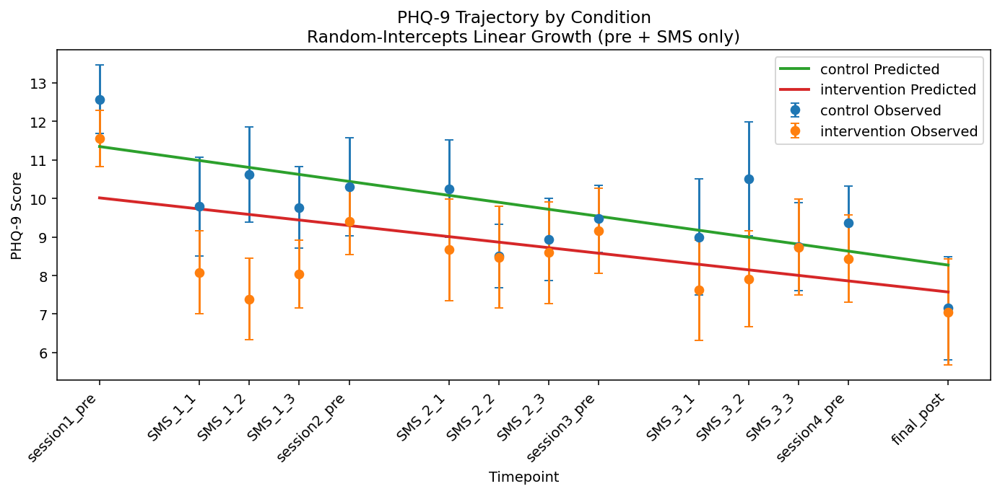

In [39]:
import pandas as pd
import numpy as np
import statsmodels.formula.api as smf
import matplotlib.pyplot as plt

# --------------------------------------
# ── ASSUMPTION: df_long is your cleaned, concatenated DataFrame
# --------------------------------------

# 1) Define the ordered timepoints exactly as in your study
ordered_timepoints = [
    'session1_pre','session1_post',
    'SMS_1_1','SMS_1_2','SMS_1_3',
    'session2_pre','session2_post',
    'SMS_2_1','SMS_2_2','SMS_2_3',
    'session3_pre','session3_post',
    'SMS_3_1','SMS_3_2','SMS_3_3',
    'session4_pre','session4_post',
    'final_post'
]

# 2) Turn timepoint into a numeric index
df_long['timepoint'] = pd.Categorical(
    df_long['timepoint'],
    categories=ordered_timepoints,
    ordered=True
)
df_long['time_num'] = df_long['timepoint'].cat.codes

# 3) Subset to pre+SMS only (drop all sessionN_post)
mask_post = df_long['timepoint'].astype(str).str.match(r'^session\d+_post$')
df_model = df_long.loc[~mask_post].copy()

# 4) Drop any rows missing outcome or predictors, reset index
df_model = (
    df_model
    .dropna(subset=['phq9_sum','condition'])
    .reset_index(drop=True)
)

# 5) Center time_num (so intercept ≈ mean PHQ‑9 at midpoint)
df_model['tc'] = df_model['time_num'] - df_model['time_num'].mean()

# 6) Make sure condition is categorical
df_model['condition'] = df_model['condition'].astype('category')

# 7) Fit random‐intercepts linear growth model
model0 = smf.mixedlm(
    "phq9_sum ~ tc * condition",
    data=df_model,
    groups="part_id",
    re_formula="~1"          # random intercept only
)
res0 = model0.fit(method='lbfgs')
print(res0.summary())

# --------------------------------------
# ── PLOTTING OBSERVED ± SEM & FIXED EFFECTS
# --------------------------------------

# a) observed means + SEM
obs = (
    df_model
    .groupby(['condition','time_num'])['phq9_sum']
    .agg(['mean','sem'])
    .reset_index()
)

# b) build prediction grid
fe = res0.fe_params
mean_time = df_model['time_num'].mean()
conds = df_model['condition'].cat.categories
time_vals = sorted(df_model['time_num'].unique())

preds = []
for cond in conds:
    is_int = int(cond == 'intervention')
    for t in time_vals:
        tc = t - mean_time
        pred = (
            fe['Intercept']
            + fe.get('condition[T.intervention]', 0) * is_int
            + fe['tc'] * tc
            + fe.get('tc:condition[T.intervention]', 0) * tc * is_int
        )
        preds.append({'condition': cond, 'time_num': t, 'predicted': pred})
pred_df = pd.DataFrame(preds)

# c) plot
plt.figure(figsize=(10,5))
for cond, grp in obs.groupby('condition'):
    plt.errorbar(
        grp['time_num'], grp['mean'], yerr=grp['sem'],
        fmt='o', capsize=3, label=f"{cond} Observed"
    )
for cond in conds:
    sub = pred_df[pred_df['condition']==cond]
    plt.plot(
        sub['time_num'], sub['predicted'], '-',
        lw=2, label=f"{cond} Predicted"
    )

# label x‐axis with your timepoint names
labels = [ordered_timepoints[i] for i in time_vals]
plt.xticks(time_vals, labels, rotation=45, ha='right')

plt.xlabel("Timepoint")
plt.ylabel("PHQ-9 Score")
plt.title("PHQ-9 Trajectory by Condition\nRandom‐Intercepts Linear Growth (pre + SMS only)")
plt.legend()
plt.tight_layout()
plt.show()

## End Junkyard

In [40]:
# ─── 1. IMPORTS & FILE DEFINITIONS ─────────────────────────────────────────
import zipfile
import pandas as pd
from pathlib import Path

# Two exports: (path, forced_session_n)
files = [
    (Path('/content/wp2_post_sessions_1-3_October 17, 2025_09.42.csv'), None),
    (Path('/content/wp2_post_session_4_October 17, 2025_09.43.csv'), 4),
]

# ─── 2. LOAD & TAG SESSIONS ────────────────────────────────────────────────
dfs = []
for fp, forced in files:
    if fp.suffix == '.zip':
        with zipfile.ZipFile(fp) as z:
            csvs = [f for f in z.namelist() if f.lower().endswith('.csv')]
            assert len(csvs)==1, f"Expected 1 CSV in {fp}, got {csvs}"
            tmp = pd.read_csv(z.open(csvs[0]), header=0)
    else:
        tmp = pd.read_csv(fp, header=0)

    tmp = tmp.iloc[1:].copy()         # drop the Qualtrics metadata row
    if forced is not None:
        tmp['session_n'] = forced     # force session 4 → 4
    dfs.append(tmp)

df = pd.concat(dfs, ignore_index=True)

# ─── 3. STANDARDIZE part_id & MERGE CONDITIONS ─────────────────────────────
df['part_id'] = df['part_id'].astype(str)
assign = pd.read_csv('/content/wp2_assignments.csv')
assign['part_id'] = assign['part_id'].astype(str)
df = df.merge(assign[['part_id','condition']], on='part_id', how='left')

df['session_n'] = pd.to_numeric(df['session_n'], errors='coerce')

# ─── 4. DEFINE SUBSCALES ─────────────────────────────────────────────────────
vhq_defs = {
    "Geometric":   ['6d_vhq_1','6d_vhq_2','6d_vhq_3'],
    "Semantic":    ['6d_vhq_4','6d_vhq_5','6d_vhq_6'],
    "Detail":      ['6d_vhq_7','6d_vhq_8','6d_vhq_9'],
    "Vividness":   ['6d_vhq_10','6d_vhq_11','6d_vhq_12'],
    "Entropy":     ['6d_vhq_13','6d_vhq_14','6d_vhq_15'],
    "Focality":    ['6d_vhq_16','6d_vhq_17','6d_vhq_18'],
}

asc_defs = {
    "Experience_of_Unity": [
        'asc_18_4','asc_34_4','asc_41_4','asc_42_4','asc_52_4'
    ],
    "Spiritual_Experience": [
        'asc_9_4','asc_81_4','asc_94_4'
    ],
    "Blissful_State": [
        'asc_12_4','asc_86_4','asc_91_4'
    ],
    "Insightfulness": [
        'asc_50_4','asc_69_4','asc_77_4'      # asc_72_4 is Visionary, not Insight
    ],
    "Disembodiment": [
        'asc_26_4','asc_62_4','asc_63_4'
    ],
    "Impaired_Control_and_Cognition": [
        'asc_8_4','asc_27_4','asc_38_4','asc_47_4','asc_64_4','asc_67_4','asc_78_4'
    ],
    "Anxiety": [
        'asc_32_4','asc_43_4','asc_44_4','asc_46_4','asc_56_4','asc_89_4'
    ],
    "Complex_Imagery": [
        'asc_39_4','asc_72_4','asc_82_4'
    ],
    "Elementary_Imagery": [
        'asc_14_4','asc_22_4','asc_33_4'
    ],
    "Audio_Visual_Synesthesia": [
        'asc_20_4','asc_23_4','asc_75_4'
    ],
    "Changed_Meaning_of_Percepts": [
        'asc_28_4','asc_31_4','asc_54_4'
    ]
}

exp4_defs = [
    'exp4_engagement_1',
    'exp4_pleasure_1',
    'exp4_discomfort_1',
    'exp4_arousal_1',
]

# ─── 5. INTERSECT & CAST TO NUMERIC ──────────────────────────────────────────
def intersect(name, items):
    pres = [c for c in items if c in df.columns]
    miss = set(items) - set(pres)
    if miss:
        print(f"⚠️ {name}: dropped {len(miss)} missing → {sorted(miss)}")
    return pres

vhq = {k: intersect(k, v) for k, v in vhq_defs.items()}
asc = {k: intersect(k, v) for k, v in asc_defs.items()}
exp4 = intersect("EXP4", exp4_defs)

# dedupe and convert
all_cols = sum(vhq.values(), []) + sum(asc.values(), []) + exp4
unique_cols = []
for c in all_cols:
    if c in df.columns and c not in unique_cols:
        unique_cols.append(c)

df[unique_cols] = df[unique_cols].apply(pd.to_numeric, errors='coerce')

# ─── 5.5 REVERSE‑CODE VIVIDNESS ITEMS (1–5 scale) ────────────────────────────
min_score, max_score = 1, 5
for item in vhq['Vividness']:
    df[item] = (max_score + min_score) - df[item]

# ─── 6. COMPUTE PARTICIPANT×SESSION SCORES ──────────────────────────────────
records = []
for (pid, sess), sub in df.groupby(['part_id', 'session_n']):
    rec = {'part_id': pid, 'session_n': sess, 'condition': sub['condition'].iloc[0]}
    # VHQ
    for d, cols in vhq.items():
        rec[f'VHQ_{d}'] = sub[cols].mean(axis=1).mean()
    # ASC
    for d, cols in asc.items():
        rec[f'ASC_{d}'] = sub[cols].mean(axis=1).mean()
    # EXP4
    for col in exp4:
        key = col.replace('exp4_', '').replace('_1', '').capitalize()
        rec[f'EXP4_{key}'] = sub[col].mean()
    records.append(rec)

df_scores = pd.DataFrame(records)

# ─── 7. SESSION & SESSION×CONDITION MEANS ──────────────────────────────────
session_means      = df_scores.groupby('session_n',    as_index=False).mean(numeric_only=True)
session_cond_means = df_scores.groupby(['session_n','condition'], as_index=False).mean(numeric_only=True)

print("session_means:\n", session_means)
print("\nsession×condition means:\n", session_cond_means)

session_means:
    session_n  VHQ_Geometric  VHQ_Semantic  VHQ_Detail  VHQ_Vividness  \
0        1.0       3.543210      2.726496    3.003030       3.600000   
1        2.0       3.613095      2.717593    3.003472       3.353659   
2        3.0       3.462366      2.648810    2.988636       3.212963   
3        4.0       3.607843      2.734568    2.846491       3.414414   

   VHQ_Entropy  VHQ_Focality  ASC_Experience_of_Unity  \
0     2.977987      2.840136                28.125424   
1     3.118519      2.855072                30.862745   
2     3.101626      2.680180                28.934783   
3     3.179167      2.756757                25.026667   

   ASC_Spiritual_Experience  ASC_Blissful_State  ...  \
0                 28.378531           30.830508  ...   
1                 25.666667           34.058824  ...   
2                 24.108696           31.536232  ...   
3                 24.096296           32.874074  ...   

   ASC_Impaired_Control_and_Cognition  ASC_Anxiety  ASC_

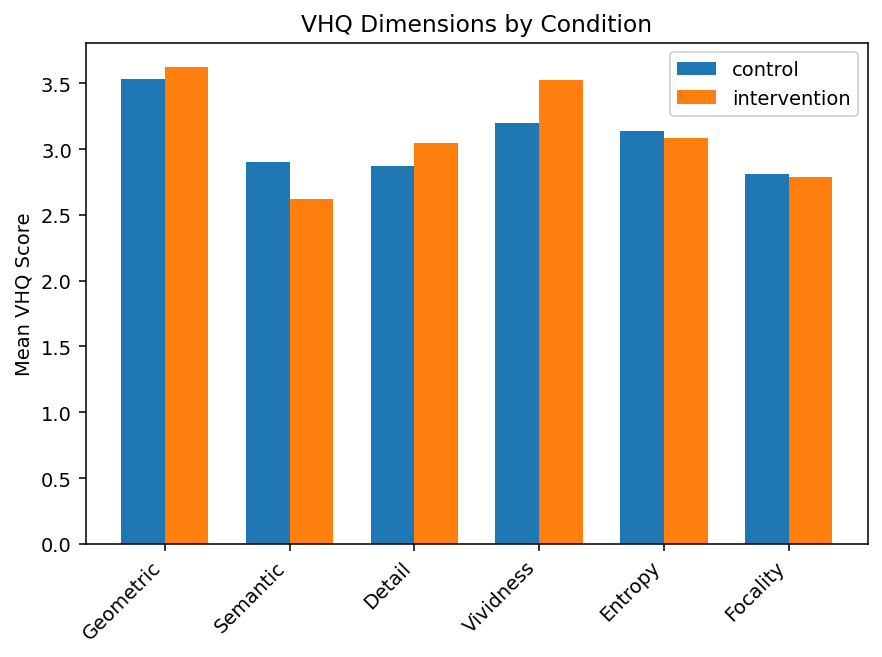

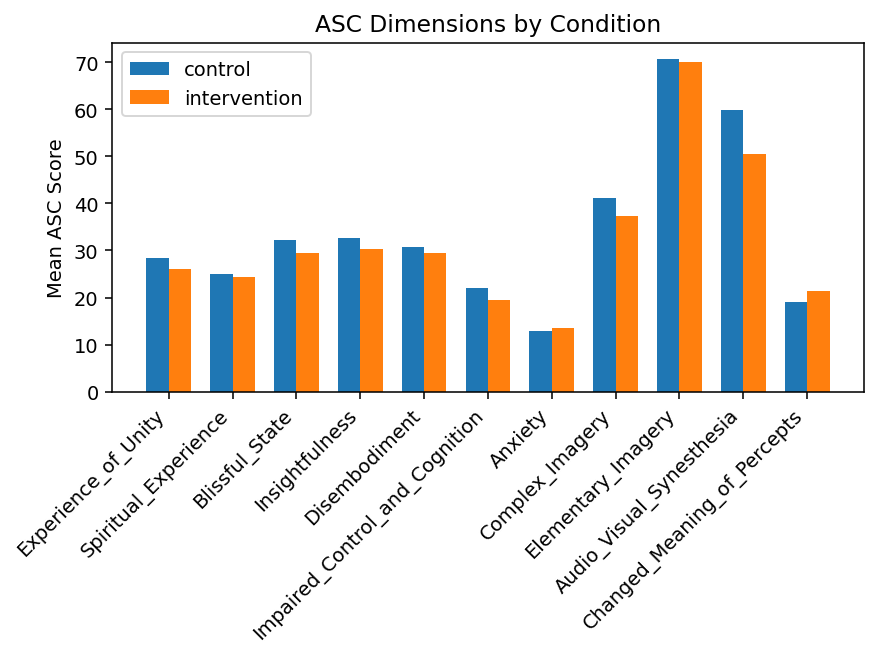

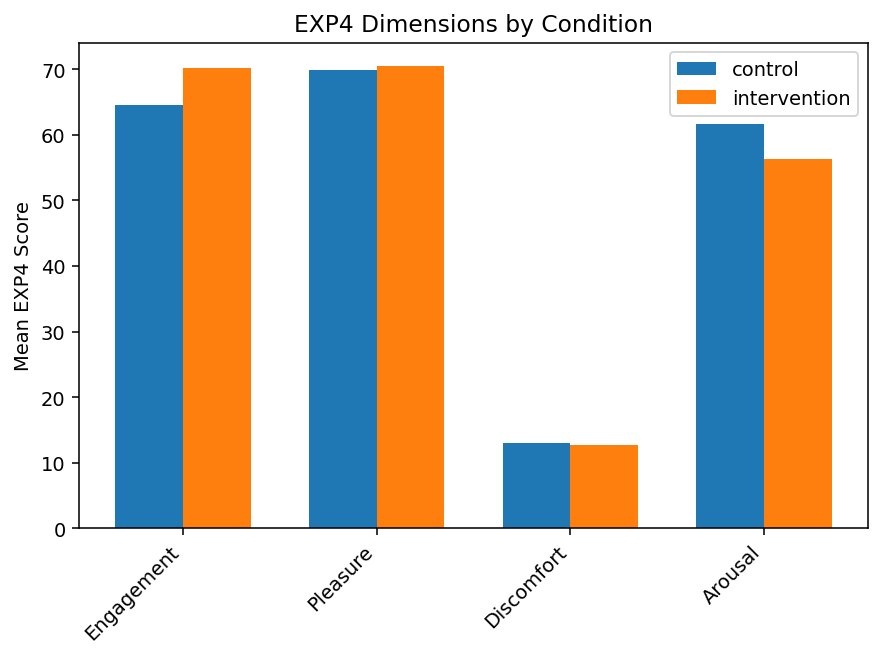

In [41]:
import matplotlib.pyplot as plt

# Compute overall means per condition across all sessions
overall = df_scores.groupby('condition').mean(numeric_only=True)
conds   = overall.index.tolist()
width   = 0.35

# 1) VHQ bar chart
vhq_cols   = [c for c in overall.columns if c.startswith('VHQ_')]
vhq_labels = [c.replace('VHQ_', '') for c in vhq_cols]
x = range(len(vhq_cols))

plt.figure()
for i, cond in enumerate(conds):
    plt.bar([pos + i*width for pos in x],
            overall.loc[cond, vhq_cols],
            width,
            label=cond)
plt.xticks([pos + width*(len(conds)-1)/2 for pos in x],
           vhq_labels, rotation=45, ha='right')
plt.ylabel('Mean VHQ Score')
plt.title('VHQ Dimensions by Condition')
plt.legend()
plt.tight_layout()

# 2) ASC bar chart
asc_cols   = [c for c in overall.columns if c.startswith('ASC_')]
asc_labels = [c.replace('ASC_', '') for c in asc_cols]
x = range(len(asc_cols))

plt.figure()
for i, cond in enumerate(conds):
    plt.bar([pos + i*width for pos in x],
            overall.loc[cond, asc_cols],
            width,
            label=cond)
plt.xticks([pos + width*(len(conds)-1)/2 for pos in x],
           asc_labels, rotation=45, ha='right')
plt.ylabel('Mean ASC Score')
plt.title('ASC Dimensions by Condition')
plt.legend()
plt.tight_layout()

# 3) EXP4 bar chart
exp4_cols   = [c for c in overall.columns if c.startswith('EXP4_')]
exp4_labels = [c.replace('EXP4_', '') for c in exp4_cols]
x = range(len(exp4_cols))

plt.figure()
for i, cond in enumerate(conds):
    plt.bar([pos + i*width for pos in x],
            overall.loc[cond, exp4_cols],
            width,
            label=cond)
plt.xticks([pos + width*(len(conds)-1)/2 for pos in x],
           exp4_labels, rotation=45, ha='right')
plt.ylabel('Mean EXP4 Score')
plt.title('EXP4 Dimensions by Condition')
plt.legend()
plt.tight_layout()

plt.show()

### Mean Differences (Intervention minus Control) ###
                         Dimension  Mean Difference
                         session_n        -0.035135
                     VHQ_Geometric         0.092971
                      VHQ_Semantic        -0.284612
                        VHQ_Detail         0.173745
                     VHQ_Vividness         0.332323
                       VHQ_Entropy        -0.048227
                      VHQ_Focality        -0.022290
           ASC_Experience_of_Unity        -2.468970
          ASC_Spiritual_Experience        -0.462991
                ASC_Blissful_State        -2.769194
                ASC_Insightfulness        -2.438227
                 ASC_Disembodiment        -1.270910
ASC_Impaired_Control_and_Cognition        -2.470957
                       ASC_Anxiety         0.703182
               ASC_Complex_Imagery        -3.855554
            ASC_Elementary_Imagery        -0.602350
      ASC_Audio_Visual_Synesthesia        -9.376395
   ASC_Cha

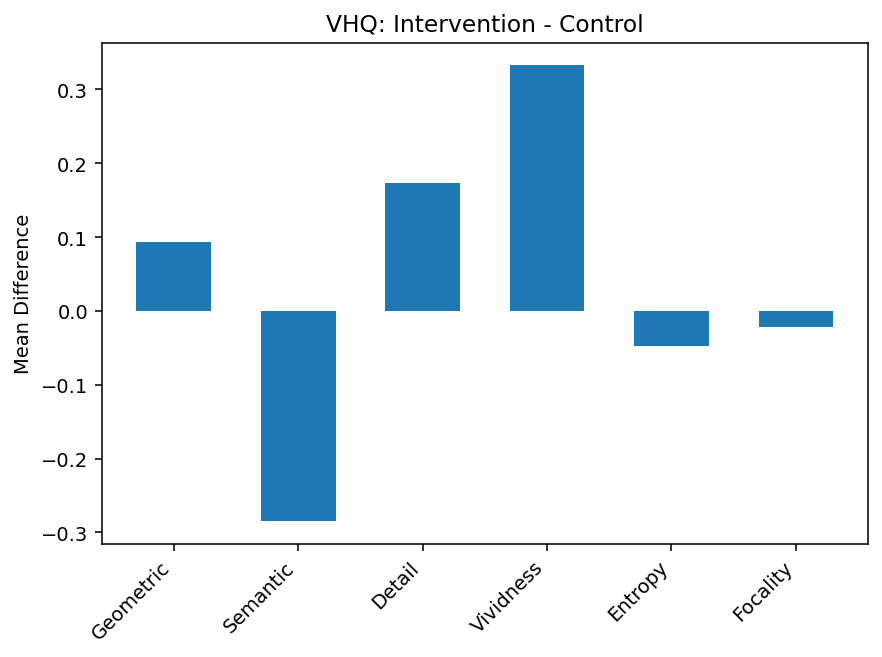

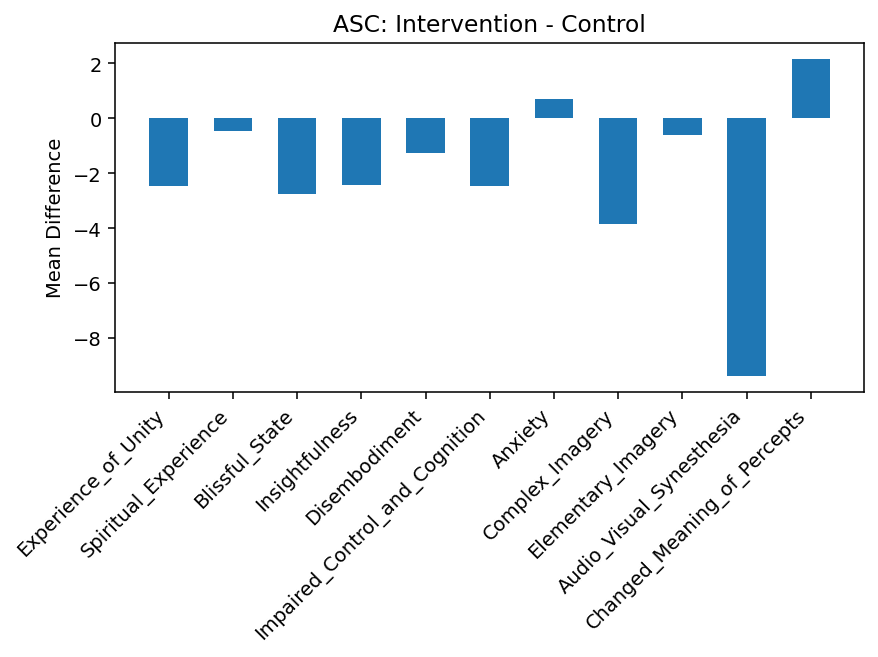

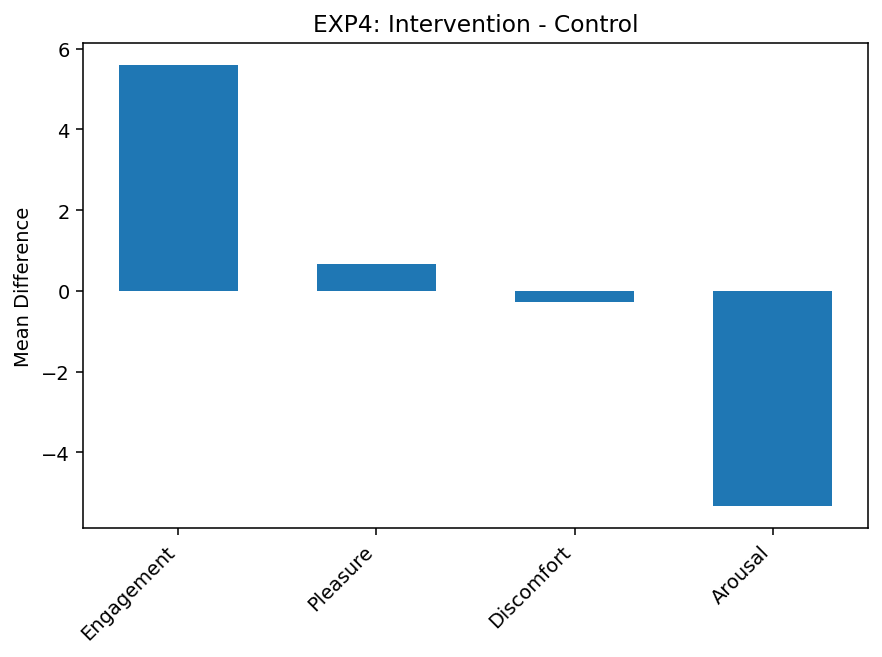

### Intervention − Control: Mean Differences & p‑values ###


,Dimension,MeanDiff,p_value
0,VHQ_Geometric,0.092971,0.677272
1,VHQ_Semantic,-0.284612,0.330478
2,VHQ_Detail,0.173745,0.359674
3,VHQ_Vividness,0.332323,0.016816
4,VHQ_Entropy,-0.048227,0.811592
5,VHQ_Focality,-0.022290,0.329435
6,ASC_Experience_of_Unity,-2.468970,0.672094
7,ASC_Spiritual_Experience,-0.462991,0.797828
8,ASC_Blissful_State,-2.769194,0.531187
9,ASC_Insightfulness,-2.438227,0.697720


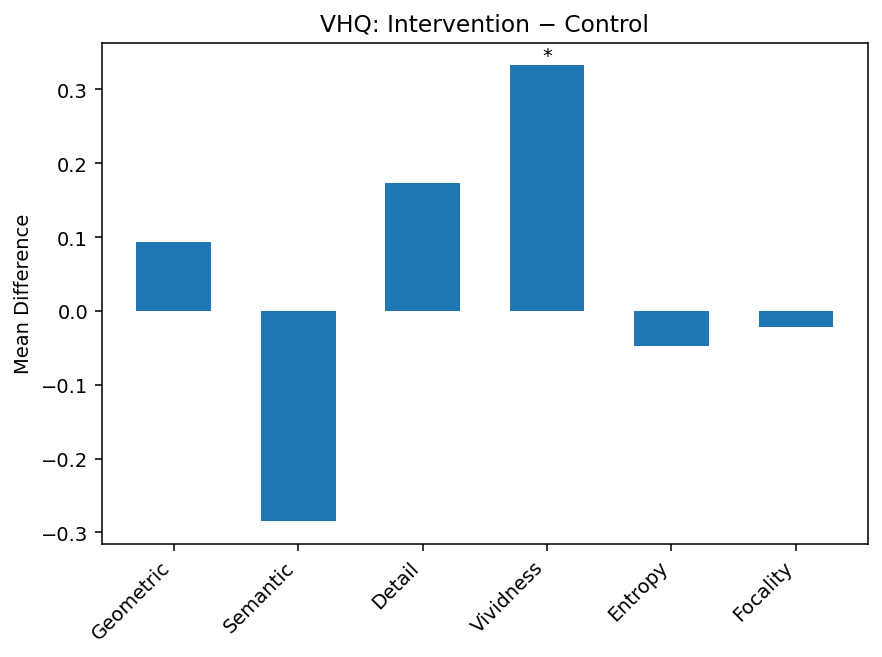

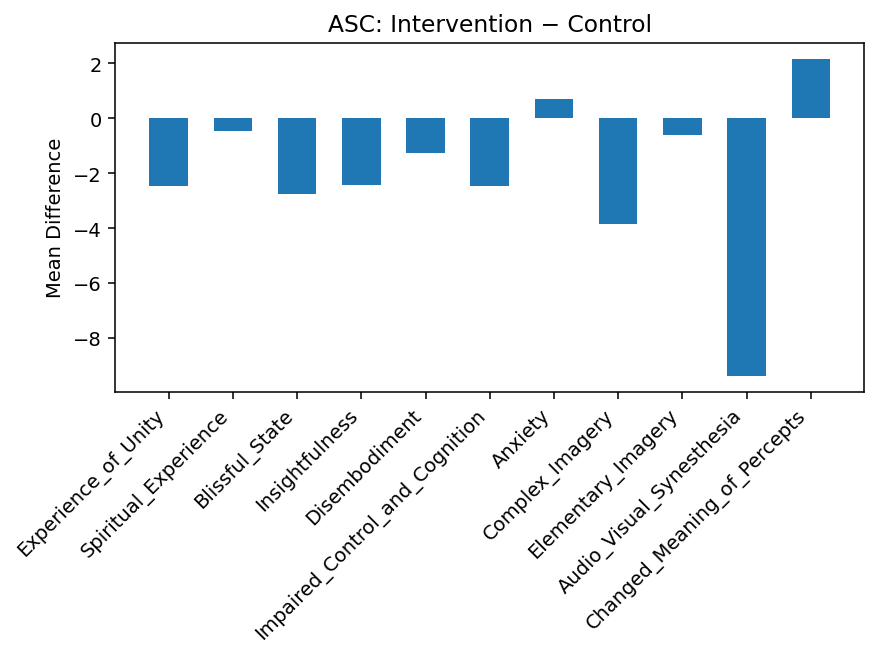

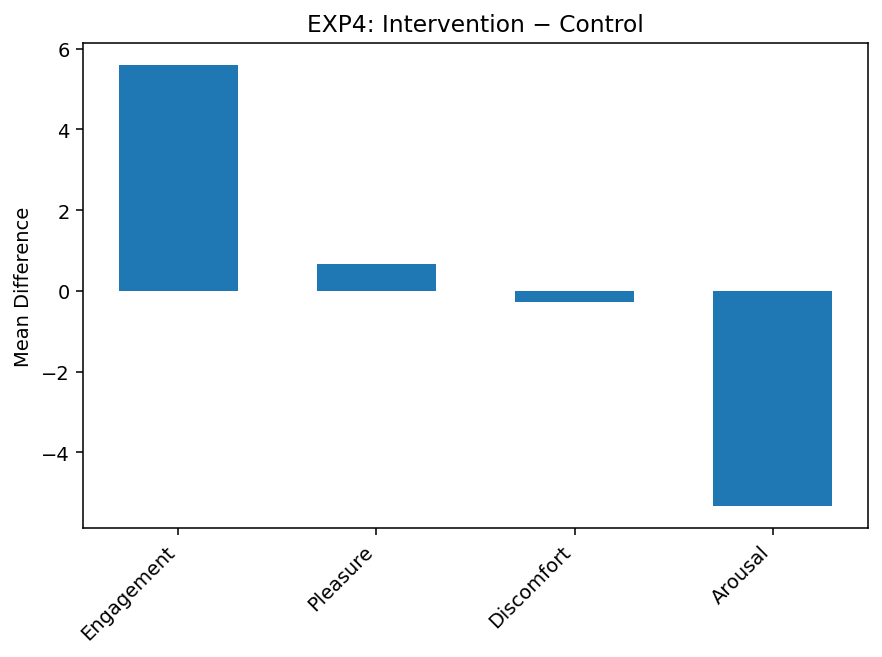

In [42]:
import pandas as pd
import matplotlib.pyplot as plt

# 1. Compute overall means per condition across all sessions
overall = df_scores.groupby('condition').mean(numeric_only=True)

# 2. Determine which condition is Control vs. Intervention
conds = sorted(overall.index.tolist())

# 3. Compute the difference (Intervention – Control)
diff = overall.loc[conds[1]] - overall.loc[conds[0]]

# 4. Display the numeric table of differences
diff_df = pd.DataFrame({
    'Dimension': diff.index,
    'Mean Difference': diff.values
})
print("### Mean Differences (Intervention minus Control) ###")
print(diff_df.to_string(index=False))

# 5. Plot the differences by scale

width = 0.6

# VHQ
vhq_cols   = [c for c in diff.index if c.startswith('VHQ_')]
vhq_labels = [c.replace('VHQ_', '') for c in vhq_cols]
x = range(len(vhq_cols))

plt.figure()
plt.bar(x, diff[vhq_cols], width)
plt.xticks(x, vhq_labels, rotation=45, ha='right')
plt.ylabel('Mean Difference')
plt.title('VHQ: Intervention - Control')
plt.tight_layout()

# ASC
asc_cols   = [c for c in diff.index if c.startswith('ASC_')]
asc_labels = [c.replace('ASC_', '') for c in asc_cols]
x = range(len(asc_cols))

plt.figure()
plt.bar(x, diff[asc_cols], width)
plt.xticks(x, asc_labels, rotation=45, ha='right')
plt.ylabel('Mean Difference')
plt.title('ASC: Intervention - Control')
plt.tight_layout()

# EXP4
exp4_cols   = [c for c in diff.index if c.startswith('EXP4_')]
exp4_labels = [c.replace('EXP4_', '') for c in exp4_cols]
x = range(len(exp4_cols))

plt.figure()
plt.bar(x, diff[exp4_cols], width)
plt.xticks(x, exp4_labels, rotation=45, ha='right')
plt.ylabel('Mean Difference')
plt.title('EXP4: Intervention - Control')
plt.tight_layout()

plt.show()

import pandas as pd
from scipy.stats import ttest_ind
import matplotlib.pyplot as plt

# 1. Identify all VHQ, ASC, EXP4 dimensions
dim_cols = [c for c in df_scores.columns if c.startswith(('VHQ_','ASC_','EXP4_'))]

# 2. Compute overall condition means and differences
cond_means = df_scores.groupby('condition')[dim_cols].mean()
conds = sorted(cond_means.index.tolist())
diff = cond_means.loc[conds[1]] - cond_means.loc[conds[0]]

# 3. Independent t-tests between conditions on participant means
part_means = (
    df_scores
    .groupby(['part_id','condition'])[dim_cols]
    .mean()
    .reset_index()
)
p_vals = {}
for dim in dim_cols:
    g1 = part_means.loc[part_means['condition']==conds[0], dim]
    g2 = part_means.loc[part_means['condition']==conds[1], dim]
    _, p = ttest_ind(g1, g2, nan_policy='omit')
    p_vals[dim] = p

# 4. Assemble results
results = pd.DataFrame({
    'Dimension': dim_cols,
    'MeanDiff': [diff[d] for d in dim_cols],
    'p_value': [p_vals[d] for d in dim_cols]
})

# 5. Display full results
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
print("### Intervention − Control: Mean Differences & p‑values ###")
display(results)

# 6. Plot with significance asterisks
width = 0.6
for scale, prefix in [('VHQ','VHQ_'), ('ASC','ASC_'), ('EXP4','EXP4_')]:
    cols   = [d for d in results['Dimension'] if d.startswith(prefix)]
    labs   = [c.replace(prefix,'') for c in cols]
    vals   = results.set_index('Dimension').loc[cols,'MeanDiff']
    pvs    = results.set_index('Dimension').loc[cols,'p_value']

    x = range(len(cols))
    fig, ax = plt.subplots()
    ax.bar(x, vals, width)
    ax.set_xticks(x)
    ax.set_xticklabels(labs, rotation=45, ha='right')
    ax.set_ylabel('Mean Difference')
    ax.set_title(f'{scale}: Intervention − Control')

    y_max = vals.max()
    for i, p in enumerate(pvs):
        if p < 0.05:
            ax.text(i, vals.iloc[i] + 0.02*y_max, '*', ha='center')
    plt.tight_layout()
plt.show()

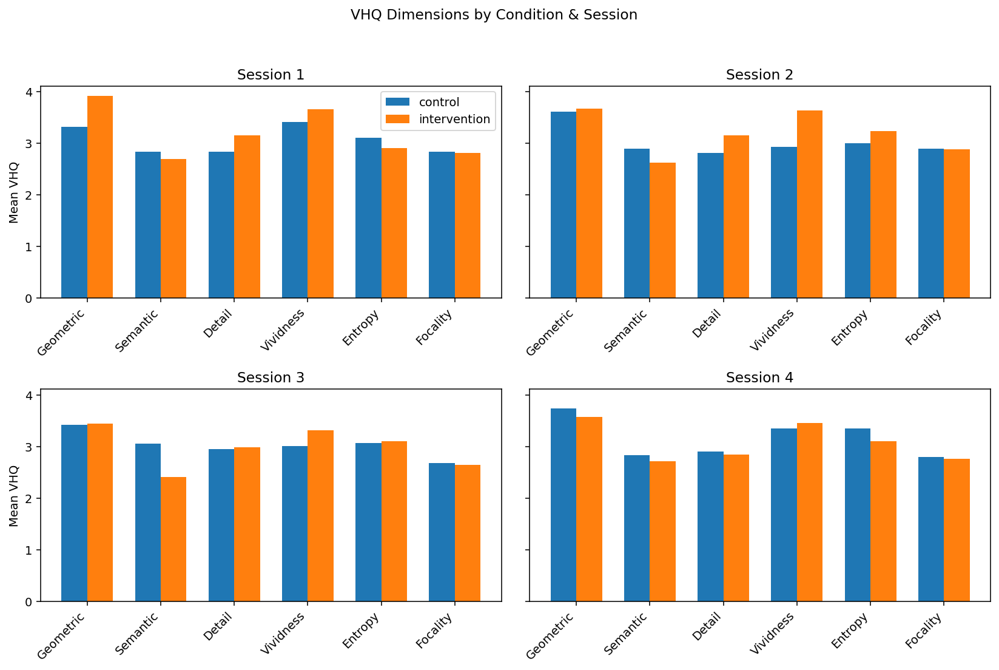

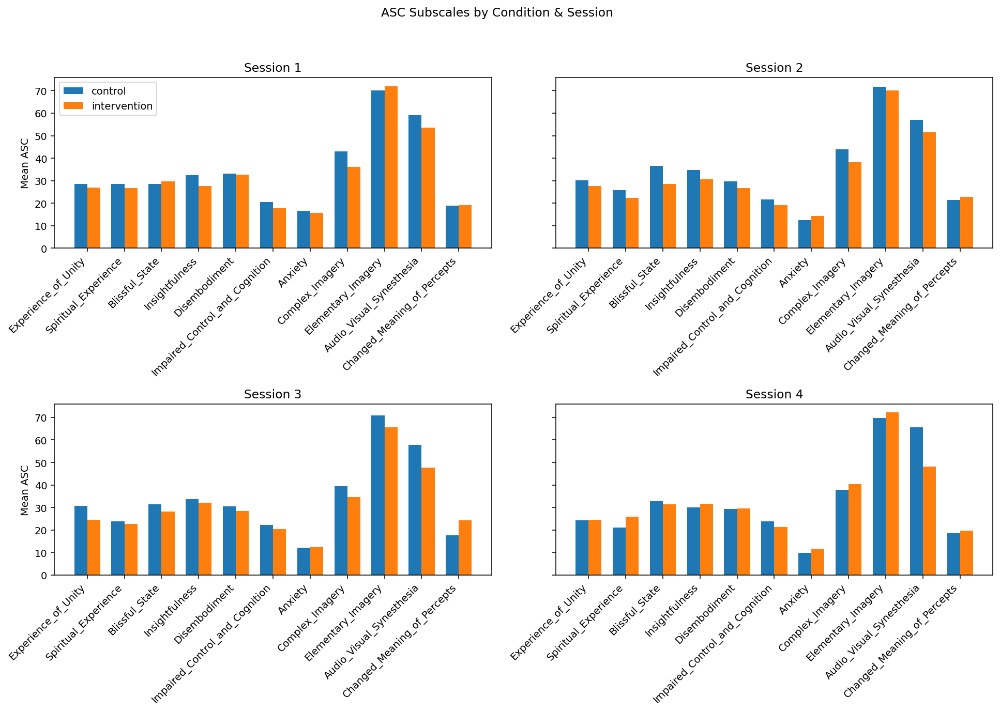

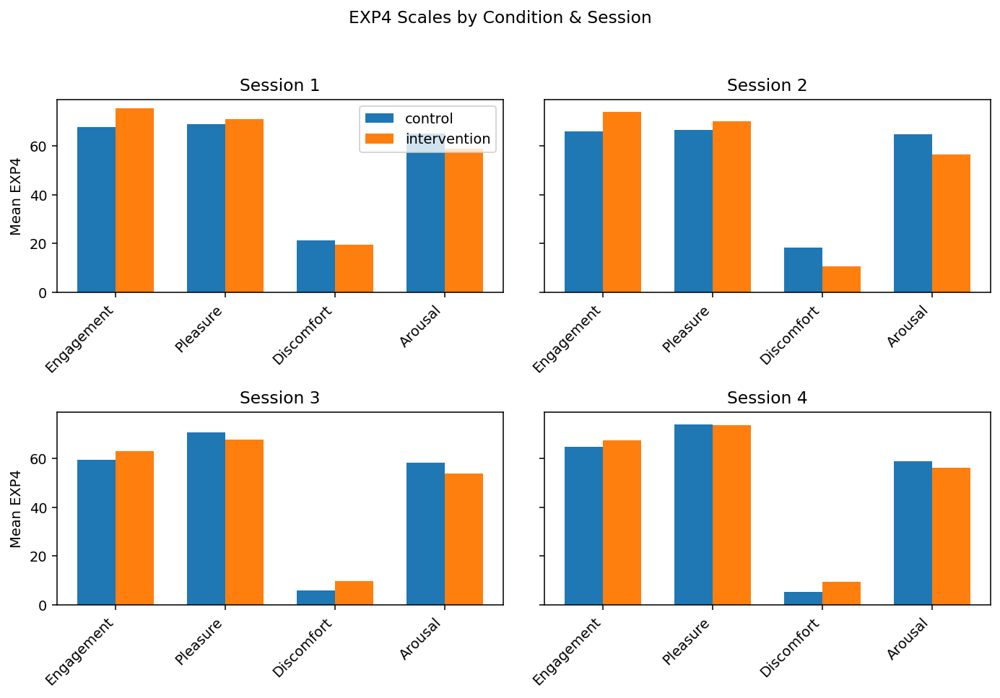

In [43]:
import matplotlib.pyplot as plt

# 1. Grab your existing session×condition means
#    It should have columns like VHQ_Geometric, ASC_Unity, EXP4_Engagement, etc.
#    and an index or columns ['session_n','condition']
session_cond = session_cond_means.set_index(['session_n','condition'])

sessions = sorted(session_cond.index.get_level_values('session_n').unique())
conds    = sorted(session_cond.index.get_level_values('condition').unique())
width    = 0.35

# 2. VHQ Dimensions
vhq_cols   = [c for c in session_cond.columns if c.startswith('VHQ_')]
vhq_labels = [c.replace('VHQ_','') for c in vhq_cols]

fig, axes = plt.subplots(2,2, figsize=(12,8), sharey=True)
axes = axes.flatten()
x = range(len(vhq_cols))

for i, sess in enumerate(sessions):
    ax = axes[i]
    for j, cond in enumerate(conds):
        vals = session_cond.loc[(sess,cond), vhq_cols]
        ax.bar([pos + j*width for pos in x], vals, width, label=cond)
    ax.set_title(f"Session {int(sess)}")
    ax.set_xticks([pos + width*(len(conds)-1)/2 for pos in x])
    ax.set_xticklabels(vhq_labels, rotation=45, ha='right')
    if i%2==0: ax.set_ylabel("Mean VHQ")
    if i==0:  ax.legend()
fig.suptitle("VHQ Dimensions by Condition & Session")
plt.tight_layout(rect=[0,0,1,0.95])

# 3. ASC Subscales
asc_cols   = [c for c in session_cond.columns if c.startswith('ASC_')]
asc_labels = [c.replace('ASC_','') for c in asc_cols]

fig, axes = plt.subplots(2,2, figsize=(14,10), sharey=True)
axes = axes.flatten()
x = range(len(asc_cols))

for i, sess in enumerate(sessions):
    ax = axes[i]
    for j, cond in enumerate(conds):
        vals = session_cond.loc[(sess,cond), asc_cols]
        ax.bar([pos + j*width for pos in x], vals, width, label=cond)
    ax.set_title(f"Session {int(sess)}")
    ax.set_xticks([pos + width*(len(conds)-1)/2 for pos in x])
    ax.set_xticklabels(asc_labels, rotation=45, ha='right')
    if i%2==0: ax.set_ylabel("Mean ASC")
    if i==0:  ax.legend()
fig.suptitle("ASC Subscales by Condition & Session")
plt.tight_layout(rect=[0,0,1,0.95])

# 4. EXP4 Scales
exp4_cols   = [c for c in session_cond.columns if c.startswith('EXP4_')]
exp4_labels = [c.replace('EXP4_','') for c in exp4_cols]

fig, axes = plt.subplots(2,2, figsize=(10,7), sharey=True)
axes = axes.flatten()
x = range(len(exp4_cols))

for i, sess in enumerate(sessions):
    ax = axes[i]
    for j, cond in enumerate(conds):
        vals = session_cond.loc[(sess,cond), exp4_cols]
        ax.bar([pos + j*width for pos in x], vals, width, label=cond)
    ax.set_title(f"Session {int(sess)}")
    ax.set_xticks([pos + width*(len(conds)-1)/2 for pos in x])
    ax.set_xticklabels(exp4_labels, rotation=45, ha='right')
    if i%2==0: ax.set_ylabel("Mean EXP4")
    if i==0:  ax.legend()
fig.suptitle("EXP4 Scales by Condition & Session")
plt.tight_layout(rect=[0,0,1,0.95])

plt.show()

/tmp/ipython-input-2372926287.py:28: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()


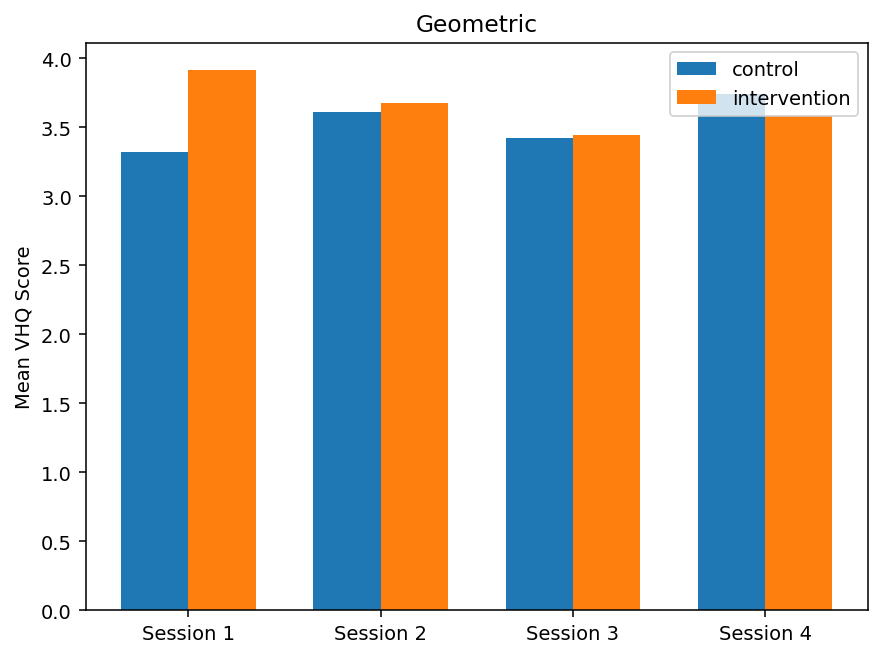

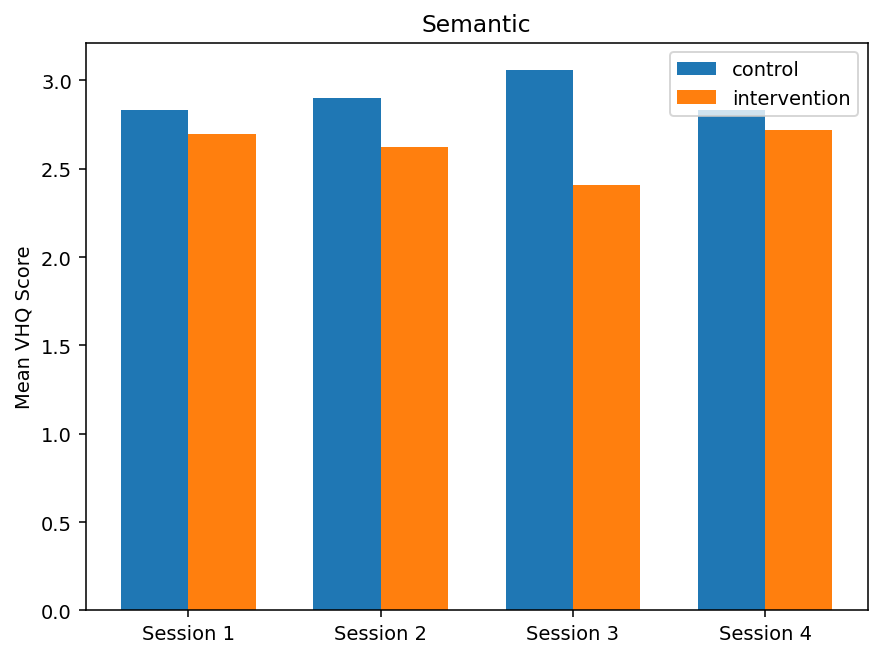

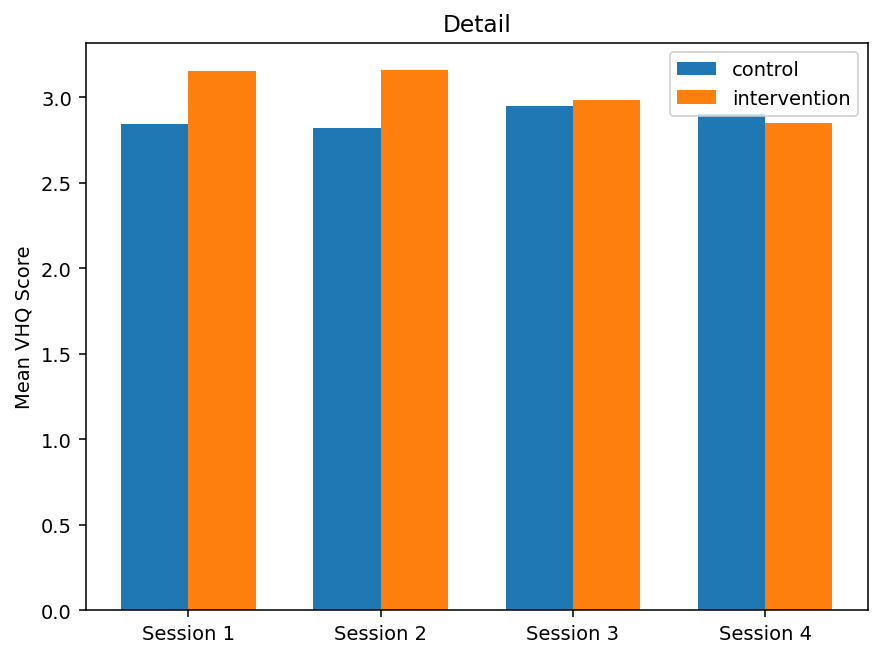

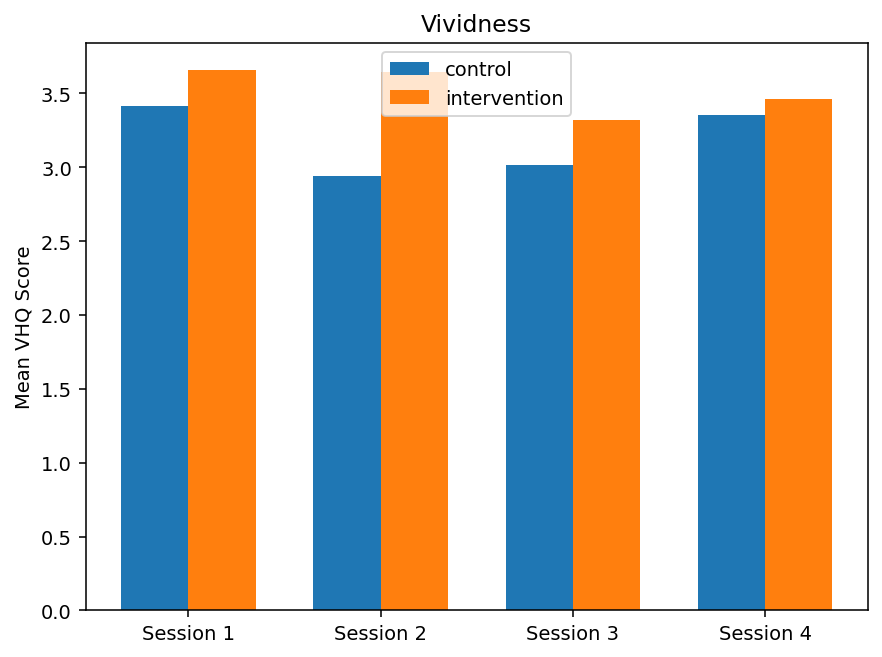

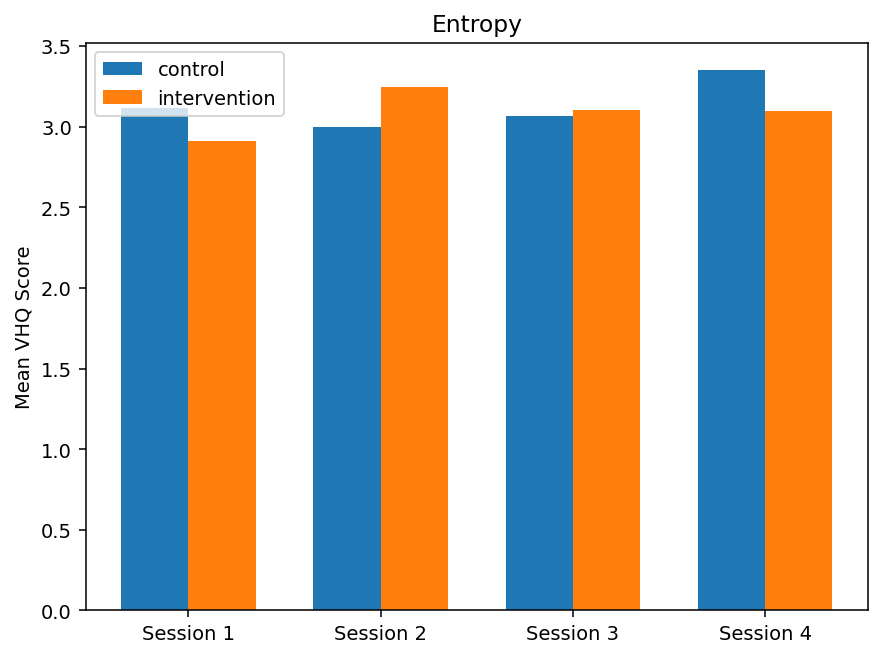

...

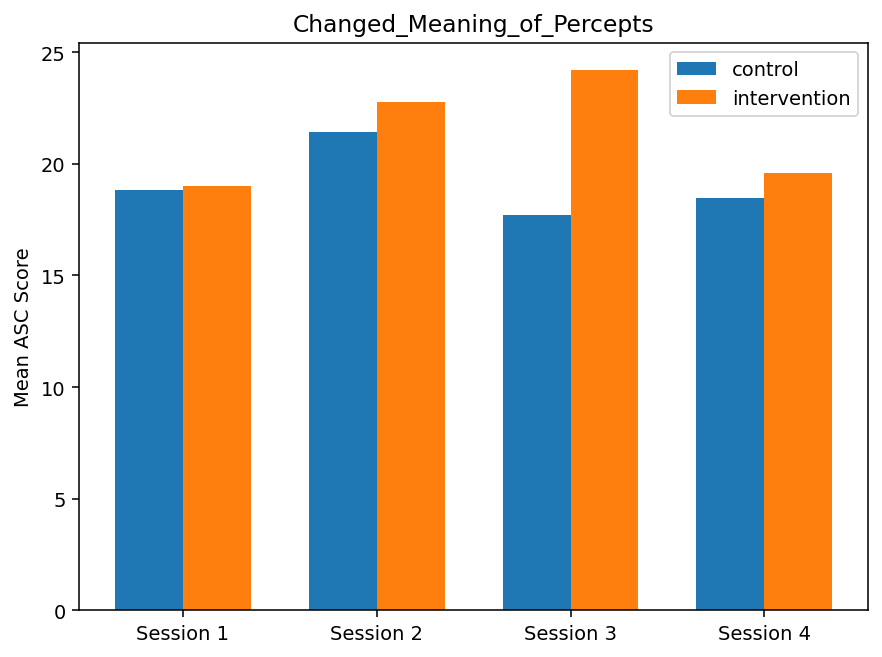

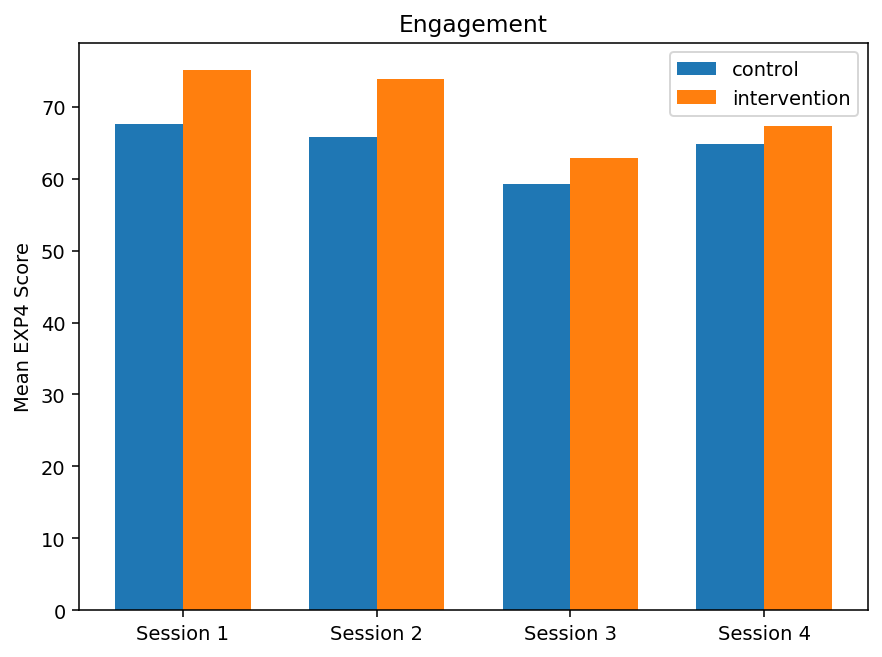

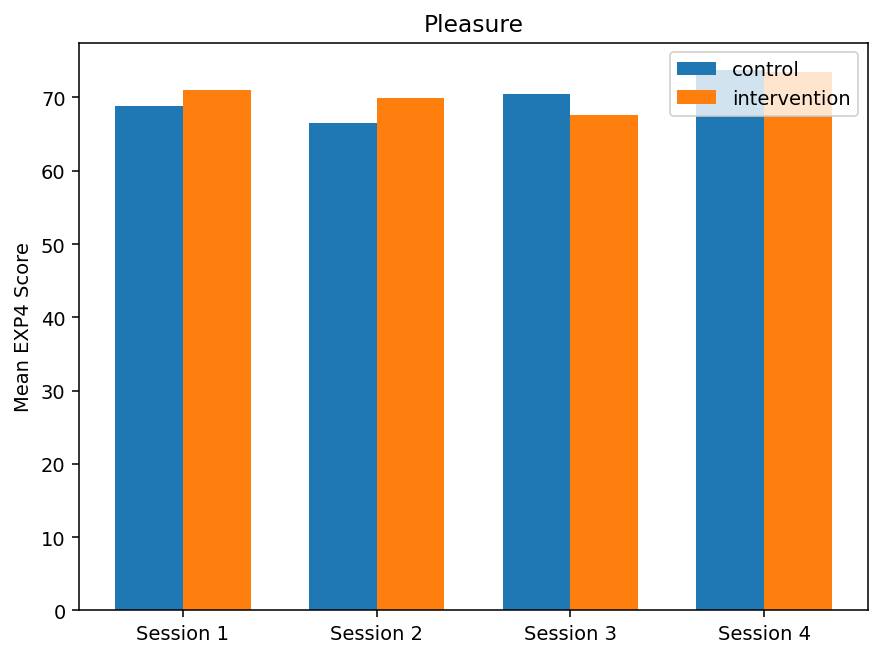

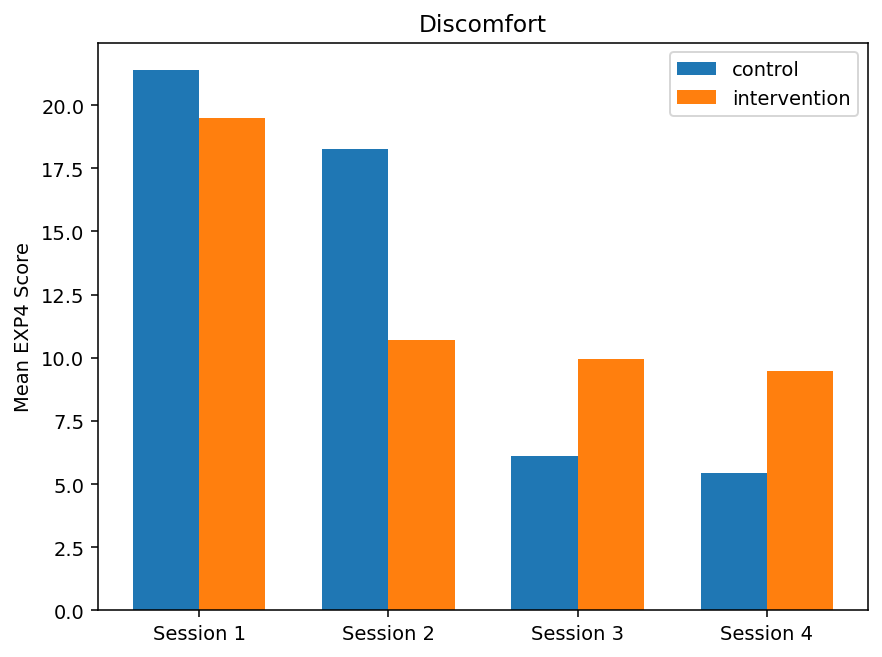

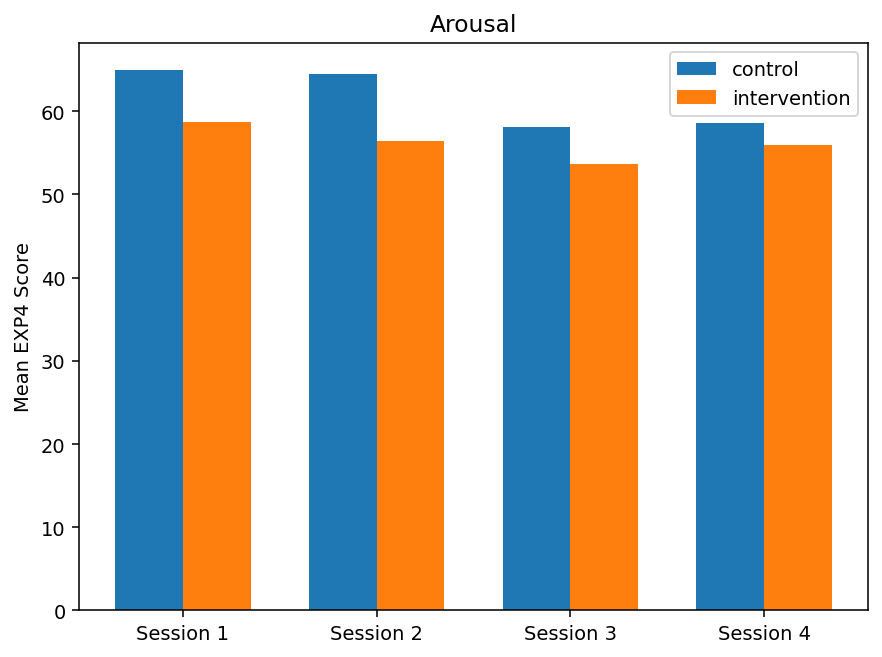

In [44]:
import matplotlib.pyplot as plt

# Make sure you’ve already got:
#   df_scores with columns ['part_id','session_n','condition', 'VHQ_*', 'ASC_*', 'EXP4_*']

# 1. Compute session×condition means
session_cond = (
    df_scores
    .groupby(['session_n','condition'], as_index=False)
    .mean(numeric_only=True)
    .set_index(['session_n','condition'])
)

sessions = sorted(session_cond.index.get_level_values('session_n').unique())
conds    = sorted(session_cond.index.get_level_values('condition').unique())
width    = 0.35

# 2. Lists of your dimension columns
vhq_cols  = [c for c in session_cond.columns if c.startswith('VHQ_')]
asc_cols  = [c for c in session_cond.columns if c.startswith('ASC_')]
exp4_cols = [c for c in session_cond.columns if c.startswith('EXP4_')]

# 3. Plot function
def plot_by_session(cols, prefix, ylabel):
    labels = [c.replace(prefix, '') for c in cols]
    x = range(len(sessions))
    for dim, lab in zip(cols, labels):
        fig, ax = plt.subplots()
        for i, cond in enumerate(conds):
            vals = [session_cond.loc[(s,cond), dim] for s in sessions]
            ax.bar([pos + i*width for pos in x], vals, width, label=cond)
        ax.set_xticks([pos + width*(len(conds)-1)/2 for pos in x])
        ax.set_xticklabels([f"Session {int(s)}" for s in sessions])
        ax.set_ylabel(ylabel)
        ax.set_title(lab)
        ax.legend()
        fig.tight_layout()

# 4. Make the three sets of plots
plot_by_session(vhq_cols,  'VHQ_',  'Mean VHQ Score')
plot_by_session(asc_cols,  'ASC_',  'Mean ASC Score')
plot_by_session(exp4_cols, 'EXP4_', 'Mean EXP4 Score')

plt.show()

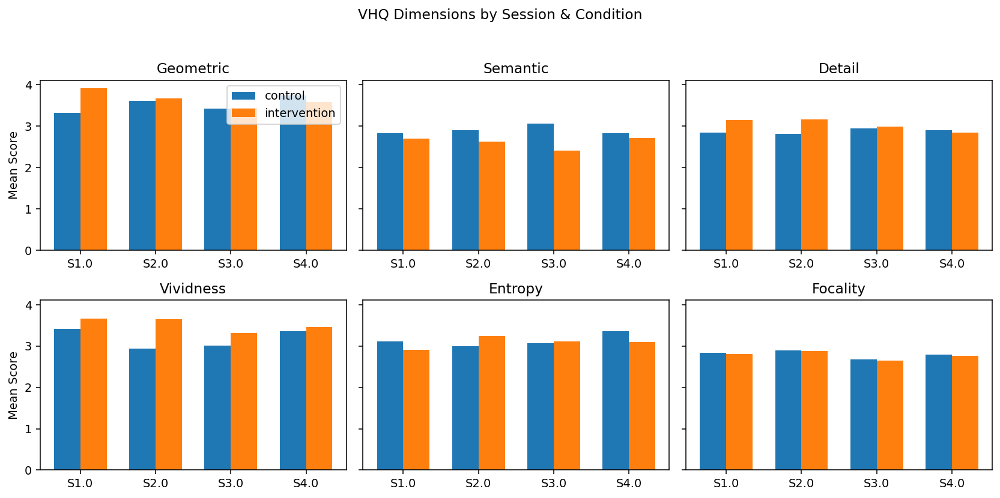

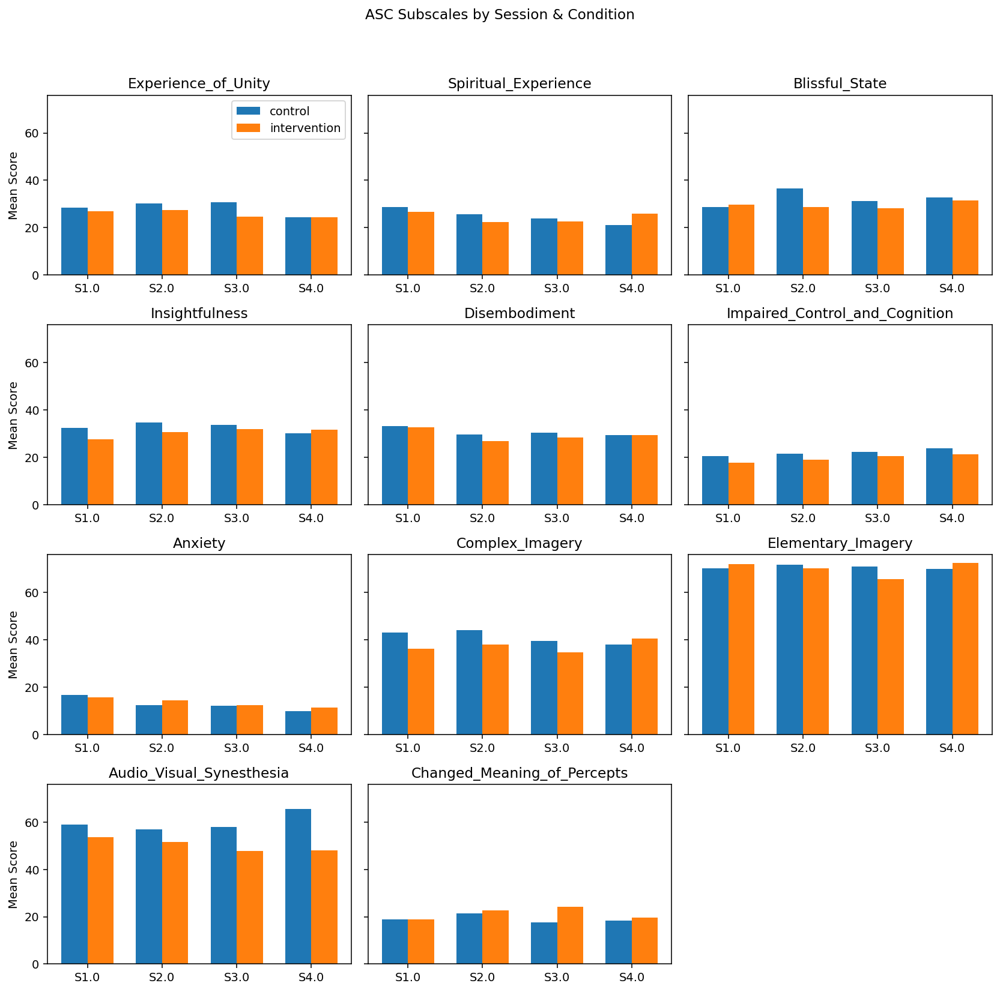

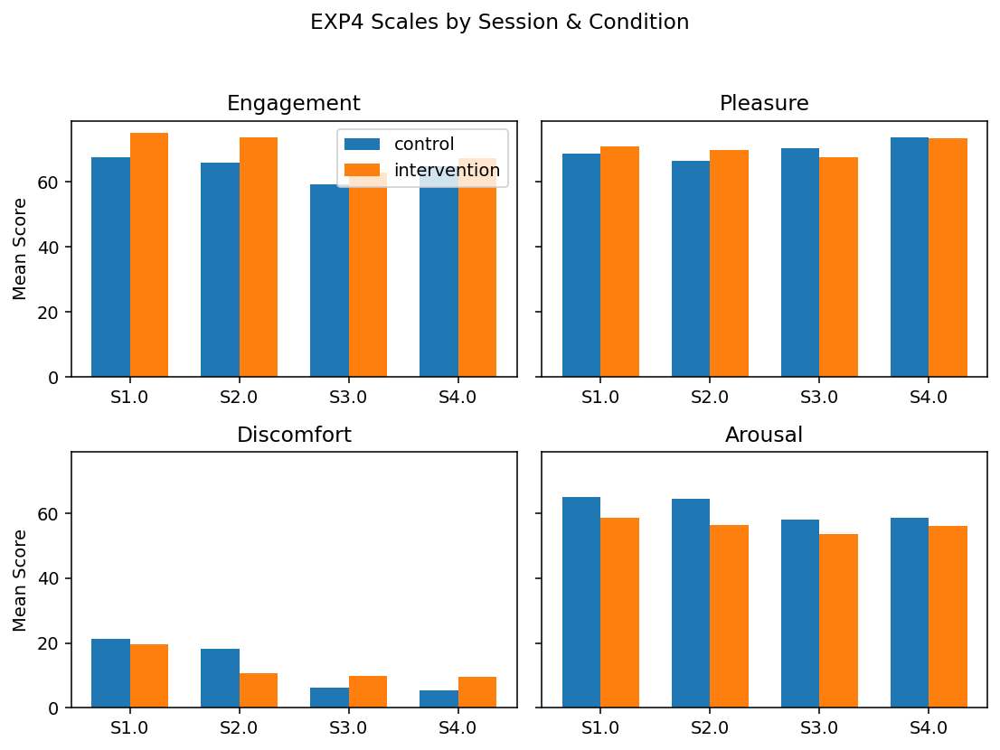

In [45]:
import matplotlib.pyplot as plt

# 1. Build the session×condition means table
session_cond = (
    df_scores
    .groupby(['session_n','condition'], as_index=False)
    .mean(numeric_only=True)
    .set_index(['session_n','condition'])
)

sessions = sorted(session_cond.index.get_level_values('session_n').unique())
conds    = sorted(session_cond.index.get_level_values('condition').unique())
width    = 0.35

# Helpers to pull out columns
vhq_cols   = [c for c in session_cond.columns if c.startswith('VHQ_')]
asc_cols   = [c for c in session_cond.columns if c.startswith('ASC_')]
exp4_cols  = [c for c in session_cond.columns if c.startswith('EXP4_')]

# Plotting function for one scale
def plot_scale(cols, prefix, rows, cols_per_row, title):
    labels = [c.replace(prefix, '') for c in cols]
    fig, axes = plt.subplots(rows, cols_per_row, figsize=(4*cols_per_row, 3*rows), sharey=True)
    axes_flat = axes.flatten()
    for idx, col in enumerate(cols):
        ax = axes_flat[idx]
        x = range(len(sessions))
        for i, cond in enumerate(conds):
            vals = [session_cond.loc[(s,cond), col] for s in sessions]
            ax.bar([pos + i*width for pos in x], vals, width, label=cond)
        ax.set_title(labels[idx])
        ax.set_xticks([pos + width*(len(conds)-1)/2 for pos in x])
        ax.set_xticklabels([f"S{s}" for s in sessions])
        if idx % cols_per_row == 0:
            ax.set_ylabel("Mean Score")
        if idx == 0:
            ax.legend()
    # Remove any empty subplots
    for j in range(len(cols), rows*cols_per_row):
        fig.delaxes(axes_flat[j])
    fig.suptitle(title)
    plt.tight_layout(rect=[0,0,1,0.95])

# 2x3 grid for the 6 VHQ dimensions
plot_scale(vhq_cols,  'VHQ_', 2, 3, "VHQ Dimensions by Session & Condition")

# 4x3 grid for the 11 ASC subscales
plot_scale(asc_cols,  'ASC_', 4, 3, "ASC Subscales by Session & Condition")

# 2x2 grid for the 4 EXP4 scales
plot_scale(exp4_cols, 'EXP4_', 2, 2, "EXP4 Scales by Session & Condition")

plt.show()

In [46]:
import pandas as pd
from scipy.stats import ttest_ind
from statsmodels.stats.anova import AnovaRM
from IPython.display import display

pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

# 1. Dimension columns
dim_cols = [c for c in df_scores.columns if c.startswith(('VHQ_','ASC_','EXP4_'))]

# 2. Independent t‑tests Control vs. Intervention (across all sessions)
part_means = (
    df_scores
    .groupby(['part_id','condition'])[dim_cols]
    .mean()
    .reset_index()
)
conds = sorted(part_means['condition'].unique())

t_results = []
for dim in dim_cols:
    g1 = part_means.loc[part_means['condition']==conds[0], dim]
    g2 = part_means.loc[part_means['condition']==conds[1], dim]
    t_stat, p_val = ttest_ind(g1, g2, nan_policy='omit')
    t_results.append({'Dimension': dim, 't_stat': t_stat, 'p_value': p_val})
t_results_df = pd.DataFrame(t_results)

print("### Independent t‑tests (Control vs. Intervention) ###")
display(t_results_df)

# 3. Filter to participants present in *all* sessions
n_sessions = df_scores['session_n'].nunique()
complete_ids = (
    df_scores
    .groupby('part_id')['session_n']
    .nunique()
    .loc[lambda s: s==n_sessions]
    .index
)
df_balanced = df_scores[df_scores['part_id'].isin(complete_ids)]

# 4. Repeated‑measures ANOVA Across Sessions
anova_results = []
for dim in dim_cols:
    aov = AnovaRM(df_balanced, depvar=dim, subject='part_id', within=['session_n']).fit()
    f_val = aov.anova_table.loc['session_n', 'F Value']
    p_val = aov.anova_table.loc['session_n', 'Pr > F']
    anova_results.append({'Dimension': dim, 'F_stat': f_val, 'p_value': p_val})
anova_df = pd.DataFrame(anova_results)

print("\n### Repeated‑measures ANOVA Across Sessions ###")
display(anova_df)

### Independent t‑tests (Control vs. Intervention) ###


,Dimension,t_stat,p_value
0,VHQ_Geometric,-0.419182,0.677272
1,VHQ_Semantic,0.984036,0.330478
2,VHQ_Detail,-0.924660,0.359674
3,VHQ_Vividness,-2.481080,0.016816
4,VHQ_Entropy,0.239688,0.811592
5,VHQ_Focality,0.985058,0.329435
6,ASC_Experience_of_Unity,0.425834,0.672094
7,ASC_Spiritual_Experience,0.257556,0.797828
8,ASC_Blissful_State,0.630670,0.531187
9,ASC_Insightfulness,0.390690,0.697720



### Repeated‑measures ANOVA Across Sessions ###


,Dimension,F_stat,p_value
0,VHQ_Geometric,NaN,NaN
1,VHQ_Semantic,NaN,NaN
2,VHQ_Detail,NaN,NaN
3,VHQ_Vividness,NaN,NaN
4,VHQ_Entropy,NaN,NaN
5,VHQ_Focality,NaN,NaN
6,ASC_Experience_of_Unity,1.890382,0.134303
7,ASC_Spiritual_Experience,1.102676,0.350496
8,ASC_Blissful_State,0.512155,0.674594
9,ASC_Insightfulness,0.677710,0.567184


In [47]:
import pandas as pd
from scipy.stats import ttest_ind, ttest_rel
from IPython.display import display

pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

# 1. Dimension columns
dim_cols = [c for c in df_scores.columns if c.startswith(('VHQ_','ASC_','EXP4_'))]

# 2. Independent t‑tests (Control vs. Intervention)
part_means = (
    df_scores
    .groupby(['part_id','condition'])[dim_cols]
    .mean()
    .reset_index()
)
conds = sorted(part_means['condition'].unique())

t_results = []
for dim in dim_cols:
    g1 = part_means.loc[part_means['condition']==conds[0], dim]
    g2 = part_means.loc[part_means['condition']==conds[1], dim]
    t_stat, p_val = ttest_ind(g1, g2, nan_policy='omit')
    t_results.append({'Dimension':dim, 't_stat':t_stat, 'p_value':p_val})
t_df = pd.DataFrame(t_results)

print("### Independent t‑tests Between Conditions ###")
display(t_df)

# 3. Paired t‑tests between consecutive sessions
#    Pivot so rows are part_id, cols are session_n
wide = df_scores.pivot(index='part_id', columns='session_n', values=dim_cols)

paired_results = []
for dim in dim_cols:
    for s1, s2 in [(1,2),(2,3),(3,4)]:
        # drop any NaNs in the pair
        a = wide[dim][s1]
        b = wide[dim][s2]
        mask = a.notna() & b.notna()
        t_stat, p_val = ttest_rel(a[mask], b[mask])
        paired_results.append({
            'Dimension': dim,
            'Comparison': f'S{s1} vs. S{s2}',
            't_stat': t_stat,
            'p_value': p_val
        })

paired_df = pd.DataFrame(paired_results)
print("\n### Paired t‑tests Between Sessions ###")
display(paired_df)

### Independent t‑tests Between Conditions ###


,Dimension,t_stat,p_value
0,VHQ_Geometric,-0.419182,0.677272
1,VHQ_Semantic,0.984036,0.330478
2,VHQ_Detail,-0.924660,0.359674
3,VHQ_Vividness,-2.481080,0.016816
4,VHQ_Entropy,0.239688,0.811592
5,VHQ_Focality,0.985058,0.329435
6,ASC_Experience_of_Unity,0.425834,0.672094
7,ASC_Spiritual_Experience,0.257556,0.797828
8,ASC_Blissful_State,0.630670,0.531187
9,ASC_Insightfulness,0.390690,0.697720



### Paired t‑tests Between Sessions ###


,Dimension,Comparison,t_stat,p_value
0,VHQ_Geometric,S1 vs. S2,0.722965,0.480137
1,VHQ_Geometric,S2 vs. S3,-0.400633,0.693160
2,VHQ_Geometric,S3 vs. S4,-0.902456,0.374513
3,VHQ_Semantic,S1 vs. S2,0.609798,0.547289
4,VHQ_Semantic,S2 vs. S3,0.575356,0.570406
5,VHQ_Semantic,S3 vs. S4,-0.162655,0.872345
6,VHQ_Detail,S1 vs. S2,0.356747,0.722949
7,VHQ_Detail,S2 vs. S3,0.239018,0.812282
8,VHQ_Detail,S3 vs. S4,1.347469,0.186249
9,VHQ_Vividness,S1 vs. S2,1.942110,0.059766


Loaded 'pre_session_1' from wp2_pre_session_1_October 17, 2025_09.03.csv
Loaded 'pre_sessions_2-4' from wp2_pre_sessions_2-4_October 17, 2025_09.42.csv
Loaded 'post_sessions_1-3' from wp2_post_sessions_1-3_October 17, 2025_09.42.csv
Loaded 'post_session_4' from wp2_post_session_4_October 17, 2025_09.43.csv
Loaded 'sms_day1,3,5' from wp2_sms_day1,3,5_October 17, 2025_09.42.csv
Trimmed df_sms.part_id
Loaded 'sms_post' from wp2_sms_post_October 17, 2025_09.42.csv
Loaded 'wp2_assignments' from wp2_assignments.csv
Loaded 'post_sessions_1-3' from wp2_post_sessions_1-3_October 17, 2025_09.42.csv
Loaded 'post_session_4' from wp2_post_session_4_October 17, 2025_09.43.csv


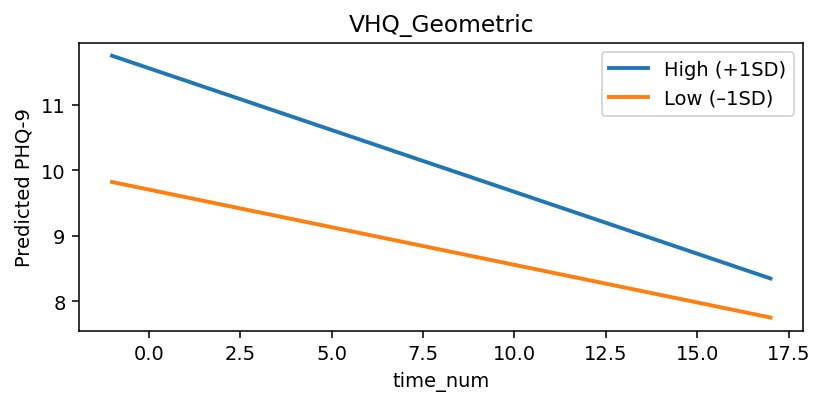

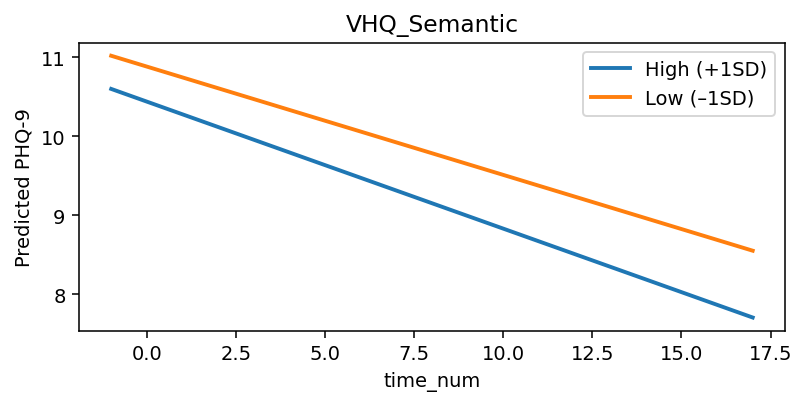

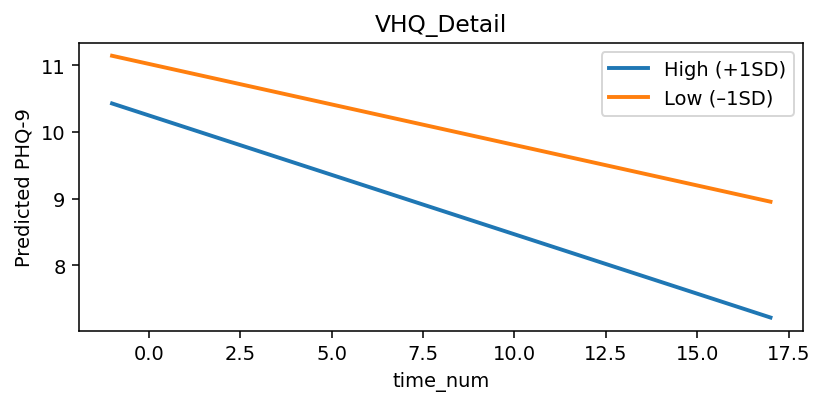

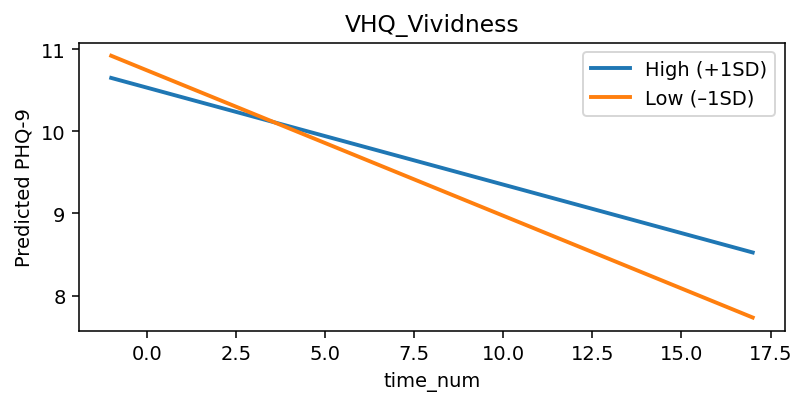

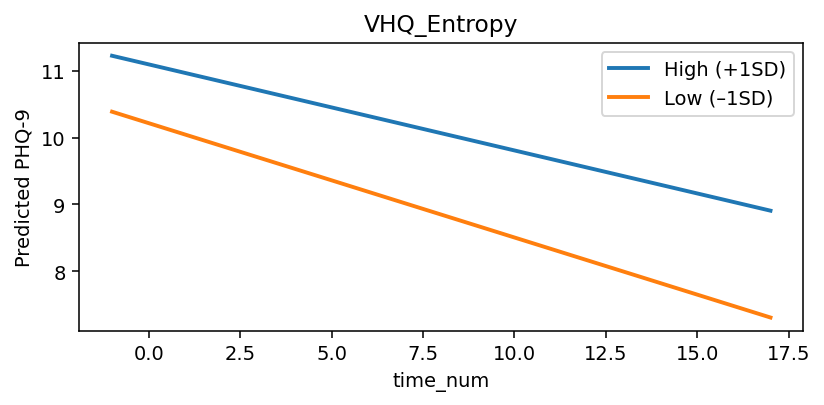

...

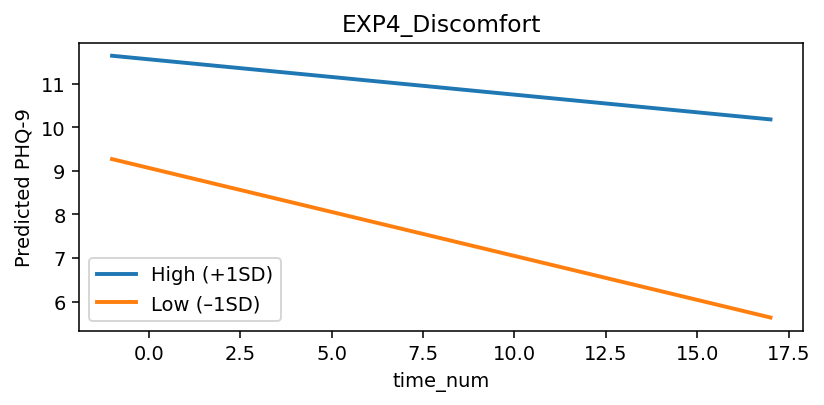

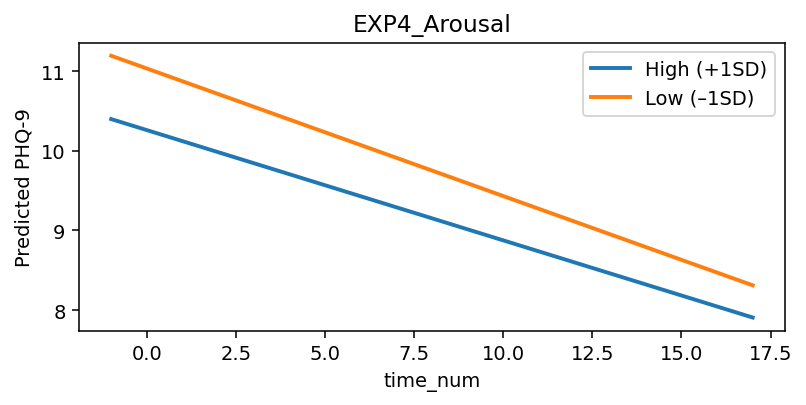

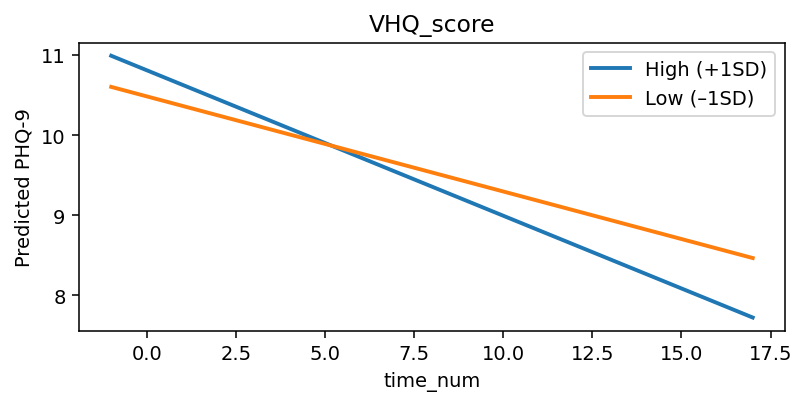

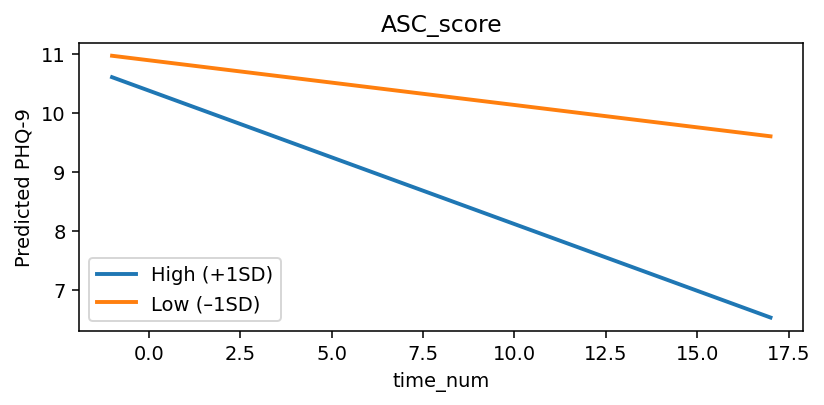

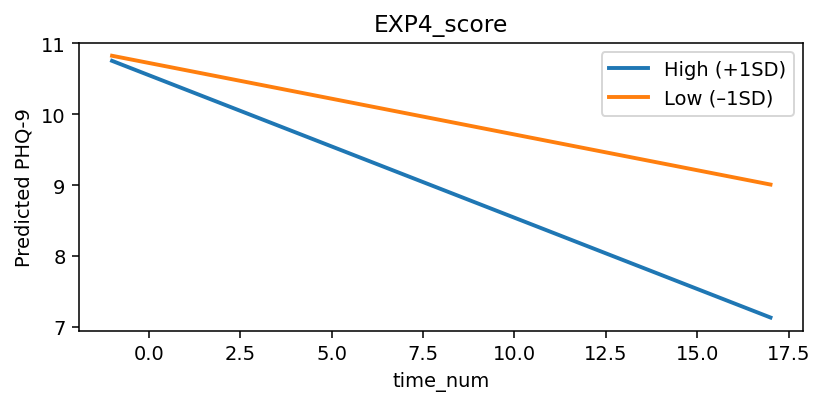


Moderator × Time effects:

                         Moderator      Coef  p-value
                     VHQ_Geometric -0.056058 0.092132
                      VHQ_Semantic -0.014037 0.617434
                        VHQ_Detail -0.034038 0.238788
                     VHQ_Vividness  0.043847 0.215692
                       VHQ_Entropy  0.025953 0.391544
                      VHQ_Focality -0.120783 0.010615
           ASC_Experience_of_Unity -0.003446 0.000592
          ASC_Spiritual_Experience -0.002698 0.032597
                ASC_Blissful_State -0.002356 0.014730
                ASC_Insightfulness -0.003804 0.000182
                 ASC_Disembodiment -0.002858 0.002140
ASC_Impaired_Control_and_Cognition -0.003425 0.060443
                       ASC_Anxiety  0.002285 0.240166
               ASC_Complex_Imagery -0.001896 0.178148
            ASC_Elementary_Imagery -0.001500 0.189804
      ASC_Audio_Visual_Synesthesia -0.002792 0.002751
   ASC_Changed_Meaning_of_Percepts -0.003577 0.003482


,Moderator,Coef,p-value
0,VHQ_Geometric,-0.056058,0.092132
1,VHQ_Semantic,-0.014037,0.617434
2,VHQ_Detail,-0.034038,0.238788
3,VHQ_Vividness,0.043847,0.215692
4,VHQ_Entropy,0.025953,0.391544
5,VHQ_Focality,-0.120783,0.010615
6,ASC_Experience_of_Unity,-0.003446,0.000592
7,ASC_Spiritual_Experience,-0.002698,0.032597
8,ASC_Blissful_State,-0.002356,0.014730
9,ASC_Insightfulness,-0.003804,0.000182


In [48]:
import re
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import statsmodels.formula.api as smf
from pathlib import Path
from IPython.display import display

# ─── 0) SETTINGS ──────────────────────────────────────────────────────────
DATA_DIR = Path('/content')

# ─── 1) CSV LOADER UTILITIES ──────────────────────────────────────────────
def find_csv(substring: str) -> Path:
    matches = list(DATA_DIR.glob(f'*{substring}*.csv'))
    if not matches:
        raise FileNotFoundError(f"No file matching '{substring}' in {DATA_DIR}")
    if len(matches) > 1:
        raise ValueError(f"Multiple files match '{substring}': {matches}")
    return matches[0]

def try_load(substring: str) -> pd.DataFrame | None:
    try:
        p = find_csv(substring)
    except (FileNotFoundError, ValueError) as e:
        print(f"Skipping '{substring}': {e}")
        return None
    print(f"Loaded '{substring}' from {p.name}")
    return pd.read_csv(p, dtype=str)

# ─── 2) LOAD WELLBEING & SMS CSVs ─────────────────────────────────────────
df_s1_pre     = try_load('pre_session_1')
df_s2to4_pre  = try_load('pre_sessions_2-4')
df_s2to4_post = try_load('post_sessions_1-3')
df_s4_post    = try_load('post_session_4')
df_sms        = try_load('sms_day1,3,5')
if df_sms is not None:
    df_sms['part_id'] = df_sms['part_id'].astype(str).str.strip().str[:5]
    print("Trimmed df_sms.part_id")
df_final      = try_load('sms_post')

all_wb = [df for df in (df_s1_pre, df_s2to4_pre, df_s2to4_post, df_s4_post, df_sms, df_final) if df is not None]
if not all_wb:
    raise RuntimeError("No wellbeing/SMS files found")

# ─── 3) CLEAN & SUM SCALES ────────────────────────────────────────────────
def sum_scale(df, cols, out):
    df[cols] = df[cols].apply(pd.to_numeric, errors='coerce')
    df[out]  = df[cols].sum(axis=1)

def get_scale_cols(df, prefix, n, allow_suffix=False):
    cols=[]
    for i in range(1, n+1):
        m,a = f"{prefix}_{i}", f"{prefix}_{i}_1"
        if m in df.columns: cols.append(m)
        elif allow_suffix and a in df.columns: cols.append(a)
    return cols

for df in all_wb:
    df.columns = df.columns.str.strip()
    # BDI items
    for c in df.columns:
        if re.fullmatch(r"bdi_\d+(?:_1)?", c):
            df[c] = pd.to_numeric(df[c].astype(str).str.extract(r"^(\d+)")[0], errors='coerce')
    # sum BAI, BDI, MADRS
    for pref,cnt,suf,out in [
        ('bai',21,False,'bai_sum'),
        ('bdi',21,False,'bdi_sum'),
        ('madrs',9, True,'MADRS_S_sum')
    ]:
        cols = get_scale_cols(df, pref, cnt, allow_suffix=suf)
        if cols:
            sum_scale(df, cols, out)
    # standardize m3vas
    for var in ('mood','pleasure','suicidal'):
        raw = next((c for c in df if re.fullmatch(f"m3vas_{var}(?:_1)?", c)), None)
        ch  = next((c for c in df if re.fullmatch(f"m3vas_ch_{var}(?:_1)?", c)), None)
        if var=='suicidal':
            if raw: df['m3vas_suicidal'] = pd.to_numeric(df[raw], errors='coerce') - 50
            elif ch: df['m3vas_suicidal'] = pd.to_numeric(df[ch], errors='coerce') - 50
        else:
            if raw: df[f"m3vas_{var}"] = 50 - pd.to_numeric(df[raw], errors='coerce')
            elif ch: df[f"m3vas_{var}"] = pd.to_numeric(df[ch], errors='coerce') - 50
    df.drop(columns=[c for c in df if re.fullmatch(r"m3vas_(?:ch_)?(?:mood|pleasure|suicidal)(?:_1)?",c)],
            errors='ignore', inplace=True)
    # fisber
    for c in ('fisber_1','fisber_2','fisber_3'):
        if c in df.columns:
            df[c] = pd.to_numeric(df[c].astype(str).str.extract(r"(\d+)$")[0], errors='coerce')
    # other numeric
    for c in ['phq9_sum','spane_p','spane_n',
              'm3vas_mood','m3vas_pleasure','m3vas_suicidal',
              'fisber_1','fisber_2','fisber_3',
              'bai_sum','bdi_sum','MADRS_S_sum']:
        if c in df.columns:
            df[c] = pd.to_numeric(df[c], errors='coerce')

# ─── 4) TAG & BUILD df_model ─────────────────────────────────────────────
for df in all_wb:
    if 'part_id' not in df.columns and 'ProlificID' in df.columns:
        df.rename(columns={'ProlificID':'part_id'}, inplace=True)
    df['part_id'] = df['part_id'].astype(str).str.strip()

if df_s1_pre     is not None: df_s1_pre['timepoint']     = 'session1_pre'
if df_s2to4_pre  is not None: df_s2to4_pre ['timepoint'] = df_s2to4_pre.apply(lambda r: f"session{r.session_n}_pre", axis=1)
if df_s2to4_post is not None: df_s2to4_post['timepoint'] = df_s2to4_post.apply(lambda r: f"session{r.session_n}_post",axis=1)
if df_s4_post    is not None: df_s4_post   ['timepoint'] = 'session4_post'
if df_sms        is not None: df_sms       ['timepoint'] = df_sms.apply(lambda r: f"SMS_{r.session_n}_{r.sms_n}",axis=1)
if df_final      is not None: df_final     ['timepoint'] = 'final_post'

df_long = pd.concat(all_wb, ignore_index=True)
df_long = df_long[df_long['part_id'].str.match(r'^\d+$', na=False)].copy()

df_assign = try_load('wp2_assignments')
if df_assign is not None:
    df_long = df_long.merge(df_assign[['part_id','condition']],
                            on='part_id', how='left')

ordered = [
    'session1_pre','session1_post',
    'SMS_1_1','SMS_1_2','SMS_1_3',
    'session2_pre','session2_post',
    'SMS_2_1','SMS_2_2','SMS_2_3',
    'session3_pre','session3_post',
    'SMS_3_1','SMS_3_2','SMS_3_3',
    'session4_pre','session4_post',
    'final_post'
]
df_long['timepoint'] = pd.Categorical(df_long['timepoint'], categories=ordered, ordered=True)
df_long['time_num']  = df_long['timepoint'].cat.codes
df_model = df_long.loc[~df_long['timepoint'].astype(str).str.match(r'^session\d+_post$')].copy()
df_model['tc'] = df_model['time_num'] - df_model['time_num'].mean()
df_model = df_model.dropna(subset=['phq9_sum','tc']).reset_index(drop=True)

# ─── 5) DEFINE VHQ, EXP4 & ASC_11D ───────────────────────────────────────
VHQ_DEFS = {
    "Geometric": ['6d_vhq_1','6d_vhq_2','6d_vhq_3'],
    "Semantic":  ['6d_vhq_4','6d_vhq_5','6d_vhq_6'],
    "Detail":    ['6d_vhq_7','6d_vhq_8','6d_vhq_9'],
    "Vividness": ['6d_vhq_10','6d_vhq_11','6d_vhq_12'],
    "Entropy":   ['6d_vhq_13','6d_vhq_14','6d_vhq_15'],
    "Focality":  ['6d_vhq_16','6d_vhq_17','6d_vhq_18'],
}
EXP4_DEFS = ['exp4_engagement_1','exp4_pleasure_1','exp4_discomfort_1','exp4_arousal_1']

asc_defs = {
    "Experience_of_Unity": [
        'asc_18_4','asc_34_4','asc_41_4','asc_42_4','asc_52_4'
    ],
    "Spiritual_Experience": [
        'asc_9_4','asc_81_4','asc_94_4'
    ],
    "Blissful_State": [
        'asc_12_4','asc_86_4','asc_91_4'
    ],
    "Insightfulness": [
        'asc_50_4','asc_69_4','asc_77_4'      # asc_72_4 is Visionary, not Insight
    ],
    "Disembodiment": [
        'asc_26_4','asc_62_4','asc_63_4'
    ],
    "Impaired_Control_and_Cognition": [
        'asc_8_4','asc_27_4','asc_38_4','asc_47_4','asc_64_4','asc_67_4','asc_78_4'
    ],
    "Anxiety": [
        'asc_32_4','asc_43_4','asc_44_4','asc_46_4','asc_56_4','asc_89_4'
    ],
    "Complex_Imagery": [
        'asc_39_4','asc_72_4','asc_82_4'
    ],
    "Elementary_Imagery": [
        'asc_14_4','asc_22_4','asc_33_4'
    ],
    "Audio_Visual_Synesthesia": [
        'asc_20_4','asc_23_4','asc_75_4'
    ],
    "Changed_Meaning_of_Percepts": [
        'asc_28_4','asc_31_4','asc_54_4'
    ]
}

# ─── 6) LOAD ITEMS & COMPUTE MODERATORS ─────────────────────────────────
import re
import numpy as np

df_it1 = try_load('post_sessions_1-3')
df_it2 = try_load('post_session_4')
df_it1 = df_it1.iloc[1:].copy() if df_it1 is not None else pd.DataFrame()
df_it2 = df_it2.iloc[1:].copy() if df_it2 is not None else pd.DataFrame()
if not df_it2.empty:
    df_it2['session_n'] = 4

df_items = pd.concat([df_it1, df_it2], ignore_index=True)
df_items['part_id'] = df_items['part_id'].astype(str)

def extract_num(x):
    m = re.search(r'(\d+)$', str(x).strip())
    return float(m.group(1)) if m else np.nan

# numeric conversion for all item cols
for col in sum(VHQ_DEFS.values(), []) + sum(asc_defs.values(), []) + EXP4_DEFS:
    if col in df_items.columns:
        df_items[col] = df_items[col].apply(extract_num)

# ─── 6.1) REVERSE‑CODE VIVIDNESS ITEMS (1–5 scale) ─────────────────────────
# (max + min = 5 + 1 = 6)
for col in VHQ_DEFS['Vividness']:
    if col in df_items.columns:
        df_items[col] = 6 - df_items[col]

# now compute your per‑participant moderators
records = []
for (pid, sess), grp in df_items.groupby(['part_id', 'session_n']):
    rec = {'part_id': pid}
    # VHQ subscales (using reversed vividness)
    for nm, cols in VHQ_DEFS.items():
        present = [c for c in cols if c in grp]
        rec[f'VHQ_{nm}'] = grp[present].mean(axis=1).mean() if present else np.nan
    # ASC 11D subscales
    for nm, cols in asc_defs.items():
        present = [c for c in cols if c in grp]
        rec[f'ASC_{nm}'] = grp[present].mean(axis=1).mean() if present else np.nan
    # EXP4 scales
    for col in EXP4_DEFS:
        if col in grp:
            key = col.replace('exp4_', '').replace('_1', '').capitalize()
            rec[f'EXP4_{key}'] = grp[col].mean()
        else:
            rec[f'EXP4_{col}'] = np.nan
    records.append(rec)

df_scores = pd.DataFrame(records)

# aggregate across sessions to get participant‑level moderators
df_partmods = df_scores.groupby('part_id').mean(numeric_only=True).reset_index()
df_partmods['VHQ_score']  = df_partmods.filter(like='VHQ_').mean(axis=1)
df_partmods['ASC_score']  = df_partmods.filter(like='ASC_').mean(axis=1)
df_partmods['EXP4_score'] = df_partmods.filter(like='EXP4_').mean(axis=1)

# ─── 7) MERGE & FIT MODELS ───────────────────────────────────────────────
df_model = df_model.merge(df_partmods, on='part_id', how='left')
results=[]

mods = [c for c in df_partmods.columns if c!='part_id']
for mod in mods:
    sub = df_model.dropna(subset=[mod]).copy()
    if sub.empty:
        results.append((mod,np.nan,np.nan)); continue
    sub[f'{mod}_c'] = sub[mod] - sub[mod].mean()
    sd = sub[mod].std()
    try:
        mdl = smf.mixedlm(f"phq9_sum ~ tc * {mod}_c", sub,
                          groups='part_id', re_formula='~1')
        res = mdl.fit(method='lbfgs', reml=True)
    except Exception as e:
        print(f"Skipping {mod}: {e}")
        results.append((mod,np.nan,np.nan)); continue
    coef = res.params.get(f'tc:{mod}_c',np.nan)
    pval = res.pvalues.get(f'tc:{mod}_c',np.nan)
    results.append((mod,coef,pval))
    # plot ±1SD
    tvals = sorted(sub['time_num'].unique()); mt=sub['time_num'].mean()
    grid = pd.DataFrame({
        'time_num': np.tile(tvals,2),
        'tc':        np.tile(tvals-mt,2),
        f'{mod}_c':  np.repeat([sd,-sd],len(tvals)),
        'part_id':   sub['part_id'].iloc[0]
    })
    grid['pred']=res.predict(grid)
    plt.figure(figsize=(6,3))
    for val,lbl,col in zip([sd,-sd],['High (+1SD)','Low (–1SD)'],['tab:blue','tab:orange']):
        d=grid[grid[f'{mod}_c']==val]
        plt.plot(d['time_num'],d['pred'],color=col,lw=2,label=lbl)
    plt.title(mod); plt.xlabel("time_num"); plt.ylabel("Predicted PHQ‑9")
    plt.legend(); plt.tight_layout(); plt.show()

# ─── 8) DISPLAY RESULTS ──────────────────────────────────────────────────
df_results=pd.DataFrame(results,columns=['Moderator','Coef','p-value'])
print("\nModerator × Time effects:\n"); print(df_results.to_string(index=False))
print("\nFormatted:"); display(df_results)

In [49]:
# — assume df_results exists with columns ['Moderator','Coef','p-value']

# 1) filter for p < .05
sig_df = df_results[df_results['p-value'] < 0.05].copy()

# 2) sort by p‑value (optional)
sig_df = sig_df.sort_values('p-value')

# 3) round for readability
sig_df['Coef']    = sig_df['Coef'].round(4)
sig_df['p-value'] = sig_df['p-value'].round(4)

# 4) display
print("Significant Moderator × Time interactions (p < .05):")
print(sig_df.to_string(index=False))

Significant Moderator × Time interactions (p < .05):
                      Moderator    Coef  p-value
             ASC_Insightfulness -0.0038   0.0002
        ASC_Experience_of_Unity -0.0034   0.0006
                      ASC_score -0.0049   0.0014
                  EXP4_Pleasure -0.0037   0.0019
              ASC_Disembodiment -0.0029   0.0021
   ASC_Audio_Visual_Synesthesia -0.0028   0.0028
ASC_Changed_Meaning_of_Percepts -0.0036   0.0035
                   VHQ_Focality -0.1208   0.0106
             ASC_Blissful_State -0.0024   0.0147
                EXP4_Engagement -0.0027   0.0225
                EXP4_Discomfort  0.0045   0.0256
       ASC_Spiritual_Experience -0.0027   0.0326
                     EXP4_score -0.0053   0.0370


In [50]:
# assuming df_partmods and df_results exist:
sd = df_partmods.set_index('part_id').std()
per_sd = []
for mod, coef, p in df_results.itertuples(index=False):
    # skip non‑numeric or p>=.05 if you like
    if mod in sd.index:
        per_sd.append((mod, coef * sd[mod]))
per_sd_df = pd.DataFrame(per_sd, columns=['Moderator','Coef_per_1SD'])
print(per_sd_df.round(4))

                             Moderator  Coef_per_1SD
0                        VHQ_Geometric       -0.0397
1                         VHQ_Semantic       -0.0134
2                           VHQ_Detail       -0.0284
3                        VHQ_Vividness        0.0293
4                          VHQ_Entropy        0.0215
5                         VHQ_Focality       -0.0616
6              ASC_Experience_of_Unity       -0.0796
7             ASC_Spiritual_Experience       -0.0512
8                   ASC_Blissful_State       -0.0557
9                   ASC_Insightfulness       -0.0893
10                   ASC_Disembodiment       -0.0706
11  ASC_Impaired_Control_and_Cognition       -0.0459
12                         ASC_Anxiety        0.0281
13                 ASC_Complex_Imagery       -0.0354
14              ASC_Elementary_Imagery       -0.0308
15        ASC_Audio_Visual_Synesthesia       -0.0781
16     ASC_Changed_Meaning_of_Percepts       -0.0683
17                     EXP4_Engagement       -

In [51]:
import numpy as np
import pandas as pd
from scipy import stats

# 1) Reload or reuse your assignments file to get each part_id→condition
assign = pd.read_csv('/content/wp2_assignments.csv', dtype=str)
assign = assign[['part_id','condition']]

# 2) Merge condition into df_partmods
df_comp = df_partmods.merge(assign, on='part_id', how='left')

# 3) Define which composites to test
cols = ['VHQ_score','ASC_score','EXP4_score']
df_comp = df_comp.dropna(subset=cols + ['condition'])

# 4) Run Welch’s t‑tests
results = []
for col in cols:
    ctrl = df_comp.loc[df_comp['condition']=='control', col]
    intv = df_comp.loc[df_comp['condition']=='intervention', col]
    tstat, pval = stats.ttest_ind(ctrl, intv, equal_var=False, nan_policy='omit')
    results.append({
        'Composite':            col,
        'Control Mean (SD)':    f"{ctrl.mean():.2f} ({ctrl.std():.2f})",
        'Intervention Mean (SD)': f"{intv.mean():.2f} ({intv.std():.2f})",
        't‑stat':               f"{tstat:.2f}",
        'p‑value':              f"{pval:.3f}"
    })

# 5) Display results
res_df = pd.DataFrame(results)
print("Group Comparisons of Composite Scores by Condition (Welch’s t‑test):")
print(res_df.to_string(index=False))

Group Comparisons of Composite Scores by Condition (Welch’s t‑test):
 Composite Control Mean (SD) Intervention Mean (SD) t‑stat p‑value
 VHQ_score       3.10 (0.24)            3.19 (0.36)  -1.11   0.272
 ASC_score     33.73 (10.89)          32.40 (16.61)   0.34   0.732
EXP4_score      52.48 (7.00)          53.17 (11.60)  -0.27   0.792


In [52]:
import numpy as np
import pandas as pd
import statsmodels.formula.api as smf

# ─── 1) DEFINE & ALIGN MODERATOR NAMES ───────────────────────────────────
# VHQ keys (already uppercase)
vhq_mods  = [f"VHQ_{nm}" for nm in VHQ_DEFS.keys()]
# ASC keys
asc_mods  = [f"ASC_{nm}" for nm in asc_defs.keys()]
# EXP4 keys: strip both prefix and trailing '_1', then title‑case
exp4_mods = [f"EXP4_{col.replace('exp4_','').replace('_1','').capitalize()}"
             for col in EXP4_DEFS]
# Composite scores
comp_mods = ['VHQ_score','ASC_score','EXP4_score']

moderators = vhq_mods + asc_mods + exp4_mods + comp_mods

# ─── 2) CENTER EACH MODERATOR ─────────────────────────────────────────────
for mod in moderators:
    df_model[f"{mod}_c"] = df_model[mod] - df_model[mod].mean()

# ─── 3) LOOP & FIT 3‑WAY MODELS ───────────────────────────────────────────
results = []
for mod in moderators:
    formula = f"phq9_sum ~ tc * condition * {mod}_c"
    sub = df_model.dropna(subset=[f"{mod}_c",'phq9_sum','tc','condition'])
    try:
        m3 = smf.mixedlm(
            formula,
            data=sub,
            groups='part_id',
            re_formula='~1'
        ).fit(method='lbfgs')
        coef = m3.params.get(f"tc:condition[T.intervention]:{mod}_c", np.nan)
        pval = m3.pvalues.get(f"tc:condition[T.intervention]:{mod}_c", np.nan)
    except Exception:
        coef, pval = np.nan, np.nan
    results.append({'Moderator':mod,'3way_Coef':coef,'3way_p':pval})

# ─── 4) SUMMARIZE ─────────────────────────────────────────────────────────
res_df = pd.DataFrame(results)
res_df = res_df.sort_values('3way_p').reset_index(drop=True)
res_df[['3way_Coef','3way_p']] = res_df[['3way_Coef','3way_p']].round(4)

print("Three‑Way (tc × condition × moderator) Interaction Results:\n")
print(res_df.to_string(index=False))

Three‑Way (tc × condition × moderator) Interaction Results:

                         Moderator  3way_Coef  3way_p
                     VHQ_Vividness     0.2401  0.0006
                      VHQ_Semantic    -0.1497  0.0061
                      EXP4_Arousal    -0.0046  0.0373
                      VHQ_Focality    -0.1941  0.0433
          ASC_Spiritual_Experience    -0.0042  0.0970
                       ASC_Anxiety    -0.0072  0.1166
   ASC_Changed_Meaning_of_Percepts    -0.0039  0.1458
                       VHQ_Entropy    -0.0701  0.2730
                        EXP4_score    -0.0051  0.4025
                     VHQ_Geometric     0.0490  0.5158
            ASC_Elementary_Imagery     0.0013  0.5780
                 ASC_Disembodiment    -0.0011  0.5840
           ASC_Experience_of_Unity    -0.0011  0.6189
                   EXP4_Discomfort    -0.0015  0.7258
ASC_Impaired_Control_and_Cognition    -0.0012  0.7786
                         VHQ_score     0.0463  0.7907
      ASC_Audio_Visua

VHQ_score ↔ ASC_score:  r = 0.32, p = 0.014


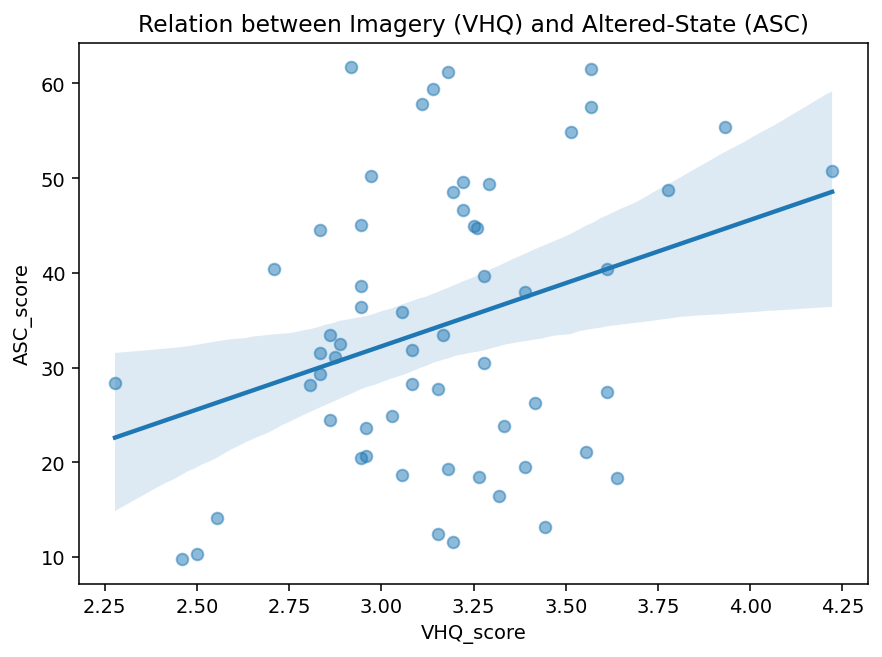

In [53]:
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import pearsonr

# 1a) Correlation between composites
r, p = pearsonr(df_partmods['VHQ_score'].dropna(), df_partmods['ASC_score'].dropna())
print(f"VHQ_score ↔ ASC_score:  r = {r:.2f}, p = {p:.3f}")

# 1b) Scatterplot
sns.regplot(x='VHQ_score', y='ASC_score', data=df_partmods, scatter_kws={'alpha':0.5})
plt.xlabel("VHQ_score")
plt.ylabel("ASC_score")
plt.title("Relation between Imagery (VHQ) and Altered‑State (ASC)")
plt.tight_layout()
plt.show()

In [54]:
import pandas as pd
import statsmodels.formula.api as smf

# 1) Read in assignments & merge
assign = pd.read_csv('/content/wp2_assignments.csv', dtype=str)[['part_id','condition']]
df_pm  = df_partmods.merge(assign, on='part_id', how='left')

# 2) Center composites
df_pm['VHQ_c'] = df_pm['VHQ_score'] - df_pm['VHQ_score'].mean()
df_pm['ASC_c'] = df_pm['ASC_score'] - df_pm['ASC_score'].mean()

# 3) Drop missing
d = df_pm.dropna(subset=['VHQ_c','ASC_c','condition'])

# 4) Fit OLS: does imagery (VHQ) predict ASC, and does that differ by condition?
m = smf.ols("ASC_c ~ VHQ_c * condition", data=d).fit()
print(m.summary())

                            OLS Regression Results                            
Dep. Variable:                  ASC_c   R-squared:                       0.158
Model:                            OLS   Adj. R-squared:                  0.104
Method:                 Least Squares   F-statistic:                     2.933
Date:                Fri, 17 Oct 2025   Prob (F-statistic):             0.0430
Time:                        08:52:41   Log-Likelihood:                -203.58
No. Observations:                  51   AIC:                             415.2
Df Residuals:                      47   BIC:                             422.9
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                                      coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------------------
Intercept 

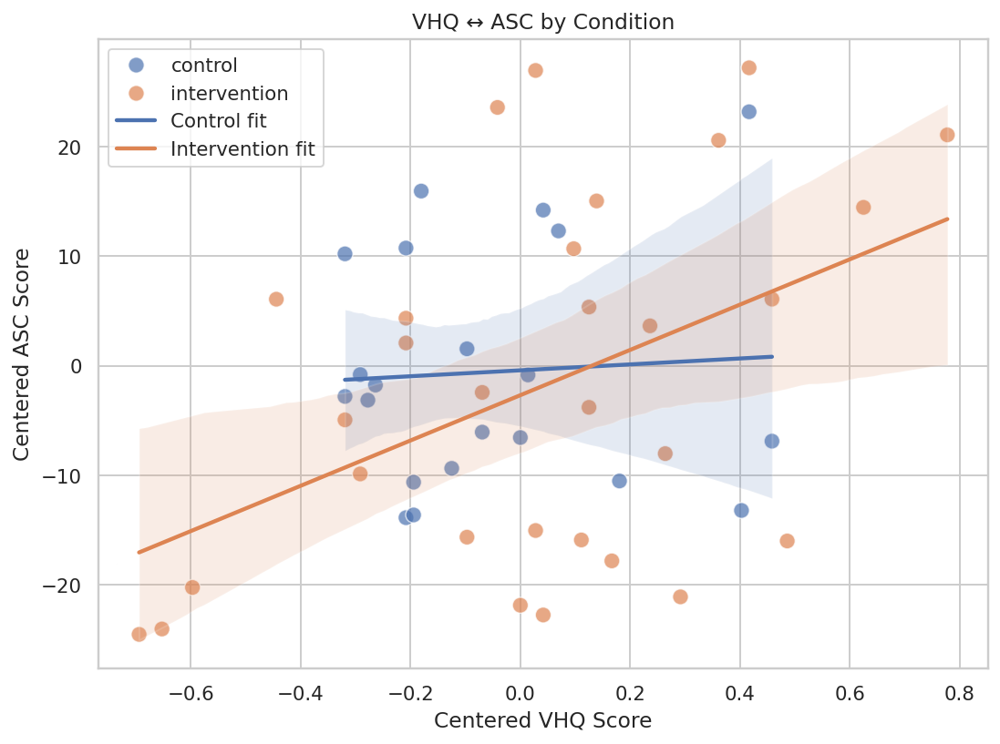

In [55]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# 1) Merge in condition
assign = pd.read_csv('/content/wp2_assignments.csv', dtype=str)[['part_id','condition']]
df_pm = df_partmods.merge(assign, on='part_id', how='left')

# 2) Center composites
df_pm['VHQ_c'] = df_pm['VHQ_score'] - df_pm['VHQ_score'].mean()
df_pm['ASC_c'] = df_pm['ASC_score'] - df_pm['ASC_score'].mean()

# 3) Drop missing
plot_df = df_pm.dropna(subset=['VHQ_c','ASC_c','condition'])

# 4) Plot
sns.set(style="whitegrid")
plt.figure(figsize=(8,6))
# raw points
sns.scatterplot(
    data=plot_df,
    x='VHQ_c', y='ASC_c',
    hue='condition', palette='deep', s=80, alpha=0.7
)
# control fit
sns.regplot(
    data=plot_df[plot_df['condition']=='control'],
    x='VHQ_c', y='ASC_c',
    scatter=False, label='Control fit',
    color=sns.color_palette('deep')[0]
)
# intervention fit
sns.regplot(
    data=plot_df[plot_df['condition']=='intervention'],
    x='VHQ_c', y='ASC_c',
    scatter=False, label='Intervention fit',
    color=sns.color_palette('deep')[1]
)
plt.xlabel("Centered VHQ Score")
plt.ylabel("Centered ASC Score")
plt.title("VHQ ↔ ASC by Condition")
plt.legend()
plt.tight_layout()
plt.show()

In [56]:
import numpy as np
import pandas as pd
import statsmodels.api as sm
from scipy.stats import norm

# 1) Estimate each participant’s PHQ‑9 slope via OLS of phq9_sum ~ time_num
slopes = []
for pid, grp in df_model.groupby('part_id'):
    if grp['time_num'].nunique() < 2:
        continue
    X = sm.add_constant(grp['time_num'])
    ols = sm.OLS(grp['phq9_sum'], X).fit()
    slopes.append({'part_id': pid, 'phq_slope': ols.params['time_num']})
df_slopes = pd.DataFrame(slopes)

# 2) Merge in mediator (ASC_score) and condition
assign    = pd.read_csv('/content/wp2_assignments.csv', dtype=str)[['part_id','condition']]
df_med    = df_slopes.merge(df_partmods[['part_id','ASC_score']], on='part_id')
df_med    = df_med.merge(assign, on='part_id')
df_med['cond_num'] = (df_med['condition']=='intervention').astype(int)

# 3) Path a: condition → mediator
Ma = sm.OLS(df_med['ASC_score'], sm.add_constant(df_med['cond_num'])).fit()
a_coef, sa = Ma.params['cond_num'], Ma.bse['cond_num']

# 4) Path b (+ c′): slope ~ mediator + condition
Mb = sm.OLS(df_med['phq_slope'],
            sm.add_constant(df_med[['ASC_score','cond_num']])
           ).fit()
b_coef, sb = Mb.params['ASC_score'], Mb.bse['ASC_score']
cprime, sc = Mb.params['cond_num'], Mb.bse['cond_num']

# 5) Sobel test (indirect = a*b)
indirect = a_coef * b_coef
se_ind   = np.sqrt(a_coef**2 * sb**2 + b_coef**2 * sa**2)
z_val    = indirect / se_ind
p_val    = 2*(1 - norm.cdf(abs(z_val)))

# 6) Report
print("Path a (cond → ASC):    coef = {:.3f}, SE = {:.3f}, p = {:.3f}"
      .format(a_coef, sa, Ma.pvalues['cond_num']))
print("Path b (ASC → slope):   coef = {:.3f}, SE = {:.3f}, p = {:.3f}"
      .format(b_coef, sb, Mb.pvalues['ASC_score']))
print("Direct c′ (cond → slope): coef = {:.3f}, SE = {:.3f}, p = {:.3f}"
      .format(cprime, sc, Mb.pvalues['cond_num']))
print("Indirect a×b:           {:.4f}".format(indirect))
print("Sobel z = {:.3f}, p = {:.3f}".format(z_val, p_val))

Path a (cond → ASC):    coef = -1.834, SE = 4.266, p = 0.669
Path b (ASC → slope):   coef = -0.002, SE = 0.006, p = 0.708
Direct c′ (cond → slope): coef = 0.272, SE = 0.161, p = 0.099
Indirect a×b:           0.0038
Sobel z = 0.284, p = 0.777


NARRATIVE SUMMARIZER

Two‑way moderators (p<.05):


,Moderator,Coef,p-value
0,VHQ_Geometric,-0.0743,0.0481
9,ASC_Insightfulness,-0.0038,0.0194
12,ASC_Anxiety,0.0084,0.0370


Three‑way moderators (p<.05):


,Moderator,3way_Coef,3way_p
3,VHQ_Vividness,0.2401,0.0006
1,VHQ_Semantic,-0.1497,0.0061
20,EXP4_Arousal,-0.0046,0.0373
5,VHQ_Focality,-0.1941,0.0433


Imagery ↔ ASC: r=0.35, p=0.013


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  ASC_c   R-squared:                       0.158
Model:                            OLS   Adj. R-squared:                  0.104
Method:                 Least Squares   F-statistic:                     2.933
Date:                Fri, 17 Oct 2025   Prob (F-statistic):             0.0430
Time:                        08:53:07   Log-Likelihood:                -203.58
No. Observations:                  51   AIC:                             415.2
Df Residuals:                      47   BIC:                             422.9
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
===================================================================================================
                                      coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------------------
Intercept                           0.9297      3.058      0.304      0.762      -5.223       7.082
condition[T.intervention]          -2.2756      3.954     -0.575      0.568     -10.231       5.680
VHQ_c                               2.7024     12.558      0.215      0.831     -22.561      27.966
VHQ_c:condition[T.intervention]    17.9630     14.393      1.248      0.218     -10.991      46.917
==============================================================================
Omnibus:                        1.690   Durbin-Watson:                   1.941
Prob(Omnibus):                  0.429   Jarque-Bera (JB):                1.386
Skew:                           0.226   Prob(JB):                        0.500
Kurtosis:                       2.331   Cond. No.                         11.5
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

Mediation (Sobel): z=0.28, p=0.777
Growth model fixed effects:
                               Coef. Std.Err.       z  P>|z|  [0.025  0.975]
Intercept                      9.897    0.960  10.314  0.000   8.016  11.778
condition[T.intervention]     -0.992    1.249  -0.794  0.427  -3.439   1.455
tc                            -0.159    0.036  -4.449  0.000  -0.230  -0.089
tc:condition[T.intervention]   0.031    0.047   0.666  0.505  -0.061   0.124
part_id Var                   18.429    1.444                               
Interaction test: β_diff=0.0314, SE=0.0472, z=0.6661, p=0.5053


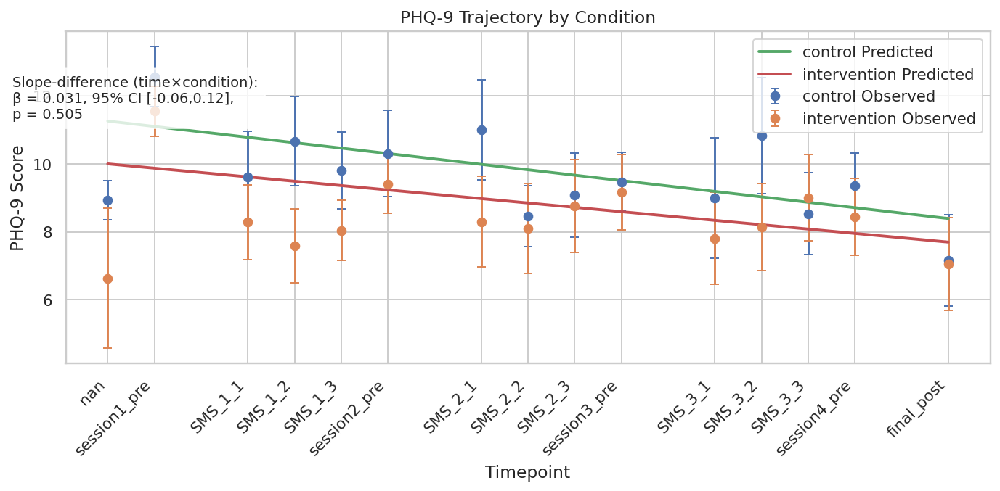

In [57]:
import re
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm
import statsmodels.formula.api as smf
from pathlib import Path
from scipy import stats
from scipy.stats import norm
from IPython.display import display

# ─── 0) SETTINGS, PATHS & UTILITY FUNCTIONS ─────────────────────────────────
DATA_DIR = Path('/content')

def find_csv(substring: str) -> Path:
    matches = list(DATA_DIR.glob(f'*{substring}*.csv'))
    if not matches:
        raise FileNotFoundError(f"No file matching '{substring}' in {DATA_DIR}")
    if len(matches) > 1:
        raise ValueError(f"Multiple files match '{substring}': {matches}")
    return matches[0]

# Define key files
POST13 = find_csv('post_sessions_1-3')
POST4  = find_csv('post_session_4')

data_files = {
    'pre1':     'pre_session_1',
    'pre2to4':  'pre_sessions_2-4',
    'post1to3': 'post_sessions_1-3',
    'post4':    'post_session_4',
    'sms':      'sms_day1,3,5',
    'sms_post': 'sms_post',
    'signup':   'sign_up',
    'retention':'retention',
    'demo':     'demographics',
    'assign':   'wp2_assignments'
}

# Load all dataframes
dfs = {}
for key, name in data_files.items():
    try:
        dfs[key] = pd.read_csv(find_csv(name), dtype=str)
    except Exception:
        dfs[key] = None

(df_s1_pre, df_s2to4_pre, df_s2to4_post, df_s4_post,
 df_sms, df_final, df_signup, df_retention,
 df_demo, df_assign) = (
    dfs['pre1'], dfs['pre2to4'], dfs['post1to3'], dfs['post4'],
    dfs['sms'], dfs['sms_post'], dfs['signup'], dfs['retention'],
    dfs['demo'], dfs['assign']
)

# ─── 1) RETENTION & DEMOGRAPHIC SUMMARIES ───────────────────────────────────
if df_retention is not None:
    df_retention['attended'] = df_retention['attended'].astype(int)
    retention = df_retention.groupby('session_n')['attended'].mean().reset_index()
    print("Retention rates by session:")
    display(retention)

if df_demo is not None:
    df_demo['age'] = pd.to_numeric(df_demo['age'], errors='coerce')
    print("Demographics summary:")
    display(df_demo[['age','gender']].describe(include='all'))

# ─── 2) CLEAN WELLBEING & SMS DATA ───────────────────────────────────────────
def sum_scale(df, cols, out):
    df[out] = df[cols].apply(pd.to_numeric, errors='coerce').sum(axis=1)

def get_scale_cols(df, prefix, n, allow_suffix=False):
    cols = []
    for i in range(1, n+1):
        m, a = f"{prefix}_{i}", f"{prefix}_{i}_1"
        if m in df.columns:
            cols.append(m)
        elif allow_suffix and a in df.columns:
            cols.append(a)
    return cols

if df_sms is not None:
    df_sms['part_id'] = df_sms['part_id'].str.strip().str[:5]

all_wb = [
    df for df in (
        df_s1_pre, df_s2to4_pre, df_s2to4_post,
        df_s4_post, df_sms, df_final
    ) if df is not None
]
if not all_wb:
    raise RuntimeError("No wellbeing/SMS data loaded!")

for df in all_wb:
    df.columns = df.columns.str.strip()
    # BDI numeric
    for c in df.columns:
        if re.fullmatch(r"bdi_\d+(?:_1)?", c):
            df[c] = pd.to_numeric(df[c].astype(str).str.extract(r"^(\d+)")[0], errors='coerce')
    # Sum scales
    for prefix, count, allow, out in [
        ('bai', 21, False, 'bai_sum'),
        ('bdi', 21, False, 'bdi_sum'),
        ('madrs',9,  True,  'MADRS_S_sum')
    ]:
        cols = get_scale_cols(df, prefix, count, allow_suffix=allow)
        if cols:
            sum_scale(df, cols, out)
    # m3vas standardization
    for var in ('mood','pleasure','suicidal'):
        raw = next((c for c in df.columns if re.fullmatch(f"m3vas_{var}(?:_1)?", c)), None)
        ch  = next((c for c in df.columns if re.fullmatch(f"m3vas_ch_{var}(?:_1)?", c)), None)
        tgt = raw or ch
        if tgt:
            vals = pd.to_numeric(df[tgt], errors='coerce')
            if var == 'suicidal':
                df['m3vas_suicidal'] = vals - 50
            else:
                df[f"m3vas_{var}"] = (50 - vals) if raw else (vals - 50)
    df.drop(columns=[
        c for c in df.columns
        if re.fullmatch(r"m3vas_(?:ch_)?(?:mood|pleasure|suicidal)(?:_1)?", c)
    ], errors='ignore', inplace=True)
    # Clean FISBER
    for c in ('fisber_1','fisber_2','fisber_3'):
        if c in df.columns:
            df[c] = pd.to_numeric(df[c].astype(str).str.extract(r"(\d+)$")[0], errors='coerce')
    # Ensure sums numeric
    for c in ['phq9_sum','spane_p','spane_n','bai_sum','bdi_sum','MADRS_S_sum']:
        if c in df.columns:
            df[c] = pd.to_numeric(df[c], errors='coerce')

# ─── 3) TAG, CONCATENATE, MERGE, ORDER, MODEL DF ─────────────────────────────

# 3.1 Tag each dataframe with its appropriate timepoint label
if df_s1_pre is not None:
    df_s1_pre['timepoint'] = 'session1_pre'
if df_s2to4_pre is not None:
    df_s2to4_pre['timepoint'] = df_s2to4_pre.apply(lambda r: f"session{r.session_n}_pre", axis=1)
if df_s2to4_post is not None:
    df_s2to4_post['timepoint'] = df_s2to4_post.apply(lambda r: f"session{r.session_n}_post", axis=1)
if df_s4_post is not None:
    df_s4_post['timepoint'] = 'session4_post'
if df_sms is not None:
    df_sms['timepoint'] = df_sms.apply(lambda r: f"SMS_{r.session_n}_{r.sms_n}", axis=1)
if df_final is not None:
    df_final['timepoint'] = 'final_post'

# 3.2 Concatenate all wellbeing & SMS data into one long dataframe
all_wb = [
    df for df in (
        df_s1_pre, df_s2to4_pre, df_s2to4_post,
        df_s4_post, df_sms, df_final
    ) if df is not None
]
df_long = pd.concat(all_wb, ignore_index=True)

# 3.3 Keep only valid numeric participant IDs
df_long = df_long[df_long['part_id'].str.match(r'^\d+$', na=False)]

# 3.4 Merge in assignment condition
df_long = df_long.merge(df_assign[['part_id','condition']], on='part_id', how='left')

# 3.5 Define the chronological order of timepoints (including final_post)
ordered = [
    'session1_pre','session1_post',
    'SMS_1_1','SMS_1_2','SMS_1_3',
    'session2_pre','session2_post',
    'SMS_2_1','SMS_2_2','SMS_2_3',
    'session3_pre','session3_post',
    'SMS_3_1','SMS_3_2','SMS_3_3',
    'session4_pre','session4_post',
    'final_post'
]
df_long['timepoint'] = pd.Categorical(df_long['timepoint'],
                                      categories=ordered,
                                      ordered=True)
df_long['time_num'] = df_long['timepoint'].cat.codes

# 3.6 Build the modelling dataframe: exclude only sessionX_post (keep final_post)
mask_session_post = df_long['timepoint'].astype(str).str.match(r'^session\d+_post$')
df_model = df_long[~mask_session_post].copy()

# 3.7 Center the time variable
df_model['tc'] = df_model['time_num'] - df_model['time_num'].mean()

# 3.8 Drop any remaining missing key data
df_model = df_model.dropna(subset=['phq9_sum','tc','condition']).reset_index(drop=True)

# ─── 4) COMPOSITE SCORING ───────────────────────────────────────────────────

VHQ_DEFS = {
    "Geometric": ['6d_vhq_1','6d_vhq_2','6d_vhq_3'],
    "Semantic":  ['6d_vhq_4','6d_vhq_5','6d_vhq_6'],
    "Detail":    ['6d_vhq_7','6d_vhq_8','6d_vhq_9'],
    "Vividness": ['6d_vhq_10','6d_vhq_11','6d_vhq_12'],
    "Entropy":   ['6d_vhq_13','6d_vhq_14','6d_vhq_15'],
    "Focality":  ['6d_vhq_16','6d_vhq_17','6d_vhq_18']
}
EXP4_DEFS = [
    'exp4_engagement_1','exp4_pleasure_1',
    'exp4_discomfort_1','exp4_arousal_1'
]
asc_defs = {
    "Experience_of_Unity":            ['asc_18_4','asc_34_4','asc_41_4','asc_42_4','asc_52_4'],
    "Spiritual_Experience":           ['asc_9_4','asc_81_4','asc_94_4'],
    "Blissful_State":                 ['asc_12_4','asc_86_4','asc_91_4'],
    "Insightfulness":                 ['asc_50_4','asc_69_4','asc_77_4'],
    "Disembodiment":                  ['asc_26_4','asc_62_4','asc_63_4'],
    "Impaired_Control_and_Cognition": ['asc_8_4','asc_27_4','asc_38_4','asc_47_4','asc_64_4','asc_67_4','asc_78_4'],
    "Anxiety":                        ['asc_32_4','asc_43_4','asc_44_4','asc_46_4','asc_56_4','asc_89_4'],
    "Complex_Imagery":                ['asc_39_4','asc_72_4','asc_82_4'],
    "Elementary_Imagery":             ['asc_14_4','asc_22_4','asc_33_4'],
    "Audio_Visual_Synesthesia":       ['asc_20_4','asc_23_4','asc_75_4'],
    "Changed_Meaning_of_Percepts":    ['asc_28_4','asc_31_4','asc_54_4']
}

def extract_num(x):
    m = re.search(r'(\d+)$', str(x).strip())
    return float(m.group(1)) if m else np.nan

# load
df_it1 = pd.read_csv(POST13, header=0).iloc[1:].copy()
df_it2 = pd.read_csv(POST4,  header=0).iloc[1:].copy()
df_it2['session_n'] = 4
df_items = pd.concat([df_it1, df_it2], ignore_index=True)
df_items['part_id'] = df_items['part_id'].astype(str)

# numeric conversion
for col in sum(VHQ_DEFS.values(), []) + sum(asc_defs.values(), []) + EXP4_DEFS:
    if col in df_items.columns:
        df_items[col] = df_items[col].apply(extract_num)

# ─── 4.1) REVERSE‑CODE VIVIDNESS ITEMS (1–5 scale) ───────────────────────────
# formula: reversed = (max + min) - raw; here 5 + 1 = 6
for col in VHQ_DEFS['Vividness']:
    if col in df_items.columns:
        df_items[col] = 6 - df_items[col]

# compute subscores and composites
records = []
for (pid, sess), grp in df_items.groupby(['part_id','session_n']):
    rec = {'part_id': pid}
    # VHQ subscales
    for nm, cols in VHQ_DEFS.items():
        pres = [c for c in cols if c in grp.columns]
        rec[f'VHQ_{nm}'] = grp[pres].mean(axis=1).mean() if pres else np.nan
    # ASC subscales
    for nm, cols in asc_defs.items():
        pres = [c for c in cols if c in grp.columns]
        rec[f'ASC_{nm}'] = grp[pres].mean(axis=1).mean() if pres else np.nan
    # EXP4 scales
    for col in EXP4_DEFS:
        if col in grp.columns:
            nm = col.replace('exp4_','').replace('_1','').capitalize()
            rec[f'EXP4_{nm}'] = grp[col].mean()
    records.append(rec)

df_scores = pd.DataFrame(records)

# participant‑level composites
df_partmods = df_scores.groupby('part_id').mean(numeric_only=True).reset_index()
df_partmods['VHQ_score']  = df_partmods.filter(like='VHQ_').mean(axis=1)
df_partmods['ASC_score']  = df_partmods.filter(like='ASC_').mean(axis=1)
df_partmods['EXP4_score']= df_partmods.filter(like='EXP4_').mean(axis=1)

# ─── 5) TWO‑WAY & 6) THREE‑WAY MODERATION ───────────────────────────────────
two_way, three_way = [], []
for m in df_partmods.columns.drop('part_id'):
    sub = df_model.merge(df_partmods[['part_id', m]], on='part_id').dropna(subset=[m])
    sub[f'{m}_c'] = sub[m] - sub[m].mean()
    # two-way
    res2 = smf.mixedlm(f"phq9_sum ~ tc*condition*{m}_c",
                       sub, groups='part_id', re_formula='~1').fit()
    two_way.append((m,
                    round(res2.params.get(f'tc:{m}_c', np.nan),4),
                    round(res2.pvalues.get(f'tc:{m}_c', np.nan),4)))
    # three-way
    three_way.append((m,
                      round(res2.params.get(f'tc:condition[T.intervention]:{m}_c',np.nan),4),
                      round(res2.pvalues.get(f'tc:condition[T.intervention]:{m}_c',np.nan),4)))
df_tw = pd.DataFrame(two_way, columns=['Moderator','Coef','p-value'])
df_th = pd.DataFrame(three_way, columns=['Moderator','3way_Coef','3way_p']).sort_values('3way_p')
print("Two‑way moderators (p<.05):");  display(df_tw[df_tw['p-value']<0.05])
print("Three‑way moderators (p<.05):"); display(df_th[df_th['3way_p']<0.05])

# ─── 7) IMAGERY ↔ ASC LINKAGE ───────────────────────────────────────────────
assign = pd.read_csv(find_csv('wp2_assignments'), dtype=str)[['part_id','condition']]
df_pm = df_partmods.merge(assign, on='part_id')
df_pm['VHQ_c'] = df_pm['VHQ_score'] - df_pm['VHQ_score'].mean()
df_pm['ASC_c'] = df_pm['ASC_score'] - df_pm['ASC_score'].mean()
r, p_r = stats.pearsonr(df_pm['VHQ_score'], df_pm['ASC_score'])
m1 = smf.ols("ASC_c ~ VHQ_c*condition", data=df_pm).fit()
print(f"Imagery ↔ ASC: r={r:.2f}, p={p_r:.3f}")
display(m1.summary())

# ─── 8) MEDIATION TEST (Sobel) ──────────────────────────────────────────────
sl = []
for pid, grp in df_model.groupby('part_id'):
    if grp['time_num'].nunique() < 2: continue
    ols = sm.OLS(grp['phq9_sum'], sm.add_constant(grp['time_num'])).fit()
    sl.append((pid, ols.params['time_num']))
df_sl = pd.DataFrame(sl, columns=['part_id','phq_slope'])
df_med = df_sl.merge(df_partmods[['part_id','ASC_score']], on='part_id').merge(assign, on='part_id')
df_med['cond_num'] = (df_med['condition']=='intervention').astype(int)
Ma = sm.OLS(df_med['ASC_score'], sm.add_constant(df_med['cond_num'])).fit()
Mb = sm.OLS(df_med['phq_slope'], sm.add_constant(df_med[['ASC_score','cond_num']])).fit()
a, sa = Ma.params['cond_num'], Ma.bse['cond_num']
b, sb = Mb.params['ASC_score'], Mb.bse['ASC_score']
ind = a*b
se_ind = np.sqrt(a*a*sb*sb + b*b*sa*sa)
z_val = ind / se_ind
p_sobel = 2*(1 - norm.cdf(abs(z_val)))
print(f"Mediation (Sobel): z={z_val:.2f}, p={p_sobel:.3f}")

# ─── 9) GROWTH MODEL & PLOTS ────────────────────────────────────────────────
final_model = smf.mixedlm("phq9_sum ~ tc*condition", df_model,
                          groups='part_id', re_formula='~1').fit()

# Extract interaction coefficient and p
coef_int = final_model.params['tc:condition[T.intervention]']
se_int   = final_model.bse['tc:condition[T.intervention]']
z_int    = coef_int / se_int
p_int    = 2 * (1 - norm.cdf(abs(z_int)))

print("Growth model fixed effects:")
print(final_model.summary().tables[1])
print(f"Interaction test: β_diff={coef_int:.4f}, SE={se_int:.4f}, z={z_int:.4f}, p={p_int:.4f}")

# Prepare observed & predicted
obs = df_model.groupby(['condition','time_num']).phq9_sum.agg(['mean','sem']).reset_index()
pred_df = (df_model
    .assign(predicted=final_model.predict(df_model))
    .groupby(['condition','time_num'])['predicted']
    .mean().reset_index()
)

# Plot
time_vals = sorted(df_model['time_num'].unique())
label_map = df_model[['time_num','timepoint']].drop_duplicates().set_index('time_num')['timepoint'].to_dict()

plt.figure(figsize=(10,5))
for cond, grp in obs.groupby('condition'):
    plt.errorbar(grp['time_num'], grp['mean'], yerr=grp['sem'],
                 fmt='o', capsize=3, label=f"{cond} Observed")
for cond in pred_df['condition'].unique():
    sub = pred_df[pred_df['condition']==cond]
    plt.plot(sub['time_num'], sub['predicted'], '-', lw=2,
             label=f"{cond} Predicted")

# Annotate significant interaction (overall)
txt = (
    f"Slope‐difference (time×condition):\n"
    f"β = {coef_int:.3f}, 95% CI [{coef_int-1.96*se_int:.2f},{coef_int+1.96*se_int:.2f}],\n"
    f"p = {p_int:.3f}"
)
plt.gcf().text(0.02, 0.75, txt, fontsize=10,
               bbox=dict(boxstyle="round,pad=0.5", facecolor="white", alpha=0.8))

plt.xticks(time_vals, [label_map[t] for t in time_vals], rotation=45, ha='right')
plt.xlabel("Timepoint")
plt.ylabel("PHQ-9 Score")
plt.title("PHQ-9 Trajectory by Condition")
plt.legend(loc='upper right')
plt.tight_layout()
plt.show()

STRATUM EFFECTS

In [ ]:
# ─── Stratified time×condition slopes by stratum (Approach 2) ─────────────

# Merge in stratum from your assignments
df_model = df_model.merge(
    df_assign[['part_id','stratum']],
    on='part_id',
    how='left'
).dropna(subset=['stratum'])

# If you want a specific order or reference, set categories
df_model['stratum'] = pd.Categorical(
    df_model['stratum'],
    categories=['low_no','low_yes','high_no','high_yes'],  # adjust to your actual levels
)

# Loop over strata and fit a tc*condition model in each
results = []
for s in df_model['stratum'].cat.categories:
    sub = df_model[df_model['stratum']==s]
    # skip if too few participants
    if sub['part_id'].nunique() < 5:
        continue

    model = smf.mixedlm(
        "phq9_sum ~ tc*condition",
        sub,
        groups='part_id',
        re_formula='~1'
    ).fit()

    coef = model.params.get('tc:condition[T.intervention]', np.nan)
    pval = model.pvalues.get('tc:condition[T.intervention]', np.nan)
    results.append({
        'stratum':   s,
        'slope_diff': coef,
        'p_value':    pval
    })

# Build a DataFrame of results and display
strat_df = pd.DataFrame(results)
print("Time×Condition slope‐difference by stratum:")
display(strat_df)

unmedicated participants with preliminary PHQ-9 >= 17 seem to get worse over time in the intervention compared to the control

In [ ]:
# ─── 4.X) Growth model with Stratum, ASC & VHQ as moderators ────────────────

# 1) Merge in stratum and the part‐level composites
df_mm = (
    df_model
      .merge(df_assign[['part_id','stratum']], on='part_id', how='left')
      .merge(df_partmods[['part_id','ASC_score','VHQ_score']], on='part_id', how='left')
      .dropna(subset=['stratum','ASC_score','VHQ_score'])
)

# 2) Center the composite scores
df_mm['ASC_c'] = df_mm['ASC_score'] - df_mm['ASC_score'].mean()
df_mm['VHQ_c'] = df_mm['VHQ_score'] - df_mm['VHQ_score'].mean()

# 3) Make sure stratum is a proper categorical (and choose your reference)
df_mm['stratum'] = pd.Categorical(
    df_mm['stratum'],
    categories=['low_no','low_yes','high_no','high_yes'],  # adjust if your levels differ
    ordered=False
)

# 4) Fit the 3-way interactions for each moderator in one model
mod_full = smf.mixedlm(
    "phq9_sum ~ tc*condition*stratum + tc*condition*ASC_c + tc*condition*VHQ_c",
    df_mm,
    groups='part_id',
    re_formula='~1'
).fit()

# 5) Inspect the fixed‐effects table
print(mod_full.summary())

Two‑way moderators (p<.05):


,Moderator,Coef,p-value
0,VHQ_Geometric,-0.0743,0.0481
9,ASC_Insightfulness,-0.0038,0.0194
12,ASC_Anxiety,0.0084,0.0370


Three‑way moderators (p<.05):


,Moderator,3way_Coef,3way_p
3,VHQ_Vividness,0.2401,0.0006
1,VHQ_Semantic,-0.1497,0.0061
20,EXP4_Arousal,-0.0046,0.0373
5,VHQ_Focality,-0.1941,0.0433


Imagery ↔ ASC: r=0.35, p=0.013


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  ASC_c   R-squared:                       0.158
Model:                            OLS   Adj. R-squared:                  0.104
Method:                 Least Squares   F-statistic:                     2.933
Date:                Fri, 17 Oct 2025   Prob (F-statistic):             0.0430
Time:                        08:54:08   Log-Likelihood:                -203.58
No. Observations:                  51   AIC:                             415.2
Df Residuals:                      47   BIC:                             422.9
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
===================================================================================================
                                      coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------------------
Intercept                           0.9297      3.058      0.304      0.762      -5.223       7.082
condition[T.intervention]          -2.2756      3.954     -0.575      0.568     -10.231       5.680
VHQ_c                               2.7024     12.558      0.215      0.831     -22.561      27.966
VHQ_c:condition[T.intervention]    17.9630     14.393      1.248      0.218     -10.991      46.917
==============================================================================
Omnibus:                        1.690   Durbin-Watson:                   1.941
Prob(Omnibus):                  0.429   Jarque-Bera (JB):                1.386
Skew:                           0.226   Prob(JB):                        0.500
Kurtosis:                       2.331   Cond. No.                         11.5
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

Mediation (Sobel): z=0.28, p=0.777
Growth model fixed effects:
                               Coef. Std.Err.       z  P>|z|  [0.025  0.975]
Intercept                      9.897    0.960  10.314  0.000   8.016  11.778
condition[T.intervention]     -0.992    1.249  -0.794  0.427  -3.439   1.455
tc                            -0.159    0.036  -4.449  0.000  -0.230  -0.089
tc:condition[T.intervention]   0.031    0.047   0.666  0.505  -0.061   0.124
part_id Var                   18.429    1.444                               
Interaction test: β_diff=0.0314, SE=0.0472, z=0.6661, p=0.5053


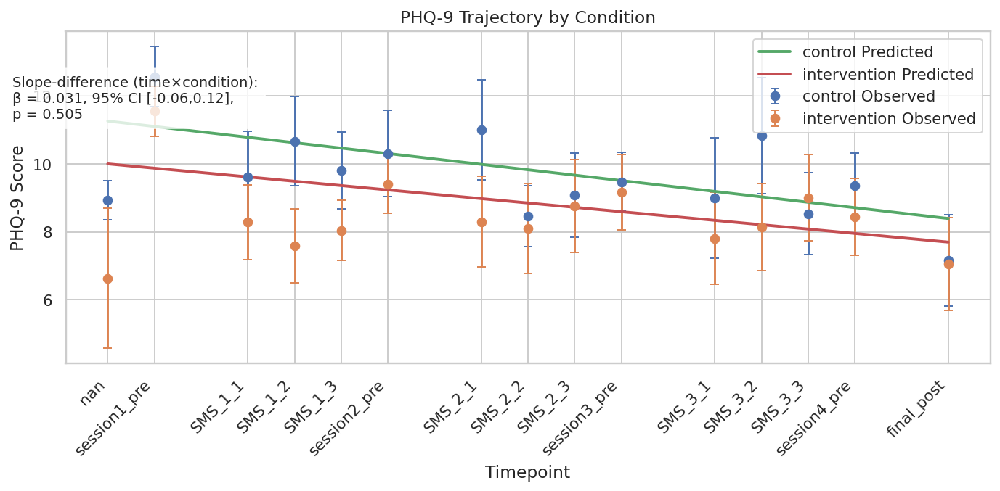

In [61]:
import warnings
warnings.filterwarnings("ignore")  # silence all warnings

import re
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm
import statsmodels.formula.api as smf
from pathlib import Path
from scipy import stats
from scipy.stats import norm
from numpy.linalg import LinAlgError
from IPython.display import display

# ─── 0) SETTINGS, PATHS & UTILITY FUNCTIONS ─────────────────────────────────
DATA_DIR = Path('/content')

def find_csv(substring: str) -> Path:
    matches = list(DATA_DIR.glob(f'*{substring}*.csv'))
    if not matches:
        raise FileNotFoundError(f"No file matching '{substring}' in {DATA_DIR}")
    if len(matches) > 1:
        raise ValueError(f"Multiple files match '{substring}': {matches}")
    return matches[0]

# Define key files
POST13 = find_csv('post_sessions_1-3')
POST4  = find_csv('post_session_4')

data_files = {
    'pre1':     'pre_session_1',
    'pre2to4':  'pre_sessions_2-4',
    'post1to3': 'post_sessions_1-3',
    'post4':    'post_session_4',
    'sms':      'sms_day1,3,5',
    'sms_post': 'sms_post',
    'signup':   'sign_up',
    'retention':'retention',
    'demo':     'demographics',
    'assign':   'wp2_assignments'
}

# Load all dataframes
dfs = {}
for key, name in data_files.items():
    try:
        dfs[key] = pd.read_csv(find_csv(name), dtype=str)
    except Exception:
        dfs[key] = None

(df_s1_pre, df_s2to4_pre, df_s2to4_post, df_s4_post,
 df_sms, df_final, df_signup, df_retention,
 df_demo, df_assign) = (
    dfs['pre1'], dfs['pre2to4'], dfs['post1to3'], dfs['post4'],
    dfs['sms'], dfs['sms_post'], dfs['signup'], dfs['retention'],
    dfs['demo'], dfs['assign']
)

# ─── 1) RETENTION & DEMOGRAPHIC SUMMARIES ───────────────────────────────────
if df_retention is not None:
    df_retention['attended'] = df_retention['attended'].astype(int)
    retention = df_retention.groupby('session_n')['attended'].mean().reset_index()
    print("Retention rates by session:")
    display(retention)

if df_demo is not None:
    df_demo['age'] = pd.to_numeric(df_demo['age'], errors='coerce')
    print("Demographics summary:")
    display(df_demo[['age','gender']].describe(include='all'))

# ─── 2) CLEAN WELLBEING & SMS DATA ───────────────────────────────────────────
def sum_scale(df, cols, out):
    df[out] = df[cols].apply(pd.to_numeric, errors='coerce').sum(axis=1)

def get_scale_cols(df, prefix, n, allow_suffix=False):
    cols = []
    for i in range(1, n+1):
        m, a = f"{prefix}_{i}", f"{prefix}_{i}_1"
        if m in df.columns:
            cols.append(m)
        elif allow_suffix and a in df.columns:
            cols.append(a)
    return cols

if df_sms is not None:
    df_sms['part_id'] = df_sms['part_id'].str.strip().str[:5]

all_wb = [df for df in (
    df_s1_pre, df_s2to4_pre, df_s2to4_post,
    df_s4_post, df_sms, df_final
) if df is not None]
if not all_wb:
    raise RuntimeError("No wellbeing/SMS data loaded!")

for df in all_wb:
    df.columns = df.columns.str.strip()
    # BDI numeric
    for c in df.columns:
        if re.fullmatch(r"bdi_\d+(?:_1)?", c):
            df[c] = pd.to_numeric(df[c].astype(str).str.extract(r"^(\d+)")[0], errors='coerce')
    # Sum scales
    for prefix, count, allow, out in [
        ('bai', 21, False, 'bai_sum'),
        ('bdi', 21, False, 'bdi_sum'),
        ('madrs',9,  True,  'MADRS_S_sum')
    ]:
        cols = get_scale_cols(df, prefix, count, allow_suffix=allow)
        if cols:
            sum_scale(df, cols, out)
    # m3vas standardization
    for var in ('mood','pleasure','suicidal'):
        raw = next((c for c in df.columns if re.fullmatch(f"m3vas_{var}(?:_1)?", c)), None)
        ch  = next((c for c in df.columns if re.fullmatch(f"m3vas_ch_{var}(?:_1)?", c)), None)
        tgt = raw or ch
        if tgt:
            vals = pd.to_numeric(df[tgt], errors='coerce')
            if var == 'suicidal':
                df['m3vas_suicidal'] = vals - 50
            else:
                df[f"m3vas_{var}"] = (50 - vals) if raw else (vals - 50)
    df.drop(columns=[c for c in df.columns
                     if re.fullmatch(r"m3vas_(?:ch_)?(?:mood|pleasure|suicidal)(?:_1)?", c)],
            errors='ignore', inplace=True)
    # Clean FISBER
    for c in ('fisber_1','fisber_2','fisber_3'):
        if c in df.columns:
            df[c] = pd.to_numeric(df[c].astype(str).str.extract(r"(\d+)$")[0], errors='coerce')
    # Ensure sums numeric
    for c in ['phq9_sum','spane_p','spane_n','bai_sum','bdi_sum','MADRS_S_sum']:
        if c in df.columns:
            df[c] = pd.to_numeric(df[c], errors='coerce')

# ─── 3) TAG, CONCATENATE, MERGE, ORDER, MODEL DF ─────────────────────────────
if df_s1_pre is not None:
    df_s1_pre['timepoint'] = 'session1_pre'
if df_s2to4_pre is not None:
    df_s2to4_pre['timepoint'] = df_s2to4_pre.apply(lambda r: f"session{r.session_n}_pre", axis=1)
if df_s2to4_post is not None:
    df_s2to4_post['timepoint'] = df_s2to4_post.apply(lambda r: f"session{r.session_n}_post", axis=1)
if df_s4_post is not None:
    df_s4_post['timepoint'] = 'session4_post'
if df_sms is not None:
    df_sms['timepoint'] = df_sms.apply(lambda r: f"SMS_{r.session_n}_{r.sms_n}", axis=1)
if df_final is not None:
    df_final['timepoint'] = 'final_post'

df_long = pd.concat([df for df in (
    df_s1_pre, df_s2to4_pre, df_s2to4_post,
    df_s4_post, df_sms, df_final
) if df is not None], ignore_index=True)

df_long = df_long[df_long['part_id'].str.match(r'^\d+$', na=False)]
df_long = df_long.merge(df_assign[['part_id','condition']], on='part_id', how='left')

ordered = [
    'session1_pre','session1_post',
    'SMS_1_1','SMS_1_2','SMS_1_3',
    'session2_pre','session2_post',
    'SMS_2_1','SMS_2_2','SMS_2_3',
    'session3_pre','session3_post',
    'SMS_3_1','SMS_3_2','SMS_3_3',
    'session4_pre','session4_post',
    'final_post'
]
df_long['timepoint'] = pd.Categorical(df_long['timepoint'], categories=ordered, ordered=True)
df_long['time_num'] = df_long['timepoint'].cat.codes

mask_session_post = df_long['timepoint'].astype(str).str.match(r'^session\d+_post$')
df_model = df_long[~mask_session_post].copy()
df_model['tc'] = df_model['time_num'] - df_model['time_num'].mean()
df_model = df_model.dropna(subset=['phq9_sum','tc','condition']).reset_index(drop=True)

# ─── 4) COMPOSITE SCORING ───────────────────────────────────────────────────
VHQ_DEFS = {
    "Geometric": ['6d_vhq_1','6d_vhq_2','6d_vhq_3'],
    "Semantic":  ['6d_vhq_4','6d_vhq_5','6d_vhq_6'],
    "Detail":    ['6d_vhq_7','6d_vhq_8','6d_vhq_9'],
    "Vividness": ['6d_vhq_10','6d_vhq_11','6d_vhq_12'],
    "Entropy":   ['6d_vhq_13','6d_vhq_14','6d_vhq_15'],
    "Focality":  ['6d_vhq_16','6d_vhq_17','6d_vhq_18']
}
EXP4_DEFS = [
    'exp4_engagement_1','exp4_pleasure_1',
    'exp4_discomfort_1','exp4_arousal_1'
]
asc_defs = {
    "Experience_of_Unity":            ['asc_18_4','asc_34_4','asc_41_4','asc_42_4','asc_52_4'],
    "Spiritual_Experience":           ['asc_9_4','asc_81_4','asc_94_4'],
    "Blissful_State":                 ['asc_12_4','asc_86_4','asc_91_4'],
    "Insightfulness":                 ['asc_50_4','asc_69_4','asc_77_4'],
    "Disembodiment":                  ['asc_26_4','asc_62_4','asc_63_4'],
    "Impaired_Control_and_Cognition": ['asc_8_4','asc_27_4','asc_38_4','asc_47_4','asc_64_4','asc_67_4','asc_78_4'],
    "Anxiety":                        ['asc_32_4','asc_43_4','asc_44_4','asc_46_4','asc_56_4','asc_89_4'],
    "Complex_Imagery":                ['asc_39_4','asc_72_4','asc_82_4'],
    "Elementary_Imagery":             ['asc_14_4','asc_22_4','asc_33_4'],
    "Audio_Visual_Synesthesia":       ['asc_20_4','asc_23_4','asc_75_4'],
    "Changed_Meaning_of_Percepts":    ['asc_28_4','asc_31_4','asc_54_4']
}

def extract_num(x):
    m = re.search(r'(\d+)$', str(x).strip())
    return float(m.group(1)) if m else np.nan

df_it1 = pd.read_csv(POST13, header=0).iloc[1:].copy()
df_it2 = pd.read_csv(POST4,  header=0).iloc[1:].copy()
df_it2['session_n'] = 4
df_items = pd.concat([df_it1, df_it2], ignore_index=True)
df_items['part_id'] = df_items['part_id'].astype(str)

for col in sum(VHQ_DEFS.values(), []) + sum(asc_defs.values(), []) + EXP4_DEFS:
    if col in df_items.columns:
        df_items[col] = df_items[col].apply(extract_num)

for col in VHQ_DEFS['Vividness']:
    if col in df_items.columns:
        df_items[col] = 6 - df_items[col]

records = []
for (pid, sess), grp in df_items.groupby(['part_id','session_n']):
    rec = {'part_id': pid}
    for nm, cols in VHQ_DEFS.items():
        pres = [c for c in cols if c in grp.columns]
        rec[f'VHQ_{nm}'] = grp[pres].mean(axis=1).mean() if pres else np.nan
    for nm, cols in asc_defs.items():
        pres = [c for c in cols if c in grp.columns]
        rec[f'ASC_{nm}'] = grp[pres].mean(axis=1).mean() if pres else np.nan
    for col in EXP4_DEFS:
        if col in grp.columns:
            nm = col.replace('exp4_','').replace('_1','').capitalize()
            rec[f'EXP4_{nm}'] = grp[col].mean()
    records.append(rec)

df_scores = pd.DataFrame(records)
df_partmods = df_scores.groupby('part_id').mean(numeric_only=True).reset_index()
df_partmods['VHQ_score']   = df_partmods.filter(like='VHQ_').mean(axis=1)
df_partmods['ASC_score']   = df_partmods.filter(like='ASC_').mean(axis=1)
df_partmods['EXP4_score']  = df_partmods.filter(like='EXP4_').mean(axis=1)

# ─── 5 & 6) TWO‑WAY & THREE‑WAY MODERATION ──────────────────────────────────
two_way, three_way = [], []
moderators = [c for c in df_partmods.columns if c != 'part_id']
for m in moderators:
    if m not in df_model.columns and m not in df_partmods.columns:
        continue
    sub = df_model.merge(df_partmods[['part_id', m]], on='part_id', how='left')
    if m not in sub.columns:
        continue
    sub = sub.dropna(subset=[m])
    if sub.empty:
        continue
    sub[f'{m}_c'] = sub[m] - sub[m].mean()

    try:
        res = smf.mixedlm(f"phq9_sum ~ tc*condition*{m}_c",
                          sub, groups='part_id', re_formula='~1').fit()
    except (LinAlgError, ValueError):
        continue

    two_way.append((
        m,
        round(res.params.get(f'tc:{m}_c', np.nan), 4),
        round(res.pvalues.get(f'tc:{m}_c', np.nan), 4)
    ))
    three_way.append((
        m,
        round(res.params.get(f'tc:condition[T.intervention]:{m}_c', np.nan), 4),
        round(res.pvalues.get(f'tc:condition[T.intervention]:{m}_c', np.nan), 4)
    ))

df_tw = pd.DataFrame(two_way, columns=['Moderator','Coef','p-value'])
df_th = pd.DataFrame(three_way, columns=['Moderator','3way_Coef','3way_p']).sort_values('3way_p')
print("Two‑way moderators (p<.05):"); display(df_tw[df_tw['p-value']<0.05])
print("Three‑way moderators (p<.05):"); display(df_th[df_th['3way_p']<0.05])

# ─── 7) IMAGERY ↔ ASC LINKAGE ───────────────────────────────────────────────
assign = pd.read_csv(find_csv('wp2_assignments'), dtype=str)[['part_id','condition']]
df_pm = df_partmods.merge(assign, on='part_id')
df_pm['VHQ_c'] = df_pm['VHQ_score'] - df_pm['VHQ_score'].mean()
df_pm['ASC_c'] = df_pm['ASC_score'] - df_pm['ASC_score'].mean()
r, p_r = stats.pearsonr(df_pm['VHQ_score'], df_pm['ASC_score'])
m1 = smf.ols("ASC_c ~ VHQ_c*condition", data=df_pm).fit()
print(f"Imagery ↔ ASC: r={r:.2f}, p={p_r:.3f}")
display(m1.summary())

# ─── 8) MEDIATION TEST (Sobel) ──────────────────────────────────────────────
sl = []
for pid, grp in df_model.groupby('part_id'):
    if grp['time_num'].nunique() < 2: continue
    ols = sm.OLS(grp['phq9_sum'], sm.add_constant(grp['time_num'])).fit()
    sl.append((pid, ols.params['time_num']))
df_sl = pd.DataFrame(sl, columns=['part_id','phq_slope'])
df_med = df_sl.merge(df_partmods[['part_id','ASC_score']], on='part_id').merge(assign, on='part_id')
df_med['cond_num'] = (df_med['condition']=='intervention').astype(int)
Ma = sm.OLS(df_med['ASC_score'], sm.add_constant(df_med['cond_num'])).fit()
Mb = sm.OLS(df_med['phq_slope'], sm.add_constant(df_med[['ASC_score','cond_num']])).fit()
a, sa = Ma.params['cond_num'], Ma.bse['cond_num']
b, sb = Mb.params['ASC_score'], Mb.bse['ASC_score']
ind = a*b
se_ind = np.sqrt(a*a*sb*sb + b*b*sa*sa)
z_val = ind / se_ind
p_sobel = 2*(1 - norm.cdf(abs(z_val)))
print(f"Mediation (Sobel): z={z_val:.2f}, p={p_sobel:.3f}")

# ─── 9) GROWTH MODEL & PLOTS ────────────────────────────────────────────────
final_model = smf.mixedlm("phq9_sum ~ tc*condition", df_model,
                          groups='part_id', re_formula='~1').fit()

coef_int = final_model.params['tc:condition[T.intervention]']
se_int   = final_model.bse['tc:condition[T.intervention]']
z_int    = coef_int / se_int
p_int    = 2 * (1 - norm.cdf(abs(z_int)))

print("Growth model fixed effects:")
print(final_model.summary().tables[1])
print(f"Interaction test: β_diff={coef_int:.4f}, SE={se_int:.4f}, z={z_int:.4f}, p={p_int:.4f}")

obs = df_model.groupby(['condition','time_num']).phq9_sum.agg(['mean','sem']).reset_index()
pred_df = (df_model.assign(predicted=final_model.predict(df_model))
           .groupby(['condition','time_num'])['predicted'].mean().reset_index())

time_vals = sorted(df_model['time_num'].unique())
label_map = df_model[['time_num','timepoint']].drop_duplicates().set_index('time_num')['timepoint'].to_dict()

plt.figure(figsize=(10,5))
for cond, grp in obs.groupby('condition'):
    plt.errorbar(grp['time_num'], grp['mean'], yerr=grp['sem'],
                 fmt='o', capsize=3, label=f"{cond} Observed")
for cond in pred_df['condition'].unique():
    sub = pred_df[pred_df['condition']==cond]
    plt.plot(sub['time_num'], sub['predicted'], '-', lw=2,
             label=f"{cond} Predicted")

txt = (
    f"Slope‐difference (time×condition):\n"
    f"β = {coef_int:.3f}, 95% CI [{coef_int-1.96*se_int:.2f},{coef_int+1.96*se_int:.2f}],\n"
    f"p = {p_int:.3f}"
)
plt.gcf().text(0.02, 0.75, txt, fontsize=10,
               bbox=dict(boxstyle="round,pad=0.5", facecolor="white", alpha=0.8))

plt.xticks(time_vals, [label_map[t] for t in time_vals], rotation=45, ha='right')
plt.xlabel("Timepoint")
plt.ylabel("PHQ-9 Score")
plt.title("PHQ-9 Trajectory by Condition")
plt.legend(loc='upper right')
plt.tight_layout()
plt.show()

In [62]:
# full_analysis.py
# ---------------------------------------------------
# End-to-end pipeline: scale sums, composites, ANOVAs,
# mixed models with moderators (expectations, VHQ, ASC, EXP4), and plots
# ---------------------------------------------------

import warnings
warnings.filterwarnings("ignore")

import re
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import statsmodels.formula.api as smf
import statsmodels.api as sm
from scipy.stats import norm, ttest_rel
from numpy.linalg import LinAlgError
from pathlib import Path

# ─── 0) SETTINGS & UTILITIES ─────────────────────────────────────────────
DATA_DIR = Path('/content')  # adjust as needed

def find_csv(substring: str) -> Path:
    matches = list(DATA_DIR.glob(f'*{substring}*.csv'))
    matches = [m for m in matches if not m.name.endswith('_scales.csv')]
    if not matches:
        raise FileNotFoundError(f"No file matching '{substring}' in {DATA_DIR}")
    if len(matches) > 1:
        raise ValueError(f"Multiple files match '{substring}': {matches}")
    return matches[0]

def try_load(substring: str) -> pd.DataFrame | None:
    try:
        df = pd.read_csv(find_csv(substring), dtype=str)
    except Exception:
        return None
    df.columns = df.columns.str.strip().str.lower()
    if 'part_id' not in df.columns:
        for alt in ('participantid','prolificid','externalreference','responseid'):
            if alt in df.columns:
                df = df.rename(columns={alt:'part_id'})
                break
    df['part_id'] = df['part_id'].astype(str).str.strip()
    return df

# ─── 1) LOAD DATA ─────────────────────────────────────────────────────────
df_pre1   = try_load('pre_session_1')       # has expectations
df_post4  = try_load('post_session_4')      # no expectations
df_sms    = try_load('sms_day1,3,5')        # only PHQ-9
df_it13   = try_load('post_sessions_1-3')   # VHQ/ASC/EXP4 S1-3
df_it4    = try_load('post_session_4')      # VHQ/ASC/EXP4 S4
df_assign = try_load('wp2_assignments')     # participant condition
df_sms_post = try_load('sms_post')          # final check-in

# ─── 1b) FIX MADRS TYPOS & NORMALIZE ITEM NAMES ─────────────────────────
def normalize_madrs_columns(df: pd.DataFrame | None) -> pd.DataFrame | None:
    if df is None:
        return df
    ren = {}
    for c in df.columns:
        lc = c.strip().lower()
        # fix 'mards' → 'madrs', allow optional separators and suffixes
        # examples caught: mards_2_1, mards2, mards-10-1, madrs1, madrs_1_1
        m = re.match(r'^(ma[dr]rs)[_\s-]?(\d{1,2})(?:[_\s-](\d+))?$', lc)
        if m:
            base, idx, suf = m.groups()
            # coerce base to 'madrs'
            idx = int(idx)
            if 1 <= idx <= 10:
                new = f"madrs_{idx}" + (f"_{suf}" if suf else "")
                if new != c:
                    ren[c] = new
        # also handle explicit 'mards_' prefix
        if lc.startswith('mards_'):
            ren[c] = 'madrs_' + lc.split('mards_', 1)[1]
    if ren:
        df = df.rename(columns=ren)
        print(f"[MADRS] Renamed columns: {ren}")
    return df

df_pre1  = normalize_madrs_columns(df_pre1)
df_post4 = normalize_madrs_columns(df_post4)

# (optional) sanity check — how many MADRS items did we find in each?
if df_pre1 is not None:
    pre_cols = [c for c in df_pre1.columns if re.match(r'^madrs_\d+(?:_\d+)?$', c)]
    print(f"[MADRS] Pre: found {len(pre_cols)} item columns → {sorted(pre_cols)}")
if df_post4 is not None:
    post_cols = [c for c in df_post4.columns if re.match(r'^madrs_\d+(?:_\d+)?$', c)]
    print(f"[MADRS] Post: found {len(post_cols)} item columns → {sorted(post_cols)}")

# ─── 2) SCORING HELPERS ───────────────────────────────────────────────────
def get_scale_cols(df, prefix, n, allow_suffix=False):
    cols = []
    for i in range(1, n+1):
        a, b = f"{prefix}_{i}", f"{prefix}_{i}_1"
        if a in df.columns:
            cols.append(a)
        elif allow_suffix and b in df.columns:
            cols.append(b)
    return cols

def sum_scale(df, prefix, n, allow_suffix=False):
    cols = get_scale_cols(df, prefix, n, allow_suffix)
    vals = df[cols].apply(pd.to_numeric, errors='coerce')
    df[f"{prefix}_sum"]  = vals.sum(axis=1)
    df[f"{prefix}_mean"] = vals.mean(axis=1)

phq_map = {'Not at all':0,'Several days':1,'More than half the days':2,'Nearly every day':4}
def map_phq9(df):
    cols = [c for c in df.columns if re.match(r'^phq9_\d+', c)]
    for c in cols:
        df[c] = df[c].map(phq_map).astype(float)
    df['phq9_sum']  = df[cols].sum(axis=1)
    df['phq9_mean'] = df[cols].mean(axis=1)

# ─── 3) APPLY SCORING ─────────────────────────────────────────────────────
for df in (df_pre1, df_post4, df_sms):
    if df is None: continue
    for prefix, count, allow in [('bdi',21,True),('bai',21,False),('madrs',9,True)]:
        cols = get_scale_cols(df, prefix, count, allow)
        df[cols] = df[cols].astype(str).apply(lambda col: col.str.extract(r'^(\d+)')[0].astype(float))
        sum_scale(df, prefix, count, allow_suffix=allow)
    map_phq9(df)
    if df is df_pre1:
        exp_cols = [f'treat_expct_{i}' for i in range(1,16) if f'treat_expct_{i}' in df]
        for i in range(7,12):
            c = f'treat_expct_{i}'
            if c in df:
                df[c] = 10 - pd.to_numeric(df[c], errors='coerce')
        vals = df[exp_cols].apply(pd.to_numeric, errors='coerce')
        df['expect_sum']  = vals.sum(axis=1)
        df['expect_mean'] = vals.mean(axis=1)

# ─── 4) PAIRED T‑TESTS PRE1→POST4 ──────────────────────────────────────
if df_pre1 is not None and df_post4 is not None:
    pre  = df_pre1[['part_id','bdi_sum','bai_sum','madrs_sum']].dropna()
    post = df_post4[['part_id','bdi_sum','bai_sum','madrs_sum']].dropna()
    paired = pre.merge(post, on='part_id', suffixes=('_pre','_post'))
    for scale in ['bdi','bai','madrs']:
        t, p = ttest_rel(paired[f'{scale}_sum_pre'], paired[f'{scale}_sum_post'], nan_policy='omit')
        print(f"{scale.upper()}_sum pre→post: t={t:.2f}, p={p:.3f}")

# ─── PHQ‑9 PAIRED T‑TEST & ANOVA BY CONDITION ─────────────────────────────
if df_pre1 is not None and df_sms_post is not None and df_assign is not None:
    # pull & rename
    pre  = (df_pre1[['part_id','phq9_sum']]
            .rename(columns={'phq9_sum':'phq9_sum_pre'}))
    post = (df_sms_post[['part_id','phq9_sum']]
            .rename(columns={'phq9_sum':'phq9_sum_post'}))

    # ensure numeric
    pre['phq9_sum_pre']   = pd.to_numeric(pre['phq9_sum_pre'], errors='coerce')
    post['phq9_sum_post'] = pd.to_numeric(post['phq9_sum_post'], errors='coerce')

    # merge and drop any rows still missing
    paired = (pre.merge(post, on='part_id')
                 .dropna(subset=['phq9_sum_pre','phq9_sum_post']))

    # paired t‑test
    t, p = ttest_rel(paired['phq9_sum_pre'],
                     paired['phq9_sum_post'],
                     nan_policy='omit')
    print(f"PHQ9_sum pre→post: t={t:.2f}, p={p:.3f}\n")

    # one‑way ANOVA on the POST score
    merged = paired.merge(df_assign[['part_id','condition']], on='part_id')
    model = smf.ols('phq9_sum_post ~ condition', merged).fit()
    print("ANOVA PHQ‑9 by condition:")
    print(sm.stats.anova_lm(model, typ=2))


# ─── 5) ANOVAS PRE1→POST4 BY CONDITION ────────────────────────────────
if df_pre1 is not None and df_post4 is not None and df_assign is not None:
    merged = (
        df_pre1[['part_id','bdi_sum','bai_sum','madrs_sum']]
        .merge(df_post4[['part_id','bdi_sum','bai_sum','madrs_sum']], on='part_id', suffixes=('_pre','_post'))
        .merge(df_assign[['part_id','condition']], on='part_id')
    )
    for scale in ['bdi','bai','madrs']:
        model = smf.ols(f"{scale}_sum_post ~ condition", merged).fit()
        print(f"ANOVA {scale.upper()} by condition:")
        print(sm.stats.anova_lm(model, typ=2), "\n")

# ─── 6) VHQ/ASC/EXP4 COMPOSITES ────────────────────────────────────────
if df_it13 is not None and df_it4 is not None:
    it1 = df_it13.iloc[1:].copy()
    it2 = df_it4.iloc[1:].copy(); it2['session_n'] = 4
    items = pd.concat([it1, it2], ignore_index=True)
    items.columns = items.columns.str.strip().str.lower()
    items['part_id'] = items['part_id'].astype(str)
    for c in items.columns:
        if re.match(r'6d_vhq_\d+|asc_\d+_4|exp4_\w+_1', c):
            items[c] = items[c].astype(str).str.extract(r'(\d+)')[0].astype(float)
    for i in (10,11,12):
        col = f'6d_vhq_{i}'
        if col in items:
            items[col] = 6 - items[col]
    VHQ = {'Geometric':[1,2,3],'Semantic':[4,5,6],'Detail':[7,8,9],
           'Vividness':[10,11,12],'Entropy':[13,14,15],'Focality':[16,17,18]}
    ASC = {
        'Experience_of_Unity':[18,34,41,42,52],
        'Spiritual_Experience':[9,81,94],
        'Blissful_State':[12,86,91],
        'Insightfulness':[50,69,77],
        'Disembodiment':[26,62,63],
        'Impaired_Control_and_Cognition':[8,27,38,47,64,67,78],
        'Complex_Imagery':[39,72,82]
    }
    EXP4 = ['engagement','pleasure','discomfort','arousal']
    recs = []
    for pid, grp in items.groupby('part_id'):
        r = {'part_id':pid}
        for nm, idxs in VHQ.items():
            cols = [f'6d_vhq_{i}' for i in idxs if f'6d_vhq_{i}' in grp]
            r[f'VHQ_{nm}'] = grp[cols].mean(axis=1).mean() if cols else np.nan
        for nm, idxs in ASC.items():
            cols = [f'asc_{i}_4' for i in idxs if f'asc_{i}_4' in grp]
            r[f'ASC_{nm}'] = grp[cols].mean(axis=1).mean() if cols else np.nan
        for d in EXP4:
            col = f'exp4_{d}_1'
            r[f'EXP4_{d.capitalize()}'] = grp[col].mean() if col in grp else np.nan
        recs.append(r)
    df_scores = pd.DataFrame(recs)

# ─── 7) BUILD LONG, MERGE BASELINE EXPECTATIONS & FILTER FOR GROWTH ─────
frames = []
if df_pre1 is not None:
    df0 = df_pre1[['part_id','phq9_sum']].copy()
    df0['time'] = 0
    frames.append(df0)
if df_sms is not None:
    df1 = df_sms[['part_id','phq9_sum']].copy()
    df1['time'] = 1
    frames.append(df1)
if df_post4 is not None:
    df2 = df_post4[['part_id','phq9_sum']].copy()
    df2['time'] = 2
    frames.append(df2)

df_long = pd.concat(frames, ignore_index=True)

# add condition
if df_assign is not None:
    df_long = df_long.merge(df_assign[['part_id','condition']], on='part_id', how='left')

# add VHQ/ASC/EXP4 composites if available
if 'df_scores' in locals():
    df_long = df_long.merge(df_scores, on='part_id', how='left')

# bring in baseline expectations for every row
if df_pre1 is not None:
    baseline = df_pre1[['part_id','expect_sum']].copy()
    df_long = df_long.merge(baseline, on='part_id', how='left')

# center expectation
df_long['expect_sum_c'] = df_long['expect_sum'] - df_long['expect_sum'].mean()

# keep only participants with >1 PHQ-9 observation
valid = df_long.groupby('part_id')['phq9_sum'].apply(lambda x: x.notna().sum()>1)
df_model = df_long[df_long['part_id'].isin(valid[valid].index)].copy()

# ─── 8) MODERATION MODELS ───────────────────────────────────────────────
df_model['tc'] = df_model['time'] - df_model['time'].mean()
mods = [c for c in ['expect_sum'] +
        [col for col in df_model if col.startswith('VHQ_') or col.startswith('ASC_') or col.startswith('EXP4_')]
        if c in df_model]
# center all moderators
for m in mods:
    df_model[f'{m}_c'] = df_model[m] - df_model[m].mean()

print("\nModerator tests (time×condition×moderator):")
for m in mods:
    sub = df_model.dropna(subset=['phq9_sum','condition',f'{m}_c'])
    try:
        md = smf.mixedlm(f"phq9_sum ~ tc*condition*{m}_c",
                         sub,
                         groups=sub['part_id'].astype('category').cat.codes).fit()
        coef = md.params.get(f'tc:condition[T.intervention]:{m}_c', np.nan)
        pval = md.pvalues.get(f'tc:condition[T.intervention]:{m}_c', np.nan)
        print(f"* {m}: coef={coef:.4f}, p={pval:.4f}")
    except LinAlgError:
        print(f"* {m}: model failed (singular)")

# ─── 9) BASE GROWTH MODEL & PLOT ────────────────────────────────────────

# ─── 5b) CHANGE SCORES (Δ) BY CONDITION: WITHIN + BETWEEN TESTS ───────────────
def _print_within_change(grp, scale, cond_label):
    # paired change and within-condition stats
    d = grp[f'{scale}_sum_post'] - grp[f'{scale}_sum_pre']
    n = d.notna().sum()
    if n >= 2:
        t, p = ttest_rel(grp[f'{scale}_sum_post'], grp[f'{scale}_sum_pre'], nan_policy='omit')
        dz = d.mean() / d.std(ddof=1) if d.std(ddof=1) > 0 else np.nan
    else:
        t, p, dz = np.nan, np.nan, np.nan
    print(f"[{scale.upper()}] {cond_label}: n={n}, Δ= {d.mean():.2f} (SD={d.std(ddof=1):.2f}) | "
          f"paired t={t:.2f}, p={p:.3f}, dz={dz:.2f}")

def _between_change_report(df_delta, scale):
    # simple OLS on change, plus Cohen's d between groups
    df_delta = df_delta.dropna(subset=[f'delta_{scale}', 'condition'])
    if df_delta['condition'].nunique() < 2:
        print(f"[{scale.upper()}] Between-condition Δ: only one condition present; skipping.\n")
        return
    model = smf.ols(f'delta_{scale} ~ C(condition)', data=df_delta).fit()
    print(f"\n[{scale.upper()}] ANOVA on Δ by condition:")
    print(sm.stats.anova_lm(model, typ=2))

    # Cohen's d (intervention − control) on change scores
    g = df_delta.groupby('condition')[f'delta_{scale}']
    if {'control', 'intervention'}.issubset(g.groups.keys()):
        m_int, m_ctl = g.mean()['intervention'], g.mean()['control']
        s_int, s_ctl = g.std(ddof=1)['intervention'], g.std(ddof=1)['control']
        n_int, n_ctl = g.count()['intervention'], g.count()['control']
        sp = np.sqrt(((n_int-1)*s_int**2 + (n_ctl-1)*s_ctl**2) / (n_int+n_ctl-2)) if (n_int+n_ctl-2)>0 else np.nan
        d_bt = (m_int - m_ctl) / sp if sp and sp>0 else np.nan
        print(f"[{scale.upper()}] Cohen's d (Δ_intervention − Δ_control) = {d_bt:.2f}\n")
    else:
        print(f"[{scale.upper()}] Could not compute Cohen's d (need both control and intervention).\n")

if df_assign is not None:
    # ── A) MADRS / BDI / BAI: pre_session_1 → post_session_4 ──
    if df_pre1 is not None and df_post4 is not None:
        pre = df_pre1[['part_id','bdi_sum','bai_sum','madrs_sum']].rename(
            columns={'bdi_sum':'bdi_sum_pre','bai_sum':'bai_sum_pre','madrs_sum':'madrs_sum_pre'})
        post = df_post4[['part_id','bdi_sum','bai_sum','madrs_sum']].rename(
            columns={'bdi_sum':'bdi_sum_post','bai_sum':'bai_sum_post','madrs_sum':'madrs_sum_post'})
        m = (pre.merge(post, on='part_id', how='inner')
                .merge(df_assign[['part_id','condition']], on='part_id', how='left'))

        for scale in ['bdi','bai','madrs']:
            m[f'delta_{scale}'] = m[f'{scale}_sum_post'] - m[f'{scale}_sum_pre']
            # Within-condition paired tests
            for cond, grp in m.groupby('condition', dropna=False):
                _print_within_change(grp, scale, cond_label=str(cond))
            # Between-condition on change
            _between_change_report(m[['part_id','condition',f'delta_{scale}']].copy(), scale)

    # ── B) PHQ-9: pre_session_1 → sms_post ──
    if df_pre1 is not None and df_sms_post is not None:
        pre = df_pre1[['part_id','phq9_sum']].rename(columns={'phq9_sum':'phq9_sum_pre'})
        post = df_sms_post[['part_id','phq9_sum']].rename(columns={'phq9_sum':'phq9_sum_post'})
        m = (pre.merge(post, on='part_id', how='inner')
                .merge(df_assign[['part_id','condition']], on='part_id', how='left'))
        # ensure numeric
        m['phq9_sum_pre']  = pd.to_numeric(m['phq9_sum_pre'], errors='coerce')
        m['phq9_sum_post'] = pd.to_numeric(m['phq9_sum_post'], errors='coerce')
        m['delta_phq9']    = m['phq9_sum_post'] - m['phq9_sum_pre']

        # Within-condition paired tests
        for cond, grp in m.groupby('condition', dropna=False):
            # reuse helper with PHQ-9 column names by temporarily mapping to *_sum_pre/post
            tmp = grp.rename(columns={'phq9_sum_pre':'phq9_sum_pre',
                                      'phq9_sum_post':'phq9_sum_post'}).copy()
            # create expected names for helper
            tmp['phq9_sum_pre']  = tmp['phq9_sum_pre']
            tmp['phq9_sum_post'] = tmp['phq9_sum_post']
            # ad-hoc helper for PHQ-9
            d = tmp['phq9_sum_post'] - tmp['phq9_sum_pre']
            n = d.notna().sum()
            if n >= 2:
                t, p = ttest_rel(tmp['phq9_sum_post'], tmp['phq9_sum_pre'], nan_policy='omit')
                dz = d.mean() / d.std(ddof=1) if d.std(ddof=1) > 0 else np.nan
            else:
                t, p, dz = np.nan, np.nan, np.nan
            print(f"[PHQ-9] {cond}: n={n}, Δ= {d.mean():.2f} (SD={d.std(ddof=1):.2f}) | "
                  f"paired t={t:.2f}, p={p:.3f}, dz={dz:.2f}")

        # Between-condition on change
        _between_change_report(m[['part_id','condition','delta_phq9']].rename(
            columns={'delta_phq9':'delta_phq9'}).copy(), 'phq9')

[MADRS] Renamed columns: {'mards_2_1': 'madrs_2_1', 'mards_3_1': 'madrs_3_1', 'mards_4_1': 'madrs_4_1', 'mards_5_1': 'madrs_5_1', 'mards_6_1': 'madrs_6_1', 'mards_7_1': 'madrs_7_1', 'mards_8_1': 'madrs_8_1', 'mards_9_1': 'madrs_9_1'}
[MADRS] Pre: found 9 item columns → ['madrs_1_1', 'madrs_2_1', 'madrs_3_1', 'madrs_4_1', 'madrs_5_1', 'madrs_6_1', 'madrs_7_1', 'madrs_8_1', 'madrs_9_1']
[MADRS] Post: found 9 item columns → ['madrs_1_1', 'madrs_2_1', 'madrs_3_1', 'madrs_4_1', 'madrs_5_1', 'madrs_6_1', 'madrs_7_1', 'madrs_8_1', 'madrs_9_1']
BDI_sum pre→post: t=7.13, p=0.000
BAI_sum pre→post: t=5.78, p=0.000
MADRS_sum pre→post: t=6.63, p=0.000
PHQ9_sum pre→post: t=7.22, p=0.000

ANOVA PHQ‑9 by condition:
               sum_sq    df         F   PR(>F)
condition    0.084965   1.0  0.002643  0.95933
Residual   996.642308  31.0       NaN      NaN
ANOVA BDI by condition:
                sum_sq    df         F    PR(>F)
condition   135.848086   1.0  1.184981  0.282551
Residual   4814.947368  42.0

In [63]:
print(df_pre1['madrs_sum'].describe())
print(df_post4['madrs_sum'].describe())


count    64.000000
mean      9.968750
std       4.128756
min       0.000000
25%       7.000000
50%      10.000000
75%      12.250000
max      21.000000
Name: madrs_sum, dtype: float64
count    47.000000
mean      6.382979
std       4.361657
min       0.000000
25%       3.000000
50%       6.000000
75%       9.000000
max      19.000000
Name: madrs_sum, dtype: float64


In [64]:
# ─── 5c) BUILD VHQ/ASC/EXP4 IF MISSING + MODERATION OF Δ ────────────────────
from statsmodels.stats.multitest import multipletests

# -------- A) Build df_scores (VHQ/ASC/EXP4 composites) if not present --------
def _extract_num(x):
    m = re.search(r'(\d+)$', str(x).strip())
    return float(m.group(1)) if m else np.nan

def _build_df_scores_if_missing(df_it13, df_it4):
    if 'df_scores' in globals():
        return globals()['df_scores']

    if df_it13 is None or df_it4 is None:
        print("[INFO] No VHQ/ASC/EXP4 item files available; skipping composite build.")
        return None

    it1 = df_it13.iloc[1:].copy()
    it2 = df_it4.iloc[1:].copy(); it2['session_n'] = 4
    items = pd.concat([it1, it2], ignore_index=True)
    items.columns = items.columns.str.strip().str.lower()
    items['part_id'] = items['part_id'].astype(str)

    # Known item maps (same as your earlier logic, expanded ASC list a bit)
    VHQ_DEFS = {
        "Geometric": ['6d_vhq_1','6d_vhq_2','6d_vhq_3'],
        "Semantic":  ['6d_vhq_4','6d_vhq_5','6d_vhq_6'],
        "Detail":    ['6d_vhq_7','6d_vhq_8','6d_vhq_9'],
        "Vividness": ['6d_vhq_10','6d_vhq_11','6d_vhq_12'],  # reverse these
        "Entropy":   ['6d_vhq_13','6d_vhq_14','6d_vhq_15'],
        "Focality":  ['6d_vhq_16','6d_vhq_17','6d_vhq_18']
    }
    ASC_DEFS = {
        "Experience_of_Unity":[18,34,41,42,52],
        "Spiritual_Experience":[9,81,94],
        "Blissful_State":[12,86,91],
        "Insightfulness":[50,69,77],
        "Disembodiment":[26,62,63],
        "Impaired_Control_and_Cognition":[8,27,38,47,64,67,78],
        "Anxiety":[32,43,44,46,56,89],
        "Complex_Imagery":[39,72,82],
        "Elementary_Imagery":[14,22,33],
        "Audio_Visual_Synesthesia":[20,23,75],
        "Changed_Meaning_of_Percepts":[28,31,54]
    }
    EXP4_LIST = ['exp4_engagement_1','exp4_pleasure_1','exp4_discomfort_1','exp4_arousal_1']

    # Coerce items to numeric
    for c in list(items.columns):
        if re.match(r'6d_vhq_\d+$', c) or re.match(r'asc_\d+_4$', c) or c in EXP4_LIST:
            items[c] = items[c].apply(_extract_num)

    # Reverse-score VHQ 10–12
    for col in VHQ_DEFS['Vividness']:
        if col in items.columns:
            items[col] = 6 - items[col]

    # Session-level means, then participant means
    recs = []
    for (pid, sess), grp in items.groupby(['part_id','session_n'], dropna=False):
        r = {'part_id': pid}
        # VHQ
        for nm, cols in VHQ_DEFS.items():
            pres = [c for c in cols if c in grp.columns]
            r[f'VHQ_{nm}'] = grp[pres].mean(axis=1).mean() if pres else np.nan
        # ASC
        for nm, idxs in ASC_DEFS.items():
            cols = [f'asc_{i}_4' for i in idxs if f'asc_{i}_4' in grp.columns]
            r[f'ASC_{nm}'] = grp[cols].mean(axis=1).mean() if cols else np.nan
        # EXP4
        for col in EXP4_LIST:
            if col in grp.columns:
                nm = col.replace('exp4_','').replace('_1','').capitalize()
                r[f'EXP4_{nm}'] = grp[col].mean()
        recs.append(r)

    df_scores = pd.DataFrame(recs)
    # Collapse to participant-level composites
    df_scores = df_scores.groupby('part_id', as_index=False).mean(numeric_only=True)
    # Optional grand aggregates
    df_scores['VHQ_score']  = df_scores.filter(like='VHQ_').mean(axis=1)
    df_scores['ASC_score']  = df_scores.filter(like='ASC_').mean(axis=1)
    df_scores['EXP4_score'] = df_scores.filter(like='EXP4_').mean(axis=1)
    print(f"[INFO] Built df_scores with {df_scores.shape[0]} participants and {df_scores.shape[1]-1} composite columns.")
    return df_scores

if 'df_scores' not in globals():
    df_scores = _build_df_scores_if_missing(df_it13, df_it4)

# -------- B) Δ tables per scale (pre→post) -----------------------------------
def _paired_table(pre_df, post_df, pre_col, post_col, scale):
    if pre_df is None or post_df is None:
        return pd.DataFrame()
    df = (pre_df[['part_id', pre_col]].rename(columns={pre_col: f'{scale}_pre'})
          .merge(post_df[['part_id', post_col]].rename(columns={post_col: f'{scale}_post'}),
                 on='part_id', how='inner'))
    df[f'{scale}_pre']  = pd.to_numeric(df[f'{scale}_pre'], errors='coerce')
    df[f'{scale}_post'] = pd.to_numeric(df[f'{scale}_post'], errors='coerce')
    df[f'delta_{scale}'] = df[f'{scale}_post'] - df[f'{scale}_pre']  # negative = improvement
    return df.dropna(subset=[f'{scale}_pre', f'{scale}_post'])

def _attach_cond_mods(t):
    if t.empty or df_assign is None:
        return t
    out = t.merge(df_assign[['part_id','condition']], on='part_id', how='left')
    if isinstance(df_scores, pd.DataFrame):
        out = out.merge(df_scores, on='part_id', how='left')
    return out

tables = {}
if df_pre1 is not None and df_post4 is not None:
    tables['bdi']   = _attach_cond_mods(_paired_table(df_pre1, df_post4, 'bdi_sum',   'bdi_sum',   'bdi'))
    tables['bai']   = _attach_cond_mods(_paired_table(df_pre1, df_post4, 'bai_sum',   'bai_sum',   'bai'))
    tables['madrs'] = _attach_cond_mods(_paired_table(df_pre1, df_post4, 'madrs_sum', 'madrs_sum', 'madrs'))
if df_pre1 is not None and df_sms_post is not None:
    tables['phq9']  = _attach_cond_mods(_paired_table(df_pre1, df_sms_post, 'phq9_sum','phq9_sum','phq9'))

# -------- C) Moderator models: within-intervention and between-conditions -----
mod_cols = []
if isinstance(df_scores, pd.DataFrame):
    mod_cols = [c for c in df_scores.columns if c != 'part_id']

def _center_cols(df, cols):
    for c in cols:
        if c in df:
            df[f'{c}_c'] = df[c] - df[c].mean()
    return df

within_rows, between_rows = [], []

for scale, df in tables.items():
    if df is None or df.empty:
        continue
    # center moderators + baseline
    df = df.copy()
    df = _center_cols(df, mod_cols + [f'{scale}_pre'])

    # WITHIN INTERVENTION: Δ ~ moderator + baseline
    if 'condition' in df.columns:
        df_int = df[df['condition'] == 'intervention'].copy()
    else:
        df_int = pd.DataFrame()
    for m in mod_cols:
        if df_int.empty or m not in df_int.columns:
            continue
        sub = df_int.dropna(subset=[m, f'{m}_c', f'{scale}_pre_c', f'delta_{scale}'])
        if len(sub) < 10:
            continue
        try:
            fit = smf.ols(f"delta_{scale} ~ {m}_c + {scale}_pre_c", data=sub).fit()
            within_rows.append({
                'Scale': scale.upper(),
                'Moderator': m,
                'Beta(m)': fit.params.get(f'{m}_c', np.nan),
                'SE': fit.bse.get(f'{m}_c', np.nan),
                'p': fit.pvalues.get(f'{m}_c', np.nan),
                'N': len(sub)
            })
        except Exception:
            pass

    # BETWEEN CONDITIONS: Δ ~ C(condition) * moderator + baseline
    if 'condition' in df.columns and df['condition'].nunique() >= 2:
        for m in mod_cols:
            if m not in df.columns:
                continue
            sub = df.dropna(subset=[m, f'{m}_c', f'{scale}_pre_c', f'delta_{scale}', 'condition'])
            if sub['condition'].nunique() < 2 or len(sub) < 15:
                continue
            try:
                fit = smf.ols(f"delta_{scale} ~ C(condition)*{m}_c + {scale}_pre_c", data=sub).fit()
                term = f'C(condition)[T.intervention]:{m}_c'
                between_rows.append({
                    'Scale': scale.upper(),
                    'Moderator': m,
                    'Beta(interaction)': fit.params.get(term, np.nan),
                    'SE': fit.bse.get(term, np.nan),
                    'p': fit.pvalues.get(term, np.nan),
                    'N': len(sub)
                })
            except Exception:
                pass

df_within  = pd.DataFrame(within_rows)
df_between = pd.DataFrame(between_rows)

def _fdr_by_scale(df, pcol='p'):
    if df.empty:
        return df
    out = []
    for sc, grp in df.groupby('Scale'):
        p = grp[pcol].values
        mask = ~np.isnan(p)
        if mask.sum():
            rej, p_adj, *_ = multipletests(p[mask], method='fdr_bh')
            g2 = grp.copy()
            g2.loc[mask, 'p_FDR']   = p_adj
            g2.loc[mask, 'sig_FDR'] = rej
            out.append(g2)
        else:
            out.append(grp)
    return pd.concat(out, ignore_index=True)

df_within  = _fdr_by_scale(df_within,  pcol='p')
df_between = _fdr_by_scale(df_between, pcol='p')

def _print_top(df, title):
    print(f"\n{title}")
    if df.empty:
        print("  (no results)")
        return
    cols = [c for c in ['Scale','Moderator','Beta(m)','Beta(interaction)','SE','p','p_FDR','sig_FDR','N'] if c in df.columns]
    disp = df.sort_values(['Scale','p_FDR','p'], na_position='last')[cols]
    print(disp.to_string(index=False))

_print_top(df_within,  "Within Intervention: Δ ~ moderator (baseline-adjusted)")
_print_top(df_between, "Between Conditions: Δ ~ condition × moderator (baseline-adjusted)")
# Optional: save
# df_within.to_csv('moderation_within_intervention.csv', index=False)
# df_between.to_csv('moderation_between_conditions.csv', index=False)




Within Intervention: Δ ~ moderator (baseline-adjusted)
Scale                          Moderator   Beta(m)       SE        p    p_FDR sig_FDR  N
  BAI           ASC_Spiritual_Experience -0.227180 0.087679 0.016672 0.159981   False 25
  BAI                 ASC_Insightfulness -0.149425 0.070014 0.044217 0.159981   False 25
  BAI            ASC_Experience_of_Unity -0.143740 0.069457 0.050447 0.159981   False 25
  BAI                 ASC_Blissful_State -0.129188 0.062736 0.051502 0.159981   False 25
  BAI                ASC_Complex_Imagery -0.192232 0.095119 0.055619 0.159981   False 25
  BAI                      EXP4_Pleasure -0.137962 0.070706 0.063881 0.159981   False 25
  BAI                        VHQ_Entropy  3.562492 1.840525 0.065874 0.159981   False 25
  BAI                      VHQ_Vividness  3.986119 2.204148 0.084225 0.167620   False 25
  BAI                         VHQ_Detail -3.081430 1.730248 0.088740 0.167620   False 25
  BAI                    EXP4_Engagement -0.121288 0.0

In [ ]:
# process_sessions_scales.py
# ---------------------------------------------------
# Load and compute scale sums for pre- and post-session data
# Supports 'pre_session_1' (with expectations) and 'post_session_4' (no expectations)
# ---------------------------------------------------

import warnings
warnings.filterwarnings("ignore")

import re
import pandas as pd
from pathlib import Path

# 0) SETTINGS & UTILITIES
DATA_DIR = Path("/content")  # adjust as needed

# Utility to find CSV by substring
def find_csv(substring: str) -> Path:
    matches = list(DATA_DIR.glob(f'*{substring}*.csv'))
    if not matches:
        raise FileNotFoundError(f"No file matching '{substring}' in {DATA_DIR}")
    if len(matches) > 1:
        raise ValueError(f"Multiple files match '{substring}': {matches}")
    return matches[0]

# 1) SUM/MAP FUNCTIONS

def sum_scale(df, prefixes, n, out, allow_suffix=False):
    cols = []
    for p in prefixes:
        for i in range(1, n+1):
            a, b = f"{p}_{i}", f"{p}_{i}_1"
            if a in df.columns:
                cols.append(a)
            elif allow_suffix and b in df.columns:
                cols.append(b)
    cols = list(dict.fromkeys(cols))
    num = df[cols].apply(pd.to_numeric, errors='coerce')
    df[f"{out}_sum"]  = num.sum(axis=1)
    df[f"{out}_mean"] = num.mean(axis=1)
    print(f"Scaled {out}: sum/mean from {len(cols)} cols")
    return df

phq_map = {
    'Not at all': 0,
    'Several days': 1,
    'More than half the days': 2,
    'Nearly every day': 4
}

def map_phq9(df):
    cols = [c for c in df.columns if re.match(r'^phq9_\d+', c)]
    for c in cols:
        df[c + '_num'] = df[c].map(phq_map).astype(float)
    df['phq9_sum']  = df[[c + '_num' for c in cols]].sum(axis=1)
    df['phq9_mean'] = df[[c + '_num' for c in cols]].mean(axis=1)
    print(f"Mapped PHQ-9: {len(cols)} items → sum/mean")
    return df

# 2) PROCESS SESSION

def process_session(substring, has_expect=False):
    # load
    path = find_csv(substring)
    print(f"\nProcessing {substring}: {path}")
    raw = pd.read_csv(path, dtype=str)
    df = raw.iloc[2:].reset_index(drop=True)  # drop two metadata rows
    # clean names
    df.columns = (
        df.columns
          .str.strip()
          .str.lower()
          .str.replace(r'mards_', 'madrs_', regex=True)
    )
    # scales
    df = sum_scale(df, ['bdi'],   21, 'bdi',  allow_suffix=True)
    df = sum_scale(df, ['bai'],   21, 'bai',  allow_suffix=True)
    df = sum_scale(df, ['madrs','mards'], 9, 'madrs', allow_suffix=True)
    df = map_phq9(df)
    # expectations
    if has_expect:
        exp_cols = [f"treat_expct_{i}" for i in range(1, 16) if f"treat_expct_{i}" in df]
        for i in range(7, 12):
            col = f"treat_expct_{i}"
            if col in df:
                df[col] = 10 - pd.to_numeric(df[col], errors='coerce')
        num = df[exp_cols].apply(pd.to_numeric, errors='coerce')
        df['expect_sum']  = num.sum(axis=1)
        df['expect_mean'] = num.mean(axis=1)
        print(f"Summed expectations: {len(exp_cols)} items → sum/mean")
    # save
    out = DATA_DIR / f"{substring}_scales.csv"
    df.to_csv(out, index=False)
    print(f"Saved output to {out}")
    return df

# 3) RUN BOTH
if __name__ == '__main__':
    # pre-session-1 has expectations
    df_pre  = process_session('pre_session_1',   has_expect=True)
    # post-session-4 has no expectations
    df_post = process_session('post_session_4',  has_expect=False)


Processing pre_session_1: /content/wp2_pre_session_1_October 8, 2025_16.52.csv
Scaled bdi: sum/mean from 21 cols
Scaled bai: sum/mean from 21 cols
Scaled madrs: sum/mean from 9 cols
Mapped PHQ-9: 9 items → sum/mean
Summed expectations: 15 items → sum/mean
Saved output to /content/pre_session_1_scales.csv

Processing post_session_4: /content/wp2_post_session_4_October 8, 2025_16.53.csv
Scaled bdi: sum/mean from 21 cols
Scaled bai: sum/mean from 21 cols
Scaled madrs: sum/mean from 9 cols
Mapped PHQ-9: 9 items → sum/mean
Saved output to /content/post_session_4_scales.csv


NEXT GRANT INFO

In [65]:
# --- WP2: PHQ-9 & BDI-II — clinical relevance + ANCOVA (v6, no NameError) ---

import warnings, re
warnings.filterwarnings("ignore")

from pathlib import Path
import numpy as np
import pandas as pd
from scipy import stats
import statsmodels.formula.api as smf

# =========================
# SETTINGS
# =========================
DATA_DIR = Path("/content")
PHQ9_MID_POINTS = 5.0     # points
BDI2_MID_PCT    = 17.5    # % reduction from baseline
BDI_MIN_ITEMS   = 1       # require >= this many BDI items to form a total (use 15 for stricter)
PHQ_POST_SOURCE = "sms_post"  # "sms_post" (preferred) or "post_session_4"

# =========================
# HELPERS
# =========================
def find_csv(substring: str) -> Path | None:
    hits = sorted(p for p in DATA_DIR.glob(f"*{substring}*.csv"))
    if not hits: return None
    hits = sorted(hits, key=lambda p: (len(p.name), -p.stat().st_mtime))
    return hits[0]

def load_any(substring: str) -> pd.DataFrame | None:
    p = find_csv(substring)
    if p is None:
        print(f"[load] No CSV matching '{substring}'")
        return None
    df = pd.read_csv(p)
    df.columns = df.columns.str.strip().str.lower()
    if 'part_id' not in df.columns:
        for alt in ('participantid','prolificid','externalreference','responseid','id'):
            if alt in df.columns:
                df = df.rename(columns={alt:'part_id'})
                break
    df['part_id'] = df['part_id'].astype(str).str.strip()
    print(f"[load] {substring}: {p.name} (n={len(df)})")
    return df

def bdi_total(df: pd.DataFrame) -> pd.Series:
    item_cols = []
    for c in df.columns:
        m = re.fullmatch(r"(bdi)[_\s-]?(\d{1,2})(?:[_\s-]\d+)?", c)
        if m:
            try:
                k = int(m.group(2))
                if 1 <= k <= 21:
                    item_cols.append(c)
            except:
                pass
    if not item_cols and 'bdi_sum' in df:
        return pd.to_numeric(df['bdi_sum'], errors='coerce')
    vals = df[item_cols].apply(lambda s: pd.to_numeric(s.astype(str).str.extract(r"^(\d+)")[0], errors='coerce'))
    counts = vals.notna().sum(axis=1)
    tot = vals.sum(axis=1, skipna=True)
    tot[counts < BDI_MIN_ITEMS] = np.nan
    return tot

def ensure_phq9_sum(df: pd.DataFrame) -> pd.Series:
    if 'phq9_sum' in df.columns:
        return pd.to_numeric(df['phq9_sum'], errors='coerce')
    item_cols = [c for c in df.columns if re.match(r"^phq9_\d+", c)]
    if item_cols:
        map_nom = {'not at all':0,'several days':1,'more than half the days':2,'nearly every day':3}
        X = df[item_cols].apply(lambda s: s.astype(str).str.lower().map(map_nom)).apply(pd.to_numeric, errors='coerce')
        return X.sum(axis=1, skipna=True)
    return pd.Series(np.nan, index=df.index)

def pct(x): return float(np.round(100.0*x, 2))

def ancova_amd(df_post: pd.DataFrame, outcome: str, group_col='condition'):
    # OLS: Post ~ Group + Baseline ; group coded with treatment contrasts (Control baseline if present)
    formula = f"{outcome}_post ~ C({group_col}) + {outcome}_pre"
    m = smf.ols(formula, data=df_post).fit()
    # get intervention vs control coefficient
    term = f"C({group_col})[T.intervention]"
    if term not in m.params:
        # fall back to any parameter that looks like an intervention contrast
        term = next((k for k in m.params.index if "C(" in k and "inter" in k.lower()), None)
        if term is None:
            return None
    est = m.params[term]; se = m.bse[term]; df_resid = m.df_resid
    ci_low, ci_high = stats.t.interval(0.95, df_resid, loc=est, scale=se)
    return dict(AMD=float(est), CI_low=float(ci_low), CI_high=float(ci_high), model=m)

# =========================
# LOAD FILES
# =========================
pre1      = load_any("pre_session_1")
post4     = load_any("post_session_4")
sms_post  = load_any("sms_post")
assign    = load_any("wp2_assignments")   # part_id + condition only

if assign is not None:
    assign['condition'] = assign['condition'].astype(str).str.lower().str.strip()
    assign['condition'] = np.where(assign['condition'].str.contains('inter'), 'intervention',
                            np.where(assign['condition'].str.contains('control'), 'control', assign['condition']))
    print("[assign] condition levels:", assign['condition'].value_counts(dropna=False).to_dict())

# =========================
# BUILD PAIRED DATASETS
# =========================
# BDI-II: pre_session_1 ↔ post_session_4 (items → total)
bdi_df = None
if pre1 is not None and post4 is not None:
    pre = pre1[['part_id']].copy();   pre['bdi_pre']  = bdi_total(pre1)
    post = post4[['part_id']].copy(); post['bdi_post'] = bdi_total(post4)
    bdi_df = (pre.merge(post, on='part_id', how='inner')
                 .dropna(subset=['bdi_pre','bdi_post']))
    if assign is not None and 'condition' in assign:
        bdi_df = bdi_df.merge(assign[['part_id','condition']], on='part_id', how='left')

# PHQ-9: pre_session_1 ↔ sms_post (fallback to post_session_4)
phq_df = None
if pre1 is not None and ((PHQ_POST_SOURCE == "sms_post" and sms_post is not None) or (PHQ_POST_SOURCE == "post_session_4" and post4 is not None)):
    pre = pre1[['part_id']].copy(); pre['phq9_pre'] = ensure_phq9_sum(pre1)
    if PHQ_POST_SOURCE == "sms_post" and sms_post is not None:
        post = sms_post[['part_id']].copy(); post['phq9_post'] = ensure_phq9_sum(sms_post)
    else:
        post = post4[['part_id']].copy();    post['phq9_post'] = ensure_phq9_sum(post4)
    phq_df = (pre.merge(post, on='part_id', how='inner')
                 .dropna(subset=['phq9_pre','phq9_post']))
    if assign is not None and 'condition' in assign:
        phq_df = phq_df.merge(assign[['part_id','condition']], on='part_id', how='left')

# =========================
# CLINICAL RELEVANCE BLOCKS (ANCOVA INSIDE)
# =========================
def clinical_block_phq(df: pd.DataFrame):
    d = df.copy()
    d['change'] = d['phq9_pre'] - d['phq9_post']         # + = improvement
    d['pct']    = np.where(d['phq9_pre']>0, d['change']/d['phq9_pre']*100, np.nan)
    n = len(d)
    print("\n===== PHQ-9 Clinical Relevance =====")
    print(f"Participants (n)                             : {n}")
    print(f"PHQ-9 % improvement (mean ± SD)              : {d['pct'].mean():.2f}% ± {d['pct'].std():.2f}%")
    print(f"PHQ-9 responders ≥3 points                   : {pct((d['change'] >= 3).mean())}%")
    print(f"PHQ-9 responders ≥5 points                   : {pct((d['change'] >= 5).mean())}%")
    print(f"PHQ-9 increases (n / %)                      : {int((d['change'] < 0).sum())} / {pct((d['change'] < 0).mean())}%")

    # Within-subject precision vs MID = 5 points
    if n >= 2:
        mean_ch = d['change'].mean()
        se = d['change'].std(ddof=1) / np.sqrt(n)
        tcrit = stats.t.ppf(0.975, df=n-1)
        lb, ub = mean_ch - tcrit*se, mean_ch + tcrit*se
        print(f"PHQ-9 within-subject Δ (pre→post): {mean_ch:.2f} [95% CI {lb:.2f}, {ub:.2f}]")
        print(f"Precision vs PHQ-9 MID {PHQ9_MID_POINTS:.1f}: {'✅ meets' if lb >= PHQ9_MID_POINTS else '⚠️ does NOT meet'}")

    # ANCOVA (Post ~ Condition + Baseline)
    if 'condition' in d and d['condition'].str.lower().isin(['control','intervention']).sum() >= 2:
        ac = d.dropna(subset=['phq9_pre','phq9_post','condition']).copy()
        res = ancova_amd(ac.rename(columns={'phq9_pre':'phq9_pre','phq9_post':'phq9_post'}), outcome='phq9')
        if res:
            AMD, lb, ub = res['AMD'], res['CI_low'], res['CI_high']
            advantage, adv_lb, adv_ub = -AMD, -ub, -lb  # positive favors Intervention (lower post)
            print("\n===== PHQ-9 ANCOVA =====")
            print(f"AMD (Intervention - Control)                 : {AMD:.2f} points  [95% CI {lb:.2f}, {ub:.2f}]")
            print(f"Advantage for Intervention (Control-Interv.) : {advantage:.2f}  [95% CI {adv_lb:.2f}, {adv_ub:.2f}]")
            print(f"Precision vs PHQ-9 MID {PHQ9_MID_POINTS:.1f}: {'✅ meets' if adv_lb >= PHQ9_MID_POINTS else '⚠️ does NOT meet'}")
        else:
            print("\nPHQ-9 ANCOVA: cannot estimate group effect (check condition levels).")

def clinical_block_bdi(df: pd.DataFrame):
    d = df.copy()
    d['change'] = d['bdi_pre'] - d['bdi_post']           # + = improvement
    d['pct']    = np.where(d['bdi_pre']>0, d['change']/d['bdi_pre']*100, np.nan)
    n = len(d)
    print("\n===== BDI-II Clinical Relevance =====")
    print(f"Participants (n)                             : {n}")
    print(f"BDI-II % improvement (mean ± SD)             : {d['pct'].mean():.2f}% ± {d['pct'].std():.2f}%")
    print(f"BDI-II responders ≥{BDI2_MID_PCT:.1f}%       : {pct((d['pct'] >= BDI2_MID_PCT).mean())}%")
    print(f"BDI-II increases (n / %)                     : {int((d['change'] < 0).sum())} / {pct((d['change'] < 0).mean())}%")

    # Within-subject precision vs MID (% space)
    if n >= 2 and d['pct'].notna().sum() >= 2:
        mean_pct = d['pct'].mean()
        se = d['pct'].std(ddof=1) / np.sqrt(d['pct'].notna().sum())
        tcrit = stats.t.ppf(0.975, df=d['pct'].notna().sum()-1)
        lb, ub = mean_pct - tcrit*se, mean_pct + tcrit*se
        print(f"BDI-II within-subject Δ% (pre→post): {mean_pct:.2f}% [95% CI {lb:.2f}%, {ub:.2f}%]")
        print(f"Precision vs BDI-II MID {BDI2_MID_PCT:.1f}%: {'✅ meets' if lb >= BDI2_MID_PCT else '⚠️ does NOT meet'}")

    # ANCOVA on points (Post ~ Condition + Baseline), then scale to % using mean baseline
    if 'condition' in d and d['condition'].str.lower().isin(['control','intervention']).sum() >= 2:
        ac = d.dropna(subset=['bdi_pre','bdi_post','condition']).copy()
        res = ancova_amd(ac.rename(columns={'bdi_pre':'bdi_pre','bdi_post':'bdi_post'}), outcome='bdi')
        if res:
            AMD, lb, ub = res['AMD'], res['CI_low'], res['CI_high']
            advantage, adv_lb, adv_ub = -AMD, -ub, -lb
            mean_base = max(ac['bdi_pre'].mean(), 1e-9)
            pct_adv, pct_lb, pct_ub = (advantage/mean_base)*100.0, (adv_lb/mean_base)*100.0, (adv_ub/mean_base)*100.0
            print("\n===== BDI-II ANCOVA =====")
            print(f"AMD (Intervention - Control)                 : {AMD:.2f} points  [95% CI {lb:.2f}, {ub:.2f}]")
            print(f"~Percent advantage (≈ vs mean baseline)      : {pct_adv:.2f}%  [95% CI {pct_lb:.2f}%, {pct_ub:.2f}%]")
            print(f"Precision vs BDI-II MID {BDI2_MID_PCT:.1f}% : {'✅ meets' if pct_lb >= BDI2_MID_PCT else '⚠️ does NOT meet'}")
        else:
            print("\nBDI-II ANCOVA: cannot estimate group effect (check condition levels).")

# =========================
# RUN
# =========================
if phq_df is not None and len(phq_df):
    clinical_block_phq(phq_df)
else:
    print("\n[PHQ-9] Not enough data to form pre/post pairs.")

if bdi_df is not None and len(bdi_df):
    clinical_block_bdi(bdi_df)
else:
    print("\n[BDI-II] Not enough data to form pre/post pairs.")


[load] pre_session_1: wp2_pre_session_1_October 17, 2025_09.03.csv (n=64)
[load] post_session_4: wp2_post_session_4_October 17, 2025_09.43.csv (n=47)
[load] sms_post: wp2_sms_post_October 17, 2025_09.42.csv (n=37)
[load] wp2_assignments: wp2_assignments.csv (n=56)
[assign] condition levels: {'intervention': 33, 'control': 23}

===== PHQ-9 Clinical Relevance =====
Participants (n)                             : 34
PHQ-9 % improvement (mean ± SD)              : 43.92% ± 38.16%
PHQ-9 responders ≥3 points                   : 79.41%
PHQ-9 responders ≥5 points                   : 58.82%
PHQ-9 increases (n / %)                      : 3 / 8.82%
PHQ-9 within-subject Δ (pre→post): 5.71 [95% CI 3.88, 7.54]
Precision vs PHQ-9 MID 5.0: ⚠️ does NOT meet

===== PHQ-9 ANCOVA =====
AMD (Intervention - Control)                 : 0.58 points  [95% CI -3.13, 4.29]
Advantage for Intervention (Control-Interv.) : -0.58  [95% CI -4.29, 3.13]
Precision vs PHQ-9 MID 5.0: ⚠️ does NOT meet

===== BDI-II Clinical R

TOLERABILITY, DAVID

In [66]:
# === WP2 Safety/Tolerability one-pager ===
# Paste this cell AFTER your existing code that defines:
#   df_raw, df, tol_summary

import numpy as np
import pandas as pd
from pathlib import Path
from textwrap import dedent

# ---- Config (tweak as needed) ----
Z80 = 0.841621233  # z for one-sided 80% UCL
THRESH = 7.0       # tolerability "safety" ceiling for UCL check (< THRESH)
REPORT_PATH = Path("/content/wp2_safety_tolerability_summary.md")  # change if you like

# If you have explicit severe AE columns, add their names or leave empty to default "none observed"
SEVERE_COLUMNS = [c for c in df.columns if ('severe' in c.lower() and 'adverse' in c.lower())]

# ---- Helpers ----
def _to_num(s):
    return pd.to_numeric(s, errors="coerce")

def _unique_n(df_like):
    return int(df_like['part_id'].astype(str).str.strip().nunique())

# ---- Sample size & age (optional) ----
n_participants = _unique_n(df)
age_mean = age_min = age_max = None
if 'age' in df.columns:
    age_vals = _to_num(df['age']).dropna()
    if len(age_vals):
        age_mean = age_vals.mean()
        age_min  = age_vals.min()
        age_max  = age_vals.max()

# ---- Severe adverse events ----
if SEVERE_COLUMNS:
    sev_any = False
    for c in SEVERE_COLUMNS:
        vals = df[c]
        if (_to_num(vals).fillna(0) > 0).any() or vals.astype(str).str.lower().isin(['yes','true','1']).any():
            sev_any = True
            break
else:
    sev_any = False

# ---- Side-effects: count sessions with tol_score > 0 per participant ----
per_sess = tol_summary.copy()
per_sess['has_side_effect'] = per_sess['tol_score'] > 0

per_part = (per_sess
            .groupby('part_id', observed=False)
            .agg(n_sessions=('timepoint','nunique'),
                 n_side_sess=('has_side_effect','sum'))
            .reset_index())

n_with_any_sidefx = int((per_part['n_side_sess'] > 0).sum())
n_total_participants = int(per_part.shape[0])
mean_sidefx_sessions_among_affected = (
    per_part.loc[per_part['n_side_sess']>0, 'n_side_sess'].mean()
    if n_with_any_sidefx > 0 else 0.0
)
median_sessions_available = int(per_part['n_sessions'].median()) if per_part.shape[0] else 0

# ---- Tolerability level (overall mean per-session maximum tol_score) ----
overall_tol_mean = float(tol_summary['tol_score'].mean()) if tol_summary.shape[0] else 0.0

# ---- 80% upper confidence limit (one-sided, normal approx) by condition × timepoint ----
group_cols = []
if 'condition' in tol_summary.columns: group_cols.append('condition')
if 'timepoint' in tol_summary.columns: group_cols.append('timepoint')
if not group_cols:
    tol_summary['__all__'] = 'all'
    group_cols = ['__all__']

ucl_tbl = (tol_summary
           .groupby(group_cols, observed=False)
           .agg(n=('tol_score','count'),
                mean=('tol_score','mean'),
                sd=('tol_score','std'))
           .reset_index())
ucl_tbl['sd']  = ucl_tbl['sd'].fillna(0.0)
ucl_tbl['se']  = ucl_tbl.apply(lambda r: (r['sd']/np.sqrt(r['n'])) if r['n']>0 else 0.0, axis=1)
ucl_tbl['ucl80'] = ucl_tbl['mean'] + Z80 * ucl_tbl['se']

all_ucl_below_thresh = bool((ucl_tbl['ucl80'] < THRESH).all())

# ---- Narrative text (edit wording freely) ----
lines = []
lines.append("WP2 – Safety/tolerability of SLS (post-session analyses)")
if age_mean is not None:
    lines.append(f"Sample: n={n_participants}; (mean age {age_mean:.1f}; {int(age_min)}–{int(age_max)}).")
else:
    lines.append(f"Sample: n={n_participants}.")
if SEVERE_COLUMNS:
    lines.append(f"Safety: {'Severe adverse reactions observed' if sev_any else 'No severe adverse reactions attributable to SLS'} (based on columns: {', '.join(SEVERE_COLUMNS)}).")
else:
    lines.append("Safety: No severe adverse reactions attributable to SLS (no severe-event column present).")
if n_total_participants > 0:
    pct_any = 100.0 * n_with_any_sidefx / n_total_participants
    lines.append(
        f"Side-effects: Minor effects in {n_with_any_sidefx}/{n_total_participants} participants "
        f"({pct_any:.0f}%). Among those affected, the mean number of sessions with any side-effect "
        f"was {mean_sidefx_sessions_among_affected:.2f} out of a typical {median_sessions_available} sessions per participant."
    )
else:
    lines.append("Side-effects: —")
# If your tol_score scale is 0–10, keep “/10”; otherwise delete.
lines.append(f"Tolerability: High (mean {overall_tol_mean:.2f}/10).")
if all_ucl_below_thresh:
    lines.append(
        f"For every condition × session, the 80% upper confidence limit of the per-session maximum tolerability score "
        f"was < {THRESH:g}, indicating all tested settings were safe and well tolerated."
    )
else:
    flagged = ucl_tbl.loc[ucl_tbl['ucl80'] >= THRESH, group_cols + ['ucl80']]
    issues = "; ".join([
        ", ".join([f"{col}={row[col]}" for col in group_cols if col != '__all__']) + f" (UCL80={row['ucl80']:.2f})"
        for _, row in flagged.iterrows()
    ])
    lines.append(f"Note: Some cells had 80% UCL ≥ {THRESH:g}: {issues}.")

report_text = "\n".join(lines)
print("----- Narrative summary -----")
print(report_text)

# ---- Save Markdown report ----
REPORT_PATH.write_text(dedent(report_text))
print(f"\nSaved report to: {REPORT_PATH}")

# ---- (Optional) Show helper tables ----
from IPython.display import display
sidefx_table = per_part.sort_values(['n_side_sess','n_sessions','part_id'],
                                    ascending=[False, True, True]).reset_index(drop=True)
ucl_display = ucl_tbl.copy()
for c in ['mean','sd','se','ucl80']:
    ucl_display[c] = ucl_display[c].round(3)

print("\nPer-participant side-effect counts:")
display(sidefx_table)

print("\n80% UCL by condition × timepoint:")
display(ucl_display)

----- Narrative summary -----
WP2 – Safety/tolerability of SLS (post-session analyses)
Sample: n=33.
Safety: No severe adverse reactions attributable to SLS (no severe-event column present).
Side-effects: Minor effects in 9/51 participants (18%). Among those affected, the mean number of sessions with any side-effect was 1.22 out of a typical 4 sessions per participant.
Tolerability: High (mean 0.12/10).
For every condition × session, the 80% upper confidence limit of the per-session maximum tolerability score was < 7, indicating all tested settings were safe and well tolerated.

Saved report to: /content/wp2_safety_tolerability_summary.md

Per-participant side-effect counts:


,part_id,n_sessions,n_side_sess
0,11238,4,2
1,11265,4,2
2,11396,2,1
3,11233,4,1
4,11319,4,1
5,11362,4,1
6,11390,4,1
7,11401,4,1
8,11405,4,1
9,11188,1,0



80% UCL by condition × timepoint:


,condition,timepoint,n,mean,sd,se,ucl80
0,control,session1_post,21,0.000,0.000,0.000,0.000
1,control,session2_post,20,0.300,0.801,0.179,0.451
2,control,session3_post,19,0.000,0.000,0.000,0.000
3,control,session4_post,19,0.053,0.229,0.053,0.097
4,intervention,session1_post,30,0.300,0.837,0.153,0.429
5,intervention,session2_post,27,0.148,0.602,0.116,0.246
6,intervention,session3_post,25,0.080,0.400,0.080,0.147
7,intervention,session4_post,25,0.000,0.000,0.000,0.000
